In [ ]:
!sudo apt update
!sudo apt-get update
!pip install --upgrade --force-reinstall pandas scipy numpy matplotlib
!pip install cartopy==0.21
!pip uninstall -y shapely
!pip install shapely==1.8.5 --no-binary shapely==1.8.5

!sudo apt-get install texlive-latex-recommended
!sudo apt install texlive-latex-base texlive-latex-extra texlive-fonts-recommended texlive-fonts-extra cm-super dvipng

# !pip uninstall numba
# !pip install -U numba

!pip install matplotlib==3.3.4

import os
os.kill(os.getpid(), 9)

In [ ]:
!find / -iname 'libdevice'
!find / -iname 'libnvvm.so'

In [ ]:
import os
os.environ['NUMBAPRO_LIBDEVICE'] = "/usr/local/cuda-11.8/nvvm/libdevice"
os.environ['NUMBAPRO_NVVM'] = "/usr/local/cuda-11.8/nvvm/lib64/libnvvm.so"

# Imports

In [1]:
import cartopy.crs as ccrs
import cartopy.io.shapereader as shpreader
import cartopy
import shapely as shp
from shapely.geometry import Point
import psutil
import time
import sys
import numpy as np
import networkx as nx
import pandas as pd
import scipy as sp
import scipy.fftpack as fftpack
import re
from datetime import datetime
from tqdm.notebook import tqdm, trange
import gzip
import os
import pickle as pkl
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import matplotlib.patches as mpatches
# from mpl_toolkits.axes_grid1.inset_locator import inset_axes, zoomed_inset_axes, mark_inset
from matplotlib import rc
%matplotlib inline

np.set_printoptions(linewidth=250)

font_dir = '/usr/local/lib/python' + str(sys.version_info[0]) + '.' + str(sys.version_info[1]) + '/dist-packages/matplotlib/mpl-data/fonts/ttf/'

# Mount Drive

In [2]:
# mount drive
from google.colab import drive
drive.mount('/content/gdrive',force_remount=True)

# Set this as the directory in which to save figures
base_dir = '/content/gdrive/My Drive/Amazon Project/'
if not os.path.isdir(base_dir + 'Figures/'):
  os.mkdir(base_dir + 'Figures/')
fig_dir = base_dir + 'Figures/Amazon Connectivity/'
if not os.path.isdir(fig_dir):
  os.mkdir(fig_dir)

data_dir = base_dir + 'Data/'
if not os.path.isdir(data_dir):
  os.mkdir(data_dir)

os.chdir(base_dir)

Mounted at /content/gdrive


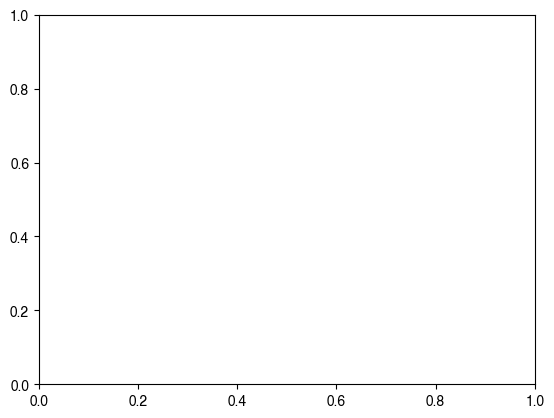

In [3]:
!cp Helvetica.ttf $font_dir

mpl.rcParams['font.family'] = 'sans-serif'
mpl.rcParams['font.sans-serif'] = ['Helvetica']
plt.xticks(fontname = 'Helvetica')
plt.yticks(fontname = 'Helvetica')
rc('text', usetex=True)
plt.rcParams['text.usetex'] = True
plt.rc('text.latex', preamble=r'\usepackage[dvips]{graphicx}\usepackage{amsmath}\usepackage{xfrac}')#\usepackage{cmbright}')


plt.rcParams['savefig.bbox'] = 'tight'

import matplotlib.font_manager as fm
# fm.FontProperties(fname='/content/gdrive/MyDrive/Helvetica.ttf', size= 24)
fm.fontManager.addfont(font_dir + 'Helvetica.ttf')
# fm.fontManager.addfont(font_dir + 'helvetica.ttf')
# fm.fontManager.ttflist += fm.createFontList(['/content/gdrive/MyDrive/Helvetica.ttf'])
# mpl.rc('font', family='Helvetica')
mpl.rcParams['font.family'] = 'sans-serif'
mpl.rcParams['font.sans-serif'] = ['Helvetica']

prop = fm.FontProperties(fname=font_dir+'Helvetica.ttf')
# prop = fm.FontProperties(fname=font_dir+'helvetica.ttf')
font = {'fontname':'Helvetica'}

#Helper Functions

In [4]:
def haversine(lon1, lat1, lon2, lat2, r=6371):
    """
    Calculate the great circle distance between two points
    on the earth (specified in decimal degrees)
    """
    # convert decimal degrees to radians
#     lon1, lat1, lon2, lat2 = map(math.radians, [lon1, lat1, lon2, lat2])
    lon1, lat1, lon2, lat2 = np.radians([lon1, lat1, lon2, lat2])
    # haversine formula
    dlon = lon2 - lon1
    dlat = lat2 - lat1
    a = np.sin(dlat/2)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2)**2
    c = 2 * np.arcsin(np.sqrt(a))
    return c * r

def haversine_np(lon1, lat1, lon2, lat2, r=6371):
    """
    Calculate the great circle distance between two points
    on the earth (specified in decimal degrees)

    All args must be of equal length.

    """
    lon1, lat1, lon2, lat2 = map(np.radians, [lon1, lat1, lon2, lat2])

    dlon = lon2 - lon1
    dlat = lat2 - lat1

    a = np.sin(dlat/2.0)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2.0)**2

    c = 2 * np.arcsin(np.sqrt(a))
    return c * r

def nearest_neighbors(lat,lon,latlon_icos, r=6371, num_neighbors=4, radius=None):
    """
    Find nearest neighbors (using geodesic distance) of given point

    if radius is None, find closest num_neighbors neighbors
    else, find list of neighbors within radius
    """
    lats = np.zeros((len(latlon_icos),)) + lat
    lons = np.zeros((len(latlon_icos),)) + lon
    distances = haversine_np(lons,lats,latlon_icos[:,1],latlon_icos[:,0], r)

    if radius is not None:
        neighbors = []
        for i in range(len(latlon_icos)):
            lat_icos, lon_icos = latlon_icos[i]
            if distances[i] <= radius:
                neighbors.append((i,distances[i]))
        return neighbors
    else:
        neighbors = [(i,distances[i]) for i in range(len(distances))]

        neighbors.sort(key = lambda k: k[1])
        return neighbors[:num_neighbors]

def interpolate_point(lat,lon,latlon_icos,data, r=6371, num_neighbors=4, radius=None):
    """
    Interpolate point using convolution of nearest geodesic neighbors - found either via
    fixed 'num_neighbors' scheme or via all points within 'radius' geodesic distance of input
    """
    neighbors = nearest_neighbors(lat,lon,latlon_icos, r=r,
                                  num_neighbors=num_neighbors, radius=radius)
    return np.sum([(1/dist)*data[i] for (i,dist) in neighbors])/np.sum([(1/dist) for (i,dist) in neighbors])

def interpolate_points(lats,lons,latlon_icos,data, r=6371, num_neighbors=4, radius=None, desc=''):
    """
    Interpolate a sequence of latitude-longitude points given by 'lats' and 'lons' (equal size 1D array)
    using convolution of nearest geodesic neighbors - found either via
    fixed 'num_neighbors' scheme or via all points within 'radius' geodesic distance of input
    """
    results = np.zeros((len(lats),))
    for i in trange(len(lats), desc=desc, leave=False):
        lat, lon = lats[i], lons[i]
        results[i] = interpolate_point(lat,lon,latlon_icos,data, r=r,
                                       num_neighbors=num_neighbors,
                                       radius=radius)
    return results

def replace_points_near_poles(ilat, ilon, idat, latlon_icos, data,
                              threshold=15, num_neighbors=4, radius=None):
    """
    To fix artifacting near poles, manually interpolate with nearest neighbors

    ilon, ilat is meshgrid over globe
    idat is associated interpolation of data
    data is list of some value for each node in latlon_icos

    90-threshold and -90+threshold (in degrees) are latidues to replace

    """
    close_to_poles = np.concatenate((np.where(abs(ilat[:,0]-90) < threshold)[0],
                                     np.where(abs(ilat[:,0]+90) < threshold)[0]))

    lons = [lon for i in range(len(close_to_poles)) for lon in ilon[0,:]]
    lats = [ilat[lat,0] for lat in close_to_poles for i in range(len(ilon[0,:]))]

    results_close_to_poles = interpolate_points(lats,lons,latlon_icos,data,
                                                num_neighbors=num_neighbors,
                                                radius=radius,
                                                desc = 'Replacing Poles')

    nj = len(ilon[0,:])
    for i in range(len(close_to_poles)):
        lat_ind = close_to_poles[i]
        for j in range(nj):
            idat[lat_ind,j] = results_close_to_poles[nj*i + j]

    return idat

def replace_points_near_dateline(ilat, ilon, idat, latlon_icos, data,
                                 threshold=5, num_neighbors=4, radius=None):
    """
    To fix artifacting near dateline, manually interpolate with longitude periodicity from 0 to 360

    ilon, ilat is meshgrid over globe
    idat is associated interpolation of data
    data is list of some value for each node in latlon_icos

    +/- threshold (in degrees) are longitudes to replace

    """
    close_to_dateline = np.concatenate((np.where(abs(ilon[0,:]) < threshold)[0],
                                        np.where(abs(ilon[0,:]-360) < threshold)[0]))

    lons = [ilon[0,lon] for lon in close_to_dateline for i in range(len(ilat[:,0]))]
    lats = [lat for i in range(len(close_to_dateline)) for lat in ilat[:,0]]

    results_close_to_dateline = interpolate_points(lats,lons,latlon_icos,data,
                                                   num_neighbors=num_neighbors,
                                                   radius=radius,
                                                   desc = 'Replacing Dateline')

    nj = len(ilat[:,0])
    for i in range(len(close_to_dateline)):
        lon_ind = close_to_dateline[i]
        for j in range(nj):
            idat[j,lon_ind] = results_close_to_dateline[nj*i + j]

    return idat

def replace_points_where_nan(ilat, ilon, idat, latlon_icos, data, num_neighbors=4, radius=None):
    """
    Use custom interpolation (using nearest geodesic neighbors) for points that are np.nan

    Can be used to simply fill in values mixed in scipy griddata interpolation due to longitude
    or latitude outside input icosahedral range.

    However, it is not guaranteed that this will fix the seam at the dateline - values with longtidue
    slightly larger than 0 may not smoothly vary since usually the scipy griddata interpolation misses
    data just to the *WEST* of the dateline. Therefore even if those missing values are replaced, there
    may be a seam across the dateline (longutude 0 degrees). TO FIX THIS, SIMPLY USE THE
    replace_points_near_dateline FUNCTION TO INTERPOLATE DATA TO THE WEST *AND* EAST OF THE DATELINE.
    """
    where = np.where(np.isnan(idat))

    lats = ilat[where[0],0]
    lons = ilon[0,where[1]]

    results_where_nans = interpolate_points(lats,lons,latlon_icos,data,
                                            num_neighbors=num_neighbors,
                                            radius=radius,
                                            desc = 'Replacing NaNs')

    for i in range(len(lats)):
        lat_ind = where[0][i]
        lon_ind = where[1][i]

        idat[lat_ind,lon_ind] = results_where_nans[i]

    return idat

def replace_points_in_shapefile(shape_filename, ilat, ilon, idat, fill_value=np.nan, inside=True):
    """
    This function can read a shapefile and fill values from the interpolated grid with 'fill_value'
    when they fall inside of the shapefile. This is useful since the interpolation of scatter data will
    fill in all values - even those that are intentionally left blank.

    OPTIONALLY: Specify inside=False to reverse which points are excluded - here the points *OUTSIDE*
    the shapefile are filled with 'fill_value'.

    TODO: Check if shapefiles with multiple polygons will break function - it was only tested with a
    contiguous-polygon shapefile.
    """
    from shapely.ops import unary_union
    import shapely.vectorized

    reader = shpreader.Reader(shape_filename)

    shape_geom = unary_union(list(reader.geometries()))

    shape_mask = shapely.vectorized.contains(shape_geom, ilon, ilat)
    shape_mask = np.logical_or(shape_mask,
                   shapely.vectorized.contains(shape_geom, ilon-360, ilat))

    idat[np.where(shape_mask == inside)] = fill_value

    return idat

def interpolate_scatter_data(latlon_icos, data, method='linear',
                             threshold_dateline=5, threshold_poles=15,
                             replace_nans = True,
                             num_neighbors=4, radius=None,
                             extent=[0, 360, -90, 90], filler=0,
                             num_interp_pts=200, shape_filename=None,
                             fill_value=np.nan):
    """
    This function takes scatter data as input - with (presumably icosahedral) coordinates 'latlon_icos',
    which is an (N,2)-size list of latitude-longitude pairs, and length-N 'data' specifying the pertinent
    qualitative information for each latitude-longitude pair.

    The output of the function is interpolated grid data intended for use in a contourf plot, consiting of
    'ilon' longitudinal grid - (num_interp_pts,num_interp_pts)
    'ilat' latitudinal grid - (num_interp_pts,num_interp_pts)
    'idat' grid data - (num_interp_pts,num_interp_pts)

    The basic interpolation is performed with scipy.interpolate.griddata, which currently has the flaw of
    not extrapolating under a method='linear' interpolation scheme. It also currently has no way to make
    use of the periodicity over the dateline (longitude = 0 degrees).

    In order to fix the missing points left by scipy.interpolate.griddata, three methods were developed:
    1) Replace points within some degree longitude of the dateline
    2) Replace points within some degree of the poles
    3) Replace all points filled with np.nan
    All three methods utilize a nearest-neighbor convolution, where points with low geodesic distance to
    the grid point are put under a weighted average to fill the grid data. See the function
    interpolate_points for details.

    Lastly, optionally fill values that fall inside (or outside) a supplied shapefile with given 'fill_value'.
    """
    from scipy.interpolate import griddata

    ilon = np.linspace(extent[0]-filler, extent[1]+filler, num_interp_pts)
    ilat = np.linspace(extent[2]-filler, extent[3]+filler, num_interp_pts)
    ilon, ilat = np.meshgrid(ilon, ilat)
    idat = griddata((latlon_icos[:,1], latlon_icos[:,0]), data,
                    (ilon, ilat), method=method)

    if threshold_dateline > 0:
        idat = replace_points_near_dateline(ilat, ilon, idat, latlon_icos,
                                            data, threshold=threshold_dateline,
                                            num_neighbors=num_neighbors,
                                            radius=radius)
    if threshold_poles > 0:
        idat = replace_points_near_poles(ilat, ilon, idat, latlon_icos,
                                         data, threshold=threshold_poles,
                                         num_neighbors=num_neighbors,
                                         radius=radius)
    if replace_nans:
        idat = replace_points_where_nan(ilat, ilon, idat, latlon_icos, data,
                                        num_neighbors=num_neighbors,
                                        radius=radius)

    if shape_filename is not None:
        idat = replace_points_in_shapefile(shape_filename, ilat, ilon,
                                           idat, fill_value=fill_value)

    return ilat, ilon, idat

def shiftedColorMap(cmap, start=0, midpoint=0.5, stop=1.0, name='shiftedcmap'):
    '''
    Function to offset the "center" of a colormap. Useful for
    data with a negative min and positive max and you want the
    middle of the colormap's dynamic range to be at zero.

    Input
    -----
      cmap : The matplotlib colormap to be altered
      start : Offset from lowest point in the colormap's range.
          Defaults to 0.0 (no lower offset). Should be between
          0.0 and `midpoint`.
      midpoint : The new center of the colormap. Defaults to
          0.5 (no shift). Should be between 0.0 and 1.0. In
          general, this should be  1 - vmax / (vmax + abs(vmin))
          For example if your data range from -15.0 to +5.0 and
          you want the center of the colormap at 0.0, `midpoint`
          should be set to  1 - 5/(5 + 15)) or 0.75
      stop : Offset from highest point in the colormap's range.
          Defaults to 1.0 (no upper offset). Should be between
          `midpoint` and 1.0.
    '''
    cdict = {
        'red': [],
        'green': [],
        'blue': [],
        'alpha': []
    }

    # regular index to compute the colors
    reg_index = np.linspace(start, stop, 257)

    # shifted index to match the data
    shift_index = np.hstack([
        np.linspace(0.0, midpoint, 128, endpoint=False),
        np.linspace(midpoint, 1.0, 129, endpoint=True)
    ])

    for ri, si in zip(reg_index, shift_index):
        r, g, b, a = cmap(ri)

        cdict['red'].append((si, r, r))
        cdict['green'].append((si, g, g))
        cdict['blue'].append((si, b, b))
        cdict['alpha'].append((si, a, a))

    newcmap = mpl.colors.LinearSegmentedColormap(name, cdict)
    # try:
    #     # mpl.cm.unregister_cmap(name)
    #     # mpl.colormaps.unregister(name)
    #     mpl.cm.unregister(name)
    # except:
    #     pass
    # # plt.register_cmap(cmap=newcmap)
    # # mpl.colormaps.register(cmap=newcmap)
    # mpl.cm.register(cmap=newcmap)

    return newcmap

def yy_to_yyyy(yy):
    """
    Convert string of year in yy format to string in yyyy format
    """
    yy_int = int(yy)
    if yy_int < 10:
        return '200' + str(yy_int)
    elif yy_int < 48:
        return '20' + str(yy_int)
    else:
        return '19' + str(yy_int)


def start_year_to_date_range(start_year,year_interval=25):
    """
    Convert string of start year in yy format to date range string in yyyy-yyyy format
    """
    start = yy_to_yyyy(start_year)
    end = str(int(start) + year_interval)
    return start + '-' + end

def match_nodes(dates,finallons_dict,finallats_dict):
    f = gzip.open(data_dir + '/G/'+dates[0]+'.data','rb')
    G = pkl.load(f)
    f.close()
    N = G.number_of_nodes()

    node_matches = np.zeros((N,len(dates)))
    for node in G.nodes():
        node_matches[node,0] = node

    for i in trange(1,len(dates),desc='Matching'):
        for j in range(N):
            node_matches[j,i] = np.where(np.logical_and(finallons_dict[dates[i]] == finallons_dict[dates[0]][j],
                                   finallats_dict[dates[i]] == finallats_dict[dates[0]][j]))[0][0]

    return node_matches.astype(int)

def get_trend(trend_dict,dates,finallons_dict,finallats_dict,normalize=False):
    f = gzip.open(data_dir + '/G/'+dates[0]+'.data','rb')
    G = pkl.load(f)
    f.close()
    nodes = list(G.nodes())

    node_matches = match_nodes(dates,finallons_dict,finallats_dict)

    trend = np.zeros((len(nodes),1))

    for node in nodes:
#         slope, _ = np.polyfit(list(range(48)), [trend_dict[date][node,1] for date in dates], 1)
        slope, _ = np.polyfit(list(range(48)), [trend_dict[dates[i]][node_matches[node,i]] for i in range(len(dates))], 1)
        trend[node] = slope

    if normalize:
#         return np.interp(trend, (trend.min(), trend.max()), (-1, +1))
        return trend/abs(min(trend))
    else:
        return trend



# Geodesic distance distribution

In [7]:
num_nodes = 10242
num_edges = num_nodes*(num_nodes-1)/2

density = 0.05
print(density*num_edges)

k = 250
print(k*num_nodes)

2622208.0500000003
2560500


In [35]:
with gzip.open(data_dir + 'icosahedral_grid.data', 'rb') as file:
  latlon_icos = np.array(pkl.load(file))

months = 300
offset = 365.25
k = 500

dir_end = '-months='+str(months)+',offset='+str(offset)+',k={:}'.format(k)+'/'

edge_dir = data_dir + 'edge_list' + dir_end

total_networks = len(os.listdir(edge_dir))

num_nodes = 10242

with gzip.open(data_dir + 'year_intervals-months='+str(months)+',offset='+str(offset) + '.data', 'rb') as file:
  year_intervals = pkl.load(file)

with gzip.open(data_dir + 'date_intervals-months='+str(months)+',offset='+str(offset) + '.data', 'rb') as file:
  date_intervals = pkl.load(file)

dates = [year_intervals[i][0] + '-' + year_intervals[i][1] for i in range(len(year_intervals))]
print(dates)

reader = shpreader.Reader(base_dir+'Amazon Biome/amazonia.shp')
amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())

recompute = False

if recompute:
  amazon_nodes = []

  for i in range(num_nodes):
    if amazon._geoms[0].contains(Point(latlon_icos[i,1]-360,latlon_icos[i,0])):
      amazon_nodes.append(i)

  with gzip.open(data_dir + 'amazon_nodes_new_networks.data', 'wb') as file:
    pkl.dump(amazon_nodes, file)
else:
  with gzip.open(data_dir + 'amazon_nodes_new_networks.data', 'rb') as file:
    amazon_nodes = pkl.load(file)

recompute = False

graph_dir = data_dir + 'G' + dir_end
if recompute:
  if not os.path.isdir(graph_dir):
    os.mkdir(graph_dir)

  for i in trange(len(dates)):
    date = dates[i]

    with gzip.open(edge_dir + str(i) + '.data', 'rb') as file:
      edge_list = pkl.load(file)

    G = nx.from_edgelist(edge_list, nx.DiGraph) # initiall unsorted

    H = nx.DiGraph() # make sorted copy
    H.add_nodes_from(sorted(G.nodes(data=True)))
    H.add_edges_from(G.edges(data=True))
    G = H # write over original with sorted copy
    del H # delete sorted copy

    degrees = [d[1] for d in G.degree()]

    print(i, nx.density(G), nx.number_strongly_connected_components(G), G.number_of_edges(), min(degrees), max(degrees), np.mean(degrees))

    # with gzip.open(graph_dir + date + '.data', 'wb') as file:
    #   pkl.dump(G, file)

with gzip.open(graph_dir + dates[0] + '.data', 'rb') as file:
  G_KNN = pkl.load(file)

['1948-1973', '1949-1974', '1950-1975', '1951-1976', '1952-1977', '1953-1978', '1954-1979', '1955-1980', '1956-1981', '1957-1982', '1958-1983', '1959-1984', '1960-1985', '1961-1986', '1962-1987', '1963-1988', '1964-1989', '1965-1990', '1966-1991', '1967-1992', '1968-1993', '1969-1994', '1970-1995', '1971-1996', '1972-1997', '1973-1998', '1974-1999', '1975-2000', '1976-2001', '1977-2002', '1978-2003', '1979-2004', '1980-2005', '1981-2006', '1982-2007', '1983-2008', '1984-2009', '1985-2010', '1986-2011', '1987-2012', '1988-2013', '1989-2014', '1990-2015', '1991-2016', '1992-2017', '1993-2018', '1994-2019', '1995-2020', '1996-2021', '1997-2022', '1998-2023']


In [36]:
with gzip.open(data_dir + 'icosahedral_grid.data', 'rb') as file:
  latlon_icos = np.array(pkl.load(file))

months = 300
offset = 365.25
density = 0.1

edge_dir = data_dir + 'edge_list-months='+str(months)+',offset='+str(offset)+',density={:}'.format(density)+'/'

total_networks = len(os.listdir(edge_dir))

num_nodes = 10242

with gzip.open(data_dir + 'year_intervals-months='+str(months)+',offset='+str(offset) + '.data', 'rb') as file:
  year_intervals = pkl.load(file)

with gzip.open(data_dir + 'date_intervals-months='+str(months)+',offset='+str(offset) + '.data', 'rb') as file:
  date_intervals = pkl.load(file)

dates = [year_intervals[i][0] + '-' + year_intervals[i][1] for i in range(len(year_intervals))]
print(dates)

reader = shpreader.Reader(base_dir+'Amazon Biome/amazonia.shp')
amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())

recompute = False

if recompute:
  amazon_nodes = []

  for i in range(num_nodes):
    if amazon._geoms[0].contains(Point(latlon_icos[i,1]-360,latlon_icos[i,0])):
      amazon_nodes.append(i)

  with gzip.open(data_dir + 'amazon_nodes_new_networks.data', 'wb') as file:
    pkl.dump(amazon_nodes, file)
else:
  with gzip.open(data_dir + 'amazon_nodes_new_networks.data', 'rb') as file:
    amazon_nodes = pkl.load(file)

recompute = False

graph_dir = data_dir + 'G-months='+str(months)+',offset='+str(offset)+',density={:}'.format(density)+'/'
if recompute:
  if not os.path.isdir(graph_dir):
    os.mkdir(graph_dir)

  for i in trange(len(dates)):
    date = dates[i]

    with gzip.open(edge_dir + str(i) + '.data', 'rb') as file:
      edge_list = pkl.load(file)

    G = nx.from_edgelist(edge_list) # initiall unsorted

    H = nx.Graph() # make sorted copy
    H.add_nodes_from(sorted(G.nodes(data=True)))
    H.add_edges_from(G.edges(data=True))
    G = H # write over original with sorted copy
    del H # delete sorted copy

    print(i, nx.density(G))

    with gzip.open(graph_dir + date + '.data', 'wb') as file:
      pkl.dump(G, file)

with gzip.open(graph_dir + dates[0] + '.data', 'rb') as file:
  G_GTN = pkl.load(file)

['1948-1973', '1949-1974', '1950-1975', '1951-1976', '1952-1977', '1953-1978', '1954-1979', '1955-1980', '1956-1981', '1957-1982', '1958-1983', '1959-1984', '1960-1985', '1961-1986', '1962-1987', '1963-1988', '1964-1989', '1965-1990', '1966-1991', '1967-1992', '1968-1993', '1969-1994', '1970-1995', '1971-1996', '1972-1997', '1973-1998', '1974-1999', '1975-2000', '1976-2001', '1977-2002', '1978-2003', '1979-2004', '1980-2005', '1981-2006', '1982-2007', '1983-2008', '1984-2009', '1985-2010', '1986-2011', '1987-2012', '1988-2013', '1989-2014', '1990-2015', '1991-2016', '1992-2017', '1993-2018', '1994-2019', '1995-2020', '1996-2021', '1997-2022', '1998-2023']


In [11]:
print(G_GTN.number_of_edges())
print(G_KNN.number_of_edges())

2622208
2560500


In [24]:
latlon_icos

array([[-86.33644643,   0.        ],
       [-82.52167971,   0.        ],
       [-78.5819435 ,   0.        ],
       ...,
       [ 35.80361679, 358.77912752],
       [-33.03042635, 358.8578861 ],
       [ 33.03042635, 358.8578861 ]])

In [13]:
geodesic_distances = np.zeros((num_nodes,num_nodes))
for i in range(num_nodes):
  lats = np.zeros((num_nodes-i-1,)) + latlon_icos[i,0]
  lons = np.zeros((num_nodes-i-1,)) + latlon_icos[i,1]
  geodesic_distances[i,i+1:] = haversine_np(lons,lats,latlon_icos[i+1:,1],latlon_icos[i+1:,0])
  geodesic_distances[i+1:,i] = geodesic_distances[i,i+1:]
# geodesic_distances = cp.asarray(geodesic_distances)

In [25]:
def above_below_thresh(lat,thresh=30):
  return lat >= thresh or lat <= -thresh

In [39]:
thresh = 30
dists_GTN = np.array([geodesic_distances[n,m] for (n,m) in G_GTN.edges if above_below_thresh(latlon_icos[n,0],thresh) or above_below_thresh(latlon_icos[m,0],thresh)])
dists_KNN = np.array([geodesic_distances[n,m] for (n,m) in G_KNN.edges if above_below_thresh(latlon_icos[n,0],thresh) or above_below_thresh(latlon_icos[m,0],thresh)])

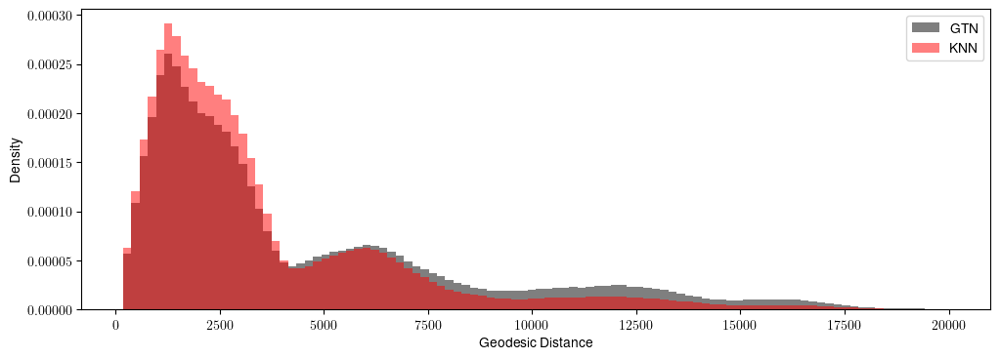

In [40]:
fig, ax = plt.subplots(1,1,figsize=(12,4))

ax.hist(dists_GTN, bins=100, color='k', alpha=0.5, density=True, label='GTN')
ax.hist(dists_KNN, bins=100, color='r', alpha=0.5, density=True, label='KNN')

ax.set_xlabel('Geodesic Distance')
ax.set_ylabel('Density')

ax.legend(loc='best')

plt.show()

# Old Networks

In [ ]:
start_years = np.round(np.linspace(48,95,48)).astype(int)
dates = [start_year_to_date_range(str(start_year)) for start_year in start_years]

# G_dict = {}
# f = gzip.open(data_dir + '/G.data','rb')
# for date in tqdm(dates,desc='Reading Graphs'):
#     G_dict[date] = pkl.load(f)
# f.close()

# amazon_nodes_dict = {}
# f = gzip.open(data_dir + '/amazon_nodes.data','rb')
# for date in tqdm(dates,desc='Reading Amazon Nodes'):
#     amazon_nodes_dict[date] = pkl.load(f)
# f.close()

with open(data_dir + '/amazon_nodes.pickle','rb') as f:
    amazon_nodes = pkl.load(f)

finallats_dict = {}
f = gzip.open(data_dir + '/finallats.data','rb')
for date in tqdm(dates,desc='Reading Latitude'):
    finallats_dict[date] = pkl.load(f)
f.close()

finallons_dict = {}
f = gzip.open(data_dir + '/finallons.data','rb')
for date in tqdm(dates,desc='Reading Longitude'):
    finallons_dict[date] = pkl.load(f)
f.close()

Reading Latitude:   0%|          | 0/48 [00:00<?, ?it/s]

Reading Longitude:   0%|          | 0/48 [00:00<?, ?it/s]

In [ ]:
i = 0
date = dates[i]
f = gzip.open(data_dir + '/G/'+date+'.data','rb')
G = pkl.load(f)
f.close()

print(G.number_of_edges()/(G.number_of_nodes()*(G.number_of_nodes()-1)/2))

0.04990723371473137


In [ ]:
print(nx.density(G))

0.04990723371473137


In [ ]:
reader = shpreader.Reader(base_dir+'Amazon Biome/amazonia.shp')
amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())

In [ ]:
recompute = False

if recompute:
  amazon_nodes_corrected_dict = {date:[] for date in dates}

  for i in trange(len(dates)):
    date = dates[i]
    f = gzip.open(data_dir + '/G/'+date+'.data','rb')
    G = pkl.load(f)
    f.close()

    amazon_nodes_corrected = [list(G.nodes()).index(node) for node in amazon_nodes]

    amazon_nodes_corrected = []
    for j in range(G.number_of_nodes()):
      if finallons_dict[date][j] > 180:
        if amazon._geoms[0].contains(Point(finallons_dict[dates[i]][j]-360,finallats_dict[dates[i]][j])):
          amazon_nodes_corrected_dict[date].append(j)
      else:
        if amazon._geoms[0].contains(Point(finallons_dict[dates[i]][j],finallats_dict[dates[i]][j])):
          amazon_nodes_corrected_dict[date].append(j)

  with gzip.open(data_dir + 'amazon_nodes_dict_from_shapefile.data', 'wb') as file:
    pkl.dump(amazon_nodes_corrected_dict, file)
else:
  with gzip.open(data_dir + 'amazon_nodes_dict_from_shapefile.data', 'rb') as file:
    amazon_nodes_corrected_dict = pkl.load(file)

In [ ]:
recompute = True

if recompute:
  d_i_dict = {date:[None]*10242 for date in dates}

  for i in trange(len(dates)):
    date = dates[i]

    f = gzip.open(data_dir + '/G/'+date+'.data','rb')
    G = pkl.load(f)
    f.close()

    for j in trange(G.number_of_nodes(), leave=False, desc=date):
      d_i_dict[date][j] = sum([1 if neighbor in amazon_nodes_corrected_dict[date] else 0 for neighbor in G.neighbors(j)])

    node_index = [None]*G.number_of_nodes()
    node_list = list(G.nodes())
    for j in range(G.number_of_nodes()):
      node_index[node_list.index(j)] = j

    d_i_dict[date] = [d_i_dict[date][node_index[j]] for j in range(len(node_list))]

  with gzip.open(data_dir + 'd_i_dict.data', 'wb') as file:
    pkl.dump(d_i_dict, file)
else:
  with gzip.open(data_dir + 'd_i_dict.data', 'rb') as file:
    d_i_dict = pkl.load(file)

  0%|          | 0/48 [00:00<?, ?it/s]

1948-1973:   0%|          | 0/10242 [00:00<?, ?it/s]

1949-1974:   0%|          | 0/10242 [00:00<?, ?it/s]

1950-1975:   0%|          | 0/10242 [00:00<?, ?it/s]

1951-1976:   0%|          | 0/10242 [00:00<?, ?it/s]

1952-1977:   0%|          | 0/10242 [00:00<?, ?it/s]

1953-1978:   0%|          | 0/10242 [00:00<?, ?it/s]

1954-1979:   0%|          | 0/10242 [00:00<?, ?it/s]

1955-1980:   0%|          | 0/10242 [00:00<?, ?it/s]

1956-1981:   0%|          | 0/10242 [00:00<?, ?it/s]

1957-1982:   0%|          | 0/10242 [00:00<?, ?it/s]

1958-1983:   0%|          | 0/10242 [00:00<?, ?it/s]

1959-1984:   0%|          | 0/10242 [00:00<?, ?it/s]

1960-1985:   0%|          | 0/10242 [00:00<?, ?it/s]

1961-1986:   0%|          | 0/10242 [00:00<?, ?it/s]

1962-1987:   0%|          | 0/10242 [00:00<?, ?it/s]

1963-1988:   0%|          | 0/10242 [00:00<?, ?it/s]

1964-1989:   0%|          | 0/10242 [00:00<?, ?it/s]

1965-1990:   0%|          | 0/10242 [00:00<?, ?it/s]

1966-1991:   0%|          | 0/10242 [00:00<?, ?it/s]

1967-1992:   0%|          | 0/10242 [00:00<?, ?it/s]

1968-1993:   0%|          | 0/10242 [00:00<?, ?it/s]

1969-1994:   0%|          | 0/10242 [00:00<?, ?it/s]

1970-1995:   0%|          | 0/10242 [00:00<?, ?it/s]

1971-1996:   0%|          | 0/10242 [00:00<?, ?it/s]

1972-1997:   0%|          | 0/10242 [00:00<?, ?it/s]

1973-1998:   0%|          | 0/10242 [00:00<?, ?it/s]

1974-1999:   0%|          | 0/10242 [00:00<?, ?it/s]

1975-2000:   0%|          | 0/10242 [00:00<?, ?it/s]

1976-2001:   0%|          | 0/10242 [00:00<?, ?it/s]

1977-2002:   0%|          | 0/10242 [00:00<?, ?it/s]

1978-2003:   0%|          | 0/10242 [00:00<?, ?it/s]

1979-2004:   0%|          | 0/10242 [00:00<?, ?it/s]

1980-2005:   0%|          | 0/10242 [00:00<?, ?it/s]

1981-2006:   0%|          | 0/10242 [00:00<?, ?it/s]

1982-2007:   0%|          | 0/10242 [00:00<?, ?it/s]

1983-2008:   0%|          | 0/10242 [00:00<?, ?it/s]

1984-2009:   0%|          | 0/10242 [00:00<?, ?it/s]

1985-2010:   0%|          | 0/10242 [00:00<?, ?it/s]

1986-2011:   0%|          | 0/10242 [00:00<?, ?it/s]

1987-2012:   0%|          | 0/10242 [00:00<?, ?it/s]

1988-2013:   0%|          | 0/10242 [00:00<?, ?it/s]

1989-2014:   0%|          | 0/10242 [00:00<?, ?it/s]

1990-2015:   0%|          | 0/10242 [00:00<?, ?it/s]

1991-2016:   0%|          | 0/10242 [00:00<?, ?it/s]

1992-2017:   0%|          | 0/10242 [00:00<?, ?it/s]

1993-2018:   0%|          | 0/10242 [00:00<?, ?it/s]

1994-2019:   0%|          | 0/10242 [00:00<?, ?it/s]

1995-2020:   0%|          | 0/10242 [00:00<?, ?it/s]

In [ ]:
for date in dates:
  # mpl.rcParams['text.latex.preamble'] = [
#     r'\usepackage[dvipsnames]{xcolor}']


  fontsize = 54

  plt.rc('text', usetex=True)
  plt.rc('xtick',labelsize=fontsize)
  plt.rc('ytick',labelsize=fontsize)


  fig, axs = plt.subplots(1,1,sharex=True,figsize=(20,10))

  ax1 = plt.subplot2grid(shape=(1, 1), loc=(0, 0), projection=ccrs.Robinson(central_longitude=180))



  # plt.subplots_adjust(hspace=0, wspace=0.15)



  ### AXIS 1, RANDOM WALK MAP
  ax1.coastlines(zorder=5)


  # min_value = np.nanmin(idat)
  # max_value = np.nanmax(idat)
  # min_value = min(np.delete(dist_trend,amazon_nodes_corrected))
  # max_value = max(np.delete(dist_trend,amazon_nodes_corrected))
  min_value = 0
  max_value = 1

  # idat1 = idat
  # idat1[np.where(idat < min_value)] = min_value

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  midpoint = -min_value/(max_value-min_value)
  cmap = mpl.cm.bwr
  shifted_cmap = shiftedColorMap(cmap, midpoint=midpoint)


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax1.add_feature(amazon, facecolor='none', edgecolor='r', alpha=1, linewidth=3, zorder=6)

  im = ax1.scatter(finallons_dict[date], finallats_dict[date],
                   c=[1 if i in amazon_nodes_corrected_dict[date] else 0 for i in range(10242)],
                   cmap='viridis_r', transform=ccrs.PlateCarree(), marker='o', s=20,
                   edgecolors=None)
  im.set_clim(min_value, max_value)

  plt.setp(ax1.spines.values(), linewidth=2)

  plt.title(date, fontsize=fontsize)



  plt.tight_layout()



  title = 'Random Walk'
  # plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
  # plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)

  plt.show()

In [ ]:
for date in dates:
  # mpl.rcParams['text.latex.preamble'] = [
#     r'\usepackage[dvipsnames]{xcolor}']


  fontsize = 54

  plt.rc('text', usetex=True)
  plt.rc('xtick',labelsize=fontsize)
  plt.rc('ytick',labelsize=fontsize)


  # fig, axs = plt.subplots(1,1,sharex=True,figsize=(20,10))
  fig = plt.figure(figsize=(20,10))

  ax1 = plt.subplot2grid(shape=(1, 1), loc=(0, 0), projection=ccrs.Robinson(central_longitude=180))



  # plt.subplots_adjust(hspace=0, wspace=0.15)



  ### AXIS 1, RANDOM WALK MAP
  ax1.coastlines(zorder=5)


  # min_value = np.nanmin(idat)
  # max_value = np.nanmax(idat)
  # min_value = min(np.delete(dist_trend,amazon_nodes_corrected))
  # max_value = max(np.delete(dist_trend,amazon_nodes_corrected))
  min_value = 0
  max_value = max(d_i_dict[date])

  # idat1 = idat
  # idat1[np.where(idat < min_value)] = min_value

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  midpoint = -min_value/(max_value-min_value)
  cmap = mpl.cm.bwr
  shifted_cmap = shiftedColorMap(cmap, midpoint=midpoint)


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax1.add_feature(amazon, facecolor='none', edgecolor='r', alpha=1, linewidth=3, zorder=6)

  im = ax1.scatter(finallons_dict[date], finallats_dict[date],
                   c=d_i_dict[date],
                   cmap='viridis_r', transform=ccrs.PlateCarree(), marker='o', s=20,
                   edgecolors=None)
  im.set_clim(min_value, max_value)
  cbar=plt.colorbar(im, ax=ax1, orientation='horizontal',fraction=0.08, pad=0.02)
  # ticks = np.array([-5,-4,-3,-2,-1,0,1,2])
  # cbar.set_ticks(ticks*1e-5)
  # cbar.set_ticklabels(ticks)

  # cbar=plt.colorbar(im, ax=ax1, ticks=ticks[1::3], fraction=0.048, orientation='horizontal',
  #                   pad=0.02, boundaries=levels)
  # cbar.set_ticklabels(['{:.4f}'.format(tick) for tick in ticks[1::3]])

  # cbar.set_label('Slope of Trendline of Average Diffusion Distance to Amazon\n$t = $ '+
  #                '{:.4f}'.format(round(t_target, 4)),fontsize=fontsize)
  cbar.set_label(r'$d_i$',fontsize=fontsize)

  plt.setp(ax1.spines.values(), linewidth=2)

  plt.title(date, fontsize=fontsize)



  plt.tight_layout()



  title = 'Random Walk'
  # plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
  # plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)

  plt.show()

In [ ]:
max_value = 0
for date in dates:
  max_value = max([max_value, max(d_i_dict[date])])

In [ ]:
print(max_value)

55


In [ ]:
for date in dates:
  latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  ilat, ilon, idat = interpolate_scatter_data(latlon_icos, d_i_dict[date],
#                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
                     method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

  # mpl.rcParams['text.latex.preamble'] = [
#     r'\usepackage[dvipsnames]{xcolor}']


  fontsize = 54

  plt.rc('text', usetex=True)
  plt.rc('xtick',labelsize=fontsize)
  plt.rc('ytick',labelsize=fontsize)


  fig, axs = plt.subplots(1,1,sharex=True,figsize=(20,10))

  ax1 = plt.subplot2grid(shape=(1, 1), loc=(0, 0), projection=ccrs.Robinson(central_longitude=180))



  # plt.subplots_adjust(hspace=0, wspace=0.15)



  ### AXIS 1, RANDOM WALK MAP
  ax1.coastlines(zorder=5)


  # min_value = np.nanmin(idat)
  # max_value = np.nanmax(idat)
  # min_value = min(np.delete(dist_trend,amazon_nodes_corrected))
  # max_value = max(np.delete(dist_trend,amazon_nodes_corrected))
  min_value = 0
  # max_value = max(d_i_dict[date])

  # idat1 = idat
  # idat1[np.where(idat < min_value)] = min_value

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  # midpoint = -min_value/(max_value-min_value)
  cmap = mpl.cm.viridis_r
  # shifted_cmap = shiftedColorMap(cmap, midpoint=midpoint)


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax1.add_feature(amazon, facecolor='none', edgecolor='r', alpha=1, linewidth=3, zorder=6)


  im = ax1.contourf(ilon, ilat, idat, levels=levels,
                    cmap=cmap, alpha=1,
                    vmin=min_value, vmax=max_value,
                    transform=ccrs.PlateCarree(), zorder=4)
  for c in im.collections:
      c.set_edgecolor("face")
  # im.cmap.set_under(cmap(0))
  # im.cmap.set_over(cmap(1))
  im.set_clim(min_value, max_value)
  cbar=plt.colorbar(im, ax=ax1, orientation='horizontal',fraction=0.08, pad=0.02)
  ticks = np.array([0, 10, 20, 30, 40, 50])
  cbar.set_ticks(ticks)
  cbar.set_ticklabels(ticks)

  # cbar=plt.colorbar(im, ax=ax1, ticks=ticks[1::3], fraction=0.048, orientation='horizontal',
  #                   pad=0.02, boundaries=levels)
  # cbar.set_ticklabels(['{:.4f}'.format(tick) for tick in ticks[1::3]])

  # cbar.set_label('Slope of Trendline of Average Diffusion Distance to Amazon\n$t = $ '+
  #                '{:.4f}'.format(round(t_target, 4)),fontsize=fontsize)
  cbar.set_label(r'$d_i$',fontsize=fontsize)


  # cbar.ax.annotate(r'$\times 10^{-5}$', xy=(1, -.21), xycoords="axes fraction",
  #              fontsize=fontsize, usetex=True, va='top', ha='center')

  # ax1.annotate(r'$t = '+str(t_target)+'$', color='k', xy=(0.57, -.3725), xycoords='axes fraction',
  # #              bbox=dict(facecolor='r',boxstyle='round',alpha=0.25),
  #              fontsize=fontsize,usetex=True, va='bottom', ha='center', zorder=5)


  # ax1.annotate(r'\textbf{(c)}', xy=(0, 1), xycoords="axes fraction",
  #              fontsize=fontsize,usetex=True, va='top', ha='left')

  plt.title(date, fontsize=fontsize)

  plt.setp(ax1.spines.values(), linewidth=2)

  # cbar.ax.tick_params(length=10,width=2)
  # plt.setp(cbar.ax.spines.values(), linewidth=2)




  plt.tight_layout()



  title = 'Random Walk'
  # plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
  # plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)

  plt.show()

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

<ipython-input-58-7c5b4de12fd2>:20: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax1 = plt.subplot2grid(shape=(1, 1), loc=(0, 0), projection=ccrs.Robinson(central_longitude=180))


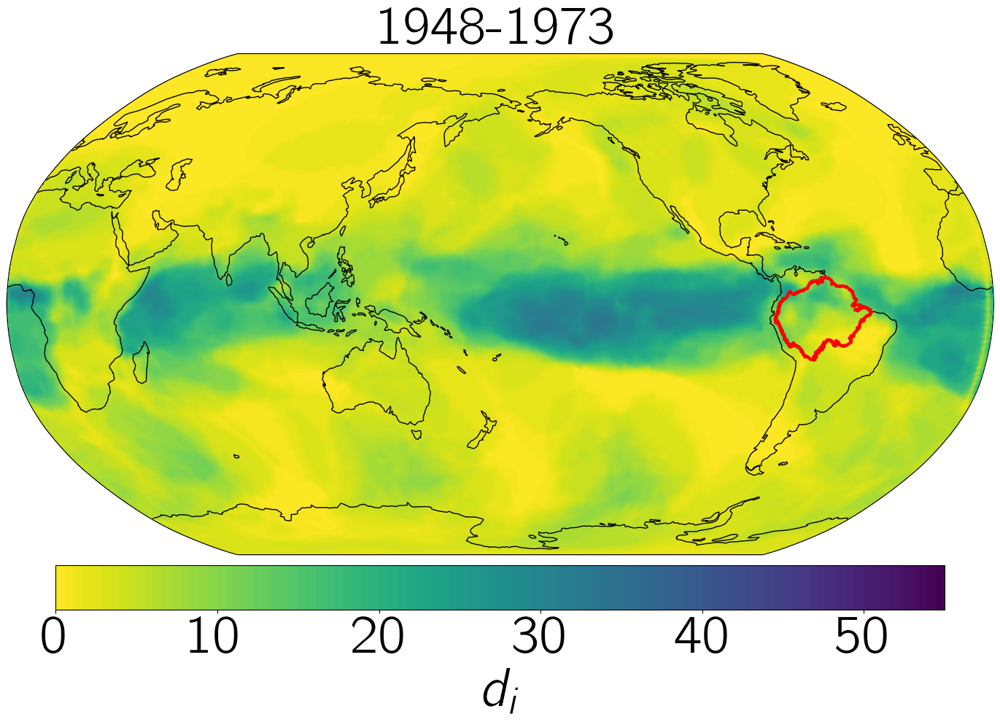

In [ ]:
for date in dates[:1]:
  latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  ilat, ilon, idat = interpolate_scatter_data(latlon_icos, d_i_dict[date],
#                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
                     method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

  # mpl.rcParams['text.latex.preamble'] = [
#     r'\usepackage[dvipsnames]{xcolor}']


  fontsize = 54

  plt.rc('text', usetex=True)
  plt.rc('xtick',labelsize=fontsize)
  plt.rc('ytick',labelsize=fontsize)


  fig, axs = plt.subplots(1,1,sharex=True,figsize=(20,10))

  ax1 = plt.subplot2grid(shape=(1, 1), loc=(0, 0), projection=ccrs.Robinson(central_longitude=180))



  # plt.subplots_adjust(hspace=0, wspace=0.15)



  ### AXIS 1, RANDOM WALK MAP
  ax1.coastlines(zorder=5)


  # min_value = np.nanmin(idat)
  # max_value = np.nanmax(idat)
  # min_value = min(np.delete(dist_trend,amazon_nodes_corrected))
  # max_value = max(np.delete(dist_trend,amazon_nodes_corrected))
  min_value = 0
  # max_value = max(d_i_dict[date])

  # idat1 = idat
  # idat1[np.where(idat < min_value)] = min_value

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  # midpoint = -min_value/(max_value-min_value)
  cmap = mpl.cm.viridis_r
  # shifted_cmap = shiftedColorMap(cmap, midpoint=midpoint)


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax1.add_feature(amazon, facecolor='none', edgecolor='r', alpha=1, linewidth=3, zorder=6)


  im = ax1.contourf(ilon, ilat, idat, levels=levels,
                    cmap=cmap, alpha=1,
                    vmin=min_value, vmax=max_value,
                    transform=ccrs.PlateCarree(), zorder=4)
  for c in im.collections:
      c.set_edgecolor("face")
  # im.cmap.set_under(cmap(0))
  # im.cmap.set_over(cmap(1))
  im.set_clim(min_value, max_value)
  cbar=plt.colorbar(im, ax=ax1, orientation='horizontal',fraction=0.08, pad=0.02)
  ticks = np.array([0, 10, 20, 30, 40, 50])
  cbar.set_ticks(ticks)
  cbar.set_ticklabels(ticks)

  # cbar=plt.colorbar(im, ax=ax1, ticks=ticks[1::3], fraction=0.048, orientation='horizontal',
  #                   pad=0.02, boundaries=levels)
  # cbar.set_ticklabels(['{:.4f}'.format(tick) for tick in ticks[1::3]])

  # cbar.set_label('Slope of Trendline of Average Diffusion Distance to Amazon\n$t = $ '+
  #                '{:.4f}'.format(round(t_target, 4)),fontsize=fontsize)
  cbar.set_label(r'$d_i$',fontsize=fontsize)


  # cbar.ax.annotate(r'$\times 10^{-5}$', xy=(1, -.21), xycoords="axes fraction",
  #              fontsize=fontsize, usetex=True, va='top', ha='center')

  # ax1.annotate(r'$t = '+str(t_target)+'$', color='k', xy=(0.57, -.3725), xycoords='axes fraction',
  # #              bbox=dict(facecolor='r',boxstyle='round',alpha=0.25),
  #              fontsize=fontsize,usetex=True, va='bottom', ha='center', zorder=5)


  # ax1.annotate(r'\textbf{(c)}', xy=(0, 1), xycoords="axes fraction",
  #              fontsize=fontsize,usetex=True, va='top', ha='left')

  plt.title(date, fontsize=fontsize)

  plt.setp(ax1.spines.values(), linewidth=2)

  # cbar.ax.tick_params(length=10,width=2)
  # plt.setp(cbar.ax.spines.values(), linewidth=2)




  plt.tight_layout()



  title = 'Random Walk'
  # plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
  # plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)

  plt.show()

In [ ]:
print(latlon_icos.shape, ilon.shape, ilat.shape, idat.shape, np.shape(d_i_dict[date]))

(10242, 2) (200, 200) (200, 200) (200, 200) (10242,)


In [ ]:
d_i_dict = {date:np.array(d_i_dict[date])/len(amazon_nodes_corrected_dict[date]) for date in dates}

In [ ]:
n = 5
spacing = min([int(round(len(dates)/2)/(n//2)),int((len(dates)-1 - round(len(dates)/2))/(n//2))])
middle = round(len(dates)/2)
print()
dates_to_plot = [dates[i] for i in np.arange(middle-(n//2)*spacing,middle+(n//2+1)*spacing,spacing)]
# dates_to_plot = ['1948-1973', '1950-1975', '1970-1995', '1993-2018', '1995-2020']

max_value = 0
for date in dates_to_plot:
  max_value = max([max_value,max(d_i_dict[date])])



fontsize = 36

plt.rc('text', usetex=True)
plt.rc('xtick',labelsize=fontsize)
plt.rc('ytick',labelsize=fontsize)

# serif_font = fm.FontProperties(fname=font_dir+'cmr10.ttf', size=fontsize, math_fontfamily='cm')
# fpath = Path(font_dir+'cmr10.ttf')

fig = plt.figure(figsize=(10*len(dates_to_plot),5))

for i in range(len(dates_to_plot)):
  date = dates_to_plot[i]

#   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
#   ilat, ilon, idat = interpolate_scatter_data(latlon_icos, d_i_dict[date],
# #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
#                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

  ax = plt.subplot2grid(shape=(1, len(dates_to_plot)), loc=(0, i), projection=ccrs.Robinson(central_longitude=180))

  ax.coastlines(zorder=5)

  min_value = 3/len(amazon_nodes)

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  cmap = mpl.cm.viridis_r


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax.add_feature(amazon, facecolor='none', edgecolor='r', alpha=1, linewidth=3, zorder=6)



  ind = np.where(d_i_dict[date] > 0)[0]

  # idat[idat < min_value] = np.NAN

  # im = ax.contourf(ilon, ilat, idat, levels=levels,
  #                   cmap=cmap, alpha=1,
  #                   vmin=min_value, vmax=max_value,
  #                   transform=ccrs.PlateCarree(), zorder=4)
  im = ax.scatter(finallons_dict[date][ind], finallats_dict[date][ind],
                   c=d_i_dict[date][ind],
                   cmap='viridis_r', transform=ccrs.PlateCarree(), marker='o', s=20,
                   edgecolors=None)
  ax.scatter(finallons_dict[date], finallats_dict[date],
                   c=d_i_dict[date][:],
                   cmap='viridis_r', transform=ccrs.PlateCarree(), marker='o', s=0,
                   edgecolors=None, zorder=100, alpha=0)
  # ax.set_extent([-180,180,-90,90], crs=ccrs.PlateCarree())
  # for c in im.collections:
  #     c.set_edgecolor("face")
  im.set_clim(min_value, max_value)

  im.cmap.set_under('w')

  ax.annotate(r'\textbf{('+chr(97+i)+')}', xy=(0, 1), xycoords="axes fraction",
               fontsize=fontsize,usetex=True, va='top', ha='left')

  ax.set_title(date, fontsize=fontsize)

  plt.setp(ax.spines.values(), linewidth=3, zorder=100)
  ax.tick_params(length=15,width=3)


plt.tight_layout()
plt.subplots_adjust(wspace=-0.5)

cbar = fig.colorbar(im, ax = fig.get_axes(), anchor=(0.475, 0),
                    orientation='horizontal',fraction=0.08, pad=0.02,
                    extend='min')
ticks = np.linspace(min_value,max_value,3)
cbar.set_ticks(ticks)
cbar.set_ticklabels(['{:.1f}'.format(ticks[i]) if i>0 else r'3$/N_A$' for i in range(len(ticks))],usetex=True)







# cbar=plt.colorbar(im, ax=ax, ticks=ticks[1::3], fraction=0.048, orientation='horizontal',
#                   pad=0.02, boundaries=levels)
# cbar.set_ticklabels(['{:.4f}'.format(tick) for tick in ticks[1::3]])

# cbar.set_label('Slope of Trendline of Average Diffusion Distance to Amazon\n$t = $ '+
#                '{:.4f}'.format(round(t_target, 4)),fontsize=fontsize)
cbar.set_label(r'$R_{i,out}/N_A$',fontsize=fontsize)

cbar.outline.set_linewidth(3)
cbar.ax.tick_params(length=15,width=3)

title = 'Amazon Connectivity (Normalized) (1)'
# plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
# plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)
plt.show()
plt.close(fig)

Output hidden; open in https://colab.research.google.com to view.

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

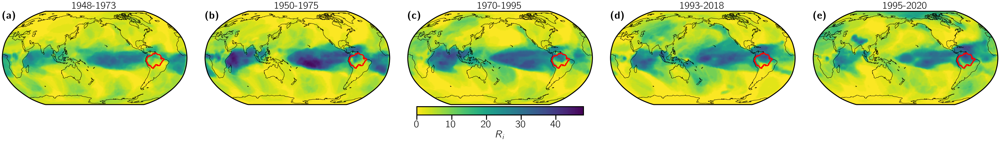

In [ ]:
n = 4
middle = (len(dates)-1)/2
num_pts_for_half = (n-1)/2
spacing = int(middle/num_pts_for_half)
dates_to_plot = [dates[i] for i in np.arange(middle-((n-1)/2)*spacing, middle+((n-1)/2+1)*spacing, spacing).astype(int)]
dates_to_plot = ['1948-1973', '1950-1975', '1970-1995', '1993-2018', '1995-2020']

max_value = 0
for date in dates_to_plot:
  max_value = max([max_value,max(d_i_dict[date])])



fontsize = 32

plt.rc('text', usetex=True)
plt.rc('xtick',labelsize=fontsize)
plt.rc('ytick',labelsize=fontsize)



fig = plt.figure(figsize=(10*len(dates_to_plot),5))

for i in range(len(dates_to_plot)):
  date = dates_to_plot[i]

  latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  ilat, ilon, idat = interpolate_scatter_data(latlon_icos, d_i_dict[date],
#                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
                     method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

  ax = plt.subplot2grid(shape=(1, len(dates_to_plot)), loc=(0, i), projection=ccrs.Robinson(central_longitude=180))

  ax.coastlines(zorder=5)

  min_value = 0

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  cmap = mpl.cm.viridis_r


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax.add_feature(amazon, facecolor='none', edgecolor='r', alpha=1, linewidth=3, zorder=6)


  # idat[idat < min_value] = np.NAN

  im = ax.contourf(ilon, ilat, idat, levels=levels,
                    cmap=cmap, alpha=1,
                    vmin=min_value, vmax=max_value,
                    transform=ccrs.PlateCarree(), zorder=4)
  for c in im.collections:
      c.set_edgecolor("face")
  im.set_clim(min_value, max_value)


  ax.annotate(r'\textbf{('+chr(97+i)+')}', xy=(0, 1), xycoords="axes fraction",
               fontsize=fontsize,usetex=True, va='top', ha='left')

  ax.set_title(date, fontsize=fontsize)

  plt.setp(ax.spines.values(), linewidth=3, zorder=100)
  ax.tick_params(length=15,width=3)


plt.tight_layout()
plt.subplots_adjust(wspace=-0.4)



cbar = fig.colorbar(im, ax = fig.get_axes(), orientation='horizontal',fraction=0.08, pad=0.02,
                    extend='min')
ticks = np.arange(min_value,max_value+1,10).astype(int)
cbar.set_ticks(ticks)
cbar.set_ticklabels(ticks)

# cbar=plt.colorbar(im, ax=ax, ticks=ticks[1::3], fraction=0.048, orientation='horizontal',
#                   pad=0.02, boundaries=levels)
# cbar.set_ticklabels(['{:.4f}'.format(tick) for tick in ticks[1::3]])

# cbar.set_label('Slope of Trendline of Average Diffusion Distance to Amazon\n$t = $ '+
#                '{:.4f}'.format(round(t_target, 4)),fontsize=fontsize)
cbar.set_label(r'$R_{i,out}$',fontsize=fontsize)

cbar.outline.set_linewidth(3)
cbar.ax.tick_params(length=15,width=3)

title = 'Amazon Connectivity (1)'
plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)
plt.show()
plt.close(fig)

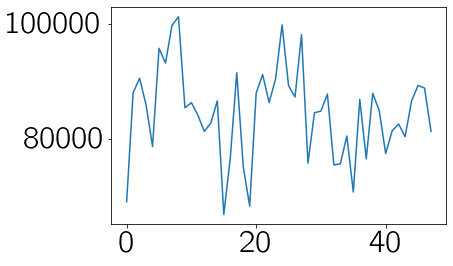

In [ ]:
plt.plot([sum(d_i_dict[date]) for date in dates])

In [ ]:
print(fig.get_axes())

[<GeoAxes: title={'center': '1949-1974'}>, <GeoAxes: title={'center': '1964-1989'}>, <GeoAxes: title={'center': '1979-2004'}>, <GeoAxes: title={'center': '1994-2019'}>, <Axes: label='<colorbar>', xlabel='$d_i$'>]


In [ ]:
n = 4
middle = (len(dates)-1)/2
num_pts_for_half = (n-1)/2
spacing = int(middle/num_pts_for_half)
dates_to_plot = [dates[i] for i in np.arange(middle-((n-1)/2)*spacing, middle+((n-1)/2+1)*spacing, spacing).astype(int)]

max_value = 0
for date in dates_to_plot:
  max_value = max([max_value,max(d_i_dict[date])])

print(max_value)

50


In [ ]:
print([round(a) for a in np.linspace(0,len(dates)-1,5)])

[0, 12, 24, 35, 47]


In [ ]:
n = 5
spacing = min([int(round(len(dates)/2)/(n//2)),int((len(dates)-1 - round(len(dates)/2))/(n//2))])
middle = round(len(dates)/2)
print([a for a in np.arange(middle-(n//2)*spacing,middle+(n//2+1)*spacing,spacing)])

[1, 13, 25, 37, 49]


In [ ]:
n = 5
middle = (len(dates)-1)/2
spacing = min([middle/(n//2),(len(dates)-1 - middle)/(n//2)])

print([round(a) for a in np.arange(middle-(n//2)*spacing,middle+(n//2+1)*spacing,spacing)])

[0, 12, 24, 37, 49]


In [ ]:
n = 4
middle = (len(dates)-1)/2
num_pts_for_half = (n-1)/2
spacing = int(middle/num_pts_for_half)
print(np.arange(middle-((n-1)/2)*spacing, middle+((n-1)/2+1)*spacing, spacing).astype(int))

[ 1 16 31 46]


In [ ]:
node_matches = match_nodes(dates,finallons_dict,finallats_dict)

Matching:   0%|          | 0/47 [00:00<?, ?it/s]

In [ ]:
print(node_matches[i,0])

4


In [ ]:
d_i_trend = get_trend(d_i_dict,dates,finallons_dict,finallats_dict,normalize=False)

Matching:   0%|          | 0/47 [00:00<?, ?it/s]

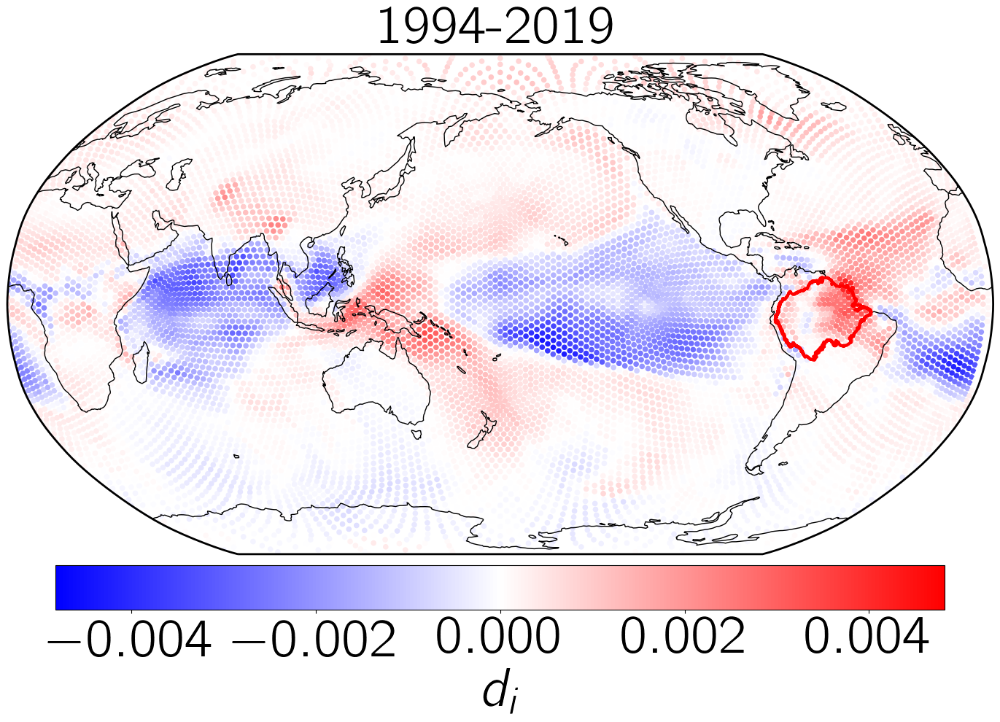

In [ ]:
fontsize = 54

plt.rc('text', usetex=True)
plt.rc('xtick',labelsize=fontsize)
plt.rc('ytick',labelsize=fontsize)


# fig, axs = plt.subplots(1,1,sharex=True,figsize=(20,10))
fig = plt.figure(figsize=(20,10))

ax1 = plt.subplot2grid(shape=(1, 1), loc=(0, 0), projection=ccrs.Robinson(central_longitude=180))



# plt.subplots_adjust(hspace=0, wspace=0.15)



### AXIS 1, RANDOM WALK MAP
ax1.coastlines(zorder=5)


# min_value = np.nanmin(idat)
# max_value = np.nanmax(idat)
# min_value = min(np.delete(dist_trend,amazon_nodes_corrected))
# max_value = max(np.delete(dist_trend,amazon_nodes_corrected))
max_value = max([abs(np.min(d_i_trend)), np.max(d_i_trend)])
min_value = -abs(max_value)

# idat1 = idat
# idat1[np.where(idat < min_value)] = min_value

levels = np.linspace(min_value,max_value,100)
ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

# midpoint = -min_value/(max_value-min_value)
cmap = mpl.cm.bwr
# shifted_cmap = shiftedColorMap(cmap, midpoint=midpoint)


reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
ax1.add_feature(amazon, facecolor='none', edgecolor='r', alpha=1, linewidth=3, zorder=6)

im = ax1.scatter(finallons_dict[dates[0]], finallats_dict[dates[0]],
                  c=d_i_trend,
                  cmap='bwr', transform=ccrs.PlateCarree(), marker='o', s=20,
                  edgecolors=None)
im.set_clim(min_value, max_value)
cbar=plt.colorbar(im, ax=ax1, orientation='horizontal',fraction=0.08, pad=0.02)
# ticks = np.array([-5,-4,-3,-2,-1,0,1,2])
# cbar.set_ticks(ticks*1e-5)
# cbar.set_ticklabels(ticks)

# cbar=plt.colorbar(im, ax=ax1, ticks=ticks[1::3], fraction=0.048, orientation='horizontal',
#                   pad=0.02, boundaries=levels)
# cbar.set_ticklabels(['{:.4f}'.format(tick) for tick in ticks[1::3]])

# cbar.set_label('Slope of Trendline of Average Diffusion Distance to Amazon\n$t = $ '+
#                '{:.4f}'.format(round(t_target, 4)),fontsize=fontsize)
cbar.set_label(r'$d_i$',fontsize=fontsize)

plt.setp(ax1.spines.values(), linewidth=2)

plt.title(date, fontsize=fontsize)



plt.tight_layout()



title = 'Random Walk'
# plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
# plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)

plt.show()

#KNN Networks

In [ ]:
with gzip.open(data_dir + 'icosahedral_grid.data', 'rb') as file:
  latlon_icos = np.array(pkl.load(file))

months = 300
offset = 365.25
k = 5

dir_end = '-months='+str(months)+',offset='+str(offset)+',k={:}'.format(k)+'/'

edge_dir = data_dir + 'edge_list' + dir_end

total_networks = len(os.listdir(edge_dir))

num_nodes = 10242

with gzip.open(data_dir + 'year_intervals-months='+str(months)+',offset='+str(offset) + '.data', 'rb') as file:
  year_intervals = pkl.load(file)

with gzip.open(data_dir + 'date_intervals-months='+str(months)+',offset='+str(offset) + '.data', 'rb') as file:
  date_intervals = pkl.load(file)

dates = [year_intervals[i][0] + '-' + year_intervals[i][1] for i in range(len(year_intervals))]
print(dates)

reader = shpreader.Reader(base_dir+'Amazon Biome/amazonia.shp')
amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())

recompute = False

if recompute:
  amazon_nodes = []

  for i in range(num_nodes):
    if amazon._geoms[0].contains(Point(latlon_icos[i,1]-360,latlon_icos[i,0])):
      amazon_nodes.append(i)

  with gzip.open(data_dir + 'amazon_nodes_new_networks.data', 'wb') as file:
    pkl.dump(amazon_nodes, file)
else:
  with gzip.open(data_dir + 'amazon_nodes_new_networks.data', 'rb') as file:
    amazon_nodes = pkl.load(file)

recompute = False

graph_dir = data_dir + 'G' + dir_end
if recompute:
  if not os.path.isdir(graph_dir):
    os.mkdir(graph_dir)

  for i in trange(len(dates)):
    date = dates[i]

    with gzip.open(edge_dir + str(i) + '.data', 'rb') as file:
      edge_list = pkl.load(file)

    G = nx.from_edgelist(edge_list, nx.DiGraph) # initiall unsorted

    H = nx.DiGraph() # make sorted copy
    H.add_nodes_from(sorted(G.nodes(data=True)))
    H.add_edges_from(G.edges(data=True))
    G = H # write over original with sorted copy
    del H # delete sorted copy

    degrees = [d[1] for d in G.degree()]

    print(i, nx.density(G), nx.number_strongly_connected_components(G), G.number_of_edges(), min(degrees), max(degrees), np.mean(degrees))

    # with gzip.open(graph_dir + date + '.data', 'wb') as file:
    #   pkl.dump(G, file)

['1948-1973', '1949-1974', '1950-1975', '1951-1976', '1952-1977', '1953-1978', '1954-1979', '1955-1980', '1956-1981', '1957-1982', '1958-1983', '1959-1984', '1960-1985', '1961-1986', '1962-1987', '1963-1988', '1964-1989', '1965-1990', '1966-1991', '1967-1992', '1968-1993', '1969-1994', '1970-1995', '1971-1996', '1972-1997', '1973-1998', '1974-1999', '1975-2000', '1976-2001', '1977-2002', '1978-2003', '1979-2004', '1980-2005', '1981-2006', '1982-2007', '1983-2008', '1984-2009', '1985-2010', '1986-2011', '1987-2012', '1988-2013', '1989-2014', '1990-2015', '1991-2016', '1992-2017', '1993-2018', '1994-2019', '1995-2020', '1996-2021', '1997-2022', '1998-2023']


In [ ]:
ks = [50, 100, 250, 500, 1000]

R_i_out_dict_vary_k = {k:{date:[None]*num_nodes for date in dates} for k in ks}



recompute = False

save_each_step = False

if recompute:
  for k in ks:
    dir_end = '-months='+str(months)+',offset='+str(offset)+',k={:}'.format(k)+'/'

    graph_dir = data_dir + 'G' + dir_end

    for i in trange(len(dates)):
      date = dates[i]

      f = gzip.open(graph_dir + date+'.data','rb')
      G = pkl.load(f)
      f.close()

      all_edges = np.array([e for e in G.edges])

      # H = nx.Graph() # make sorted copy
      # H.add_nodes_from(sorted(G.nodes(data=True)))
      # H.add_edges_from(G.edges(amazon_nodes, data=True))

      for j in trange(G.number_of_nodes(), leave=False, desc=date):
        # R_i_out_dict_vary_k[k][date][j] = np.sum([1 if neighbor in amazon_nodes else 0 for neighbor in G.neighbors(j)])
        R_i_out_dict_vary_k[k][date][j] = len(np.where(np.in1d(all_edges[np.where(all_edges[:,0] == j)][:,1], amazon_nodes) == True)[0])

    if save_each_step:
      with gzip.open(data_dir + 'R_i_out_dict_vary_k,k={:}.data'.format(k), 'wb') as file:
        pkl.dump(R_i_out_dict_vary_k[k], file)

  if not save_each_step:
    with gzip.open(data_dir + 'R_i_out_dict_vary_k.data', 'wb') as file:
      pkl.dump(R_i_out_dict_vary_k, file)
else:
  if not save_each_step:
    with gzip.open(data_dir + 'R_i_out_dict_vary_k.data', 'rb') as file:
      R_i_out_dict_vary_k = pkl.load(file)
  else:
    R_i_out_dict_vary_k = {k:{} for k in ks}
    for k in ks:
      with gzip.open(data_dir + 'R_i_out_dict_vary_k,k={:}.data'.format(k), 'rb') as file:
        R_i_out_dict_vary_k[k] = pkl.load(file)

In [ ]:
ks = [50, 100, 250, 500, 1000]

R_i_in_dict_vary_k = {k:{date:[None]*num_nodes for date in dates} for k in ks}



recompute = False

save_each_step = False

if recompute:
  for k in ks:
    dir_end = '-months='+str(months)+',offset='+str(offset)+',k={:}'.format(k)+'/'

    graph_dir = data_dir + 'G' + dir_end

    for i in trange(len(dates)):
      date = dates[i]

      f = gzip.open(graph_dir + date+'.data','rb')
      G = pkl.load(f)
      f.close()

      all_edges = np.array([e for e in G.edges])
      amazon_edges_out = all_edges[np.where(np.in1d(all_edges[:,0], amazon_nodes) == True)]

      # H = nx.Graph() # make sorted copy
      # H.add_nodes_from(sorted(G.nodes(data=True)))
      # H.add_edges_from(G.edges(amazon_nodes, data=True))

      for j in trange(G.number_of_nodes(), leave=False, desc=date):
        # R_i_in_dict_vary_k[k][date][j] = np.sum([1 if neighbor in amazon_nodes else 0 for neighbor in G.neighbors(j)])
        R_i_in_dict_vary_k[k][date][j] = len(np.where(amazon_edges_out[:,1] == j)[0])

    if save_each_step:
      with gzip.open(data_dir + 'R_i_in_dict_vary_k,k={:}.data'.format(k), 'wb') as file:
        pkl.dump(R_i_in_dict_vary_k[k], file)

  if not save_each_step:
    with gzip.open(data_dir + 'R_i_in_dict_vary_k.data', 'wb') as file:
      pkl.dump(R_i_in_dict_vary_k, file)
else:
  with gzip.open(data_dir + 'R_i_in_dict_vary_k.data', 'rb') as file:
    R_i_in_dict_vary_k = pkl.load(file)

In [ ]:
R_i_out_dict_vary_k = {k:{date:np.array(R_i_out_dict_vary_k[k][date])/min(len(amazon_nodes),k) for date in dates} for k in ks}
R_i_in_dict_vary_k = {k:{date:np.array(R_i_in_dict_vary_k[k][date])/len(amazon_nodes) for date in dates} for k in ks}

In [ ]:
fig_vary_dir = fig_dir + 'Vary k/'
if not os.path.isdir(fig_vary_dir):
  os.mkdir(fig_vary_dir)

In [ ]:
for k in ks:
  n = 5
  spacing = min([int(round(len(dates)/2)/(n//2)),int((len(dates)-1 - round(len(dates)/2))/(n//2))])
  middle = round(len(dates)/2)
  print()
  dates_to_plot = [dates[0], dates[len(dates)//2], dates[-1]]
  # dates_to_plot = ['1948-1973', '1950-1975', '1970-1995', '1993-2018', '1995-2020']

  max_value = 0
  for date in dates_to_plot:
    max_value = max([max_value,max(R_i_out_dict_vary_k[k][date])])



  fontsize = 36

  plt.rc('text', usetex=True)
  plt.rc('xtick',labelsize=fontsize)
  plt.rc('ytick',labelsize=fontsize)

  # serif_font = fm.FontProperties(fname=font_dir+'cmr10.ttf', size=fontsize, math_fontfamily='cm')
  # fpath = Path(font_dir+'cmr10.ttf')

  fig = plt.figure(figsize=(10*len(dates_to_plot),5))

  for i in range(len(dates_to_plot)):
    date = dates_to_plot[i]
    title = datetime.strptime(date_intervals[dates.index(date)][0], '%m/%d/%Y').strftime('%b %d, %Y') + ' - ' + datetime.strptime(date_intervals[dates.index(date)][1], '%m/%d/%Y').strftime('%b %d, %Y')

  #   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  #   ilat, ilon, idat = interpolate_scatter_data(latlon_icos, R_i_out_dict_vary_k[k][date],
  # #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
  #                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

    ax = plt.subplot2grid(shape=(1, len(dates_to_plot)), loc=(0, i), projection=ccrs.Robinson(central_longitude=180))

    ax.coastlines(zorder=5)

    # min_value = 1/len(amazon_nodes)
    null_rate = 1#max(1,int(k*(num_nodes-1)/4*len(amazon_nodes)/num_nodes))
    min_value = null_rate/len(amazon_nodes)
    # print(k*(num_nodes-1)/4*len(amazon_nodes)/num_nodes)
    # print(G.number_of_edges()/G.number_of_nodes()/2)
    # print(len(amazon_nodes)/G.number_of_nodes())
    # print(G.number_of_edges()/G.number_of_nodes()/2*len(amazon_nodes)/G.number_of_nodes())

    levels = np.linspace(min_value,max_value,100)
    ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

    cmap = mpl.cm.plasma_r


    reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
    amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
    ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)



    ind = np.where(R_i_out_dict_vary_k[k][date] > 0)[0]

    # idat[idat < min_value] = np.NAN

    # im = ax.contourf(ilon, ilat, idat, levels=levels,
    #                   cmap=cmap, alpha=1,
    #                   vmin=min_value, vmax=max_value,
    #                   transform=ccrs.PlateCarree(), zorder=4)
    im = ax.scatter(latlon_icos[ind,1], latlon_icos[ind,0],
                    c=R_i_out_dict_vary_k[k][date][ind],
                    cmap='plasma_r', transform=ccrs.PlateCarree(), marker='o', s=20,
                    edgecolors=None)
    ax.scatter(latlon_icos[:,1], latlon_icos[:,0],
                    c=R_i_out_dict_vary_k[k][date][:],
                    cmap='plasma_r', transform=ccrs.PlateCarree(), marker='o', s=0,
                    edgecolors=None, zorder=100, alpha=0)
    # ax.set_extent([-180,180,-90,90], crs=ccrs.PlateCarree())
    # for c in im.collections:
    #     c.set_edgecolor("face")
    im.set_clim(min_value, max_value)

    im.cmap.set_under('w')

    ax.annotate(r'\textbf{('+chr(97+i)+')}', xy=(0, 1), xycoords="axes fraction",
                fontsize=fontsize,usetex=True, va='top', ha='left')

    ax.set_title(title, fontsize=fontsize)

    plt.setp(ax.spines.values(), linewidth=3, zorder=100)
    ax.tick_params(length=15,width=3)


  plt.tight_layout()
  plt.subplots_adjust(wspace=-0.25)

  cbar = fig.colorbar(im, ax = fig.get_axes(), anchor=(0.475, 0),
                      orientation='horizontal',fraction=0.08, pad=0.02,
                      extend='min')
  ticks = np.linspace(min_value,max_value,3)
  cbar.set_ticks(ticks)
  cbar.set_ticklabels(['{:.1f}'.format(ticks[i]) for i in range(len(ticks))],usetex=True)







  # cbar=plt.colorbar(im, ax=ax, ticks=ticks[1::3], fraction=0.048, orientation='horizontal',
  #                   pad=0.02, boundaries=levels)
  # cbar.set_ticklabels(['{:.4f}'.format(tick) for tick in ticks[1::3]])

  # cbar.set_label('Slope of Trendline of Average Diffusion Distance to Amazon\n$t = $ '+
  #                '{:.4f}'.format(round(t_target, 4)),fontsize=fontsize)
  cbar.set_label(r'$R_{i,out}/\min(N_A,K)$',fontsize=fontsize)

  cbar.outline.set_linewidth(3)
  cbar.ax.tick_params(length=15,width=3)

  title = 'Amazon Connectivity Out, k={:}'.format(k)
  plt.savefig(fig_vary_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
  plt.savefig(fig_vary_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)
  plt.show()
  plt.close(fig)

In [ ]:
for k in ks:
  n = 5
  spacing = min([int(round(len(dates)/2)/(n//2)),int((len(dates)-1 - round(len(dates)/2))/(n//2))])
  middle = round(len(dates)/2)
  print()
  dates_to_plot = [dates[0], dates[len(dates)//2], dates[-1]]
  # dates_to_plot = ['1948-1973', '1950-1975', '1970-1995', '1993-2018', '1995-2020']

  max_value = 0
  for date in dates_to_plot:
    max_value = max([max_value,max(R_i_in_dict_vary_k[k][date])])



  fontsize = 36

  plt.rc('text', usetex=True)
  plt.rc('xtick',labelsize=fontsize)
  plt.rc('ytick',labelsize=fontsize)

  # serif_font = fm.FontProperties(fname=font_dir+'cmr10.ttf', size=fontsize, math_fontfamily='cm')
  # fpath = Path(font_dir+'cmr10.ttf')

  fig = plt.figure(figsize=(10*len(dates_to_plot),5))

  for i in range(len(dates_to_plot)):
    date = dates_to_plot[i]
    title = datetime.strptime(date_intervals[dates.index(date)][0], '%m/%d/%Y').strftime('%b %d, %Y') + ' - ' + datetime.strptime(date_intervals[dates.index(date)][1], '%m/%d/%Y').strftime('%b %d, %Y')

  #   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  #   ilat, ilon, idat = interpolate_scatter_data(latlon_icos, R_i_in_dict_vary_k[k][date],
  # #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
  #                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

    ax = plt.subplot2grid(shape=(1, len(dates_to_plot)), loc=(0, i), projection=ccrs.Robinson(central_longitude=180))

    ax.coastlines(zorder=5)

    # min_value = 1/len(amazon_nodes)
    null_rate = 1#max(1,int(k*(num_nodes-1)/4*len(amazon_nodes)/num_nodes))
    min_value = null_rate/len(amazon_nodes)
    # print(k*(num_nodes-1)/4*len(amazon_nodes)/num_nodes)
    # print(G.number_of_edges()/G.number_of_nodes()/2)
    # print(len(amazon_nodes)/G.number_of_nodes())
    # print(G.number_of_edges()/G.number_of_nodes()/2*len(amazon_nodes)/G.number_of_nodes())

    levels = np.linspace(min_value,max_value,100)
    ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

    cmap = mpl.cm.plasma_r


    reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
    amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
    ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)



    ind = np.where(R_i_in_dict_vary_k[k][date] > 0)[0]

    # idat[idat < min_value] = np.NAN

    # im = ax.contourf(ilon, ilat, idat, levels=levels,
    #                   cmap=cmap, alpha=1,
    #                   vmin=min_value, vmax=max_value,
    #                   transform=ccrs.PlateCarree(), zorder=4)
    im = ax.scatter(latlon_icos[ind,1], latlon_icos[ind,0],
                    c=R_i_in_dict_vary_k[k][date][ind],
                    cmap='plasma_r', transform=ccrs.PlateCarree(), marker='o', s=20,
                    edgecolors=None)
    ax.scatter(latlon_icos[:,1], latlon_icos[:,0],
                    c=R_i_in_dict_vary_k[k][date][:],
                    cmap='plasma_r', transform=ccrs.PlateCarree(), marker='o', s=0,
                    edgecolors=None, zorder=100, alpha=0)
    # ax.set_extent([-180,180,-90,90], crs=ccrs.PlateCarree())
    # for c in im.collections:
    #     c.set_edgecolor("face")
    im.set_clim(min_value, max_value)

    im.cmap.set_under('w')

    ax.annotate(r'\textbf{('+chr(97+i)+')}', xy=(0, 1), xycoords="axes fraction",
                fontsize=fontsize,usetex=True, va='top', ha='left')

    ax.set_title(title, fontsize=fontsize)

    plt.setp(ax.spines.values(), linewidth=3, zorder=100)
    ax.tick_params(length=15,width=3)


  plt.tight_layout()
  plt.subplots_adjust(wspace=-0.25)

  cbar = fig.colorbar(im, ax = fig.get_axes(), anchor=(0.475, 0),
                      orientation='horizontal',fraction=0.08, pad=0.02,
                      extend='min')
  ticks = np.linspace(min_value,max_value,3)
  cbar.set_ticks(ticks)
  cbar.set_ticklabels(['{:.1f}'.format(ticks[i]) for i in range(len(ticks))],usetex=True)







  # cbar=plt.colorbar(im, ax=ax, ticks=ticks[1::3], fraction=0.048, orientation='horizontal',
  #                   pad=0.02, boundaries=levels)
  # cbar.set_ticklabels(['{:.4f}'.format(tick) for tick in ticks[1::3]])

  # cbar.set_label('Slope of Trendline of Average Diffusion Distance to Amazon\n$t = $ '+
  #                '{:.4f}'.format(round(t_target, 4)),fontsize=fontsize)
  cbar.set_label(r'$R_{i,in}/N_A$',fontsize=fontsize)

  cbar.outline.set_linewidth(3)
  cbar.ax.tick_params(length=15,width=3)

  title = 'Amazon Connectivity In, k={:}'.format(k)
  plt.savefig(fig_vary_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
  plt.savefig(fig_vary_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)
  plt.show()
  plt.close(fig)

In [ ]:
ks = [250, 500, 1000]

n = 5
spacing = min([int(round(len(dates)/2)/(n//2)),int((len(dates)-1 - round(len(dates)/2))/(n//2))])
middle = round(len(dates)/2)
print()
dates_to_plot = [dates[0], dates[len(dates)//2], dates[-1]]
# dates_to_plot = ['1948-1973', '1950-1975', '1970-1995', '1993-2018', '1995-2020']

max_value = 0
for k in ks:
  for date in dates_to_plot:
    max_value = max([max_value,max(R_i_out_dict_vary_k[k][date])])



fontsize = 36

plt.rc('text', usetex=True)
plt.rc('xtick',labelsize=fontsize)
plt.rc('ytick',labelsize=fontsize)

# serif_font = fm.FontProperties(fname=font_dir+'cmr10.ttf', size=fontsize, math_fontfamily='cm')
# fpath = Path(font_dir+'cmr10.ttf')

fig = plt.figure(figsize=(10*len(ks),5*len(dates_to_plot)))

for j in range(len(ks)):
  k = ks[j]
  for i in range(len(dates_to_plot)):
    date = dates_to_plot[i]
    title = datetime.strptime(date_intervals[dates.index(date)][0], '%m/%d/%Y').strftime('%b %d, %Y') + ' - ' + datetime.strptime(date_intervals[dates.index(date)][1], '%m/%d/%Y').strftime('%b %d, %Y')

  #   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  #   ilat, ilon, idat = interpolate_scatter_data(latlon_icos, R_i_out_dict_vary_k[k][date],
  # #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
  #                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

    ax = plt.subplot2grid(shape=(len(dates_to_plot), len(ks)), loc=(i, j), projection=ccrs.Robinson(central_longitude=180))

    ax.coastlines(zorder=5)

    min_value = 1/min(len(amazon_nodes), k)

    levels = np.linspace(min_value,max_value,100)
    ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

    cmap = mpl.cm.plasma_r


    reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
    amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
    ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)



    ind = np.where(R_i_out_dict_vary_k[k][date] >= min_value)[0]

    # idat[idat < min_value] = np.NAN

    # im = ax.contourf(ilon, ilat, idat, levels=levels,
    #                   cmap=cmap, alpha=1,
    #                   vmin=min_value, vmax=max_value,
    #                   transform=ccrs.PlateCarree(), zorder=4)
    im = ax.scatter(latlon_icos[ind,1], latlon_icos[ind,0],
                    c=R_i_out_dict_vary_k[k][date][ind],
                    cmap='plasma_r', transform=ccrs.PlateCarree(), marker='o', s=20,
                    edgecolors=None)
    ax.scatter(latlon_icos[:,1], latlon_icos[:,0],
                    c=R_i_out_dict_vary_k[k][date][:],
                    cmap='plasma_r', transform=ccrs.PlateCarree(), marker='o', s=0,
                    edgecolors=None, zorder=100, alpha=0)
    # ax.set_extent([-180,180,-90,90], crs=ccrs.PlateCarree())
    # for c in im.collections:
    #     c.set_edgecolor("face")
    im.set_clim(min_value, max_value)

    im.cmap.set_under('w')

    ax.annotate(r'\textbf{('+chr(97+i + j*len(dates_to_plot))+')}', xy=(0, 1), xycoords="axes fraction",
                fontsize=fontsize,usetex=True, va='top', ha='left')

    ax.set_title(title, fontsize=fontsize)

    plt.setp(ax.spines.values(), linewidth=3, zorder=100)
    ax.tick_params(length=15,width=3)

    if i == len(dates_to_plot) - 1:
      ax.annotate(r'$K = {:}$'.format(k), xy=(0.5,-0.05), va='top', ha='center', xycoords='axes fraction', fontsize=fontsize)


plt.tight_layout()
plt.subplots_adjust(hspace = 0.2, wspace = -0.4)

cbar = fig.colorbar(im, ax = fig.get_axes(), anchor=(0.468, 0),
                    orientation='horizontal',fraction=0.04, pad=0.06,
                    extend='min')
ticks = np.linspace(min_value,max_value,3)
cbar.set_ticks(ticks)
cbar.set_ticklabels(['{:.1f}'.format(ticks[i]) if i>0 else r'1$/\min(|U|,K)$' for i in range(len(ticks))],usetex=True)
# cbar.set_ticklabels(['{:.1f}'.format(ticks[i]) for i in range(len(ticks))],usetex=True)






# cbar=plt.colorbar(im, ax=ax, ticks=ticks[1::3], fraction=0.048, orientation='horizontal',
#                   pad=0.02, boundaries=levels)
# cbar.set_ticklabels(['{:.4f}'.format(tick) for tick in ticks[1::3]])

# cbar.set_label('Slope of Trendline of Average Diffusion Distance to Amazon\n$t = $ '+
#                '{:.4f}'.format(round(t_target, 4)),fontsize=fontsize)
cbar.set_label(r'$R_{i,out}/\min(|U|,K)$',fontsize=fontsize)

cbar.outline.set_linewidth(3)
cbar.ax.tick_params(length=15,width=3)

title = 'Amazon Connectivity Out (Vary k)'
plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)
plt.show()
plt.close(fig)

Output hidden; open in https://colab.research.google.com to view.

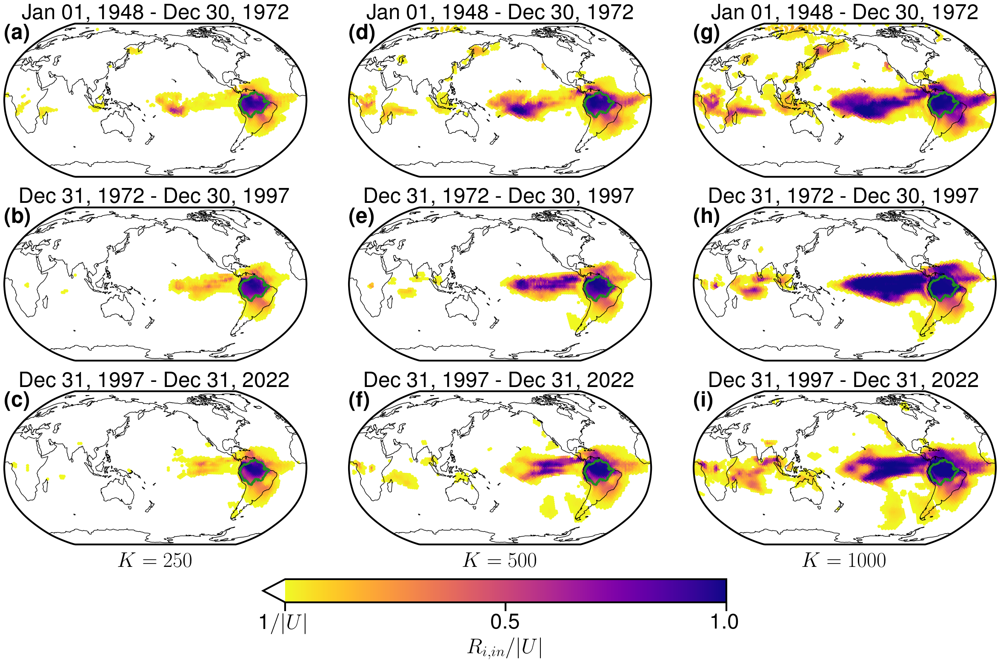

In [ ]:
n = 5
spacing = min([int(round(len(dates)/2)/(n//2)),int((len(dates)-1 - round(len(dates)/2))/(n//2))])
middle = round(len(dates)/2)
print()
dates_to_plot = [dates[0], dates[len(dates)//2], dates[-1]]
# dates_to_plot = ['1948-1973', '1950-1975', '1970-1995', '1993-2018', '1995-2020']

max_value = 0
for k in ks:
  for date in dates_to_plot:
    max_value = max([max_value,max(R_i_in_dict_vary_k[k][date])])



fontsize = 36

plt.rc('text', usetex=True)
plt.rc('xtick',labelsize=fontsize)
plt.rc('ytick',labelsize=fontsize)

# serif_font = fm.FontProperties(fname=font_dir+'cmr10.ttf', size=fontsize, math_fontfamily='cm')
# fpath = Path(font_dir+'cmr10.ttf')

fig = plt.figure(figsize=(10*len(ks),5*len(dates_to_plot)))

for j in range(len(ks)):
  k = ks[j]
  for i in range(len(dates_to_plot)):
    date = dates_to_plot[i]
    title = datetime.strptime(date_intervals[dates.index(date)][0], '%m/%d/%Y').strftime('%b %d, %Y') + ' - ' + datetime.strptime(date_intervals[dates.index(date)][1], '%m/%d/%Y').strftime('%b %d, %Y')

  #   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  #   ilat, ilon, idat = interpolate_scatter_data(latlon_icos, R_i_in_dict_vary_k[k][date],
  # #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
  #                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

    ax = plt.subplot2grid(shape=(len(dates_to_plot), len(ks)), loc=(i, j), projection=ccrs.Robinson(central_longitude=180))

    ax.coastlines(zorder=5)

    min_value = 1/len(amazon_nodes)

    levels = np.linspace(min_value,max_value,100)
    ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

    cmap = mpl.cm.plasma_r


    reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
    amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
    ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)



    ind = np.where(R_i_in_dict_vary_k[k][date] > 0)[0]

    # idat[idat < min_value] = np.NAN

    # im = ax.contourf(ilon, ilat, idat, levels=levels,
    #                   cmap=cmap, alpha=1,
    #                   vmin=min_value, vmax=max_value,
    #                   transform=ccrs.PlateCarree(), zorder=4)
    im = ax.scatter(latlon_icos[ind,1], latlon_icos[ind,0],
                    c=R_i_in_dict_vary_k[k][date][ind],
                    cmap='plasma_r', transform=ccrs.PlateCarree(), marker='o', s=20,
                    edgecolors=None)
    ax.scatter(latlon_icos[:,1], latlon_icos[:,0],
                    c=R_i_in_dict_vary_k[k][date][:],
                    cmap='plasma_r', transform=ccrs.PlateCarree(), marker='o', s=0,
                    edgecolors=None, zorder=100, alpha=0)
    # ax.set_extent([-180,180,-90,90], crs=ccrs.PlateCarree())
    # for c in im.collections:
    #     c.set_edgecolor("face")
    im.set_clim(min_value, max_value)

    im.cmap.set_under('w')

    ax.annotate(r'\textbf{('+chr(97+i + j*len(dates_to_plot))+')}', xy=(0, 1), xycoords="axes fraction",
                fontsize=fontsize,usetex=True, va='top', ha='left')

    ax.set_title(title, fontsize=fontsize)

    plt.setp(ax.spines.values(), linewidth=3, zorder=100)
    ax.tick_params(length=15,width=3)

    if i == len(dates_to_plot) - 1:
      ax.annotate(r'$K = {:}$'.format(k), xy=(0.5,-0.05), va='top', ha='center', xycoords='axes fraction', fontsize=fontsize)


plt.tight_layout()
plt.subplots_adjust(hspace = 0.2, wspace = -0.4)

cbar = fig.colorbar(im, ax = fig.get_axes(), anchor=(0.468, 0),
                    orientation='horizontal',fraction=0.04, pad=0.06,
                    extend='min')
ticks = np.linspace(min_value,max_value,3)
cbar.set_ticks(ticks)
cbar.set_ticklabels(['{:.1f}'.format(ticks[i]) if i>0 else r'1$/|U|$' for i in range(len(ticks))],usetex=True)
# cbar.set_ticklabels(['{:.1f}'.format(ticks[i]) for i in range(len(ticks))],usetex=True)






# cbar=plt.colorbar(im, ax=ax, ticks=ticks[1::3], fraction=0.048, orientation='horizontal',
#                   pad=0.02, boundaries=levels)
# cbar.set_ticklabels(['{:.4f}'.format(tick) for tick in ticks[1::3]])

# cbar.set_label('Slope of Trendline of Average Diffusion Distance to Amazon\n$t = $ '+
#                '{:.4f}'.format(round(t_target, 4)),fontsize=fontsize)
cbar.set_label(r'$R_{i,in}/|U|$',fontsize=fontsize)

cbar.outline.set_linewidth(3)
cbar.ax.tick_params(length=15,width=3)

title = 'Amazon Connectivity In (Vary k)'
plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)
plt.show()
plt.close(fig)

In [ ]:
R_i_out_trend_vary_k = {k:np.zeros((num_nodes,1)) for k in ks}

for k in ks:
  for node in range(num_nodes):
  #         slope, _ = np.polyfit(list(range(48)), [R_i_dict[date][node,1] for date in dates], 1)
      slope, _ = np.polyfit(list(range(len(dates))), [R_i_out_dict_vary_k[k][dates[i]][node] for i in range(len(dates))], 1)
      R_i_out_trend_vary_k[k][node] = slope

R_i_in_trend_vary_k = {k:np.zeros((num_nodes,1)) for k in ks}

for k in ks:
  for node in range(num_nodes):
  #         slope, _ = np.polyfit(list(range(48)), [R_i_dict[date][node,1] for date in dates], 1)
      slope, _ = np.polyfit(list(range(len(dates))), [R_i_in_dict_vary_k[k][dates[i]][node] for i in range(len(dates))], 1)
      R_i_in_trend_vary_k[k][node] = slope

In [ ]:
for k in ks:
  fontsize = 36

  plt.rc('text', usetex=True)
  plt.rc('xtick',labelsize=fontsize)
  plt.rc('ytick',labelsize=fontsize)


  # fig, axs = plt.subplots(1,1,sharex=True,figsize=(20,10))
  fig = plt.figure(figsize=(16,8))



  # latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  ilat, ilon, idat = interpolate_scatter_data(latlon_icos, list(R_i_out_trend_vary_k[k][:,0]),
  #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
                      method='linear', num_interp_pts=20, threshold_dateline=5, threshold_poles=15)

  #   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  #   ilat, ilon, idat = interpolate_scatter_data(latlon_icos, R_i_out_dict_vary_k[k][date],
  # #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
  #                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

  ax = plt.subplot2grid(shape=(1, 1), loc=(0, 0), projection=ccrs.Robinson(central_longitude=180))

  ax.coastlines(zorder=5)

  max_value = max([abs(np.min(R_i_out_trend_vary_k[k])), np.max(R_i_out_trend_vary_k[k])])
  min_value = -abs(max_value)

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  cmap = mpl.cm.PuOr_r




  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)

  im = ax.contourf(ilon, ilat, idat, levels=levels,
                  cmap=cmap, alpha=1,
                  vmin=min_value, vmax=max_value,
                  transform=ccrs.PlateCarree(), zorder=4)
  for c in im.collections:
      c.set_edgecolor("face")
  im.set_clim(min_value, max_value)


  # ax.set_title(title, fontsize=fontsize)

  plt.setp(ax.spines.values(), linewidth=3, zorder=100)
  ax.tick_params(length=15,width=3)

  # if i == len(dates_to_plot) - 1:
  #   ax.set_title(r'$\K = {:}$'.format(k), fontsize=fontsize, pad=10)

  plt.tight_layout()
  plt.subplots_adjust(hspace = 0.2, wspace = -0.5)

  cbar = fig.colorbar(im, ax = fig.get_axes(), anchor=(0.5, 0),
                      orientation='horizontal',fraction=0.08, pad=0.06)
  # ticks = [-0.015, 0, 0.015]
  # cbar.set_ticks(ticks)
  # cbar.set_ticklabels(['{:.3f}'.format(ticks[i]) for i in range(len(ticks))],usetex=True)
  tick_locator = mpl.ticker.MaxNLocator(nbins=5)
  cbar.locator = tick_locator
  cbar.update_ticks()


  cbar.set_label(r'$m_k\left(R_{i,out}^{(k)}/\min(N_A,K)\right)$',fontsize=fontsize, usetex=True)


  cbar.outline.set_linewidth(3)
  cbar.ax.tick_params(length=15,width=3)

  title = 'Amazon Connectivity Trend Out, K={:}'.format(k)
  # plt.savefig(fig_vary_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
  # plt.savefig(fig_vary_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)
  plt.show()
  plt.close(fig)

In [ ]:
for k in ks:
  fontsize = 36

  plt.rc('text', usetex=True)
  plt.rc('xtick',labelsize=fontsize)
  plt.rc('ytick',labelsize=fontsize)


  # fig, axs = plt.subplots(1,1,sharex=True,figsize=(20,10))
  fig = plt.figure(figsize=(16,8))



  # latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  ilat, ilon, idat = interpolate_scatter_data(latlon_icos, list(R_i_in_trend_vary_k[k][:,0]),
  #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

  #   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  #   ilat, ilon, idat = interpolate_scatter_data(latlon_icos, R_i_in_dict_vary_k[k][date],
  # #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
  #                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

  ax = plt.subplot2grid(shape=(1, 1), loc=(0, 0), projection=ccrs.Robinson(central_longitude=180))

  ax.coastlines(zorder=5)

  max_value = max([abs(np.min(R_i_in_trend_vary_k[k])), np.max(R_i_in_trend_vary_k[k])])
  min_value = -abs(max_value)

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  cmap = mpl.cm.bwr




  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)

  im = ax.contourf(ilon, ilat, idat, levels=levels,
                  cmap=cmap, alpha=1,
                  vmin=min_value, vmax=max_value,
                  transform=ccrs.PlateCarree(), zorder=4)
  for c in im.collections:
      c.set_edgecolor("face")
  im.set_clim(min_value, max_value)


  # ax.set_title(title, fontsize=fontsize)

  plt.setp(ax.spines.values(), linewidth=3, zorder=100)
  ax.tick_params(length=15,width=3)

  # if i == len(dates_to_plot) - 1:
  #   ax.set_title(r'$\K = {:}$'.format(k), fontsize=fontsize, pad=10)

  plt.tight_layout()
  plt.subplots_adjust(hspace = 0.2, wspace = -0.5)

  cbar = fig.colorbar(im, ax = fig.get_axes(), anchor=(0.5, 0),
                      orientation='horizontal',fraction=0.08, pad=0.06)
  # ticks = [-0.015, 0, 0.015]
  # cbar.set_ticks(ticks)
  # cbar.set_ticklabels(['{:.3f}'.format(ticks[i]) for i in range(len(ticks))],usetex=True)
  tick_locator = mpl.ticker.MaxNLocator(nbins=5)
  cbar.locator = tick_locator
  cbar.update_ticks()


  cbar.set_label(r'$m_w\left(R_{i,in}^{(w)}/N_A\right)$',fontsize=fontsize, usetex=True)


  cbar.outline.set_linewidth(3)
  cbar.ax.tick_params(length=15,width=3)

  title = 'Amazon Connectivity Trend In, K={:}'.format(k)
  plt.savefig(fig_vary_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
  plt.savefig(fig_vary_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)
  plt.show()
  plt.close(fig)

-0.017823147794799106 0.017823147794799106


Replacing Dateline:   0%|          | 0/40 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/80 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/40 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/80 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/40 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/80 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

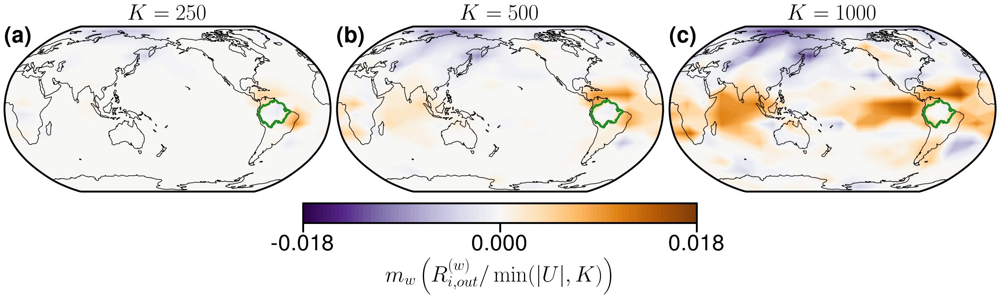

In [ ]:
ks = [250, 500, 1000]

max_value = max([abs(np.min([R_i_out_trend_vary_k[k] for k in ks])), np.max([R_i_out_trend_vary_k[k] for k in ks])])
min_value = -abs(max_value)
print(min_value, max_value)

fontsize = 36

plt.rc('text', usetex=True)
plt.rc('xtick',labelsize=fontsize)
plt.rc('ytick',labelsize=fontsize)


# fig, axs = plt.subplots(1,1,sharex=True,figsize=(20,10))
fig = plt.figure(figsize=(10*len(ks),5))

for j in range(len(ks)):
  k = ks[j]

  #   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  ilat, ilon, idat = interpolate_scatter_data(latlon_icos, list(R_i_out_trend_vary_k[k][:,0]),
  #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
                      method='linear', num_interp_pts=20, threshold_dateline=5, threshold_poles=15)

  ax = plt.subplot2grid(shape=(1, len(ks)), loc=(0, j), projection=ccrs.Robinson(central_longitude=180))

  ax.coastlines(zorder=5)

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  cmap = mpl.cm.PuOr_r


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)

  im = ax.contourf(ilon, ilat, idat, levels=levels,
                  cmap=cmap, alpha=1,
                  vmin=min_value, vmax=max_value,
                  transform=ccrs.PlateCarree(), zorder=4)
  for c in im.collections:
      c.set_edgecolor("face")
  im.set_clim(min_value, max_value)


  ax.annotate(r'\textbf{('+chr(97+j)+')}', xy=(0, 1), xycoords="axes fraction",
              fontsize=fontsize,usetex=True, va='top', ha='left')

  # ax.set_title(title, fontsize=fontsize)

  plt.setp(ax.spines.values(), linewidth=3, zorder=100)
  ax.tick_params(length=15,width=3)


  ax.set_title(r'$K = {:}$'.format(k), fontsize=fontsize, pad=10)

plt.tight_layout()
plt.subplots_adjust(hspace = 0.2, wspace = -0.5)

cbar = fig.colorbar(im, ax = fig.get_axes(), anchor=(0.5, 0),
                    orientation='horizontal',fraction=0.1, pad=0.06)
# ticks = [-0.015, 0, 0.015]
ticks = [min_value, 0, max_value]
cbar.set_ticks(ticks)
cbar.set_ticklabels(['{:.3f}'.format(ticks[i]) for i in range(len(ticks))],usetex=True)


cbar.set_label(r'$m_w\left(R_{i,out}^{(w)}/\min(|U|,K)\right)$',fontsize=fontsize, usetex=True)


cbar.outline.set_linewidth(3)
cbar.ax.tick_params(length=15,width=3)

title = 'Amazon Connectivity Trend Out (Vary k)'
# plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
# plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)
plt.show()
plt.close(fig)

-0.024047865670828093 0.024047865670828093


Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

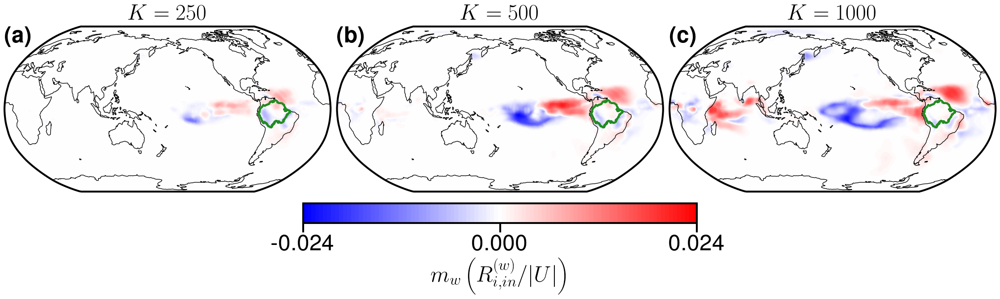

In [ ]:
max_value = max([abs(np.min([R_i_in_trend_vary_k[k] for k in ks])), np.max([R_i_in_trend_vary_k[k] for k in ks])])
min_value = -abs(max_value)
print(min_value, max_value)

fontsize = 36

plt.rc('text', usetex=True)
plt.rc('xtick',labelsize=fontsize)
plt.rc('ytick',labelsize=fontsize)


# fig, axs = plt.subplots(1,1,sharex=True,figsize=(20,10))
fig = plt.figure(figsize=(10*len(ks),5))

for j in range(len(ks)):
  k = ks[j]

  #   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  ilat, ilon, idat = interpolate_scatter_data(latlon_icos, list(R_i_in_trend_vary_k[k][:,0]),
  #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

  ax = plt.subplot2grid(shape=(1, len(ks)), loc=(0, j), projection=ccrs.Robinson(central_longitude=180))

  ax.coastlines(zorder=5)

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  cmap = mpl.cm.bwr


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)

  im = ax.contourf(ilon, ilat, idat, levels=levels,
                  cmap=cmap, alpha=1,
                  vmin=min_value, vmax=max_value,
                  transform=ccrs.PlateCarree(), zorder=4)
  for c in im.collections:
      c.set_edgecolor("face")
  im.set_clim(min_value, max_value)


  ax.annotate(r'\textbf{('+chr(97+j)+')}', xy=(0, 1), xycoords="axes fraction",
              fontsize=fontsize,usetex=True, va='top', ha='left')

  # ax.set_title(title, fontsize=fontsize)

  plt.setp(ax.spines.values(), linewidth=3, zorder=100)
  ax.tick_params(length=15,width=3)


  ax.set_title(r'$K = {:}$'.format(k), fontsize=fontsize, pad=10)

plt.tight_layout()
plt.subplots_adjust(hspace = 0.2, wspace = -0.5)

cbar = fig.colorbar(im, ax = fig.get_axes(), anchor=(0.5, 0),
                    orientation='horizontal',fraction=0.1, pad=0.06)
# ticks = [-0.015, 0, 0.015]
ticks = [min_value, 0, max_value]
cbar.set_ticks(ticks)
cbar.set_ticklabels(['{:.3f}'.format(ticks[i]) for i in range(len(ticks))],usetex=True)


cbar.set_label(r'$m_w\left(R_{i,in}^{(w)}/|U|\right)$',fontsize=fontsize, usetex=True)


cbar.outline.set_linewidth(3)
cbar.ax.tick_params(length=15,width=3)

title = 'Amazon Connectivity Trend In (Vary k)'
plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)
plt.show()
plt.close(fig)

#New Networks

In [ ]:
with gzip.open(data_dir + 'icosahedral_grid.data', 'rb') as file:
  latlon_icos = np.array(pkl.load(file))

months = 300
offset = 365.25
density = 0.05

edge_dir = data_dir + 'edge_list-months='+str(months)+',offset='+str(offset)+',density={:}'.format(density)+'/'

total_networks = len(os.listdir(edge_dir))

num_nodes = 10242

with gzip.open(data_dir + 'year_intervals-months='+str(months)+',offset='+str(offset) + '.data', 'rb') as file:
  year_intervals = pkl.load(file)

with gzip.open(data_dir + 'date_intervals-months='+str(months)+',offset='+str(offset) + '.data', 'rb') as file:
  date_intervals = pkl.load(file)

dates = [year_intervals[i][0] + '-' + year_intervals[i][1] for i in range(len(year_intervals))]
print(dates)

reader = shpreader.Reader(base_dir+'Amazon Biome/amazonia.shp')
amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())

recompute = False

if recompute:
  amazon_nodes = []

  for i in range(num_nodes):
    if amazon._geoms[0].contains(Point(latlon_icos[i,1]-360,latlon_icos[i,0])):
      amazon_nodes.append(i)

  with gzip.open(data_dir + 'amazon_nodes_new_networks.data', 'wb') as file:
    pkl.dump(amazon_nodes, file)
else:
  with gzip.open(data_dir + 'amazon_nodes_new_networks.data', 'rb') as file:
    amazon_nodes = pkl.load(file)

recompute = False

graph_dir = data_dir + 'G-months='+str(months)+',offset='+str(offset)+',density={:}'.format(density)+'/'
if recompute:
  if not os.path.isdir(graph_dir):
    os.mkdir(graph_dir)

  for i in trange(len(dates)):
    date = dates[i]

    with gzip.open(edge_dir + str(i) + '.data', 'rb') as file:
      edge_list = pkl.load(file)

    G = nx.from_edgelist(edge_list) # initiall unsorted

    H = nx.Graph() # make sorted copy
    H.add_nodes_from(sorted(G.nodes(data=True)))
    H.add_edges_from(G.edges(data=True))
    G = H # write over original with sorted copy
    del H # delete sorted copy

    print(i, nx.density(G))

    with gzip.open(graph_dir + date + '.data', 'wb') as file:
      pkl.dump(G, file)

['1948-1973', '1949-1974', '1950-1975', '1951-1976', '1952-1977', '1953-1978', '1954-1979', '1955-1980', '1956-1981', '1957-1982', '1958-1983', '1959-1984', '1960-1985', '1961-1986', '1962-1987', '1963-1988', '1964-1989', '1965-1990', '1966-1991', '1967-1992', '1968-1993', '1969-1994', '1970-1995', '1971-1996', '1972-1997', '1973-1998', '1974-1999', '1975-2000', '1976-2001', '1977-2002', '1978-2003', '1979-2004', '1980-2005', '1981-2006', '1982-2007', '1983-2008', '1984-2009', '1985-2010', '1986-2011', '1987-2012', '1988-2013', '1989-2014', '1990-2015', '1991-2016', '1992-2017', '1993-2018', '1994-2019', '1995-2020', '1996-2021', '1997-2022', '1998-2023']


In [ ]:
recompute = False

if recompute:
  R_i_dict = {date:[None]*num_nodes for date in dates}

  for i in trange(len(dates)):
    date = dates[i]

    f = gzip.open(graph_dir + date+'.data','rb')
    G = pkl.load(f)
    f.close()

    H = nx.Graph() # make sorted copy
    H.add_nodes_from(sorted(G.nodes(data=True)))
    H.add_edges_from(G.edges(amazon_nodes, data=True))

    for j in trange(G.number_of_nodes(), leave=False, desc=date):
      R_i_dict[date][j] = sum([1 if neighbor in amazon_nodes else 0 for neighbor in H.neighbors(j)])

    # node_index = [None]*G.number_of_nodes()
    # node_list = list(G.nodes())
    # for j in range(G.number_of_nodes()):
    #   node_index[node_list.index(j)] = j

    # R_i_dict[date] = [R_i_dict[date][node_index[j]] for j in range(len(node_list))]

  with gzip.open(data_dir + 'R_i_dict_new.data', 'wb') as file:
    pkl.dump(R_i_dict, file)
else:
  with gzip.open(data_dir + 'R_i_dict_new.data', 'rb') as file:
    R_i_dict = pkl.load(file)

In [ ]:
R_i_dict = {date:np.array(R_i_dict[date])/len(amazon_nodes) for date in dates}

In [ ]:
i = 0

date = dates[i]

f = gzip.open(graph_dir + date+'.data','rb')
G = pkl.load(f)
f.close()

# for e


# for j in trange(G.number_of_nodes(), leave=False, desc=date):
#   R_i_dict[date][j] = sum([1 if neighbor in amazon_nodes else 0 for neighbor in G.neighbors(j)])

In [ ]:
for date in dates:
  fontsize = 36

  plt.rc('text', usetex=True)
  plt.rc('xtick',labelsize=fontsize)
  plt.rc('ytick',labelsize=fontsize)


  # fig, axs = plt.subplots(1,1,sharex=True,figsize=(20,10))
  fig = plt.figure(figsize=(10,5))

  ax = plt.subplot2grid(shape=(1, 1), loc=(0, 0), projection=ccrs.Robinson(central_longitude=180))

  title = datetime.strptime(date_intervals[dates.index(date)][0], '%m/%d/%Y').strftime('%b %d, %Y') + ' - ' + datetime.strptime(date_intervals[dates.index(date)][1], '%m/%d/%Y').strftime('%b %d, %Y')

#   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
#   ilat, ilon, idat = interpolate_scatter_data(latlon_icos, R_i_dict[date],
# #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
#                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

  ax.coastlines(zorder=5)

  null_rate = max(1,int(density*(num_nodes-1)/4*len(amazon_nodes)/num_nodes))
  min_value = null_rate/len(amazon_nodes)
  max_value = 1

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  cmap = mpl.cm.plasma_r


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)



  ind = np.where(R_i_dict[date] > 0)[0]

  # idat[idat < min_value] = np.NAN

  # im = ax.contourf(ilon, ilat, idat, levels=levels,
  #                   cmap=cmap, alpha=1,
  #                   vmin=min_value, vmax=max_value,
  #                   transform=ccrs.PlateCarree(), zorder=4)
  im = ax.scatter(latlon_icos[ind,1], latlon_icos[ind,0],
                   c=R_i_dict[date][ind],
                   cmap='plasma_r', transform=ccrs.PlateCarree(), marker='o', s=20,
                   edgecolors=None)
  ax.scatter(latlon_icos[:,1], latlon_icos[:,0],
                   c=R_i_dict[date][:],
                   cmap='plasma_r', transform=ccrs.PlateCarree(), marker='o', s=0,
                   edgecolors=None, zorder=100, alpha=0)
  # ax.set_extent([-180,180,-90,90], crs=ccrs.PlateCarree())
  # for c in im.collections:
  #     c.set_edgecolor("face")
  im.set_clim(min_value, max_value)

  im.cmap.set_under('w')

  # ax.annotate(r'\textbf{('+chr(97+i)+')}', xy=(0, 1), xycoords="axes fraction",
  #              fontsize=fontsize,usetex=True, va='top', ha='left')

  ax.set_title(title, fontsize=fontsize)

  plt.setp(ax.spines.values(), linewidth=3, zorder=100)
  ax.tick_params(length=15,width=3)


  plt.tight_layout()
  plt.subplots_adjust(wspace=-0.25)

  cbar = fig.colorbar(im, ax = fig.get_axes(), anchor=(0.475, 0),
                      orientation='horizontal',fraction=0.08, pad=0.02,
                      extend='min')
  ticks = np.linspace(min_value,max_value,3)
  cbar.set_ticks(ticks)
  cbar.set_ticklabels(['{:.1f}'.format(ticks[i]) if i>0 else r'{:}$/N_A$'.format(null_rate) for i in range(len(ticks))],usetex=True)
  cbar.set_label(r'$R_{i,out}$',fontsize=fontsize)




  title = 'Random Walk'
  # plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
  # plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)

  plt.show()

In [ ]:
print(dates.index('1956-1981'))
start_ind = dates.index('1956-1981')
dates1 = dates[start_ind:]
n = 3
spacing = min([int(round(len(dates1)/2)/(n//2)),int((len(dates1)-1 - round(len(dates1)/2))/(n//2))])
middle = round(len(dates1)/2)
print([dates1[i] for i in np.arange(middle-(n//2)*spacing,middle+(n//2+1)*spacing,spacing)])

8
['1958-1983', '1978-2003', '1998-2023']


['1958-1983', '1978-2003', '1998-2023']


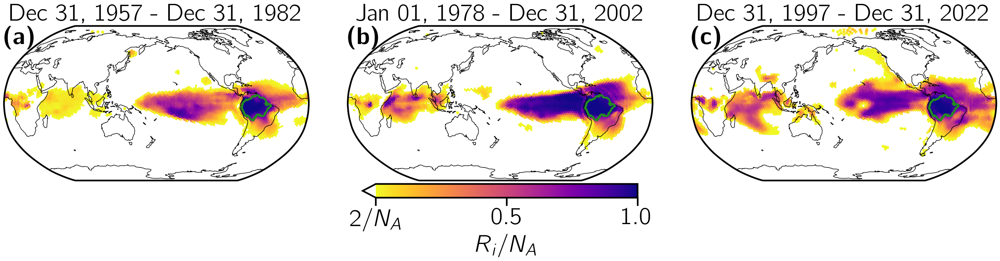

In [ ]:
# print(dates.index('1956-1981'))
start_ind = dates.index('1956-1981')
n = 3
spacing = min([int(round((len(dates)-start_ind)/2)/(n//2)),int(((len(dates)-start_ind)-1 - round((len(dates)-start_ind)/2))/(n//2))])
middle = round((len(dates)-start_ind)/2)
dates_to_plot = [dates[start_ind+i] for i in np.arange(middle-(n//2)*spacing,middle+(n//2+1)*spacing,spacing)]
print(dates_to_plot)

max_value = 0
for date in dates_to_plot:
  max_value = max([max_value,max(R_i_dict[date])])



fontsize = 44

plt.rc('text', usetex=True)
plt.rc('xtick',labelsize=fontsize)
plt.rc('ytick',labelsize=fontsize)

# serif_font = fm.FontProperties(fname=font_dir+'cmr10.ttf', size=fontsize, math_fontfamily='cm')
# fpath = Path(font_dir+'cmr10.ttf')

fig = plt.figure(figsize=(10*len(dates_to_plot),5))

for i in range(len(dates_to_plot)):
  date = dates_to_plot[i]
  title = datetime.strptime(date_intervals[dates.index(date)][0], '%m/%d/%Y').strftime('%b %d, %Y') + ' - ' + datetime.strptime(date_intervals[dates.index(date)][1], '%m/%d/%Y').strftime('%b %d, %Y')

#   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
#   ilat, ilon, idat = interpolate_scatter_data(latlon_icos, R_i_dict[date],
# #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
#                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

  ax = plt.subplot2grid(shape=(1, len(dates_to_plot)), loc=(0, i), projection=ccrs.Robinson(central_longitude=180))

  ax.coastlines(zorder=5)

  # min_value = 1/len(amazon_nodes)
  null_rate = max(1,int(density*(num_nodes-1)/4*len(amazon_nodes)/num_nodes))
  min_value = null_rate/len(amazon_nodes)
  # print(density*(num_nodes-1)/4*len(amazon_nodes)/num_nodes)
  # print(G.number_of_edges()/G.number_of_nodes()/2)
  # print(len(amazon_nodes)/G.number_of_nodes())
  # print(G.number_of_edges()/G.number_of_nodes()/2*len(amazon_nodes)/G.number_of_nodes())

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  cmap = mpl.cm.plasma_r


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)



  ind = np.where(R_i_dict[date] > 0)[0]

  # idat[idat < min_value] = np.NAN

  # im = ax.contourf(ilon, ilat, idat, levels=levels,
  #                   cmap=cmap, alpha=1,
  #                   vmin=min_value, vmax=max_value,
  #                   transform=ccrs.PlateCarree(), zorder=4)
  im = ax.scatter(latlon_icos[ind,1], latlon_icos[ind,0],
                  c=R_i_dict[date][ind],
                  cmap='plasma_r', transform=ccrs.PlateCarree(), marker='o', s=20,
                  edgecolors=None)
  ax.scatter(latlon_icos[:,1], latlon_icos[:,0],
                  c=R_i_dict[date][:],
                  cmap='plasma_r', transform=ccrs.PlateCarree(), marker='o', s=0,
                  edgecolors=None, zorder=100, alpha=0)
  # ax.set_extent([-180,180,-90,90], crs=ccrs.PlateCarree())
  # for c in im.collections:
  #     c.set_edgecolor("face")
  im.set_clim(min_value, max_value)

  im.cmap.set_under('w')

  ax.annotate(r'\textbf{('+chr(97+i)+')}', xy=(0, 1), xycoords="axes fraction",
              fontsize=fontsize,usetex=True, va='top', ha='left')

  ax.set_title(title, fontsize=fontsize, pad=10)

  plt.setp(ax.spines.values(), linewidth=3, zorder=100)
  ax.tick_params(length=15,width=3)


plt.tight_layout()
plt.subplots_adjust(wspace=-0.1*n)

cbar = fig.colorbar(im, ax = fig.get_axes(), anchor=(0.475, 0),
                    orientation='horizontal',fraction=0.08, pad=0.02,
                    extend='min')
ticks = np.linspace(min_value,max_value,3)
cbar.set_ticks(ticks)
cbar.set_ticklabels(['{:.1f}'.format(ticks[i]) if i>0 else r'{:}$/N_A$'.format(null_rate) for i in range(len(ticks))],usetex=True)







# cbar=plt.colorbar(im, ax=ax, ticks=ticks[1::3], fraction=0.048, orientation='horizontal',
#                   pad=0.02, boundaries=levels)
# cbar.set_ticklabels(['{:.4f}'.format(tick) for tick in ticks[1::3]])

# cbar.set_label('Slope of Trendline of Average Diffusion Distance to Amazon\n$t = $ '+
#                '{:.4f}'.format(round(t_target, 4)),fontsize=fontsize)
cbar.set_label(r'$R_{i,out}/N_A$',fontsize=fontsize)

cbar.outline.set_linewidth(3)
cbar.ax.tick_params(length=15,width=3)

title = 'Amazon Connectivity, rho={:}, n={:}'.format(density,n)
plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)
plt.show()
plt.close(fig)

In [ ]:
n = 5
spacing = min([int(round(len(dates1)/2)/(n//2)),int((len(dates1)-1 - round(len(dates1)/2))/(n//2))])
middle = round(len(dates1)/2)

In [ ]:
print(G.number_of_edges()/(G.number_of_nodes()*(G.number_of_nodes()-1)/2))

0.04990723371473137


In [ ]:
dates = dates[:-2]
print(len(dates))

48


In [ ]:
print(font_dir)

/usr/local/lib/python3.9/dist-packages/matplotlib/mpl-data/fonts/ttf/


In [ ]:
from pathlib import Path

In [ ]:
print(date_intervals[-1])

['12/31/1997', '12/31/2022']


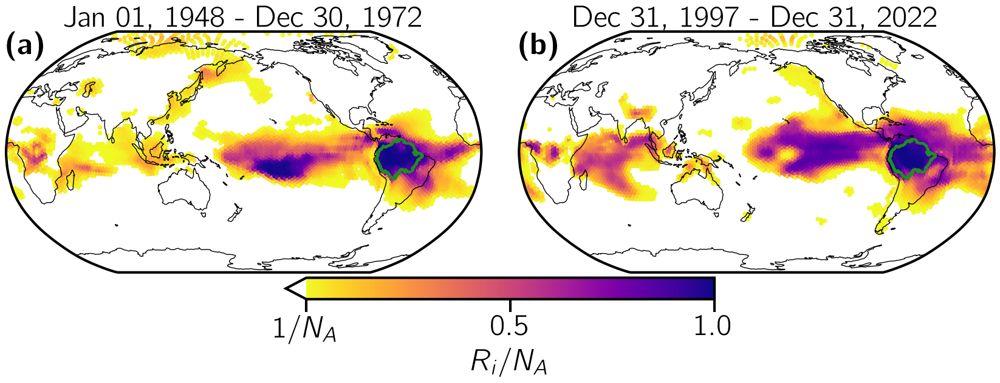

In [ ]:
n = 5
spacing = min([int(round(len(dates)/2)/(n//2)),int((len(dates)-1 - round(len(dates)/2))/(n//2))])
middle = round(len(dates)/2)
print()
dates_to_plot = [dates[0], dates[-1]]
# dates_to_plot = ['1948-1973', '1950-1975', '1970-1995', '1993-2018', '1995-2020']

max_value = 0
for date in dates_to_plot:
  max_value = max([max_value,max(R_i_dict[date])])



fontsize = 36

plt.rc('text', usetex=True)
plt.rc('xtick',labelsize=fontsize)
plt.rc('ytick',labelsize=fontsize)

# serif_font = fm.FontProperties(fname=font_dir+'cmr10.ttf', size=fontsize, math_fontfamily='cm')
# fpath = Path(font_dir+'cmr10.ttf')

fig = plt.figure(figsize=(10*len(dates_to_plot),5))

for i in range(len(dates_to_plot)):
  date = dates_to_plot[i]
  title = datetime.strptime(date_intervals[dates.index(date)][0], '%m/%d/%Y').strftime('%b %d, %Y') + ' - ' + datetime.strptime(date_intervals[dates.index(date)][1], '%m/%d/%Y').strftime('%b %d, %Y')

#   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
#   ilat, ilon, idat = interpolate_scatter_data(latlon_icos, R_i_dict[date],
# #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
#                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

  ax = plt.subplot2grid(shape=(1, len(dates_to_plot)), loc=(0, i), projection=ccrs.Robinson(central_longitude=180))

  ax.coastlines(zorder=5)

  min_value = 1/len(amazon_nodes)

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  cmap = mpl.cm.plasma_r


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)



  ind = np.where(R_i_dict[date] > 0)[0]

  # idat[idat < min_value] = np.NAN

  # im = ax.contourf(ilon, ilat, idat, levels=levels,
  #                   cmap=cmap, alpha=1,
  #                   vmin=min_value, vmax=max_value,
  #                   transform=ccrs.PlateCarree(), zorder=4)
  im = ax.scatter(latlon_icos[ind,1], latlon_icos[ind,0],
                   c=R_i_dict[date][ind],
                   cmap='plasma_r', transform=ccrs.PlateCarree(), marker='o', s=20,
                   edgecolors=None)
  ax.scatter(latlon_icos[:,1], latlon_icos[:,0],
                   c=R_i_dict[date][:],
                   cmap='plasma_r', transform=ccrs.PlateCarree(), marker='o', s=0,
                   edgecolors=None, zorder=100, alpha=0)
  # ax.set_extent([-180,180,-90,90], crs=ccrs.PlateCarree())
  # for c in im.collections:
  #     c.set_edgecolor("face")
  im.set_clim(min_value, max_value)

  im.cmap.set_under('w')

  ax.annotate(r'\textbf{('+chr(97+i)+')}', xy=(0, 1), xycoords="axes fraction",
               fontsize=fontsize,usetex=True, va='top', ha='left')

  ax.set_title(title, fontsize=fontsize)

  plt.setp(ax.spines.values(), linewidth=3, zorder=100)
  ax.tick_params(length=15,width=3)


plt.tight_layout()
plt.subplots_adjust(wspace=-0.25)

cbar = fig.colorbar(im, ax = fig.get_axes(), anchor=(0.475, 0),
                    orientation='horizontal',fraction=0.08, pad=0.02,
                    extend='min')
ticks = np.linspace(min_value,max_value,3)
cbar.set_ticks(ticks)
cbar.set_ticklabels(['{:.1f}'.format(ticks[i]) if i>0 else r'1$/N_A$' for i in range(len(ticks))],usetex=True)







# cbar=plt.colorbar(im, ax=ax, ticks=ticks[1::3], fraction=0.048, orientation='horizontal',
#                   pad=0.02, boundaries=levels)
# cbar.set_ticklabels(['{:.4f}'.format(tick) for tick in ticks[1::3]])

# cbar.set_label('Slope of Trendline of Average Diffusion Distance to Amazon\n$t = $ '+
#                '{:.4f}'.format(round(t_target, 4)),fontsize=fontsize)
cbar.set_label(r'$R_{i,out}/N_A$',fontsize=fontsize)

cbar.outline.set_linewidth(3)
cbar.ax.tick_params(length=15,width=3)

title = 'Amazon Connectivity (Normalized) (New Networks)'
# plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
# plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)
plt.show()
plt.close(fig)

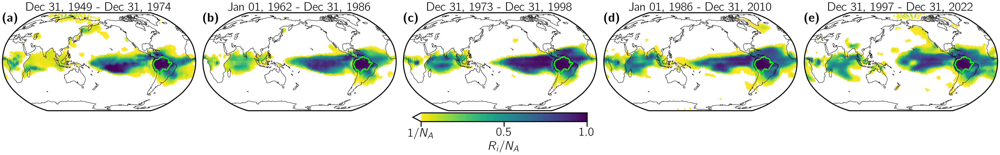

In [ ]:
n = 5
spacing = min([int(round(len(dates)/2)/(n//2)),int((len(dates)-1 - round(len(dates)/2))/(n//2))])
middle = round(len(dates)/2)
print()
dates_to_plot = [dates[i] for i in np.arange(middle-(n//2)*spacing,middle+(n//2+1)*spacing,spacing)]
# dates_to_plot = ['1948-1973', '1950-1975', '1970-1995', '1993-2018', '1995-2020']

max_value = 0
for date in dates_to_plot:
  max_value = max([max_value,max(R_i_dict[date])])



fontsize = 36

plt.rc('text', usetex=True)
plt.rc('xtick',labelsize=fontsize)
plt.rc('ytick',labelsize=fontsize)

# serif_font = fm.FontProperties(fname=font_dir+'cmr10.ttf', size=fontsize, math_fontfamily='cm')
# fpath = Path(font_dir+'cmr10.ttf')

fig = plt.figure(figsize=(10*len(dates_to_plot),5))

for i in range(len(dates_to_plot)):
  date = dates_to_plot[i]
  title = datetime.strptime(date_intervals[dates.index(date)][0], '%m/%d/%Y').strftime('%b %d, %Y') + ' - ' + datetime.strptime(date_intervals[dates.index(date)][1], '%m/%d/%Y').strftime('%b %d, %Y')

#   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
#   ilat, ilon, idat = interpolate_scatter_data(latlon_icos, R_i_dict[date],
# #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
#                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

  ax = plt.subplot2grid(shape=(1, len(dates_to_plot)), loc=(0, i), projection=ccrs.Robinson(central_longitude=180))

  ax.coastlines(zorder=5)

  min_value = 1/len(amazon_nodes)

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  cmap = mpl.cm.viridis_r


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax.add_feature(amazon, facecolor='none', edgecolor='lime', alpha=1, linewidth=3, zorder=6)



  ind = np.where(R_i_dict[date] > 0)[0]

  # idat[idat < min_value] = np.NAN

  # im = ax.contourf(ilon, ilat, idat, levels=levels,
  #                   cmap=cmap, alpha=1,
  #                   vmin=min_value, vmax=max_value,
  #                   transform=ccrs.PlateCarree(), zorder=4)
  im = ax.scatter(latlon_icos[ind,1], latlon_icos[ind,0],
                   c=R_i_dict[date][ind],
                   cmap='viridis_r', transform=ccrs.PlateCarree(), marker='o', s=20,
                   edgecolors=None)
  ax.scatter(latlon_icos[:,1], latlon_icos[:,0],
                   c=R_i_dict[date][:],
                   cmap='viridis_r', transform=ccrs.PlateCarree(), marker='o', s=0,
                   edgecolors=None, zorder=100, alpha=0)
  # ax.set_extent([-180,180,-90,90], crs=ccrs.PlateCarree())
  # for c in im.collections:
  #     c.set_edgecolor("face")
  im.set_clim(min_value, max_value)

  im.cmap.set_under('w')

  ax.annotate(r'\textbf{('+chr(97+i)+')}', xy=(0, 1), xycoords="axes fraction",
               fontsize=fontsize,usetex=True, va='top', ha='left')

  ax.set_title(title, fontsize=fontsize)

  plt.setp(ax.spines.values(), linewidth=3, zorder=100)
  ax.tick_params(length=15,width=3)


plt.tight_layout()
plt.subplots_adjust(wspace=-0.5)

cbar = fig.colorbar(im, ax = fig.get_axes(), anchor=(0.475, 0),
                    orientation='horizontal',fraction=0.08, pad=0.02,
                    extend='min')
ticks = np.linspace(min_value,max_value,3)
cbar.set_ticks(ticks)
cbar.set_ticklabels(['{:.1f}'.format(ticks[i]) if i>0 else r'1$/N_A$' for i in range(len(ticks))],usetex=True)







# cbar=plt.colorbar(im, ax=ax, ticks=ticks[1::3], fraction=0.048, orientation='horizontal',
#                   pad=0.02, boundaries=levels)
# cbar.set_ticklabels(['{:.4f}'.format(tick) for tick in ticks[1::3]])

# cbar.set_label('Slope of Trendline of Average Diffusion Distance to Amazon\n$t = $ '+
#                '{:.4f}'.format(round(t_target, 4)),fontsize=fontsize)
cbar.set_label(r'$R_{i,out}/N_A$',fontsize=fontsize)

cbar.outline.set_linewidth(3)
cbar.ax.tick_params(length=15,width=3)

title = 'Amazon Connectivity (Normalized) (New Networks)'
# plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
# plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)
plt.show()
plt.close(fig)

In [ ]:
n = 5
spacing = min([int(round(len(dates)/2)/(n//2)),int((len(dates)-1 - round(len(dates)/2))/(n//2))])
middle = round(len(dates)/2)
print()
dates_to_plot = [dates[i] for i in np.arange(middle-(n//2)*spacing,middle+(n//2+1)*spacing,spacing)]
# dates_to_plot = ['1948-1973', '1950-1975', '1970-1995', '1993-2018', '1995-2020']

max_value = 0
for date in dates_to_plot:
  max_value = max([max_value,max(R_i_dict[date])])



fontsize = 36

plt.rc('text', usetex=True)
plt.rc('xtick',labelsize=fontsize)
plt.rc('ytick',labelsize=fontsize)

serif_font = fm.FontProperties(fname=font_dir+'cmr10.ttf', size=fontsize, math_fontfamily='cm')
fpath = Path(font_dir+'cmr10.ttf')

fig = plt.figure(figsize=(10*len(dates_to_plot),5))

for i in range(len(dates_to_plot)):
  date = dates_to_plot[i]

#   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
#   ilat, ilon, idat = interpolate_scatter_data(latlon_icos, R_i_dict[date],
# #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
#                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

  ax = plt.subplot2grid(shape=(1, len(dates_to_plot)), loc=(0, i), projection=ccrs.Robinson(central_longitude=180))

  ax.coastlines(zorder=5)

  min_value = 1/len(amazon_nodes)

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  cmap = mpl.cm.viridis_r


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax.add_feature(amazon, facecolor='none', edgecolor='r', alpha=1, linewidth=3, zorder=6)



  ind = np.where(R_i_dict[date] > 0)[0]

  # idat[idat < min_value] = np.NAN

  # im = ax.contourf(ilon, ilat, idat, levels=levels,
  #                   cmap=cmap, alpha=1,
  #                   vmin=min_value, vmax=max_value,
  #                   transform=ccrs.PlateCarree(), zorder=4)
  im = ax.scatter(latlon_icos[ind,1], latlon_icos[ind,0],
                   c=R_i_dict[date][ind],
                   cmap='viridis_r', transform=ccrs.PlateCarree(), marker='o', s=20,
                   edgecolors=None)
  ax.scatter(latlon_icos[:,1], latlon_icos[:,0],
                   c=R_i_dict[date][:],
                   cmap='viridis_r', transform=ccrs.PlateCarree(), marker='o', s=0,
                   edgecolors=None, zorder=100, alpha=0)
  # ax.set_extent([-180,180,-90,90], crs=ccrs.PlateCarree())
  # for c in im.collections:
  #     c.set_edgecolor("face")
  im.set_clim(min_value, max_value)

  im.cmap.set_under('w')

  ax.annotate(r'\textbf{('+chr(97+i)+')}', xy=(0, 1), xycoords="axes fraction",
               fontsize=fontsize,usetex=True, va='top', ha='left')

  ax.set_title(date, fontsize=fontsize)

  plt.setp(ax.spines.values(), linewidth=3, zorder=100)
  ax.tick_params(length=15,width=3)


plt.tight_layout()
plt.subplots_adjust(wspace=-0.5)

cbar = fig.colorbar(im, ax = fig.get_axes(), anchor=(0.475, 0),
                    orientation='horizontal',fraction=0.08, pad=0.02,
                    extend='min')
ticks = np.linspace(min_value,max_value,3)
cbar.set_ticks(ticks)
cbar.set_ticklabels(['{:.1f}'.format(ticks[i]) if i>0 else r'1$/N_A$' for i in range(len(ticks))],usetex=True)







# cbar=plt.colorbar(im, ax=ax, ticks=ticks[1::3], fraction=0.048, orientation='horizontal',
#                   pad=0.02, boundaries=levels)
# cbar.set_ticklabels(['{:.4f}'.format(tick) for tick in ticks[1::3]])

# cbar.set_label('Slope of Trendline of Average Diffusion Distance to Amazon\n$t = $ '+
#                '{:.4f}'.format(round(t_target, 4)),fontsize=fontsize)
cbar.set_label(r'$R_{i,out}/N_A$',fontsize=fontsize)

cbar.outline.set_linewidth(3)
cbar.ax.tick_params(length=15,width=3)

title = 'Amazon Connectivity (Normalized) (1)'
# plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
# plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)
plt.show()
plt.close(fig)

NameError: ignored

In [ ]:
print(fm.findfont('serif'))

/usr/local/lib/python3.9/dist-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSerif.ttf


In [ ]:
print(cbar.__dict__)

{'mappable': <matplotlib.collections.PathCollection object at 0x7f0059a2ef70>, 'ax': <Axes: label='<colorbar>', xlabel='$R_i/N_A$'>, 'alpha': None, 'cmap': <matplotlib.colors.ListedColormap object at 0x7f0059dfad90>, 'norm': <matplotlib.colors.Normalize object at 0x7f0059a00e50>, 'values': None, 'boundaries': None, 'extend': 'min', '_inside': slice(1, None, None), 'spacing': 'uniform', 'orientation': 'horizontal', 'drawedges': False, '_filled': True, 'extendfrac': None, 'extendrect': False, '_extend_patches': [<matplotlib.patches.PathPatch object at 0x7f005a57e460>], 'solids': <matplotlib.collections.QuadMesh object at 0x7f0059a3adf0>, 'solids_patches': [], 'lines': [], 'outline': <matplotlib.colorbar._ColorbarSpine object at 0x7f0059a3a6a0>, 'dividers': <matplotlib.collections.LineCollection object at 0x7f0059a3a790>, '_locator': <matplotlib.ticker.FixedLocator object at 0x7f005a18f190>, '_minorlocator': <matplotlib.ticker.NullLocator object at 0x7f0059a3a430>, '_formatter': <matplotl

In [ ]:
mpl.font_manager.FontProperties(family='serif').set_math_fontfamily('cm')

In [ ]:
n = 4
middle = (len(dates)-1)/2
num_pts_for_half = (n-1)/2
spacing = int(middle/num_pts_for_half)
print([dates[i] for i in np.arange(middle-((n-1)/2)*spacing, middle+((n-1)/2+1)*spacing, spacing).astype(int))

In [ ]:
print(max_value)

166


In [ ]:
import statsmodels.api as sm

In [ ]:
for node in range(num_nodes):
  mod = sm.OLS(list(range(len(dates))), [R_i_dict[dates[i]][node] for i in range(len(dates))])

  res = mod.fit()

  if res.rsquared >= 0.975:
    break

In [ ]:
print(node)

1659


In [ ]:
from scipy.stats import linregress

-0.00013138526958512782 0.0001144850896799869 1029


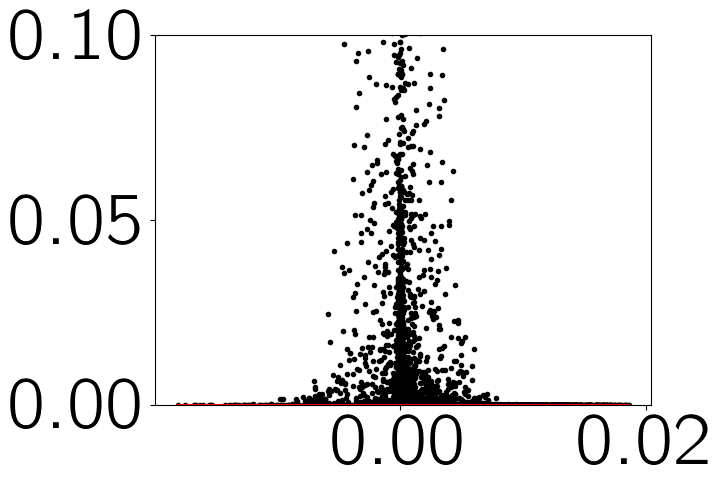

In [ ]:
p_values = [None]*num_nodes
R_i_trend = [None]*num_nodes

for node in range(num_nodes):
  slope, intercept, r_value, p_value, std_err = linregress(list(range(len(dates))), [R_i_dict[dates[i]][node] for i in range(len(dates))])
  p_values[node] = p_value
  R_i_trend[node] = slope

R_i_trend = np.array(R_i_trend)

p_value = 0.0000001

plt.plot(R_i_trend, p_values, 'k.')
plt.plot([min(R_i_trend), max(R_i_trend)], [p_value]*2, 'r')
plt.ylim(0, 0.1)


ind_significant = np.where(np.array(p_values) <= p_value)[0]
threshold_neg, threshold_pos = min(slopes), max(slopes)
for i in ind_significant:
  if slopes[i]<0 and slopes[i] > threshold_neg:
    threshold_neg = slopes[i]
  if slopes[i]>0 and slopes[i] < threshold_pos:
    threshold_pos = slopes[i]

print(threshold_neg, threshold_pos, len(ind_significant))

In [ ]:
print(min(R_i_trend), max(R_i_trend))

-0.018090824837812786 0.018648530774682443


In [ ]:
graph_dir = data_dir + 'G-months='+str(months)+',offset='+str(offset)+',density={:.2f}'.format(density)+'/'
with gzip.open(graph_dir + dates[0] + '.data', 'rb') as file:
  G = pkl.load(file)

print(nx.density(G))



0.04990723371473137


In [ ]:
print(G.number_of_edges()/G.number_of_nodes()/2)
print(len(amazon_nodes)/G.number_of_nodes())
print(G.number_of_edges()/G.number_of_nodes()/2*len(amazon_nodes)/G.number_of_nodes())

127.77499511814099
0.016207771919546962
2.070947977896056


In [ ]:
print(res.rsquared)

0.0


In [ ]:
R_i_trend = np.zeros((num_nodes,1))

for node in range(num_nodes):
#         slope, _ = np.polyfit(list(range(48)), [R_i_dict[date][node,1] for date in dates], 1)
    slope, _ = np.polyfit(list(range(len(dates))), [R_i_dict[dates[i]][node] for i in range(len(dates))], 1)
    R_i_trend[node] = slope

In [ ]:
print(R_i_trend.shape)

(10242, 1)


In [ ]:
max_value = max([abs(min(R_i_trend)), max(R_i_trend)])
min_value = -abs(max_value)
print(min_value, max_value)

-0.018648530774682443 0.018648530774682443


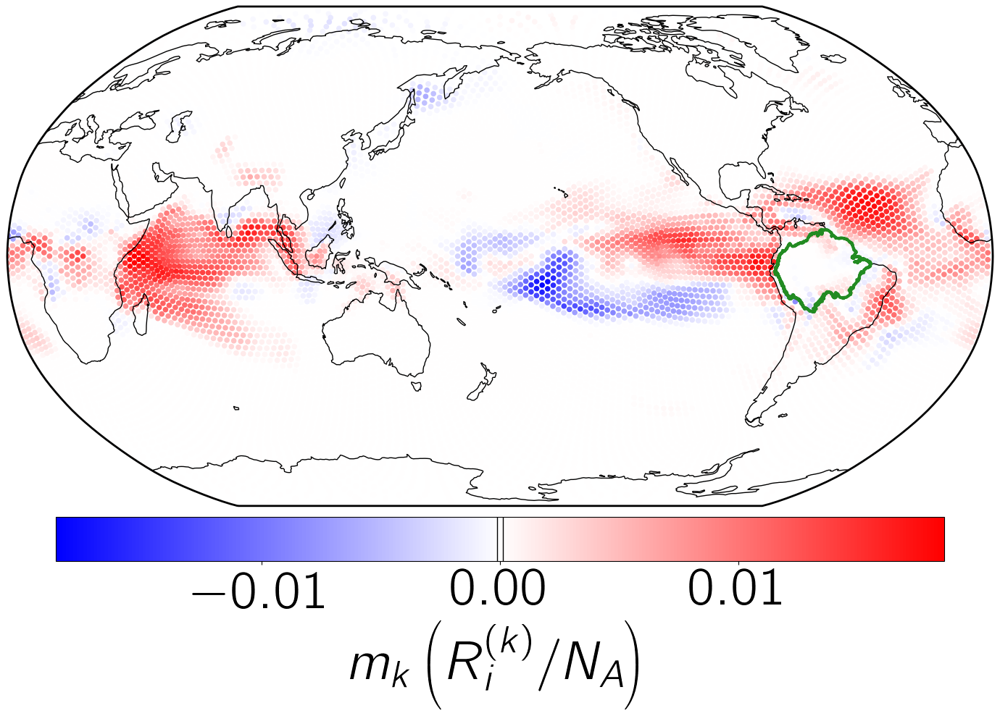

In [ ]:
fontsize = 54

plt.rc('text', usetex=True)
plt.rc('xtick',labelsize=fontsize)
plt.rc('ytick',labelsize=fontsize)


# fig, axs = plt.subplots(1,1,sharex=True,figsize=(20,10))
fig = plt.figure(figsize=(20,10))

ax1 = plt.subplot2grid(shape=(1, 1), loc=(0, 0), projection=ccrs.Robinson(central_longitude=180))



# plt.subplots_adjust(hspace=0, wspace=0.15)



### AXIS 1, RANDOM WALK MAP
ax1.coastlines(zorder=5)


# min_value = np.nanmin(idat)
# max_value = np.nanmax(idat)
# min_value = min(np.delete(dist_trend,amazon_nodes_corrected))
# max_value = max(np.delete(dist_trend,amazon_nodes_corrected))
# min_value = -.02#min(R_i_trend)
# max_value = .02#max(R_i_trend)

# idat1 = idat
# idat1[np.where(idat < min_value)] = min_value

levels = np.linspace(min_value,max_value,100)
ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

# midpoint = -min_value/(max_value-min_value)
cmap = mpl.cm.bwr
# shifted_cmap = shiftedColorMap(cmap, midpoint=midpoint)


reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
ax1.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)

im = ax1.scatter(latlon_icos[:,1], latlon_icos[:,0],
                  c=R_i_trend,
                  cmap='bwr', transform=ccrs.PlateCarree(), marker='o', s=20,
                  edgecolors=None)
im.set_clim(min_value, max_value)
cbar=plt.colorbar(im, ax=ax1, orientation='horizontal',fraction=0.08, pad=0.02)
# ticks = np.array([-5,-4,-3,-2,-1,0,1,2])
# cbar.set_ticks(ticks*1e-5)
# cbar.set_ticklabels(ticks)

# cbar=plt.colorbar(im, ax=ax1, ticks=ticks[1::3], fraction=0.048, orientation='horizontal',
#                   pad=0.02, boundaries=levels)
# cbar.set_ticklabels(['{:.4f}'.format(tick) for tick in ticks[1::3]])

# cbar.set_label('Slope of Trendline of Average Diffusion Distance to Amazon\n$t = $ '+
#                '{:.4f}'.format(round(t_target, 4)),fontsize=fontsize)
cbar.set_label(r'$m_k\left(R_{i,out}^{(k)}/N_A\right)$',fontsize=fontsize, usetex=True)

cbar.ax.plot([threshold_neg]*2, [0,1], 'k', lw=1)
cbar.ax.plot([threshold_pos]*2, [0,1], 'k', lw=1)

plt.setp(ax1.spines.values(), linewidth=2)

# plt.title(date, fontsize=fontsize)



plt.tight_layout()



title = 'Random Walk'
# plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
# plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)

plt.show()

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

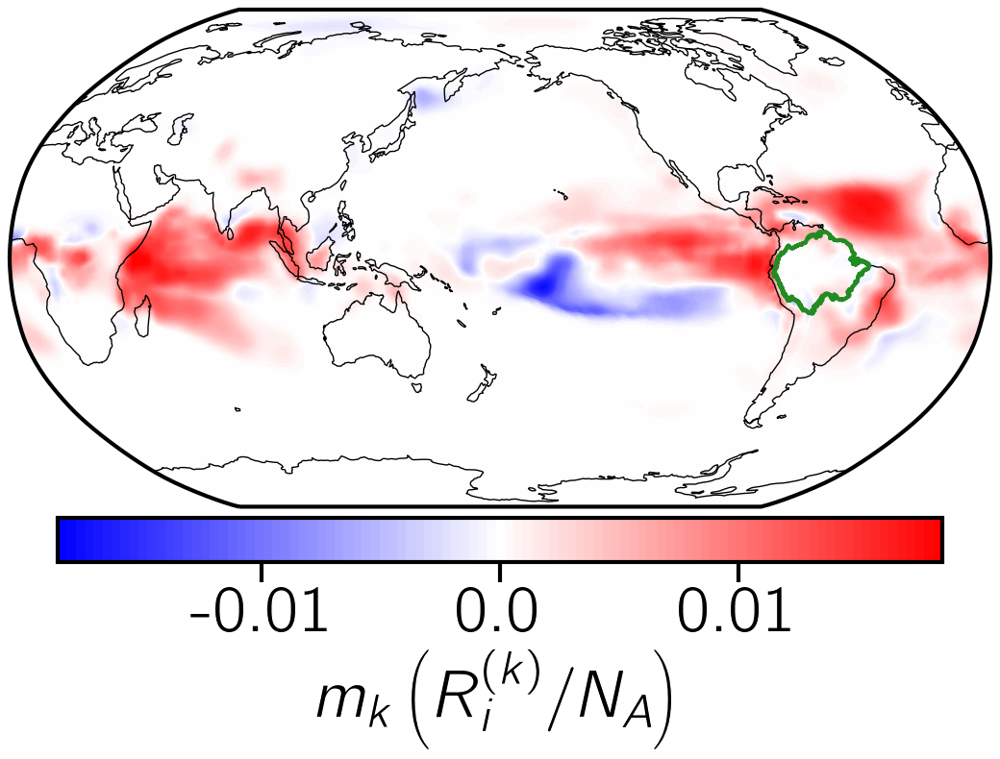

In [ ]:
# latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
ilat, ilon, idat = interpolate_scatter_data(latlon_icos, list(R_i_trend[:,0]),
#                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
                    method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

# mpl.rcParams['text.latex.preamble'] = [
#     r'\usepackage[dvipsnames]{xcolor}']


fontsize = 50

plt.rc('text', usetex=True)
plt.rc('xtick',labelsize=fontsize)
plt.rc('ytick',labelsize=fontsize)


fig= plt.figure(figsize=(16,8))

ax1 = plt.subplot2grid(shape=(1, 1), loc=(0, 0), projection=ccrs.Robinson(central_longitude=180))



# plt.subplots_adjust(hspace=0, wspace=0.15)



### AXIS 1, RANDOM WALK MAP
ax1.coastlines(zorder=5)


# min_value = np.nanmin(idat)
# max_value = np.nanmax(idat)
# min_value = min(np.delete(dist_trend,amazon_nodes_corrected))
# max_value = max(np.delete(dist_trend,amazon_nodes_corrected))
# min_value = 0
# max_value = max(d_i_dict[date])
max_value = max([abs(np.min(idat)), np.max(idat)])
min_value = -abs(max_value)


# idat1 = idat
# idat1[np.where(idat < min_value)] = min_value

levels = np.linspace(min_value,max_value,100)
ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

# midpoint = -min_value/(max_value-min_value)
cmap = mpl.cm.bwr
# shifted_cmap = shiftedColorMap(cmap, midpoint=midpoint)


reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
ax1.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)


im = ax1.contourf(ilon, ilat, idat, levels=levels,
                  cmap=cmap, alpha=1,
                  vmin=min_value, vmax=max_value,
                  transform=ccrs.PlateCarree(), zorder=4)
for c in im.collections:
    c.set_edgecolor("face")
# im.cmap.set_under(cmap(0))
# im.cmap.set_over(cmap(1))
im.set_clim(min_value, max_value)
cbar=plt.colorbar(im, ax=ax1, orientation='horizontal',fraction=0.08, pad=0.02)
ticks = np.array([ -0.01, 0, 0.01])
cbar.set_ticks(ticks)
cbar.set_ticklabels(ticks)

# cbar=plt.colorbar(im, ax=ax1, ticks=ticks[1::3], fraction=0.048, orientation='horizontal',
#                   pad=0.02, boundaries=levels)
# cbar.set_ticklabels(['{:.4f}'.format(tick) for tick in ticks[1::3]])

# cbar.set_label('Slope of Trendline of Average Diffusion Distance to Amazon\n$t = $ '+
#                '{:.4f}'.format(round(t_target, 4)),fontsize=fontsize)
cbar.set_label(r'$m_k\left(R_{i,out}^{(k)}/N_A\right)$',fontsize=fontsize)


# cbar.ax.annotate(r'$\times 10^{-5}$', xy=(1, -.21), xycoords="axes fraction",
#              fontsize=fontsize, usetex=True, va='top', ha='center')

# ax1.annotate(r'$t = '+str(t_target)+'$', color='k', xy=(0.57, -.3725), xycoords='axes fraction',
# #              bbox=dict(facecolor='r',boxstyle='round',alpha=0.25),
#              fontsize=fontsize,usetex=True, va='bottom', ha='center', zorder=5)


# ax1.annotate(r'\textbf{(c)}', xy=(0, 1), xycoords="axes fraction",
#              fontsize=fontsize,usetex=True, va='top', ha='left')

# plt.title(date, fontsize=fontsize)

plt.setp(ax1.spines.values(), linewidth=3)

# cbar.ax.tick_params(length=10,width=2)
# plt.setp(cbar.ax.spines.values(), linewidth=2)


plt.setp(ax1.spines.values(), linewidth=3, zorder=100)
ax1.tick_params(length=15,width=3)

cbar.outline.set_linewidth(3)
cbar.ax.tick_params(length=15,width=3)


plt.tight_layout()



title = 'Amazon Connectivity Trend'
plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)

plt.show()

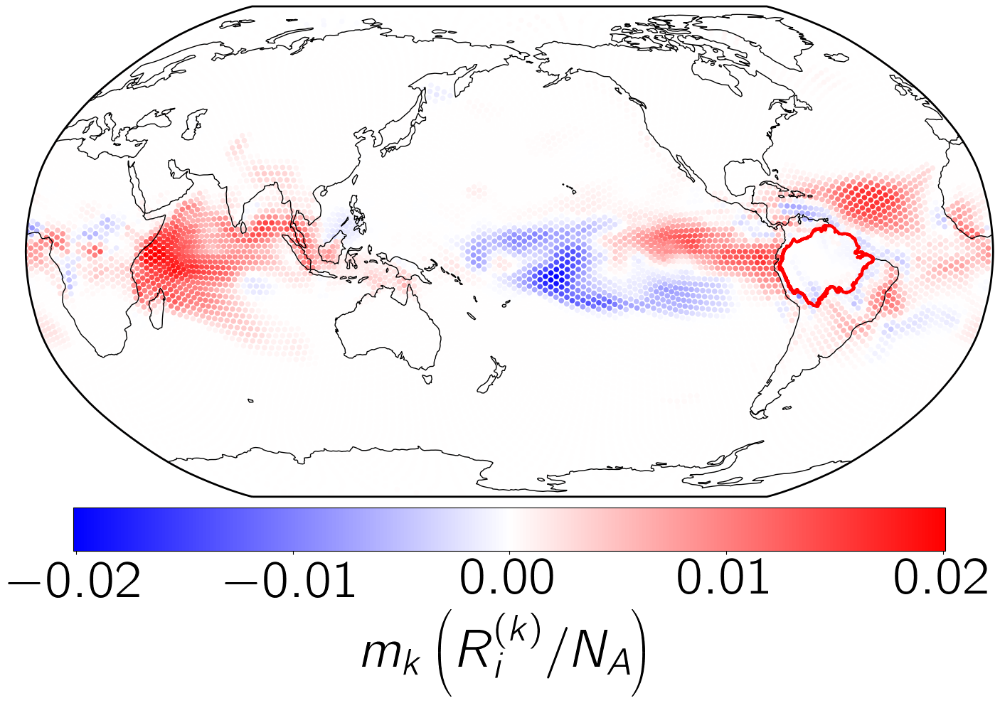

In [ ]:
fontsize = 54

plt.rc('text', usetex=True)
plt.rc('xtick',labelsize=fontsize)
plt.rc('ytick',labelsize=fontsize)


# fig, axs = plt.subplots(1,1,sharex=True,figsize=(20,10))
fig = plt.figure(figsize=(20,10))

ax1 = plt.subplot2grid(shape=(1, 1), loc=(0, 0), projection=ccrs.Robinson(central_longitude=180))



# plt.subplots_adjust(hspace=0, wspace=0.15)



### AXIS 1, RANDOM WALK MAP
ax1.coastlines(zorder=5)


# min_value = np.nanmin(idat)
# max_value = np.nanmax(idat)
# min_value = min(np.delete(dist_trend,amazon_nodes_corrected))
# max_value = max(np.delete(dist_trend,amazon_nodes_corrected))
# min_value = -.02#min(R_i_trend)
# max_value = .02#max(R_i_trend)

# idat1 = idat
# idat1[np.where(idat < min_value)] = min_value

levels = np.linspace(min_value,max_value,100)
ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

# midpoint = -min_value/(max_value-min_value)
cmap = mpl.cm.bwr
# shifted_cmap = shiftedColorMap(cmap, midpoint=midpoint)


reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
ax1.add_feature(amazon, facecolor='none', edgecolor='r', alpha=1, linewidth=3, zorder=6)

im = ax1.scatter(latlon_icos[:,1], latlon_icos[:,0],
                  c=R_i_trend,
                  cmap='bwr', transform=ccrs.PlateCarree(), marker='o', s=20,
                  edgecolors=None)
im.set_clim(min_value, max_value)
cbar=plt.colorbar(im, ax=ax1, orientation='horizontal',fraction=0.08, pad=0.02)
# ticks = np.array([-5,-4,-3,-2,-1,0,1,2])
# cbar.set_ticks(ticks*1e-5)
# cbar.set_ticklabels(ticks)

# cbar=plt.colorbar(im, ax=ax1, ticks=ticks[1::3], fraction=0.048, orientation='horizontal',
#                   pad=0.02, boundaries=levels)
# cbar.set_ticklabels(['{:.4f}'.format(tick) for tick in ticks[1::3]])

# cbar.set_label('Slope of Trendline of Average Diffusion Distance to Amazon\n$t = $ '+
#                '{:.4f}'.format(round(t_target, 4)),fontsize=fontsize)
cbar.set_label(r'$m_k\left(R_{i,out}^{(k)}/N_A\right)$',fontsize=fontsize, usetex=True)

plt.setp(ax1.spines.values(), linewidth=2)

# plt.title(date, fontsize=fontsize)



plt.tight_layout()



title = 'Random Walk'
# plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
# plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)

plt.show()

In [ ]:
print(list(R_i_dict[dates[0]]))

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.05421686746987952, 0.39156626506024095, 0.21686746987951808, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.3313253012048193, 0.0, 0.0, 0.0, 0.3493975903614458, 0.0, 0.0, 0.0, 0.0, 0.006024096385542169, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.060240963855421686, 0.0, 0.0, 0.0, 0.0, 0.0, 0.060240963855421686, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.024096385542168676, 0.006024096385542169, 0.0, 0.0, 0.3855421686746988, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.030120481927710843, 0.0, 0.10843373493975904, 0.0, 0.0, 0.0, 0.0, 0.0

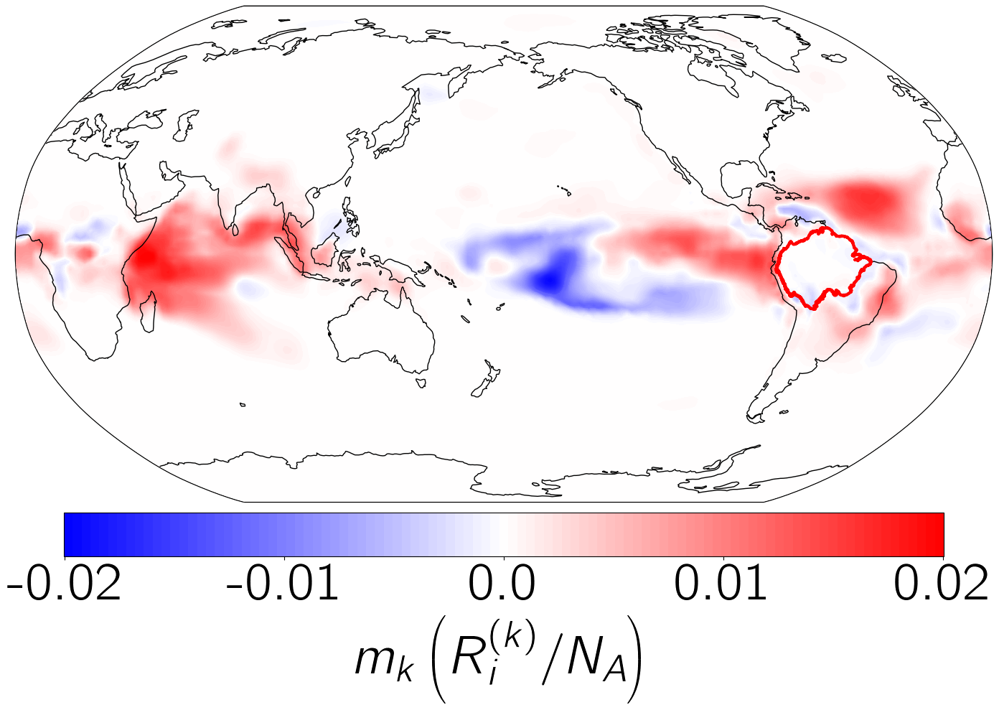

In [ ]:
# # latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
# ilat, ilon, idat = interpolate_scatter_data(latlon_icos, list(R_i_trend[:,0]),
# #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
#                     method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

# mpl.rcParams['text.latex.preamble'] = [
#     r'\usepackage[dvipsnames]{xcolor}']


fontsize = 54

plt.rc('text', usetex=True)
plt.rc('xtick',labelsize=fontsize)
plt.rc('ytick',labelsize=fontsize)


fig= plt.figure(figsize=(20,10))

ax1 = plt.subplot2grid(shape=(1, 1), loc=(0, 0), projection=ccrs.Robinson(central_longitude=180))



# plt.subplots_adjust(hspace=0, wspace=0.15)



### AXIS 1, RANDOM WALK MAP
ax1.coastlines(zorder=5)


# min_value = np.nanmin(idat)
# max_value = np.nanmax(idat)
# min_value = min(np.delete(dist_trend,amazon_nodes_corrected))
# max_value = max(np.delete(dist_trend,amazon_nodes_corrected))
# min_value = 0
# max_value = max(d_i_dict[date])
max_value = max([abs(np.min(idat)), np.max(idat)])
min_value = -abs(max_value)


# idat1 = idat
# idat1[np.where(idat < min_value)] = min_value

levels = np.linspace(min_value,max_value,100)
ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

# midpoint = -min_value/(max_value-min_value)
cmap = mpl.cm.bwr
# shifted_cmap = shiftedColorMap(cmap, midpoint=midpoint)


reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
ax1.add_feature(amazon, facecolor='none', edgecolor='r', alpha=1, linewidth=3, zorder=6)


im = ax1.contourf(ilon, ilat, idat, levels=levels,
                  cmap=cmap, alpha=1,
                  vmin=min_value, vmax=max_value,
                  transform=ccrs.PlateCarree(), zorder=4)
for c in im.collections:
    c.set_edgecolor("face")
# im.cmap.set_under(cmap(0))
# im.cmap.set_over(cmap(1))
im.set_clim(min_value, max_value)
cbar=plt.colorbar(im, ax=ax1, orientation='horizontal',fraction=0.08, pad=0.02)
ticks = np.array([-0.02, -0.01, 0, 0.01, 0.02])
cbar.set_ticks(ticks)
cbar.set_ticklabels(ticks)

# cbar=plt.colorbar(im, ax=ax1, ticks=ticks[1::3], fraction=0.048, orientation='horizontal',
#                   pad=0.02, boundaries=levels)
# cbar.set_ticklabels(['{:.4f}'.format(tick) for tick in ticks[1::3]])

# cbar.set_label('Slope of Trendline of Average Diffusion Distance to Amazon\n$t = $ '+
#                '{:.4f}'.format(round(t_target, 4)),fontsize=fontsize)
cbar.set_label(r'$m_k\left(R_{i,out}^{(k)}/N_A\right)$',fontsize=fontsize)


# cbar.ax.annotate(r'$\times 10^{-5}$', xy=(1, -.21), xycoords="axes fraction",
#              fontsize=fontsize, usetex=True, va='top', ha='center')

# ax1.annotate(r'$t = '+str(t_target)+'$', color='k', xy=(0.57, -.3725), xycoords='axes fraction',
# #              bbox=dict(facecolor='r',boxstyle='round',alpha=0.25),
#              fontsize=fontsize,usetex=True, va='bottom', ha='center', zorder=5)


# ax1.annotate(r'\textbf{(c)}', xy=(0, 1), xycoords="axes fraction",
#              fontsize=fontsize,usetex=True, va='top', ha='left')

# plt.title(date, fontsize=fontsize)

plt.setp(ax1.spines.values(), linewidth=2)

# cbar.ax.tick_params(length=10,width=2)
# plt.setp(cbar.ax.spines.values(), linewidth=2)




plt.tight_layout()



title = 'Random Walk'
# plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
# plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)

plt.show()

In [ ]:
print(min_value, max_value)

-0.017353136646380336 0.017353136646380336


In [ ]:
print(latlon_icos.shape, ilon.shape, ilat.shape, idat.shape)

(10242, 2) (20, 20) (20, 20) (20, 20)


In [ ]:
print(idat)

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.000000

In [ ]:
print(np.min(idat), np.max(idat))

-0.017490579133260548 0.018829773087377908


In [ ]:
!cat ~/.cache/matplotlib/fontlist-v330.json

{
  "_version": 330,
  "_FontManager__default_weight": "normal",
  "default_size": null,
  "defaultFamily": {
    "ttf": "DejaVu Sans",
    "afm": "Helvetica"
  },
  "afmlist": [
    {
      "fname": "fonts/afm/cmex10.afm",
      "name": "Computer Modern",
      "style": "normal",
      "variant": "normal",
      "weight": "medium",
      "stretch": "normal",
      "size": "scalable",
      "__class__": "FontEntry"
    },
    {
      "fname": "fonts/afm/pagdo8a.afm",
      "name": "ITC Avant Garde Gothic",
      "style": "italic",
      "variant": "normal",
      "weight": "demi",
      "stretch": "normal",
      "size": "scalable",
      "__class__": "FontEntry"
    },
    {
      "fname": "fonts/pdfcorefonts/Times-Roman.afm",
      "name": "Times",
      "style": "normal",
      "variant": "normal",
      "weight": "roman",
      "stretch": "normal",
      "size": "scalable",
      "__class__": "FontEntry"
    },
    {
      "fname": "fonts/afm/pncbi8a.afm",
      "name": "New Centur

In [ ]:
!ls $font_dir

cmb10.ttf			Helvetica.ttf
cmex10.ttf			LICENSE_DEJAVU
cmmi10.ttf			LICENSE_STIX
cmr10.ttf			STIXGeneralBolIta.ttf
cmss10.ttf			STIXGeneralBol.ttf
cmsy10.ttf			STIXGeneralItalic.ttf
cmtt10.ttf			STIXGeneral.ttf
DejaVuSans-BoldOblique.ttf	STIXNonUniBolIta.ttf
DejaVuSans-Bold.ttf		STIXNonUniBol.ttf
DejaVuSansDisplay.ttf		STIXNonUniIta.ttf
DejaVuSansMono-BoldOblique.ttf	STIXNonUni.ttf
DejaVuSansMono-Bold.ttf		STIXSizFiveSymReg.ttf
DejaVuSansMono-Oblique.ttf	STIXSizFourSymBol.ttf
DejaVuSansMono.ttf		STIXSizFourSymReg.ttf
DejaVuSans-Oblique.ttf		STIXSizOneSymBol.ttf
DejaVuSans.ttf			STIXSizOneSymReg.ttf
DejaVuSerif-BoldItalic.ttf	STIXSizThreeSymBol.ttf
DejaVuSerif-Bold.ttf		STIXSizThreeSymReg.ttf
DejaVuSerifDisplay.ttf		STIXSizTwoSymBol.ttf
DejaVuSerif-Italic.ttf		STIXSizTwoSymReg.ttf
DejaVuSerif.ttf


In [ ]:
import matplotlib as mpl
mpl.__version__

'3.7.1'

In [ ]:
fm._load_fontmanager(try_read_cache=False)

In [ ]:
!pip uninstall matplotlib
!pip install --upgrade --force-reinstall matplotlib

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.6/11.6 MB 59.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 299.7/299.7 KB 18.4 MB/s eta 0:00:00
  Using cached numpy-1.24.2-cp39-cp39-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (17.3 MB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.4/3.4 MB 40.1 MB/s eta 0:00:00
  Using cached packaging-23.0-py3-none-any.whl (42 kB)
  Using cached python_dateutil-2.8.2-py2.py3-none-any.whl (247 kB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 36.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.3/98.3 KB 8.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 66.5 MB/s eta 0:00:00
  Using cached six-1.16.0-py2.py3-none-any.whl (11 kB)
  Attempting uninstall: zipp
    Found existing installation: zipp 3.15.0
    Uninstalling zipp-3.15.0:
      Successfully uninstalled zipp-3.15.0
  A

In [ ]:
plt.rc('font', family='Computer Modern')

In [ ]:
# mpl.font_manager._rebuild()
mpl.rc('font', family='serif')

In [ ]:
import matplotlib.pyplot as plt
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = ['Times New Roman'] + plt.rcParams['font.serif']

In [ ]:
plt.rcParams['savefig.bbox'] = 'tight'

# !sudo apt-get install texlive-latex-recommended
# !sudo apt install texlive-latex-base texlive-latex-extra texlive-fonts-recommended texlive-fonts-extra cm-super dvipng

font_dir = '/usr/local/lib/python' + str(sys.version_info[0]) + '.' + str(sys.version_info[1]) + '/dist-packages/matplotlib/mpl-data/fonts/ttf/'
# font_dir = '/Users/adamgiammarese/Library/Fonts/'


import matplotlib.font_manager as fm
# fm.fontManager.addfont(font_dir + 'cmss10.ttf')
# plt.rcParams['font.family'] = 'serif'
# plt.rcParams['font.serif'] = 'dejavuserif'
# plt.rcParams['mathtext.fontset'] = 'dejavuserif'
mpl.rcParams['mathtext.fontset'] = 'custom'
mpl.rcParams['mathtext.rm'] = 'cm'

In [ ]:
!rm ~/.cache/matplotlib -rf

# Varying Edge Densities

In [ ]:
densities = sorted([0.1, 0.05, 0.025, 0.01, 0.005])

for density in densities:

  with gzip.open(data_dir + 'icosahedral_grid.data', 'rb') as file:
    latlon_icos = np.array(pkl.load(file))

  months = 300
  offset = 365.25


  edge_dir = data_dir + 'edge_list-months='+str(months)+',offset='+str(offset)+',density={:}'.format(density)+'/'

  total_networks = len(os.listdir(edge_dir))

  num_nodes = 10242

  with gzip.open(data_dir + 'year_intervals-months='+str(months)+',offset='+str(offset) + '.data', 'rb') as file:
    year_intervals = pkl.load(file)

  with gzip.open(data_dir + 'date_intervals-months='+str(months)+',offset='+str(offset) + '.data', 'rb') as file:
    date_intervals = pkl.load(file)

  dates = [year_intervals[i][0] + '-' + year_intervals[i][1] for i in range(len(year_intervals))]
  print(dates)

  reader = shpreader.Reader(base_dir+'Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())

  recompute = False

  if recompute:
    amazon_nodes = []

    for i in range(num_nodes):
      if amazon._geoms[0].contains(Point(latlon_icos[i,1]-360,latlon_icos[i,0])):
        amazon_nodes.append(i)

    with gzip.open(data_dir + 'amazon_nodes_new_networks.data', 'wb') as file:
      pkl.dump(amazon_nodes, file)
  else:
    with gzip.open(data_dir + 'amazon_nodes_new_networks.data', 'rb') as file:
      amazon_nodes = pkl.load(file)

  recompute = False

  graph_dir = data_dir + 'G-months='+str(months)+',offset='+str(offset)+',density={:}'.format(density)+'/'
  if recompute:
    if not os.path.isdir(graph_dir):
      os.mkdir(graph_dir)

    for i in trange(len(dates)):
      date = dates[i]

      with gzip.open(edge_dir + str(i) + '.data', 'rb') as file:
        edge_list = pkl.load(file)

      # print(i, len(edge_list), len(np.where(edge_list[:,1] > 0)[0])/(num_nodes*(num_nodes-1)/2))

      G = nx.from_edgelist(edge_list) # initiall unsorted

      H = nx.Graph() # make sorted copy
      H.add_nodes_from(sorted(G.nodes(data=True)))
      H.add_edges_from(G.edges(data=True))
      G = H # write over original with sorted copy
      del H # delete sorted copy

      print(i, nx.density(G), len(edge_list)/(num_nodes*(num_nodes-1)/2))

      with gzip.open(graph_dir + date + '.data', 'wb') as file:
        pkl.dump(G, file)

['1948-1973', '1949-1974', '1950-1975', '1951-1976', '1952-1977', '1953-1978', '1954-1979', '1955-1980', '1956-1981', '1957-1982', '1958-1983', '1959-1984', '1960-1985', '1961-1986', '1962-1987', '1963-1988', '1964-1989', '1965-1990', '1966-1991', '1967-1992', '1968-1993', '1969-1994', '1970-1995', '1971-1996', '1972-1997', '1973-1998', '1974-1999', '1975-2000', '1976-2001', '1977-2002', '1978-2003', '1979-2004', '1980-2005', '1981-2006', '1982-2007', '1983-2008', '1984-2009', '1985-2010', '1986-2011', '1987-2012', '1988-2013', '1989-2014', '1990-2015', '1991-2016', '1992-2017', '1993-2018', '1994-2019', '1995-2020', '1996-2021', '1997-2022', '1998-2023']
['1948-1973', '1949-1974', '1950-1975', '1951-1976', '1952-1977', '1953-1978', '1954-1979', '1955-1980', '1956-1981', '1957-1982', '1958-1983', '1959-1984', '1960-1985', '1961-1986', '1962-1987', '1963-1988', '1964-1989', '1965-1990', '1966-1991', '1967-1992', '1968-1993', '1969-1994', '1970-1995', '1971-1996', '1972-1997', '1973-1998

In [ ]:
densities = sorted([0.1, 0.05, 0.025, 0.01, 0.005])

R_i_dict_vary_density = {density:{date:[None]*num_nodes for date in dates} for density in densities}



recompute = False

if recompute:
  for density in densities:
    graph_dir = data_dir + 'G-months='+str(months)+',offset='+str(offset)+',density={:}'.format(density)+'/'

    for i in trange(len(dates)):
      date = dates[i]

      f = gzip.open(graph_dir + date+'.data','rb')
      G = pkl.load(f)
      f.close()

      H = nx.Graph() # make sorted copy
      H.add_nodes_from(sorted(G.nodes(data=True)))
      H.add_edges_from(G.edges(amazon_nodes, data=True))

      for j in trange(G.number_of_nodes(), leave=False, desc=date):
        R_i_dict_vary_density[density][date][j] = sum([1 if neighbor in amazon_nodes else 0 for neighbor in H.neighbors(j)])

  with gzip.open(data_dir + 'R_i_dict_vary_density.data', 'wb') as file:
    pkl.dump(R_i_dict_vary_density, file)
else:
  with gzip.open(data_dir + 'R_i_dict_vary_density.data', 'rb') as file:
    R_i_dict_vary_density = pkl.load(file)

In [ ]:
R_i_dict_vary_density = {density:{date:np.array(R_i_dict_vary_density[density][date])/len(amazon_nodes) for date in dates} for density in densities}

In [ ]:
fig_vary_dir = fig_dir + 'Vary Density/'
if not os.path.isdir(fig_vary_dir):
  os.mkdir(fig_vary_dir)

In [ ]:
for density in densities:
  n = 5
  spacing = min([int(round(len(dates)/2)/(n//2)),int((len(dates)-1 - round(len(dates)/2))/(n//2))])
  middle = round(len(dates)/2)
  print()
  dates_to_plot = [dates[0], dates[len(dates)//2], dates[-1]]
  # dates_to_plot = ['1948-1973', '1950-1975', '1970-1995', '1993-2018', '1995-2020']

  max_value = 0
  for date in dates_to_plot:
    max_value = max([max_value,max(R_i_dict_vary_density[density][date])])



  fontsize = 36

  plt.rc('text', usetex=True)
  plt.rc('xtick',labelsize=fontsize)
  plt.rc('ytick',labelsize=fontsize)

  # serif_font = fm.FontProperties(fname=font_dir+'cmr10.ttf', size=fontsize, math_fontfamily='cm')
  # fpath = Path(font_dir+'cmr10.ttf')

  fig = plt.figure(figsize=(10*len(dates_to_plot),5))

  for i in range(len(dates_to_plot)):
    date = dates_to_plot[i]
    title = datetime.strptime(date_intervals[dates.index(date)][0], '%m/%d/%Y').strftime('%b %d, %Y') + ' - ' + datetime.strptime(date_intervals[dates.index(date)][1], '%m/%d/%Y').strftime('%b %d, %Y')

  #   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  #   ilat, ilon, idat = interpolate_scatter_data(latlon_icos, R_i_dict_vary_density[density][date],
  # #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
  #                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

    ax = plt.subplot2grid(shape=(1, len(dates_to_plot)), loc=(0, i), projection=ccrs.Robinson(central_longitude=180))

    ax.coastlines(zorder=5)

    # min_value = 1/len(amazon_nodes)
    null_rate = 1#max(1,int(density*(num_nodes-1)/4*len(amazon_nodes)/num_nodes))
    min_value = null_rate/len(amazon_nodes)
    # print(density*(num_nodes-1)/4*len(amazon_nodes)/num_nodes)
    # print(G.number_of_edges()/G.number_of_nodes()/2)
    # print(len(amazon_nodes)/G.number_of_nodes())
    # print(G.number_of_edges()/G.number_of_nodes()/2*len(amazon_nodes)/G.number_of_nodes())

    levels = np.linspace(min_value,max_value,100)
    ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

    cmap = mpl.cm.plasma_r


    reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
    amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
    ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)



    ind = np.where(R_i_dict_vary_density[density][date] > 0)[0]

    # idat[idat < min_value] = np.NAN

    # im = ax.contourf(ilon, ilat, idat, levels=levels,
    #                   cmap=cmap, alpha=1,
    #                   vmin=min_value, vmax=max_value,
    #                   transform=ccrs.PlateCarree(), zorder=4)
    im = ax.scatter(latlon_icos[ind,1], latlon_icos[ind,0],
                    c=R_i_dict_vary_density[density][date][ind],
                    cmap='plasma_r', transform=ccrs.PlateCarree(), marker='o', s=20,
                    edgecolors=None)
    ax.scatter(latlon_icos[:,1], latlon_icos[:,0],
                    c=R_i_dict_vary_density[density][date][:],
                    cmap='plasma_r', transform=ccrs.PlateCarree(), marker='o', s=0,
                    edgecolors=None, zorder=100, alpha=0)
    # ax.set_extent([-180,180,-90,90], crs=ccrs.PlateCarree())
    # for c in im.collections:
    #     c.set_edgecolor("face")
    im.set_clim(min_value, max_value)

    im.cmap.set_under('w')

    ax.annotate(r'\textbf{('+chr(97+i)+')}', xy=(0, 1), xycoords="axes fraction",
                fontsize=fontsize,usetex=True, va='top', ha='left')

    ax.set_title(title, fontsize=fontsize)

    plt.setp(ax.spines.values(), linewidth=3, zorder=100)
    ax.tick_params(length=15,width=3)


  plt.tight_layout()
  plt.subplots_adjust(wspace=-0.25)

  cbar = fig.colorbar(im, ax = fig.get_axes(), anchor=(0.475, 0),
                      orientation='horizontal',fraction=0.08, pad=0.02,
                      extend='min')
  ticks = np.linspace(min_value,max_value,3)
  cbar.set_ticks(ticks)
  cbar.set_ticklabels(['{:.1f}'.format(ticks[i]) if i>0 else r'{:}$/N_A$'.format(null_rate) for i in range(len(ticks))],usetex=True)







  # cbar=plt.colorbar(im, ax=ax, ticks=ticks[1::3], fraction=0.048, orientation='horizontal',
  #                   pad=0.02, boundaries=levels)
  # cbar.set_ticklabels(['{:.4f}'.format(tick) for tick in ticks[1::3]])

  # cbar.set_label('Slope of Trendline of Average Diffusion Distance to Amazon\n$t = $ '+
  #                '{:.4f}'.format(round(t_target, 4)),fontsize=fontsize)
  cbar.set_label(r'$R_{i,out}/N_A$',fontsize=fontsize)

  cbar.outline.set_linewidth(3)
  cbar.ax.tick_params(length=15,width=3)

  title = 'Amazon Connectivity, rho={:}'.format(density)
  # plt.savefig(fig_vary_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
  # plt.savefig(fig_vary_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)
  plt.show()
  plt.close(fig)

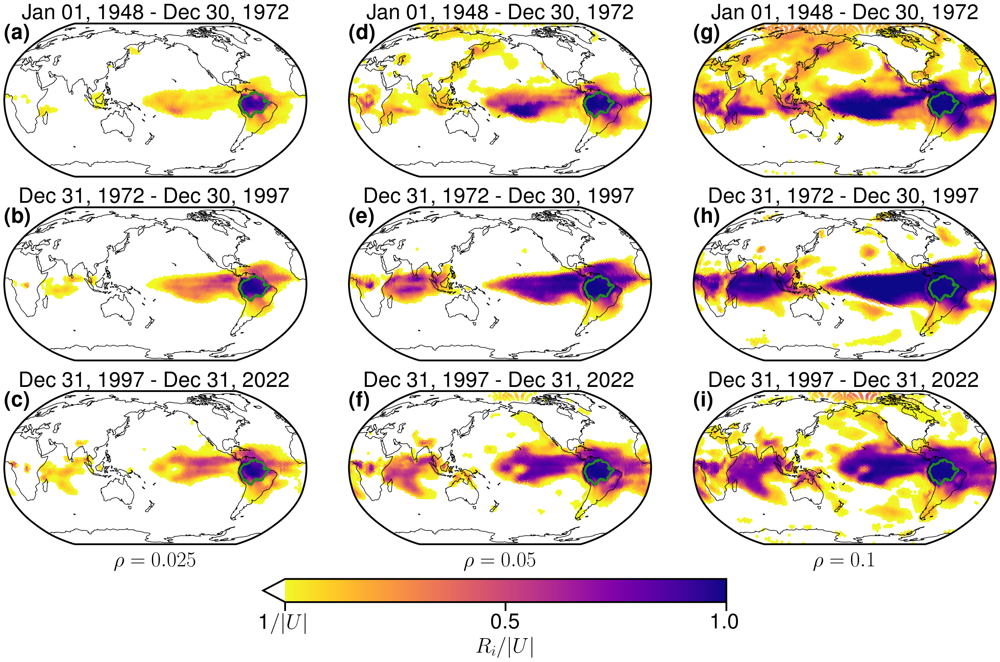

In [ ]:
densities = [0.025, 0.05, 0.1]

n = 5
spacing = min([int(round(len(dates)/2)/(n//2)),int((len(dates)-1 - round(len(dates)/2))/(n//2))])
middle = round(len(dates)/2)
print()
dates_to_plot = [dates[0], dates[len(dates)//2], dates[-1]]
# dates_to_plot = ['1948-1973', '1950-1975', '1970-1995', '1993-2018', '1995-2020']

max_value = 0
for density in densities:
  for date in dates_to_plot:
    max_value = max([max_value,max(R_i_dict_vary_density[density][date])])



fontsize = 36

plt.rc('text', usetex=True)
plt.rc('xtick',labelsize=fontsize)
plt.rc('ytick',labelsize=fontsize)

# serif_font = fm.FontProperties(fname=font_dir+'cmr10.ttf', size=fontsize, math_fontfamily='cm')
# fpath = Path(font_dir+'cmr10.ttf')

fig = plt.figure(figsize=(10*len(densities),5*len(dates_to_plot)))

for j in range(len(densities)):
  density = densities[j]
  for i in range(len(dates_to_plot)):
    date = dates_to_plot[i]
    title = datetime.strptime(date_intervals[dates.index(date)][0], '%m/%d/%Y').strftime('%b %d, %Y') + ' - ' + datetime.strptime(date_intervals[dates.index(date)][1], '%m/%d/%Y').strftime('%b %d, %Y')

  #   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  #   ilat, ilon, idat = interpolate_scatter_data(latlon_icos, R_i_dict_vary_density[density][date],
  # #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
  #                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

    ax = plt.subplot2grid(shape=(len(dates_to_plot), len(densities)), loc=(i, j), projection=ccrs.Robinson(central_longitude=180))

    ax.coastlines(zorder=5)

    min_value = 1/len(amazon_nodes)

    levels = np.linspace(min_value,max_value,100)
    ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

    cmap = mpl.cm.plasma_r


    reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
    amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
    ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)



    ind = np.where(R_i_dict_vary_density[density][date] > 0)[0]

    # idat[idat < min_value] = np.NAN

    # im = ax.contourf(ilon, ilat, idat, levels=levels,
    #                   cmap=cmap, alpha=1,
    #                   vmin=min_value, vmax=max_value,
    #                   transform=ccrs.PlateCarree(), zorder=4)
    im = ax.scatter(latlon_icos[ind,1], latlon_icos[ind,0],
                    c=R_i_dict_vary_density[density][date][ind],
                    cmap='plasma_r', transform=ccrs.PlateCarree(), marker='o', s=20,
                    edgecolors=None)
    ax.scatter(latlon_icos[:,1], latlon_icos[:,0],
                    c=R_i_dict_vary_density[density][date][:],
                    cmap='plasma_r', transform=ccrs.PlateCarree(), marker='o', s=0,
                    edgecolors=None, zorder=100, alpha=0)
    # ax.set_extent([-180,180,-90,90], crs=ccrs.PlateCarree())
    # for c in im.collections:
    #     c.set_edgecolor("face")
    im.set_clim(min_value, max_value)

    im.cmap.set_under('w')

    ax.annotate(r'\textbf{('+chr(97+i + j*len(dates_to_plot))+')}', xy=(0, 1), xycoords="axes fraction",
                fontsize=fontsize,usetex=True, va='top', ha='left')

    ax.set_title(title, fontsize=fontsize)

    plt.setp(ax.spines.values(), linewidth=3, zorder=100)
    ax.tick_params(length=15,width=3)

    if i == len(dates_to_plot) - 1:
      ax.annotate(r'$\rho = {:}$'.format(density), xy=(0.5,-0.05), va='top', ha='center', xycoords='axes fraction', fontsize=fontsize)


plt.tight_layout()
plt.subplots_adjust(hspace = 0.2, wspace = -0.4)

cbar = fig.colorbar(im, ax = fig.get_axes(), anchor=(0.468, 0),
                    orientation='horizontal',fraction=0.04, pad=0.06,
                    extend='min')
ticks = np.linspace(min_value,max_value,3)
cbar.set_ticks(ticks)
cbar.set_ticklabels(['{:.1f}'.format(ticks[i]) if i>0 else r'1$/|U|$' for i in range(len(ticks))],usetex=True)
# cbar.set_ticklabels(['{:.1f}'.format(ticks[i]) for i in range(len(ticks))],usetex=True)






# cbar=plt.colorbar(im, ax=ax, ticks=ticks[1::3], fraction=0.048, orientation='horizontal',
#                   pad=0.02, boundaries=levels)
# cbar.set_ticklabels(['{:.4f}'.format(tick) for tick in ticks[1::3]])

# cbar.set_label('Slope of Trendline of Average Diffusion Distance to Amazon\n$t = $ '+
#                '{:.4f}'.format(round(t_target, 4)),fontsize=fontsize)
cbar.set_label(r'$R_{i}/|U|$',fontsize=fontsize)

cbar.outline.set_linewidth(3)
cbar.ax.tick_params(length=15,width=3)

title = 'Amazon Connectivity (Vary Density)'
plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)
plt.show()
plt.close(fig)

In [ ]:
R_i_trend_vary_density = {density:np.zeros((num_nodes,1)) for density in densities}

for density in densities:
  for node in range(num_nodes):
  #         slope, _ = np.polyfit(list(range(48)), [R_i_dict[date][node,1] for date in dates], 1)
      slope, _ = np.polyfit(list(range(len(dates))), [R_i_dict_vary_density[density][dates[i]][node] for i in range(len(dates))], 1)
      R_i_trend_vary_density[density][node] = slope

In [ ]:
densities = [0.025, 0.05, 0.1]

for density in densities:
  fontsize = 36

  plt.rc('text', usetex=True)
  plt.rc('xtick',labelsize=fontsize)
  plt.rc('ytick',labelsize=fontsize)


  # fig, axs = plt.subplots(1,1,sharex=True,figsize=(20,10))
  fig = plt.figure(figsize=(16,8))



  # latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  # ilat, ilon, idat = interpolate_scatter_data(latlon_icos, list(R_i_trend_vary_density[density][:,0]),
  # #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
  #                     method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

  #   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  #   ilat, ilon, idat = interpolate_scatter_data(latlon_icos, R_i_dict_vary_density[density][date],
  # #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
  #                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

  ax = plt.subplot2grid(shape=(1, 1), loc=(0, 0), projection=ccrs.Robinson(central_longitude=180))

  ax.coastlines(zorder=5)

  max_value = max([abs(np.min(R_i_trend_vary_density[density])), np.max(R_i_trend_vary_density[density])])
  min_value = -abs(max_value)

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  cmap = mpl.cm.bwr




  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)

  # im = ax.contourf(ilon, ilat, idat, levels=levels,
  #                 cmap=cmap, alpha=1,
  #                 vmin=min_value, vmax=max_value,
  #                 transform=ccrs.PlateCarree(), zorder=4)
  # for c in im.collections:
  #     c.set_edgecolor("face")
  # im.set_clim(min_value, max_value)

  im = ax.scatter(latlon_icos[:,1], latlon_icos[:,0],
                  c=R_i_trend_vary_density[density],
                  cmap='bwr', transform=ccrs.PlateCarree(), marker='o', s=20,
                  edgecolors=None)
  im.set_clim(min_value, max_value)

  # ax.set_title(title, fontsize=fontsize)

  plt.setp(ax.spines.values(), linewidth=3, zorder=100)
  ax.tick_params(length=15,width=3)

  # if i == len(dates_to_plot) - 1:
  #   ax.set_title(r'$\rho = {:}$'.format(density), fontsize=fontsize, pad=10)

  plt.tight_layout()
  plt.subplots_adjust(hspace = 0.2, wspace = -0.5)

  cbar = fig.colorbar(im, ax = fig.get_axes(), anchor=(0.5, 0),
                      orientation='horizontal',fraction=0.08, pad=0.06)
  # ticks = [-0.015, 0, 0.015]
  # cbar.set_ticks(ticks)
  # cbar.set_ticklabels(['{:.3f}'.format(ticks[i]) for i in range(len(ticks))],usetex=True)
  tick_locator = mpl.ticker.MaxNLocator(nbins=5)
  cbar.locator = tick_locator
  cbar.update_ticks()


  cbar.set_label(r'$m_w\left(R_{i,out}^{(w)}/N_A\right)$',fontsize=fontsize, usetex=True)


  cbar.outline.set_linewidth(3)
  cbar.ax.tick_params(length=15,width=3)

  title = 'Amazon Connectivity Trend, rho={:}'.format(density)
  # plt.savefig(fig_vary_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
  # plt.savefig(fig_vary_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)
  plt.show()
  plt.close(fig)

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

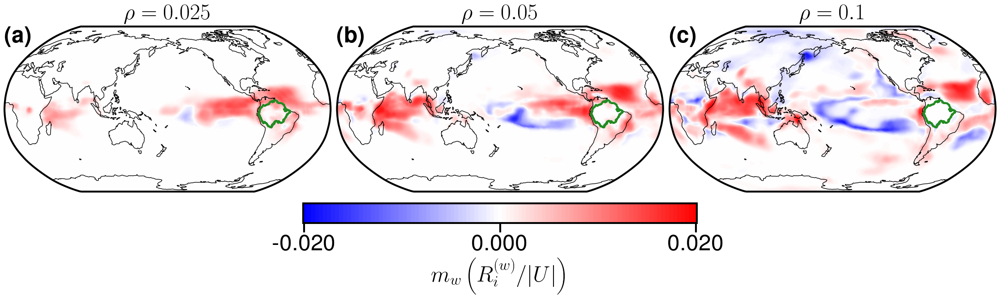

In [ ]:
densities = [0.025, 0.05, 0.1]

max_value = max([abs(np.min([R_i_trend_vary_density[density] for density in densities])), np.max([R_i_trend_vary_density[density] for density in densities])])
min_value = -abs(max_value)
print(min_value, max_value)

fontsize = 36

plt.rc('text', usetex=True)
plt.rc('xtick',labelsize=fontsize)
plt.rc('ytick',labelsize=fontsize)


# fig, axs = plt.subplots(1,1,sharex=True,figsize=(20,10))
fig = plt.figure(figsize=(10*len(densities),5))

for j in range(len(densities)):
  density = densities[j]

  #   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  ilat, ilon, idat = interpolate_scatter_data(latlon_icos, list(R_i_trend_vary_density[density][:,0]),
  #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

  ax = plt.subplot2grid(shape=(1, len(densities)), loc=(0, j), projection=ccrs.Robinson(central_longitude=180))

  ax.coastlines(zorder=5)

  cmap = mpl.cm.bwr

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)

  im = ax.contourf(ilon, ilat, idat, levels=levels,
                  cmap=cmap, alpha=1,
                  vmin=min_value, vmax=max_value,
                  transform=ccrs.PlateCarree(), zorder=4)
  for c in im.collections:
      c.set_edgecolor("face")
  im.set_clim(min_value, max_value)

  # im = ax.scatter(latlon_icos[:,1], latlon_icos[:,0],
  #                 c=R_i_trend_vary_density[density],
  #                 cmap='bwr', transform=ccrs.PlateCarree(), marker='o', s=20,
  #                 edgecolors=None)
  # im.set_clim(min_value, max_value)


  ax.annotate(r'\textbf{('+chr(97+j)+')}', xy=(0, 1), xycoords="axes fraction",
              fontsize=fontsize,usetex=True, va='top', ha='left')

  # ax.set_title(title, fontsize=fontsize)

  plt.setp(ax.spines.values(), linewidth=3, zorder=100)
  ax.tick_params(length=15,width=3)

  if i == len(dates_to_plot) - 1:
    ax.set_title(r'$\rho = {:}$'.format(density), fontsize=fontsize, pad=10)

plt.tight_layout()
plt.subplots_adjust(hspace = 0.2, wspace = -0.5)

cbar = fig.colorbar(im, ax = fig.get_axes(), anchor=(0.5, 0),
                    orientation='horizontal',fraction=0.1, pad=0.06)
ticks = [-0.02, 0, 0.02]
cbar.set_ticks(ticks)
cbar.set_ticklabels(['{:.3f}'.format(ticks[i]) for i in range(len(ticks))],usetex=True)


cbar.set_label(r'$m_w\left(R_{i}^{(w)}/|U|\right)$',fontsize=fontsize, usetex=True)


cbar.outline.set_linewidth(3)
cbar.ax.tick_params(length=15,width=3)

title = 'Amazon Connectivity Trend (Vary Density)'
plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)
plt.show()
plt.close(fig)

-0.014828700321648576 0.01623266641225536


Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

-0.016447116066074245 0.015342302240636754


Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

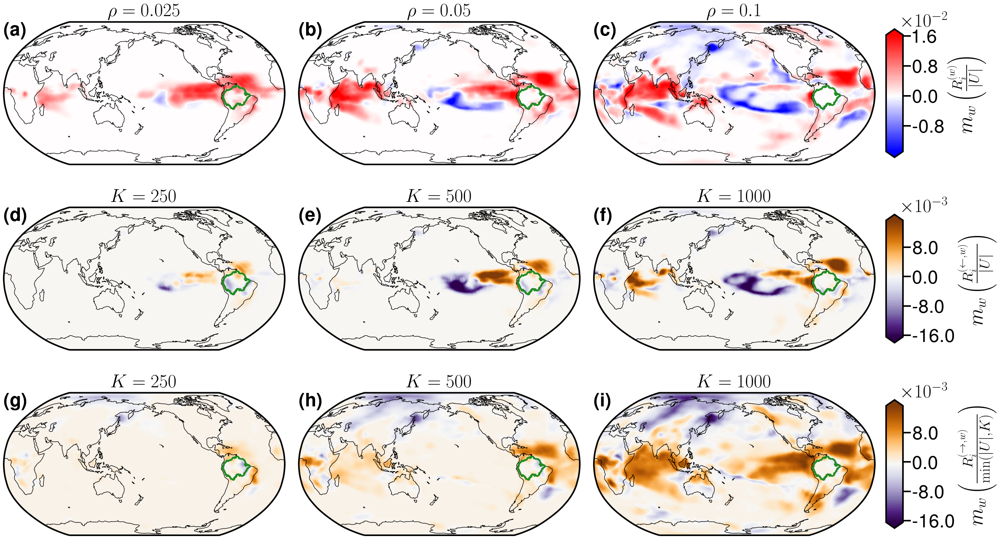

In [ ]:
densities = [0.025, 0.05, 0.1]
ks = [250, 500, 1000]

class MagnitudeFormatter(mpl.ticker.ScalarFormatter):
    def __init__(self, exponent=None):
        super().__init__()
        self._fixed_exponent = exponent

    def _set_order_of_magnitude(self):
        if self._fixed_exponent:
            self.orderOfMagnitude = self._fixed_exponent
        else:
            super()._set_order_of_magnitude()


fontsize = 36

plt.rc('text', usetex=True)
plt.rc('xtick',labelsize=fontsize)
plt.rc('ytick',labelsize=fontsize)


# fig, axs = plt.subplots(1,1,sharex=True,figsize=(20,10))
fig = plt.figure(figsize=(10*len(densities),18))
# fig, axs = plt.subplots(3,len(densities),figsize=(10*len(densities),18))#,gridspec_kw={'width_ratios':[1]*len(densities)+[0.046]})
axs = []
for i in range(3):
  axs.append([])
  for j in range(len(densities)):
    axs[i].append(plt.subplot2grid(shape=(3, len(densities)), loc=(i, j), projection=ccrs.Robinson(central_longitude=180)))
  # axs[i].append(plt.subplot2grid(shape=(3, len(densities)+1), loc=(i, len(densities))))
axs = np.array(axs)

plt.subplots_adjust(wspace=0.05, hspace=.25)

# max_value = max([abs(np.min([R_i_trend_vary_density[density] for density in densities])), np.max([R_i_trend_vary_density[density] for density in densities])])
# min_value = -abs(max_value)
max_value = max([np.quantile(R_i_trend_vary_density[density],0.995) for density in densities])
min_value = min([np.quantile(R_i_trend_vary_density[density],0.005) for density in densities])
print(min_value, max_value)

for j in range(len(densities)):
  density = densities[j]

  #   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  ilat, ilon, idat = interpolate_scatter_data(latlon_icos, list(R_i_trend_vary_density[density][:,0]),
  #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

  # ax = plt.subplot2grid(shape=(3, len(densities)), loc=(0, j), projection=ccrs.Robinson(central_longitude=180))
  ax = axs[0,j]

  ax.coastlines(zorder=5)

  cmap = mpl.cm.bwr
  cmap = shiftedColorMap(cmap, start=0, midpoint=-min_value/(max_value-min_value), stop=1.0, name='shiftedcmap')

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)

  im = ax.contourf(ilon, ilat, idat, levels=levels,
                  cmap=cmap, alpha=1, extend='both',
                  vmin=min_value, vmax=max_value,
                  transform=ccrs.PlateCarree(), zorder=4)
  for c in im.collections:
      c.set_edgecolor("face")
  im.set_clim(min_value, max_value)

  # im = ax.scatter(latlon_icos[:,1], latlon_icos[:,0],
  #                 c=R_i_trend_vary_density[density],
  #                 cmap='bwr', transform=ccrs.PlateCarree(), marker='o', s=5,
  #                 edgecolors=None)
  # im.set_clim(min_value, max_value)


  ax.annotate(r'\textbf{('+chr(97+j)+')}', xy=(0, 1), xycoords="axes fraction",
              fontsize=fontsize,usetex=True, va='top', ha='left')

  # ax.set_title(title, fontsize=fontsize)

  plt.setp(ax.spines.values(), linewidth=3, zorder=100)
  ax.tick_params(length=15,width=3)

  ax.set_title(r'$\rho = {:}$'.format(density), fontsize=fontsize, pad=10)

cax = fig.add_axes([ax.get_position().x1+0.01,ax.get_position().y0+0.05*ax.get_position().height,0.015,0.9*ax.get_position().height])
cbar = plt.colorbar(im, cax=cax,
                    orientation='vertical',fraction=0.046, aspect=10, shrink=1, pad=0.04)
# ticks = [-0.015, 0, 0.015]
ticks = [min_value, 0, max_value]
# cbar.set_ticks(ticks)
# cbar.set_ticklabels(['{:.3f}'.format(ticks[i]) for i in range(len(ticks))],usetex=True)
tick_locator = mpl.ticker.MaxNLocator(nbins=5)
cbar.locator = tick_locator
cbar.update_ticks()

ticks = cbar.get_ticks()[1:-1]
multiplier = int('{:e}'.format(ticks[-1]).split('e')[1])
fmt = MagnitudeFormatter(multiplier)
cbar.ax.xaxis.set_major_formatter(fmt)
# plt.ticklabel_format(style='sci', axis='y')
# print(ax.yaxis.get_major_formatter().__dict__)
cbar.ax.xaxis.offsetText.set_visible(False)

# print(yticks)
cbar.set_ticks(ticks)
cbar.set_ticklabels(['{:.1f}'.format(tick/10**multiplier) for tick in ticks])

if multiplier != 0:
    cax.annotate(r'$\times 10^{'+str(multiplier)+r'}$', xy=(0.95,1.05), xycoords='axes fraction', ha='left', va='bottom', fontsize=fontsize)


cbar.set_label(r'$m_w\left(\frac{R_{i}^{(w)}}{|U|}\right)$',fontsize=fontsize+4, usetex=True)


cbar.outline.set_linewidth(3)
cbar.ax.tick_params(length=15,width=3)


# max_value = max([abs(np.min([R_i_in_trend_vary_k[k] for k in ks])),
#                  abs(np.min([R_i_out_trend_vary_k[k] for k in ks])),
#                  np.max([R_i_in_trend_vary_k[k] for k in ks]),
#                  np.max([R_i_out_trend_vary_k[k] for k in ks])])
# min_value = -abs(max_value)
max_value = max([np.quantile(R_i_in_trend_vary_k[k],0.995) for k in ks]+[np.quantile(R_i_out_trend_vary_k[k],0.995) for k in ks])
min_value = min([np.quantile(R_i_in_trend_vary_k[k],0.005) for k in ks]+[np.quantile(R_i_out_trend_vary_k[k],0.005) for k in ks])
print(min_value, max_value)

for j in range(len(ks)):
  k = ks[j]

  #   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  ilat, ilon, idat = interpolate_scatter_data(latlon_icos, list(R_i_in_trend_vary_k[k][:,0]),
  #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

  # ax = plt.subplot2grid(shape=(3, len(ks)), loc=(1, j), projection=ccrs.Robinson(central_longitude=180))
  ax = axs[1,j]

  ax.coastlines(zorder=5)

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  cmap = mpl.cm.PuOr_r
  cmap = shiftedColorMap(cmap, start=0, midpoint=-min_value/(max_value-min_value), stop=1.0, name='shiftedcmap')


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)

  im = ax.contourf(ilon, ilat, idat, levels=levels,
                  cmap=cmap, alpha=1, extend='both',
                  vmin=min_value, vmax=max_value,
                  transform=ccrs.PlateCarree(), zorder=4)
  for c in im.collections:
      c.set_edgecolor("face")
  im.set_clim(min_value, max_value)


  ax.annotate(r'\textbf{('+chr(97+len(densities)+j)+')}', xy=(0, 1), xycoords="axes fraction",
              fontsize=fontsize,usetex=True, va='top', ha='left')

  # ax.set_title(title, fontsize=fontsize)

  plt.setp(ax.spines.values(), linewidth=3, zorder=100)
  ax.tick_params(length=15,width=3)


  ax.set_title(r'$K = {:}$'.format(k), fontsize=fontsize, pad=10)

cax = fig.add_axes([ax.get_position().x1+0.01,ax.get_position().y0+0.05*ax.get_position().height,0.015,0.9*ax.get_position().height])
cbar = plt.colorbar(im, cax=cax,
                    orientation='vertical',fraction=0.046, aspect=10, shrink=1, pad=0.04)
# ticks = [-0.015, 0, 0.015]
ticks = [min_value, 0, max_value]
# cbar.set_ticks(ticks)
# cbar.set_ticklabels(['{:.3f}'.format(ticks[i]) for i in range(len(ticks))],usetex=True)
tick_locator = mpl.ticker.MaxNLocator(nbins=5)
cbar.locator = tick_locator
cbar.update_ticks()

ticks = cbar.get_ticks()[1:-1]
multiplier = int('{:e}'.format(ticks[-1]).split('e')[1])
fmt = MagnitudeFormatter(multiplier)
cbar.ax.xaxis.set_major_formatter(fmt)
# plt.ticklabel_format(style='sci', axis='y')
# print(ax.yaxis.get_major_formatter().__dict__)
cbar.ax.xaxis.offsetText.set_visible(False)

# print(yticks)
cbar.set_ticks(ticks)
cbar.set_ticklabels(['{:.1f}'.format(tick/10**multiplier) for tick in ticks])

if multiplier != 0:
    cax.annotate(r'$\times 10^{'+str(multiplier)+r'}$', xy=(0.95,1.05), xycoords='axes fraction', ha='left', va='bottom', fontsize=fontsize)


cbar.set_label(r'$m_w\left(\frac{R_{i}^{(\leftarrow,w)}}{|U|}\right)$',fontsize=fontsize+4, usetex=True)


cbar.outline.set_linewidth(3)
cbar.ax.tick_params(length=15,width=3)





# max_value = max([abs(np.min([R_i_out_trend_vary_k[k] for k in ks])), np.max([R_i_out_trend_vary_k[k] for k in ks])])
# min_value = -abs(max_value)
# print(min_value, max_value)

for j in range(len(ks)):
  k = ks[j]

  #   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  ilat, ilon, idat = interpolate_scatter_data(latlon_icos, list(R_i_out_trend_vary_k[k][:,0]),
  #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

  # ax = plt.subplot2grid(shape=(3, len(ks)), loc=(2, j), projection=ccrs.Robinson(central_longitude=180))
  ax = axs[2,j]

  ax.coastlines(zorder=5)

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  cmap = mpl.cm.PuOr_r


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)

  im = ax.contourf(ilon, ilat, idat, levels=levels,
                  cmap=cmap, alpha=1, extend='both',
                  vmin=min_value, vmax=max_value,
                  transform=ccrs.PlateCarree(), zorder=4)
  for c in im.collections:
      c.set_edgecolor("face")
  im.set_clim(min_value, max_value)


  ax.annotate(r'\textbf{('+chr(97+len(densities)+len(ks)+j)+')}', xy=(0, 1), xycoords="axes fraction",
              fontsize=fontsize,usetex=True, va='top', ha='left')

  # ax.set_title(title, fontsize=fontsize)

  plt.setp(ax.spines.values(), linewidth=3, zorder=100)
  ax.tick_params(length=15,width=3)


  ax.set_title(r'$K = {:}$'.format(k), fontsize=fontsize, pad=10)

cax = fig.add_axes([ax.get_position().x1+0.01,ax.get_position().y0+0.05*ax.get_position().height,0.015,0.9*ax.get_position().height])
cbar = plt.colorbar(im, cax=cax,
                    orientation='vertical',fraction=0.046, aspect=10, shrink=1, pad=0.04)
# ticks = [-0.015, 0, 0.015]
ticks = [min_value, 0, max_value]
# cbar.set_ticks(ticks)
# cbar.set_ticklabels(['{:.3f}'.format(ticks[i]) for i in range(len(ticks))],usetex=True)
tick_locator = mpl.ticker.MaxNLocator(nbins=5)
cbar.locator = tick_locator
cbar.update_ticks()

ticks = cbar.get_ticks()[1:-1]
multiplier = int('{:e}'.format(ticks[-1]).split('e')[1])
fmt = MagnitudeFormatter(multiplier)
cbar.ax.xaxis.set_major_formatter(fmt)
# plt.ticklabel_format(style='sci', axis='y')
# print(ax.yaxis.get_major_formatter().__dict__)
cbar.ax.xaxis.offsetText.set_visible(False)

# print(yticks)
cbar.set_ticks(ticks)
cbar.set_ticklabels(['{:.1f}'.format(tick/10**multiplier) for tick in ticks])

if multiplier != 0:
    cax.annotate(r'$\times 10^{'+str(multiplier)+r'}$', xy=(0.95,1.05), xycoords='axes fraction', ha='left', va='bottom', fontsize=fontsize)


cbar.set_label(r'$m_w\left(\frac{R_{i}^{(\rightarrow,w)}}{\min(|U|,K)}\right)$',fontsize=fontsize+4, usetex=True)


cbar.outline.set_linewidth(3)
cbar.ax.tick_params(length=15,width=3)








# plt.tight_layout()
# plt.subplots_adjust(wspace=0, hspace=.35)

title = 'Amazon Connectivity Trend'
plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2)
plt.savefig(fig_dir+title+'.eps',bbox_inches='tight',pad_inches=0.2)
plt.show()
plt.close(fig)

-0.014828700321648576 0.01623266641225536


Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

-0.016447116066074245 0.015342302240636754


Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

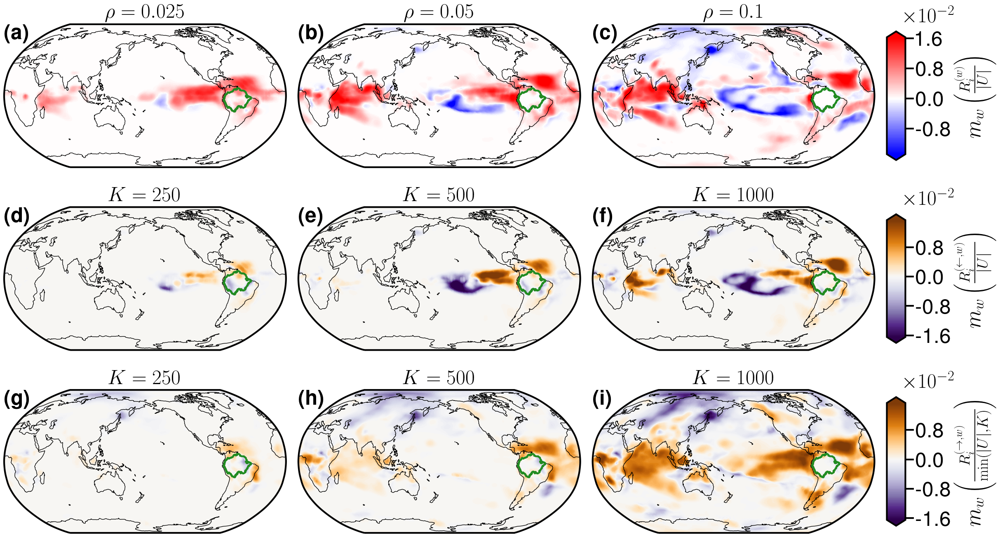

In [ ]:
densities = [0.025, 0.05, 0.1]
ks = [250, 500, 1000]

class MagnitudeFormatter(mpl.ticker.ScalarFormatter):
    def __init__(self, exponent=None):
        super().__init__()
        self._fixed_exponent = exponent

    def _set_order_of_magnitude(self):
        if self._fixed_exponent:
            self.orderOfMagnitude = self._fixed_exponent
        else:
            super()._set_order_of_magnitude()


fontsize = 36

plt.rc('text', usetex=True)
plt.rc('xtick',labelsize=fontsize)
plt.rc('ytick',labelsize=fontsize)


spacing_x = 0.01
spacing_y = 0.02


# fig, axs = plt.subplots(1,1,sharex=True,figsize=(20,10))
fig, _ = plt.subplots(figsize=(10*len(densities),18))
# fig, axs = plt.subplots(3,len(densities),figsize=(10*len(densities),18))#,gridspec_kw={'width_ratios':[1]*len(densities)+[0.046]})
axs = []
for i in range(3):
  axs.append([])
  for j in range(len(densities)):
    axs[i].append(plt.subplot2grid(shape=(3, len(densities)), loc=(i, j), projection=ccrs.Robinson(central_longitude=180)))
  # axs[i].append(plt.subplot2grid(shape=(3, len(densities)+1), loc=(i, len(densities))))
axs = np.array(axs)

# plt.subplots_adjust(wspace=0.05, hspace=.25)

# max_value = max([abs(np.min([R_i_trend_vary_density[density] for density in densities])), np.max([R_i_trend_vary_density[density] for density in densities])])
# min_value = -abs(max_value)
max_value = max([np.quantile(R_i_trend_vary_density[density],0.995) for density in densities])
min_value = min([np.quantile(R_i_trend_vary_density[density],0.005) for density in densities])
print(min_value, max_value)

for j in range(len(densities)):
  density = densities[j]

  #   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  ilat, ilon, idat = interpolate_scatter_data(latlon_icos, list(R_i_trend_vary_density[density][:,0]),
  #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

  # ax = plt.subplot2grid(shape=(3, len(densities)), loc=(0, j), projection=ccrs.Robinson(central_longitude=180))
  ax = axs[0,j]

  if j > 0:
    # pos_ax = ax.get_position(True)
    # pos_ax.x0 += spacing_x
    # pos_ax.x1 += spacing_x
    # pos_ax.update_from_data_x([axs[0,j-1].get_position(True).x1+spacing_x, axs[0,j-1].get_position(True).x1+spacing_x+width], ignore=True)

    # print(axs[0,j-1].get_position(True).y1,pos_ax.y1)

    pos_ax = ax.get_position(True)
    pos_ax_prev = axs[0,j-1].get_position(True)

    points_ax = pos_ax.get_points()
    points_ax_prev = pos_ax_prev.get_points()

    spacing = -0.015
    # width = points_ax[1][0] - points_ax[0][0]
    # height = points_ax[1][1] - points_ax[0][1]
    # width = 0.025
    points_ax[0][0] = points_ax_prev[1][0] + spacing_x
    points_ax[1][0] = points_ax[0][0] + width
    points_ax[0][1] = points_ax_prev[0][1]
    points_ax[1][1] = points_ax[0][1] + height

    pos_ax.set_points(points_ax)

    ax.set_position(pos_ax)
  else:
    pos_ax = ax.get_position(True)

    points_ax = pos_ax.get_points()

    width = points_ax[1][0] - points_ax[0][0]
    height = points_ax[1][1] - points_ax[0][1]


  ax.coastlines(zorder=5)

  cmap = mpl.cm.bwr
  cmap = shiftedColorMap(cmap, start=0, midpoint=-min_value/(max_value-min_value), stop=1.0, name='shiftedcmap')

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)

  im = ax.contourf(ilon, ilat, idat, levels=levels,
                  cmap=cmap, alpha=1, extend='both',
                  vmin=min_value, vmax=max_value,
                  transform=ccrs.PlateCarree(), zorder=-20)
  for c in im.collections:
      c.set_edgecolor("face")
  im.set_clim(min_value, max_value)
  ax.set_rasterization_zorder(-10)

  # im = ax.scatter(latlon_icos[:,1], latlon_icos[:,0],
  #                 c=R_i_trend_vary_density[density],
  #                 cmap='bwr', transform=ccrs.PlateCarree(), marker='o', s=5,
  #                 edgecolors=None)
  # im.set_clim(min_value, max_value)


  ax.annotate(r'\textbf{('+chr(97+j)+')}', xy=(0, 1), xycoords="axes fraction",
              fontsize=fontsize,usetex=True, va='top', ha='left')

  # ax.set_title(title, fontsize=fontsize)

  plt.setp(ax.spines.values(), linewidth=3, zorder=100)
  ax.tick_params(length=15,width=3)

  ax.set_title(r'$\rho = {:}$'.format(density), fontsize=fontsize, pad=10)

cax = fig.add_axes([ax.get_position().x1+0.01,ax.get_position().y0+0.05*ax.get_position().height,0.015,0.9*ax.get_position().height])
cbar = plt.colorbar(im, cax=cax,
                    orientation='vertical',fraction=0.046, aspect=10, shrink=1, pad=0.04)
# ticks = [-0.015, 0, 0.015]
ticks = [min_value, 0, max_value]
# cbar.set_ticks(ticks)
# cbar.set_ticklabels(['{:.3f}'.format(ticks[i]) for i in range(len(ticks))],usetex=True)
tick_locator = mpl.ticker.MaxNLocator(nbins=5)
cbar.locator = tick_locator
cbar.update_ticks()

# ticks = cbar.get_ticks()[1:-1]
ticks = cbar.get_ticks()
multiplier = int('{:e}'.format(np.max(np.abs(ticks))).split('e')[1])
fmt = MagnitudeFormatter(multiplier)
cbar.ax.xaxis.set_major_formatter(fmt)
# plt.ticklabel_format(style='sci', axis='y')
# print(ax.yaxis.get_major_formatter().__dict__)
cbar.ax.xaxis.offsetText.set_visible(False)

# print(yticks)
cbar.set_ticks(ticks)
cbar.set_ticklabels(['{:.1f}'.format(tick/10**multiplier) for tick in ticks])

if multiplier != 0:
    cax.annotate(r'$\times 10^{'+str(multiplier)+r'}$', xy=(0.95,1.05), xycoords='axes fraction', ha='left', va='bottom', fontsize=fontsize)


cbar.set_label(r'$m_w\left(\frac{R_{i}^{(w)}}{|U|}\right)$',fontsize=fontsize+2, usetex=True)


cbar.outline.set_linewidth(3)
cbar.ax.tick_params(length=15,width=3)


# max_value = max([abs(np.min([R_i_in_trend_vary_k[k] for k in ks])),
#                  abs(np.min([R_i_out_trend_vary_k[k] for k in ks])),
#                  np.max([R_i_in_trend_vary_k[k] for k in ks]),
#                  np.max([R_i_out_trend_vary_k[k] for k in ks])])
# min_value = -abs(max_value)
max_value = max([np.quantile(R_i_in_trend_vary_k[k],0.995) for k in ks]+[np.quantile(R_i_out_trend_vary_k[k],0.995) for k in ks])
min_value = min([np.quantile(R_i_in_trend_vary_k[k],0.005) for k in ks]+[np.quantile(R_i_out_trend_vary_k[k],0.005) for k in ks])
print(min_value, max_value)

for j in range(len(ks)):
  k = ks[j]

  #   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  ilat, ilon, idat = interpolate_scatter_data(latlon_icos, list(R_i_in_trend_vary_k[k][:,0]),
  #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

  # ax = plt.subplot2grid(shape=(3, len(ks)), loc=(1, j), projection=ccrs.Robinson(central_longitude=180))
  ax = axs[1,j]

  if j > 0:
    pos_ax = ax.get_position(True)
    pos_ax_prev = axs[1,j-1].get_position(True)

    points_ax = pos_ax.get_points()
    points_ax_prev = pos_ax_prev.get_points()

    spacing = -0.015
    # width = points_ax[1][0] - points_ax[0][0]
    # height = points_ax[1][1] - points_ax[0][1]
    # width = 0.025
    points_ax[0][0] = points_ax_prev[1][0] + spacing_x
    points_ax[1][0] = points_ax[0][0] + width
    points_ax[0][1] = points_ax_prev[0][1]
    points_ax[1][1] = points_ax[0][1] + height

    pos_ax.set_points(points_ax)

    ax.set_position(pos_ax)
  else:
    pos_ax = ax.get_position(True)
    pos_ax_prev = axs[0,0].get_position(True)

    points_ax = pos_ax.get_points()
    points_ax_prev = pos_ax_prev.get_points()

    spacing = 0.05
    # height = points_ax[1][1] - points_ax[0][1]
    # width = 0.025
    points_ax[1][1] = points_ax_prev[0][1] - spacing_y
    points_ax[0][1] = points_ax[1][1] - height
    points_ax[0][0] = points_ax_prev[0][0]
    points_ax[1][0] = points_ax[0][0] + width

    pos_ax.set_points(points_ax)

    ax.set_position(pos_ax)

  ax.coastlines(zorder=5)

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  cmap = mpl.cm.PuOr_r
  cmap = shiftedColorMap(cmap, start=0, midpoint=-min_value/(max_value-min_value), stop=1.0, name='shiftedcmap')


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)

  im = ax.contourf(ilon, ilat, idat, levels=levels,
                  cmap=cmap, alpha=1, extend='both',
                  vmin=min_value, vmax=max_value,
                  transform=ccrs.PlateCarree(), zorder=-20)
  for c in im.collections:
      c.set_edgecolor("face")
  im.set_clim(min_value, max_value)
  ax.set_rasterization_zorder(-10)


  ax.annotate(r'\textbf{('+chr(97+len(densities)+j)+')}', xy=(0, 1), xycoords="axes fraction",
              fontsize=fontsize,usetex=True, va='top', ha='left')

  # ax.set_title(title, fontsize=fontsize)

  plt.setp(ax.spines.values(), linewidth=3, zorder=100)
  ax.tick_params(length=15,width=3)


  ax.set_title(r'$K = {:}$'.format(k), fontsize=fontsize, pad=10)

cax = fig.add_axes([ax.get_position().x1+0.01,ax.get_position().y0+0.05*ax.get_position().height,0.015,0.9*ax.get_position().height])
cbar = plt.colorbar(im, cax=cax,
                    orientation='vertical',fraction=0.046, aspect=10, shrink=1, pad=0.04)
# ticks = [-0.015, 0, 0.015]
ticks = [min_value, 0, max_value]
# cbar.set_ticks(ticks)
# cbar.set_ticklabels(['{:.3f}'.format(ticks[i]) for i in range(len(ticks))],usetex=True)
tick_locator = mpl.ticker.MaxNLocator(nbins=5)
cbar.locator = tick_locator
cbar.update_ticks()

# ticks = cbar.get_ticks()[1:-1]
ticks = cbar.get_ticks()
multiplier = int('{:e}'.format(np.max(np.abs(ticks))).split('e')[1])
fmt = MagnitudeFormatter(multiplier)
cbar.ax.xaxis.set_major_formatter(fmt)
# plt.ticklabel_format(style='sci', axis='y')
# print(ax.yaxis.get_major_formatter().__dict__)
cbar.ax.xaxis.offsetText.set_visible(False)

# print(yticks)
cbar.set_ticks(ticks)
cbar.set_ticklabels(['{:.1f}'.format(tick/10**multiplier) for tick in ticks])

if multiplier != 0:
    cax.annotate(r'$\times 10^{'+str(multiplier)+r'}$', xy=(0.95,1.05), xycoords='axes fraction', ha='left', va='bottom', fontsize=fontsize)


cbar.set_label(r'$m_w\left(\frac{R_{i}^{(\leftarrow,w)}}{|U|}\right)$',fontsize=fontsize+2, usetex=True)


cbar.outline.set_linewidth(3)
cbar.ax.tick_params(length=15,width=3)





# max_value = max([abs(np.min([R_i_out_trend_vary_k[k] for k in ks])), np.max([R_i_out_trend_vary_k[k] for k in ks])])
# min_value = -abs(max_value)
# print(min_value, max_value)

for j in range(len(ks)):
  k = ks[j]

  #   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  ilat, ilon, idat = interpolate_scatter_data(latlon_icos, list(R_i_out_trend_vary_k[k][:,0]),
  #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

  # ax = plt.subplot2grid(shape=(3, len(ks)), loc=(2, j), projection=ccrs.Robinson(central_longitude=180))
  ax = axs[2,j]

  if j > 0:
    pos_ax = ax.get_position(True)
    pos_ax_prev = axs[2,j-1].get_position(True)

    points_ax = pos_ax.get_points()
    points_ax_prev = pos_ax_prev.get_points()

    spacing = -0.015
    # width = points_ax[1][0] - points_ax[0][0]
    # width = 0.025
    points_ax[0][0] = points_ax_prev[1][0] + spacing_x
    points_ax[1][0] = points_ax[0][0] + width
    points_ax[0][1] = points_ax_prev[0][1]
    points_ax[1][1] = points_ax[0][1] + height

    pos_ax.set_points(points_ax)

    ax.set_position(pos_ax)
  else:
    pos_ax = ax.get_position(True)
    pos_ax_prev = axs[1,0].get_position(True)

    points_ax = pos_ax.get_points()
    points_ax_prev = pos_ax_prev.get_points()

    spacing = 0.05
    # height = points_ax[1][1] - points_ax[0][1]
    # width = 0.025
    points_ax[1][1] = points_ax_prev[0][1] - spacing_y
    points_ax[0][1] = points_ax[1][1] - height
    points_ax[0][0] = points_ax_prev[0][0]
    points_ax[1][0] = points_ax[0][0] + width

    pos_ax.set_points(points_ax)

    ax.set_position(pos_ax)

  ax.coastlines(zorder=5)

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  cmap = mpl.cm.PuOr_r
  cmap = shiftedColorMap(cmap, start=0, midpoint=-min_value/(max_value-min_value), stop=1.0, name='shiftedcmap')

  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)

  im = ax.contourf(ilon, ilat, idat, levels=levels,
                  cmap=cmap, alpha=1, extend='both',
                  vmin=min_value, vmax=max_value,
                  transform=ccrs.PlateCarree(), zorder=-20)
  for c in im.collections:
      c.set_edgecolor("face")
  im.set_clim(min_value, max_value)
  ax.set_rasterization_zorder(-10)


  ax.annotate(r'\textbf{('+chr(97+len(densities)+len(ks)+j)+')}', xy=(0, 1), xycoords="axes fraction",
              fontsize=fontsize,usetex=True, va='top', ha='left')

  # ax.set_title(title, fontsize=fontsize)

  plt.setp(ax.spines.values(), linewidth=3, zorder=100)
  ax.tick_params(length=15,width=3)


  ax.set_title(r'$K = {:}$'.format(k), fontsize=fontsize, pad=10)

cax = fig.add_axes([ax.get_position().x1+0.01,ax.get_position().y0+0.05*ax.get_position().height,0.015,0.9*ax.get_position().height])
cbar = plt.colorbar(im, cax=cax,
                    orientation='vertical',fraction=0.046, aspect=10, shrink=1, pad=0.04)
# ticks = [-0.015, 0, 0.015]
ticks = [min_value, 0, max_value]
# cbar.set_ticks(ticks)
# cbar.set_ticklabels(['{:.3f}'.format(ticks[i]) for i in range(len(ticks))],usetex=True)
tick_locator = mpl.ticker.MaxNLocator(nbins=5)
cbar.locator = tick_locator
cbar.update_ticks()

# ticks = cbar.get_ticks()[1:-1]
ticks = cbar.get_ticks()
multiplier = int('{:e}'.format(np.max(np.abs(ticks))).split('e')[1])
fmt = MagnitudeFormatter(multiplier)
cbar.ax.xaxis.set_major_formatter(fmt)
# plt.ticklabel_format(style='sci', axis='y')
# print(ax.yaxis.get_major_formatter().__dict__)
cbar.ax.xaxis.offsetText.set_visible(False)

# print(yticks)
cbar.set_ticks(ticks)
cbar.set_ticklabels(['{:.1f}'.format(tick/10**multiplier) for tick in ticks])

if multiplier != 0:
    cax.annotate(r'$\times 10^{'+str(multiplier)+r'}$', xy=(0.95,1.05), xycoords='axes fraction', ha='left', va='bottom', fontsize=fontsize)


cbar.set_label(r'$m_w\left(\frac{R_{i}^{(\rightarrow,w)}}{\min(|U|,K)}\right)$',fontsize=fontsize+2, usetex=True)


cbar.outline.set_linewidth(3)
cbar.ax.tick_params(length=15,width=3)





# fig.align_labels()


# plt.tight_layout()
# plt.subplots_adjust(wspace=0, hspace=.35)

title = 'Amazon Connectivity Trend (Rasterized)'
# plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2)
plt.savefig(fig_dir+title+'.eps', format='eps')
plt.show()
plt.close(fig)

In [ ]:
points_ax

array([[0.36676471, 0.2848938 ],
       [0.50264706, 0.51136439]])

In [ ]:
mpl.__version__

'3.3.4'

In [ ]:
k = 50

dir_end = '-months='+str(months)+',offset='+str(offset)+',k={:}'.format(k)+'/'

graph_dir = data_dir+'G'+dir_end

with gzip.open(graph_dir + dates[0] + '.data', 'rb') as file:
  G = pkl.load(file)

A = nx.adjacency_matrix(G)

D = np.diag([d[1] for d in G.degree()])

D_inv_sqrt = np.sqrt(np.linalg.pinv(D))

L = np.matmul(D_inv_sqrt,np.matmul(A,D_inv_sqrt))

numpy.allclose(L, L.T, rtol=1e-05, atol=1e-08)

ValueError: ignored

In [ ]:
np.dot(A,D_inv_sqrt)

In [ ]:
ks = [250, 500, 1000]

max_value = max([abs(np.min([R_i_out_trend_vary_k[k] for k in ks])), np.max([R_i_out_trend_vary_k[k] for k in ks])])
min_value = -abs(max_value)
print(min_value, max_value)

fontsize = 36

plt.rc('text', usetex=True)
plt.rc('xtick',labelsize=fontsize)
plt.rc('ytick',labelsize=fontsize)


# fig, axs = plt.subplots(1,1,sharex=True,figsize=(20,10))
fig = plt.figure(figsize=(10*len(ks),5))

for j in range(len(ks)):
  k = ks[j]

  #   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  ilat, ilon, idat = interpolate_scatter_data(latlon_icos, list(R_i_out_trend_vary_k[k][:,0]),
  #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
                      method='linear', num_interp_pts=20, threshold_dateline=5, threshold_poles=15)

  ax = plt.subplot2grid(shape=(1, len(ks)), loc=(0, j), projection=ccrs.Robinson(central_longitude=180))

  ax.coastlines(zorder=5)

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  cmap = mpl.cm.PuOr_r


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)

  im = ax.contourf(ilon, ilat, idat, levels=levels,
                  cmap=cmap, alpha=1,
                  vmin=min_value, vmax=max_value,
                  transform=ccrs.PlateCarree(), zorder=4)
  for c in im.collections:
      c.set_edgecolor("face")
  im.set_clim(min_value, max_value)


  ax.annotate(r'\textbf{('+chr(97+j)+')}', xy=(0, 1), xycoords="axes fraction",
              fontsize=fontsize,usetex=True, va='top', ha='left')

  # ax.set_title(title, fontsize=fontsize)

  plt.setp(ax.spines.values(), linewidth=3, zorder=100)
  ax.tick_params(length=15,width=3)


  ax.set_title(r'$K = {:}$'.format(k), fontsize=fontsize, pad=10)

plt.tight_layout()
plt.subplots_adjust(hspace = 0.2, wspace = -0.5)

cbar2 = fig.colorbar(im, ax = fig.get_axes(), anchor=(0.5, 0),
                    orientation='horizontal',fraction=0.1, pad=0.06)
# ticks = [-0.015, 0, 0.015]
ticks = [min_value, 0, max_value]
cbar2.set_ticks(ticks)
cbar2.set_ticklabels(['{:.3f}'.format(ticks[i]) for i in range(len(ticks))],usetex=True)


cbar2.set_label(r'$m_w\left(R_{i,out}^{(w)}/\min(|U|,K)\right)$',fontsize=fontsize, usetex=True)


cbar2.outline.set_linewidth(3)
cbar2.ax.tick_params(length=15,width=3)

In [ ]:
fig.get_axes()

[<GeoAxes: title={'center': '$\\rho = 0.025$'}>,
 <GeoAxes: title={'center': '$\\rho = 0.05$'}>,
 <GeoAxes: title={'center': '$\\rho = 0.1$'}>,
 <Axes: label='<colorbar>', xlabel='$m_w\\left(R_{i}^{(w)}/|U|\\right)$'>,
 <GeoAxes: title={'center': '$K = 250$'}>,
 <GeoAxes: title={'center': '$K = 500$'}>,
 <GeoAxes: title={'center': '$K = 1000$'}>,
 <Axes: label='<colorbar>', xlabel='$m_w\\left(R_{i,out}^{(w)}/\\min(|U|,K)\\right)$'>,
 <GeoAxes: title={'center': '$K = 250$'}>,
 <GeoAxes: title={'center': '$K = 500$'}>,
 <GeoAxes: title={'center': '$K = 1000$'}>,
 <Axes: label='<colorbar>', xlabel='$m_w\\left(R_{i,in}^{(w)}/|U|\\right)$'>]

-0.020104126914899417 0.020104126914899417


Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

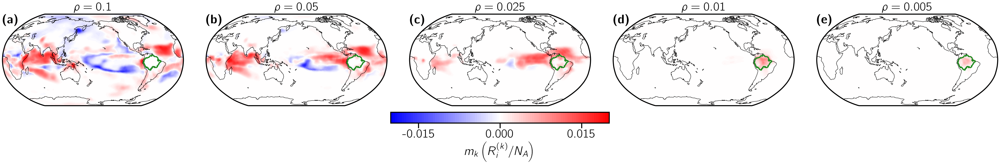

In [ ]:
fontsize = 36

plt.rc('text', usetex=True)
plt.rc('xtick',labelsize=fontsize)
plt.rc('ytick',labelsize=fontsize)

max_value = max([abs(np.min([R_i_trend_vary_density[density] for density in densities])), np.max([R_i_trend_vary_density[density] for density in densities])])
min_value = -abs(max_value)
print(min_value, max_value)


# fig, axs = plt.subplots(1,1,sharex=True,figsize=(20,10))
fig = plt.figure(figsize=(10*len(densities),5))

for j in range(len(densities)):
  density = densities[j]

  # latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  ilat, ilon, idat = interpolate_scatter_data(latlon_icos, list(R_i_trend_vary_density[density][:,0]),
  #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

  #   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  #   ilat, ilon, idat = interpolate_scatter_data(latlon_icos, R_i_dict_vary_density[density][date],
  # #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
  #                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

  ax = plt.subplot2grid(shape=(1, len(densities)), loc=(0, j), projection=ccrs.Robinson(central_longitude=180))

  ax.coastlines(zorder=5)

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  cmap = mpl.cm.bwr


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)

  im = ax.contourf(ilon, ilat, idat, levels=levels,
                  cmap=cmap, alpha=1,
                  vmin=min_value, vmax=max_value,
                  transform=ccrs.PlateCarree(), zorder=4)
  for c in im.collections:
      c.set_edgecolor("face")
  im.set_clim(min_value, max_value)


  ax.annotate(r'\textbf{('+chr(97+j)+')}', xy=(0, 1), xycoords="axes fraction",
              fontsize=fontsize,usetex=True, va='top', ha='left')

  # ax.set_title(title, fontsize=fontsize)

  plt.setp(ax.spines.values(), linewidth=3, zorder=100)
  ax.tick_params(length=15,width=3)

  if i == len(dates_to_plot) - 1:
    ax.set_title(r'$\rho = {:}$'.format(density), fontsize=fontsize, pad=10)

plt.tight_layout()
plt.subplots_adjust(hspace = 0.2, wspace = -0.5)

cbar = fig.colorbar(im, ax = fig.get_axes(), anchor=(0.5, 0),
                    orientation='horizontal',fraction=0.1, pad=0.06)
ticks = [-0.015, 0, 0.015]
cbar.set_ticks(ticks)
cbar.set_ticklabels(['{:.3f}'.format(ticks[i]) for i in range(len(ticks))],usetex=True)


cbar.set_label(r'$m_k\left(R_{i,out}^{(k)}/N_A\right)$',fontsize=fontsize, usetex=True)


cbar.outline.set_linewidth(3)
cbar.ax.tick_params(length=15,width=3)

title = 'Amazon Connectivity Trend (Vary Density)'
plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)
plt.show()
plt.close(fig)

# Random Walk

In [ ]:
with gzip.open(data_dir + 'icosahedral_grid.data', 'rb') as file:
  latlon_icos = np.array(pkl.load(file))

months = 300
offset = 365.25
k = 50

dir_end = '-months='+str(months)+',offset='+str(offset)+',k={:}'.format(k)+'/'

edge_dir = data_dir + 'edge_list' + dir_end

total_networks = len(os.listdir(edge_dir))

num_nodes = 10242

with gzip.open(data_dir + 'year_intervals-months='+str(months)+',offset='+str(offset) + '.data', 'rb') as file:
  year_intervals = pkl.load(file)

with gzip.open(data_dir + 'date_intervals-months='+str(months)+',offset='+str(offset) + '.data', 'rb') as file:
  date_intervals = pkl.load(file)

dates = [year_intervals[i][0] + '-' + year_intervals[i][1] for i in range(len(year_intervals))]
print(dates)

reader = shpreader.Reader(base_dir+'Amazon Biome/amazonia.shp')
amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())

recompute = False

if recompute:
  amazon_nodes = []

  for i in range(num_nodes):
    if amazon._geoms[0].contains(Point(latlon_icos[i,1]-360,latlon_icos[i,0])):
      amazon_nodes.append(i)

  with gzip.open(data_dir + 'amazon_nodes_new_networks.data', 'wb') as file:
    pkl.dump(amazon_nodes, file)
else:
  with gzip.open(data_dir + 'amazon_nodes_new_networks.data', 'rb') as file:
    amazon_nodes = pkl.load(file)

recompute = False

graph_dir = data_dir + 'G' + dir_end
if recompute:
  if not os.path.isdir(graph_dir):
    os.mkdir(graph_dir)

  for i in trange(len(dates)):
    date = dates[i]

    with gzip.open(edge_dir + str(i) + '.data', 'rb') as file:
      edge_list = pkl.load(file)

    G = nx.from_edgelist(edge_list, nx.DiGraph) # initiall unsorted

    H = nx.DiGraph() # make sorted copy
    H.add_nodes_from(sorted(G.nodes(data=True)))
    H.add_edges_from(G.edges(data=True))
    G = H # write over original with sorted copy
    del H # delete sorted copy

    degrees = [d[1] for d in G.degree()]

    print(i, nx.density(G), nx.number_strongly_connected_components(G), G.number_of_edges(), min(degrees), max(degrees), np.mean(degrees))

    # with gzip.open(graph_dir + date + '.data', 'wb') as file:
    #   pkl.dump(G, file)

['1948-1973', '1949-1974', '1950-1975', '1951-1976', '1952-1977', '1953-1978', '1954-1979', '1955-1980', '1956-1981', '1957-1982', '1958-1983', '1959-1984', '1960-1985', '1961-1986', '1962-1987', '1963-1988', '1964-1989', '1965-1990', '1966-1991', '1967-1992', '1968-1993', '1969-1994', '1970-1995', '1971-1996', '1972-1997', '1973-1998', '1974-1999', '1975-2000', '1976-2001', '1977-2002', '1978-2003', '1979-2004', '1980-2005', '1981-2006', '1982-2007', '1983-2008', '1984-2009', '1985-2010', '1986-2011', '1987-2012', '1988-2013', '1989-2014', '1990-2015', '1991-2016', '1992-2017', '1993-2018', '1994-2019', '1995-2020', '1996-2021', '1997-2022', '1998-2023']


In [ ]:
walk_probability_dict = {}

random_walk_base_dir = data_dir + 'Random Walks/'
if not os.path.isdir(random_walk_base_dir):
  os.mkdir(random_walk_base_dir)

ks = [50, 100, 250, 500, 1000]
densities = [0.005, 0.01, 0.025, 0.05, 0.1]

recompute = False

if recompute:
  for k in ks:
    dir_end = '-months={:},offset={:},k={:}/'.format(months,offset,k)

    graph_dir = data_dir + 'G' + dir_end

    random_walk_dir = random_walk_base_dir + 'Random Walks' + dir_end
    if not os.path.isdir(random_walk_dir):
      os.mkdir(random_walk_dir)

    walk_probability_dict[k] = {}

    for date in tqdm(dates, leave=False, desc=f'k={k}'):
      with gzip.open(random_walk_dir + date + '.data', 'rb') as file:
        walk_probability_dict[k][date] = pkl.load(file)

    with gzip.open(random_walk_base_dir + 'walk_probability_dict'+dir_end[:-1]+'.data', 'wb') as file:
      pkl.dump(walk_probability_dict[k], file)



  for density in densities:
    dir_end = '-months={:},offset={:},density={:}/'.format(months,offset,density)

    graph_dir = data_dir + 'G' + dir_end

    random_walk_dir = random_walk_base_dir + 'Random Walks' + dir_end
    if not os.path.isdir(random_walk_dir):
      os.mkdir(random_walk_dir)

    walk_probability_dict[density] = {}

    for date in tqdm(dates, leave=False, desc=f'density={density}'):
      with gzip.open(random_walk_dir + date + '.data', 'rb') as file:
        walk_probability_dict[density][date] = pkl.load(file)

    with gzip.open(random_walk_base_dir + 'walk_probability_dict'+dir_end[:-1]+'.data', 'wb') as file:
      pkl.dump(walk_probability_dict[density], file)

  # with gzip.open(random_walk_base_dir + 'walk_probability_dict.data', 'wb') as file:
  #   pkl.dump(walk_probability_dict, file)
else:
  with gzip.open(random_walk_base_dir + 'walk_probability_dict.data', 'rb') as file:
    walk_probability_dict = pkl.load(file)

In [ ]:
del walk_probability_dict

In [ ]:
random_walk_base_dir = data_dir + 'Random Walks/'
if not os.path.isdir(random_walk_base_dir):
  os.mkdir(random_walk_base_dir)

ks = [50, 100, 250, 500, 1000]
densities = [0.005, 0.01, 0.025, 0.05, 0.1]

recompute = False

if recompute:
  average_walk_probability_dict = {}
  num_nodes_affected_dict = {}
  walk_probability_trend_dict = {}

  random_walk_base_dir = data_dir + 'Random Walks/'
  if not os.path.isdir(random_walk_base_dir):
    os.mkdir(random_walk_base_dir)

  for k in ks:
    dir_end = dir_end = '-months={:},offset={:},k={:}/'.format(months,offset,k)

    with gzip.open(random_walk_base_dir + 'walk_probability_dict'+dir_end[:-1]+'.data', 'rb') as file:
      walk_probability_dict = pkl.load(file)

    non_amazon_nodes = np.array(list(set(range(num_nodes)) - set(amazon_nodes)))

    average_walk_probability_dict[k] = {date:None for date in dates}
    for date in dates:
      average_walk_probability_dict[k][date] = np.mean(walk_probability_dict[date][non_amazon_nodes,:],axis=0)


    num_nodes_affected_dict[k] = {date:None for date in dates}
    for date in tqdm(dates, desc='k = {:}, # Nodes Affected'.format(k), leave=False):
      threshold = len(amazon_nodes)/num_nodes
      num_nodes_affected_dict[k][date] = np.array([len(np.where(walk_probability_dict[date][non_amazon_nodes,i] >= threshold)[0]) for i in range(walk_probability_dict[dates[0]].shape[1])])/len(non_amazon_nodes)


    walk_probability_trend_dict[k] = np.zeros((num_nodes,walk_probability_dict[dates[0]].shape[1]))
    for i in trange(walk_probability_dict[dates[0]].shape[1], desc='k = {:}, Diff Dist Trend'.format(k), leave=False):
      for node in range(num_nodes):
          slope, _ = np.polyfit(list(range(len(dates))), [walk_probability_dict[date][node,i] for date in dates], 1)
          walk_probability_trend_dict[k][node,i] = slope

    i_max_change = np.argmax(np.percentile(walk_probability_trend_dict[k],0.75,axis=0)-np.percentile(walk_probability_trend_dict[k],0.25,axis=0)) # max interquartile range
    print(k, i_max_change)

  for density in densities:
    dir_end = dir_end = '-months={:},offset={:},density={:}/'.format(months,offset,density)

    with gzip.open(random_walk_base_dir + 'walk_probability_dict'+dir_end[:-1]+'.data', 'rb') as file:
      walk_probability_dict = pkl.load(file)

    non_amazon_nodes = np.array(list(set(range(num_nodes)) - set(amazon_nodes)))

    average_walk_probability_dict[density] = {date:None for date in dates}
    for date in dates:
      average_walk_probability_dict[density][date] = np.mean(walk_probability_dict[date][non_amazon_nodes,:],axis=0)


    num_nodes_affected_dict[density] = {date:None for date in dates}
    for date in tqdm(dates, desc='density = {:}, # Nodes Affected'.format(density), leave=False):
      threshold = len(amazon_nodes)/num_nodes
      num_nodes_affected_dict[density][date] = np.array([len(np.where(walk_probability_dict[date][non_amazon_nodes,i] >= threshold)[0]) for i in range(walk_probability_dict[dates[0]].shape[1])])/len(non_amazon_nodes)


    walk_probability_trend_dict[density] = np.zeros((num_nodes,walk_probability_dict[dates[0]].shape[1]))
    for i in trange(walk_probability_dict[dates[0]].shape[1], desc='density = {:}, Diff Dist Trend'.format(density), leave=False):
      for node in range(num_nodes):
          slope, _ = np.polyfit(list(range(len(dates))), [walk_probability_dict[date][node,i] for date in dates], 1)
          walk_probability_trend_dict[density][node,i] = slope

    i_max_change = np.argmax(np.percentile(walk_probability_trend_dict[density],0.75,axis=0)-np.percentile(walk_probability_trend_dict[density],0.25,axis=0)) # max interquartile range
    print(k, i_max_change)

  with gzip.open(random_walk_base_dir + 'processed_results.data', 'wb') as file:
    pkl.dump(average_walk_probability_dict, file)
    pkl.dump(num_nodes_affected_dict, file)
    pkl.dump(walk_probability_trend_dict, file)
else:
  with gzip.open(random_walk_base_dir + 'processed_results.data', 'rb') as file:
    average_walk_probability_dict = pkl.load(file)
    num_nodes_affected_dict = pkl.load(file)
    walk_probability_trend_dict = pkl.load(file)

In [ ]:
random_walk_base_dir = data_dir + 'Random Walks/'
if not os.path.isdir(random_walk_base_dir):
  os.mkdir(random_walk_base_dir)

ks = [50, 100, 250, 500, 1000]
densities = [0.005, 0.01, 0.025, 0.05, 0.1]

recompute = False

if recompute:
  num_nodes_affected_dict = {}

  random_walk_base_dir = data_dir + 'Random Walks/'
  if not os.path.isdir(random_walk_base_dir):
    os.mkdir(random_walk_base_dir)

  for k in ks:
    dir_end = dir_end = '-months={:},offset={:},k={:}/'.format(months,offset,k)

    with gzip.open(random_walk_base_dir + 'walk_probability_dict'+dir_end[:-1]+'.data', 'rb') as file:
      walk_probability_dict = pkl.load(file)

    non_amazon_nodes = np.array(list(set(range(num_nodes)) - set(amazon_nodes)))


    num_nodes_affected_dict[k] = {date:None for date in dates}
    for date in tqdm(dates, desc='k = {:}, # Nodes Affected'.format(k), leave=False):
      threshold = len(amazon_nodes)/(num_nodes**2)
      num_nodes_affected_dict[k][date] = np.array([len(np.where(walk_probability_dict[date][non_amazon_nodes,i] >= threshold)[0]) for i in range(walk_probability_dict[dates[0]].shape[1])])/len(non_amazon_nodes)


  for density in densities:
    dir_end = dir_end = '-months={:},offset={:},density={:}/'.format(months,offset,density)

    with gzip.open(random_walk_base_dir + 'walk_probability_dict'+dir_end[:-1]+'.data', 'rb') as file:
      walk_probability_dict = pkl.load(file)

    non_amazon_nodes = np.array(list(set(range(num_nodes)) - set(amazon_nodes)))


    num_nodes_affected_dict[density] = {date:None for date in dates}
    for date in tqdm(dates, desc='density = {:}, # Nodes Affected'.format(density), leave=False):
      threshold = len(amazon_nodes)/(num_nodes**2)
      num_nodes_affected_dict[density][date] = np.array([len(np.where(walk_probability_dict[date][non_amazon_nodes,i] >= threshold)[0]) for i in range(walk_probability_dict[dates[0]].shape[1])])/len(non_amazon_nodes)


  with gzip.open(random_walk_base_dir + 'num_nodes_affected_dict.data', 'wb') as file:
    pkl.dump(num_nodes_affected_dict, file)
else:
  with gzip.open(random_walk_base_dir + 'num_nodes_affected_dict.data', 'rb') as file:
    num_nodes_affected_dict = pkl.load(file)

In [ ]:
average_walk_probability_dict[50][dates[0]].shape

(501,)

In [ ]:
fig_walk_dir = fig_dir + 'Random Walks/'
if not os.path.isdir(fig_walk_dir):
  os.mkdir(fig_walk_dir)

-0.00010998496161218237 3.8812777030968974e-05


Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

-5.998739211683676e-05 4.555293845286415e-05


Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

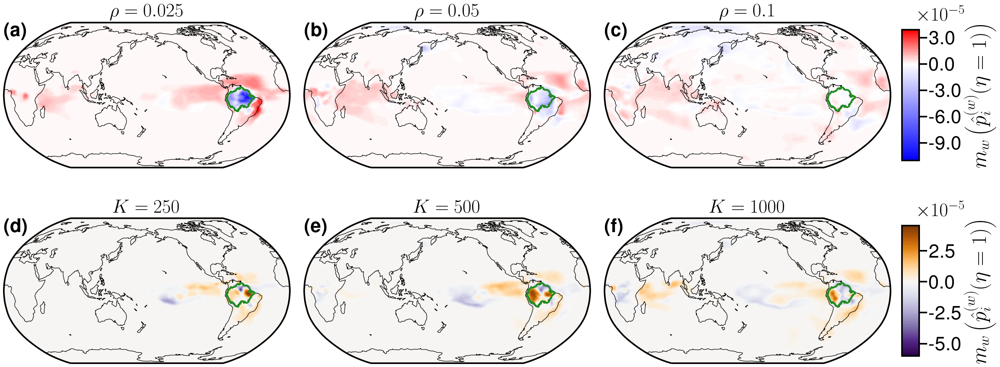

In [ ]:
densities = [0.025, 0.05, 0.1]
ks = [250, 500, 1000]

class MagnitudeFormatter(mpl.ticker.ScalarFormatter):
    def __init__(self, exponent=None):
        super().__init__()
        self._fixed_exponent = exponent

    def _set_order_of_magnitude(self):
        if self._fixed_exponent:
            self.orderOfMagnitude = self._fixed_exponent
        else:
            super()._set_order_of_magnitude()


fontsize = 36

plt.rc('text', usetex=True)
plt.rc('xtick',labelsize=fontsize)
plt.rc('ytick',labelsize=fontsize)


# fig, axs = plt.subplots(1,1,sharex=True,figsize=(20,10))
fig = plt.figure(figsize=(10*len(densities),12))
# fig, axs = plt.subplots(3,len(densities),figsize=(10*len(densities),18))#,gridspec_kw={'width_ratios':[1]*len(densities)+[0.046]})
axs = []
for i in range(2):
  axs.append([])
  for j in range(len(densities)):
    axs[i].append(plt.subplot2grid(shape=(2, len(densities)), loc=(i, j), projection=ccrs.Robinson(central_longitude=180)))
  # axs[i].append(plt.subplot2grid(shape=(3, len(densities)+1), loc=(i, len(densities))))
axs = np.array(axs)

plt.subplots_adjust(wspace=0.05, hspace=.25)

i_max_changes = []
for density in densities:
  i_max_changes.append(np.argmax(np.percentile(walk_probability_trend_dict[density],0.75,axis=0)-np.percentile(walk_probability_trend_dict[density],0.25,axis=0)))

# max_value = max([abs(np.min([walk_probability_trend_dict[densities[i]][:,i_max_changes[i]] for i in range(len(densities))])), np.max([walk_probability_trend_dict[densities[i]][:,i_max_changes[i]] for i in range(len(densities))])])
# min_value = -abs(max_value)
max_value = max([np.max([walk_probability_trend_dict[densities[i]][:,i_max_changes[i]] for i in range(len(densities))])])
min_value = min([np.min([walk_probability_trend_dict[densities[i]][:,i_max_changes[i]] for i in range(len(densities))])])
print(min_value, max_value)

for j in range(len(densities)):
  density = densities[j]

  #   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  ilat, ilon, idat = interpolate_scatter_data(latlon_icos, list(walk_probability_trend_dict[density][:,i_max_changes[j]]),
  #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

  # ax = plt.subplot2grid(shape=(3, len(densities)), loc=(0, j), projection=ccrs.Robinson(central_longitude=180))
  ax = axs[0,j]

  ax.coastlines(zorder=5)

  cmap = mpl.cm.bwr
  cmap = shiftedColorMap(cmap, start=0, midpoint=-min_value/(max_value-min_value), stop=1.0, name='shiftedcmap')

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)

  im = ax.contourf(ilon, ilat, idat, levels=levels,
                  cmap=cmap, alpha=1,
                  vmin=min_value, vmax=max_value,
                  transform=ccrs.PlateCarree(), zorder=4)
  for c in im.collections:
      c.set_edgecolor("face")
  im.set_clim(min_value, max_value)

  # im = ax.scatter(latlon_icos[:,1], latlon_icos[:,0],
  #                 c=R_i_trend_vary_density[density],
  #                 cmap='bwr', transform=ccrs.PlateCarree(), marker='o', s=5,
  #                 edgecolors=None)
  # im.set_clim(min_value, max_value)


  ax.annotate(r'\textbf{('+chr(97+j)+')}', xy=(0, 1), xycoords="axes fraction",
              fontsize=fontsize,usetex=True, va='top', ha='left')

  # ax.set_title(title, fontsize=fontsize)

  plt.setp(ax.spines.values(), linewidth=3, zorder=100)
  ax.tick_params(length=15,width=3)

  ax.set_title(r'$\rho = {:}$'.format(density), fontsize=fontsize, pad=10)

cax = fig.add_axes([ax.get_position().x1+0.01,ax.get_position().y0+0.05*ax.get_position().height,0.015,0.9*ax.get_position().height])
cbar = plt.colorbar(im, cax=cax,
                    orientation='vertical',fraction=0.046, aspect=10, shrink=1, pad=0.04)
# ticks = [-0.015, 0, 0.015]
ticks = [min_value, 0, max_value]
# cbar.set_ticks(ticks)
# cbar.set_ticklabels(['{:.3f}'.format(ticks[i]) for i in range(len(ticks))],usetex=True)
tick_locator = mpl.ticker.MaxNLocator(nbins=5)
cbar.locator = tick_locator
cbar.update_ticks()

ticks = cbar.get_ticks()[1:-1]
multiplier = int('{:e}'.format(ticks[-1]).split('e')[1])
fmt = MagnitudeFormatter(multiplier)
cbar.ax.xaxis.set_major_formatter(fmt)
# plt.ticklabel_format(style='sci', axis='y')
# print(ax.yaxis.get_major_formatter().__dict__)
cbar.ax.xaxis.offsetText.set_visible(False)

# print(yticks)
cbar.set_ticks(ticks)
cbar.set_ticklabels(['{:.1f}'.format(tick/10**multiplier) for tick in ticks])

if multiplier != 0:
    cax.annotate(r'$\times 10^{'+str(multiplier)+r'}$', xy=(0.95,1.05), xycoords='axes fraction', ha='left', va='bottom', fontsize=fontsize)


cbar.set_label(r'$m_w\left(\hat{p}_i^{(w)}('+r'\eta={:}'.format(i_max_changes[0])+r')\right)$',fontsize=fontsize+4)


cbar.outline.set_linewidth(3)
cbar.ax.tick_params(length=15,width=3)







i_max_changes = []
for k in ks:
  i_max_changes.append(np.argmax(np.percentile(walk_probability_trend_dict[k],0.75,axis=0)-np.percentile(walk_probability_trend_dict[k],0.25,axis=0)))

# max_value = max([abs(np.min([walk_probability_trend_dict[ks[i]][:,i_max_changes[i]] for i in range(len(ks))])), np.max([walk_probability_trend_dict[ks[i]][:,i_max_changes[i]] for i in range(len(ks))])])
# min_value = -abs(max_value)
max_value = max([np.max([walk_probability_trend_dict[ks[i]][:,i_max_changes[i]] for i in range(len(ks))])])
min_value = min([np.min([walk_probability_trend_dict[ks[i]][:,i_max_changes[i]] for i in range(len(ks))])])
print(min_value, max_value)

for j in range(len(ks)):
  k = ks[j]

  #   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  ilat, ilon, idat = interpolate_scatter_data(latlon_icos, list(walk_probability_trend_dict[k][:,i_max_changes[j]]),
  #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

  # ax = plt.subplot2grid(shape=(3, len(ks)), loc=(1, j), projection=ccrs.Robinson(central_longitude=180))
  ax = axs[1,j]

  ax.coastlines(zorder=5)

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  cmap = mpl.cm.PuOr_r
  cmap = shiftedColorMap(cmap, start=0, midpoint=-min_value/(max_value-min_value), stop=1.0, name='shiftedcmap')


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)

  im = ax.contourf(ilon, ilat, idat, levels=levels,
                  cmap=cmap, alpha=1,
                  vmin=min_value, vmax=max_value,
                  transform=ccrs.PlateCarree(), zorder=4)
  for c in im.collections:
      c.set_edgecolor("face")
  im.set_clim(min_value, max_value)


  ax.annotate(r'\textbf{('+chr(97+len(densities)+j)+')}', xy=(0, 1), xycoords="axes fraction",
              fontsize=fontsize,usetex=True, va='top', ha='left')

  # ax.set_title(title, fontsize=fontsize)

  plt.setp(ax.spines.values(), linewidth=3, zorder=100)
  ax.tick_params(length=15,width=3)


  ax.set_title(r'$K = {:}$'.format(k), fontsize=fontsize, pad=10)

cax = fig.add_axes([ax.get_position().x1+0.01,ax.get_position().y0+0.05*ax.get_position().height,0.015,0.9*ax.get_position().height])
cbar = plt.colorbar(im, cax=cax,
                    orientation='vertical',fraction=0.046, aspect=10, shrink=1, pad=0.04)
# ticks = [-0.015, 0, 0.015]
ticks = [min_value, 0, max_value]
# cbar.set_ticks(ticks)
# cbar.set_ticklabels(['{:.3f}'.format(ticks[i]) for i in range(len(ticks))],usetex=True)
tick_locator = mpl.ticker.MaxNLocator(nbins=5)
cbar.locator = tick_locator
cbar.update_ticks()

ticks = cbar.get_ticks()[1:-1]
multiplier = int('{:e}'.format(ticks[-1]).split('e')[1])
fmt = MagnitudeFormatter(multiplier)
cbar.ax.xaxis.set_major_formatter(fmt)
# plt.ticklabel_format(style='sci', axis='y')
# print(ax.yaxis.get_major_formatter().__dict__)
cbar.ax.xaxis.offsetText.set_visible(False)

# print(yticks)
cbar.set_ticks(ticks)
cbar.set_ticklabels(['{:.1f}'.format(tick/10**multiplier) for tick in ticks])

if multiplier != 0:
    cax.annotate(r'$\times 10^{'+str(multiplier)+r'}$', xy=(0.95,1.05), xycoords='axes fraction', ha='left', va='bottom', fontsize=fontsize)


cbar.set_label(r'$m_w\left(\hat{p}_i^{(w)}('+r'\eta={:}'.format(i_max_changes[0])+r')\right)$',fontsize=fontsize+4)


cbar.outline.set_linewidth(3)
cbar.ax.tick_params(length=15,width=3)







# plt.tight_layout()
# plt.subplots_adjust(wspace=0, hspace=.35)

title = 'Random Walk Trends'
plt.savefig(fig_walk_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
plt.savefig(fig_walk_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)
plt.show()
plt.close(fig)

In [ ]:
ks = [50, 100, 250, 500, 1000]
max_walk_length = len(average_walk_probability_dict[50][dates[0]])

xlim_max = 50

class MagnitudeFormatter(mpl.ticker.ScalarFormatter):
    def __init__(self, exponent=None):
        super().__init__()
        self._fixed_exponent = exponent

    def _set_order_of_magnitude(self):
        if self._fixed_exponent:
            self.orderOfMagnitude = self._fixed_exponent
        else:
            super()._set_order_of_magnitude()

for k in ks:
  threshold = 0.975
  crossing = 0
  for date in dates:
    crossing = max(crossing, np.argmax(num_nodes*average_walk_probability_dict[k][date]>threshold), np.argmax(num_nodes_affected_dict[k][date]>threshold))
  xlim_max = crossing


  dir_end = dir_end = '-months={:},offset={:},k={:}/'.format(months,offset,k)

  i_max_change = np.argmax(np.quantile(walk_probability_trend_dict[k],0.75,axis=0)-np.quantile(walk_probability_trend_dict[k],0.25,axis=0)) # max interquartile range

  i_ind = i_max_change

  xlim_max = min(max_walk_length, max(xlim_max, 1.1*i_ind))


  ilat, ilon, idat = interpolate_scatter_data(latlon_icos, list(walk_probability_trend_dict[k][:,i_ind]),
#                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
                    method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)


  fontsize = 36

  plt.rc('text', usetex=True)
  plt.rc('xtick',labelsize=fontsize)
  plt.rc('ytick',labelsize=fontsize)

  lw = 3

  fig, axs = plt.subplots(2,3,sharex=True,figsize=(40,10),gridspec_kw={'width_ratios':[1,0.05,1]})
  ax1 = plt.subplot2grid(shape=(2, 3), loc=(0, 0))
  ax2 = plt.subplot2grid(shape=(2, 3), loc=(1, 0), sharex=ax1)
  cax1 = plt.subplot2grid(shape=(2,3), loc=(0, 1), rowspan=2)
  ax3 = plt.subplot2grid(shape=(2, 3), loc=(0, 2), rowspan=1, projection=ccrs.Robinson(central_longitude=180))
  cax2 = plt.subplot2grid(shape=(2,3), loc=(1, 2))

  n = len(dates)
  c = np.arange(1,n+1)
  norm = mpl.colors.Normalize(vmin=c.min(), vmax=c.max())
  cmap = mpl.cm.ScalarMappable(norm=norm, cmap='cividis')
  cmap.set_array([])
  for i in range(len(dates)):
      date = dates[i]
      ax1.plot(np.arange(max_walk_length),num_nodes*average_walk_probability_dict[k][date],c=cmap.to_rgba(i+1),alpha=1,lw=lw,zorder=5)

  plt.setp(ax1.get_xticklabels(), visible=False)

  # ax12.set_xlabel('$\eta$',fontsize=fontsize)
  ax1.set_ylabel(r'$\langle \hat{p}_{i\notin U}(\eta) \rangle$',fontsize=fontsize, labelpad=12)

  ax1.set_xlim([0, xlim_max])
  ax1.set_ylim([0, 1])
  # ax1.set_yticks([0.015, 0.016, 0.017, 0.018])

  xticks = ax1.get_xticks()
  ax1.set_xticks(xticks)
  ax1.set_xticklabels(xticks, fontsize=fontsize)
  yticks = ax1.get_yticks()
  ax1.set_yticks(yticks)
  ax1.set_yticklabels(yticks, fontsize=fontsize)

  ax1.plot([i_max_change, i_max_change], ax1.get_ylim(), '--', c='gray', lw=lw, zorder=4)

  spacing = 0.025
  ax1.annotate(r'\textbf{(a)}', xy=(spacing/4, 1-spacing), xycoords="axes fraction",
              fontsize=fontsize,usetex=True, va='top', ha='left', zorder=100)

  ax1.tick_params(length=15,width=3)
  plt.setp(ax1.spines.values(), linewidth=3, zorder=10)

  ### AXIS 2, NUMBER OF AFFECTED NODES
  ax2.tick_params(bottom=True, top=True, left=True, right=False)
  for i in range(len(dates)):
      date = dates[i]
      ax2.plot(np.arange(max_walk_length),num_nodes_affected_dict[k][date],c=cmap.to_rgba(i+1),alpha=1,lw=lw,zorder=5)


  ax2.set_xlabel('$\eta$',fontsize=fontsize)
  # ax2.set_ylabel(r'$N_{NA}^{(\walk_probability \geq \langle \walk_probability \rangle_{NA})}/N_{NA}$',fontsize=fontsize,
  #                labelpad=10)
  # ax2.set_ylabel(r'$\sfrac{N_{NA}^{(\walk_probability \geq \langle \walk_probability \rangle_{NA})}}{N_{NA}}$',fontsize=fontsize+10,
  #                labelpad=10)
  ax2.set_ylabel(r'$\sfrac{|\hat{p}_{i\notin U}(\eta) \geq \sfrac{|U|}{N}|}{|U^{\mathsf{c}}|}$',fontsize=fontsize+10,
                labelpad=10)

  ax2.set_xlim([0, xlim_max])
  ax2.set_ylim([0,1])
  # ax2.set_yticks([0.2,0.4,0.6])
  ax2.xaxis.set_major_locator(mpl.ticker.MaxNLocator(5,integer=True))

  xticks = ax2.get_xticks()
  ax2.set_xticks(xticks)
  ax2.set_xticklabels(['{:.0f}'.format(xtick) for xtick in xticks], fontsize=fontsize)
  yticks = ax2.get_yticks()
  ax2.set_yticks(yticks)
  ax2.set_yticklabels(yticks, fontsize=fontsize)


  ax2.plot([i_max_change, i_max_change], ax2.get_ylim(), '--', c='gray', lw=lw, zorder=4)
  if i_ind <= 0.9*xlim_max:
    ax1.annotate(r'$\eta = {:}$'.format(i_max_change), color='k', xy=(i_max_change-0.01*xlim_max, .05), xycoords='data',
    #              bbox=dict(facecolor='r',boxstyle='round',alpha=0.25),
                fontsize=fontsize,usetex=True, va='bottom', ha='right',zorder=6)
  else:
    ax1.annotate(r'$\eta = {:}$'.format(i_max_change), color='k', xy=(i_max_change+0.01*xlim_max, .05), xycoords='data',
    #              bbox=dict(facecolor='r',boxstyle='round',alpha=0.25),
                fontsize=fontsize,usetex=True, va='bottom', ha='left',zorder=6)

  # pos_ax1 = ax1.get_position()
  # pos_ax2 = ax2.get_position()
  # points_ax1 = pos_ax1.get_points()
  # points_ax2 = pos_ax2.get_points()

  # spacing = 0.005
  # # width = points_ax1[1][0] - points_ax1[0][0]
  # width = 0.4
  # points_ax1[0][0] = 0
  # points_ax1[1][0] = width
  # points_ax2[0][0] = 0
  # points_ax2[1][0] = width

  # pos_ax1.set_points(points_ax1)
  # pos_ax2.set_points(points_ax2)
  # ax1.set_position(pos_ax1)
  # ax2.set_position(pos_ax2)


  # pos_ax1 = ax1.get_position()
  # pos_cax1 = cax1.get_position()

  # points_ax1 = pos_ax1.get_points()
  # points_cax1 = pos_cax1.get_points()

  # spacing = 0.005
  # # width = points_cax1[1][0] - points_cax1[0][0]
  # width = 0.025
  # points_cax1[0][0] = points_ax1[1][0] + spacing
  # points_cax1[1][0] = points_cax1[0][0] + width

  # pos_cax1.set_points(points_cax1)

  # cax1.set_position(pos_cax1)

  spacing = 0.025
  ax2.annotate(r'\textbf{(b)}', xy=(spacing/4, 1-spacing), xycoords="axes fraction",
              fontsize=fontsize,usetex=True, va='top', ha='left', zorder=100)

  ax2.tick_params(length=15,width=3)
  plt.setp(ax2.spines.values(), linewidth=3, zorder=10)



  num_ticks = 5
  ticks = np.linspace(0,len(dates)-1,num_ticks).astype(int)

  # cax1 = fig.add_ax1es([0.68, 0.21, 0.01, 0.755])
  cbar1 = fig.colorbar(cmap, ticks=ticks,
                      cax=cax1, orientation='vertical', pad=-1, aspect=15, boundaries=np.arange(-.5,len(c),1))
  # cbar1.set_label(r'',fontsize=fontsize,rotation='vertical',labelpad=20)
  cbar1.ax.set_yticklabels([dates[tick] for tick in ticks])
  cbar1.ax.tick_params(length=15,width=3)
  cbar1.outline.set_linewidth(3)

  pos_ax1 = ax1.get_position()
  pos_ax2 = ax2.get_position()
  points_ax1 = pos_ax1.get_points()
  points_ax2 = pos_ax2.get_points()

  spacing = 0.005
  # width = points_ax1[1][0] - points_ax1[0][0]
  width = 0.4
  points_ax1[0][0] = 0
  points_ax1[1][0] = width
  points_ax2[0][0] = 0
  points_ax2[1][0] = width

  pos_ax1.set_points(points_ax1)
  pos_ax2.set_points(points_ax2)
  ax1.set_position(pos_ax1)
  ax2.set_position(pos_ax2)


  pos_ax1 = ax1.get_position()
  pos_cax1 = cax1.get_position()

  points_ax1 = pos_ax1.get_points()
  points_cax1 = pos_cax1.get_points()

  spacing = 0.005
  # width = points_cax1[1][0] - points_cax1[0][0]
  width = 0.025
  points_cax1[0][0] = points_ax1[1][0] + spacing
  points_cax1[1][0] = points_cax1[0][0] + width

  pos_cax1.set_points(points_cax1)

  cax1.set_position(pos_cax1)








  ax3.coastlines(zorder=5)


  # min_value = np.nanmin(idat)
  # max_value = np.nanmax(idat)
  # min_value = min(np.delete(dist_trend,amazon_nodes_corrected))
  # max_value = max(np.delete(dist_trend,amazon_nodes_corrected))
  # min_value = -.02#min(R_i_trend)
  # max_value = .02#max(R_i_trend)

  # idat1 = idat
  # idat1[np.where(idat < min_value)] = min_value

  # max_value = max(abs(np.min(walk_probability_trend_dict[k][:,i_ind])),np.max(walk_probability_trend_dict[k][:,i_ind]))
  # min_value = -max_value

  # min_value = np.min(walk_probability_trend_dict[k][:,i_ind])
  # max_value = np.max(walk_probability_trend_dict[k][:,i_ind])

  min_value = np.quantile(walk_probability_trend_dict[k][:,i_ind], 0.005)
  max_value = np.quantile(walk_probability_trend_dict[k][:,i_ind], 0.995)

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  # midpoint = -min_value/(max_value-min_value)
  cmap = mpl.cm.PuOr_r
  cmap = shiftedColorMap(cmap, start=0, midpoint=-min_value/(max_value-min_value), stop=1.0, name='shiftedcmap')
  # shifted_cmap = shiftedColorMap(cmap, midpoint=midpoint)


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax3.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)

  plt.setp(ax3.spines.values(), linewidth=3, zorder=10)


  # im = ax3.scatter(latlon_icos[:,1], latlon_icos[:,0],
  #                   c=walk_probability_trend_dict[k][:,i_ind],
  #                   cmap='bwr', transform=ccrs.PlateCarree(), marker='o', s=20,
  #                   edgecolors=None)
  im = ax3.contourf(ilon, ilat, idat, levels=levels,
                  cmap=cmap, alpha=1, extend='both',
                  vmin=min_value, vmax=max_value,
                  transform=ccrs.PlateCarree(), zorder=4)
  for c in im.collections:
    c.set_edgecolor("face")
  im.set_clim(min_value, max_value)


  cbar2=plt.colorbar(im, cax=cax2, orientation='horizontal',fraction=0.08, pad=0.02)
  # ticks = np.array([-5,-4,-3,-2,-1,0,1,2])
  # cbar2.set_ticks(ticks*1e-5)
  # cbar2.set_ticklabels(ticks)

  # cbar2=plt.colorbar(im, ax=ax3, ticks=ticks[1::3], fraction=0.048, orientation='horizontal',
  #                   pad=0.02, boundaries=levels)
  # cbar2.set_ticklabels(['{:.4f}'.format(tick) for tick in ticks[1::3]])

  # cbar2.set_label('Slope of Trendline of Average Diffusion Distance to Amazon\n$t = $ '+
  #                '{:.4f}'.format(round(i_max_change, 4)),fontsize=fontsize)
  cbar2.set_label(r'$m_w\left(\hat{p}_i^{(w)}('+r'\eta={:}'.format(i_max_change)+r')\right)$',fontsize=fontsize)
  cbar2.ax.tick_params(length=15,width=3)
  cbar2.outline.set_linewidth(3)
  tick_locator = mpl.ticker.MaxNLocator(nbins=5)
  cbar2.locator = tick_locator
  cbar2.update_ticks()
  # cbar2.ax.plot([threshold_neg]*2, [0,1], 'k', lw=1)
  # cbar2.ax.plot([threshold_pos]*2, [0,1], 'k', lw=1)
  # ticks = cbar2.get_ticks()
  # cbar2.set_ticks(ticks)
  # cbar2.set_ticklabels(['{:.1f}'.format(tick) for tick in ticks], fontsize=fontsize)
  # # yticks = cbar2.ax.get_yticks()
  # # cbar2.ax.set_yticks(yticks)
  # # cbar2.ax.set_yticklabels(yticks, fontsize=fontsize)

  ticks = cbar2.get_ticks()[1:-1]
  if ticks[0] == 0:
    ticks = np.hstack((ticks[1]*-1,ticks))

    levels = np.linspace(ticks[0], max_value, 100)

    cmap = mpl.cm.PuOr_r
    cmap = shiftedColorMap(cmap, start=0, midpoint=-levels[0]/(levels[-1]-levels[0]), stop=1.0, name='shiftedcmap')

    im = ax3.contourf(ilon, ilat, idat, levels=levels,
                      cmap=cmap, alpha=1, extend='both',
                      vmin=ticks[0], vmax=max_value,
                      transform=ccrs.PlateCarree(), zorder=4)
    for c in im.collections:
      c.set_edgecolor("face")
    im.set_clim(ticks[0], max_value)

    cbar2=plt.colorbar(im, cax=cax2, orientation='horizontal',fraction=0.08, pad=0.02)
    cbar2.set_label(r'$m_w\left(\hat{p}_i^{(w)}('+r'\eta={:}'.format(i_max_change)+r')\right)$',fontsize=fontsize)
    cbar2.ax.tick_params(length=15,width=3)
    cbar2.outline.set_linewidth(3)
    tick_locator = mpl.ticker.MaxNLocator(nbins=5)
    cbar2.locator = tick_locator
    cbar2.update_ticks()


  elif ticks[-1] == 0:
    ticks = np.hstack((ticks,ticks[-2]*-1))

    levels = np.linspace(min_value, ticks[-1], 100)

    cmap = mpl.cm.PuOr_r
    cmap = shiftedColorMap(cmap, start=0, midpoint=-levels[0]/(levels[-1]-levels[0]), stop=1.0, name='shiftedcmap')

    im = ax3.contourf(ilon, ilat, idat, levels=levels,
                      cmap=cmap, alpha=1, extend='both',
                      vmin=min_value, vmax=ticks[-1],
                      transform=ccrs.PlateCarree(), zorder=4)
    for c in im.collections:
      c.set_edgecolor("face")
    im.set_clim(min_value, ticks[-1])

    cbar2=plt.colorbar(im, cax=cax2, orientation='horizontal',fraction=0.08, pad=0.02)
    cbar2.set_label(r'$m_w\left(\hat{p}_i^{(w)}('+r'\eta={:}'.format(i_max_change)+r')\right)$',fontsize=fontsize)
    cbar2.ax.tick_params(length=15,width=3)
    cbar2.outline.set_linewidth(3)
    tick_locator = mpl.ticker.MaxNLocator(nbins=5)
    cbar2.locator = tick_locator
    cbar2.update_ticks()



  cbar2.set_ticks(ticks)
  multiplier = int('{:e}'.format(ticks[-1]).split('e')[1])
  fmt = MagnitudeFormatter(multiplier)
  cbar2.ax.xaxis.set_major_formatter(fmt)
  # plt.ticklabel_format(style='sci', axis='y')
  # print(ax.yaxis.get_major_formatter().__dict__)
  cbar2.ax.xaxis.offsetText.set_visible(False)

  # print(yticks)
  cbar2.set_ticks(ticks)
  cbar2.set_ticklabels(['{:.1f}'.format(tick/10**multiplier) for tick in ticks])

  if multiplier != 0:
      cax2.annotate(r'$\times 10^{'+str(multiplier)+r'}$', xy=(0.95,-1), xycoords='axes fraction', ha='left', va='top', fontsize=fontsize)



  plt.setp(ax3.spines.values(), linewidth=2)

  pos_ax3 = ax3.get_position()
  pos_cax1 = cax1.get_position()

  points_ax3 = pos_ax3.get_points()
  points_cax1 = pos_cax1.get_points()

  spacing = 0.075
  width = points_ax3[1][0] - points_ax3[0][0] + 0.15
  # width = 0.025
  points_ax3[0][0] = points_cax1[1][0] + spacing
  points_ax3[1][0] = points_ax3[0][0] + width
  points_ax3[0][1] = 0.2
  points_ax3[1][1] = .9

  pos_ax3.set_points(points_ax3)

  ax3.set_position(pos_ax3)


  pos_cax2 = cax2.get_position()

  points_cax2 = pos_cax2.get_points()

  spacing = 0.075
  scale = 0.05
  # width = points_ax3[1][0] - points_ax3[0][0] + 0.075
  # width = 0.025
  points_cax2[0][0] = points_cax1[1][0] + spacing + scale*width
  points_cax2[1][0] = points_ax3[0][0] + (1-scale)*width
  points_cax2[0][1] = 0.145
  points_cax2[1][1] = 0.21

  pos_cax2.set_points(points_cax2)

  cax2.set_position(pos_cax2)

  ax3.annotate(r'\textbf{(c)}', xy=(.0,.995), xycoords="axes fraction",
              fontsize=fontsize,usetex=True, va='top', ha='left', zorder=100)


  # plt.tight_layout()
  # plt.subplots_adjust(hspace=0.2)
  # fig.align_labels([ax1,ax2])




  # # plt.tight_layout()
  # plt.subplots_adjust(hspace=0)
  # # fig.align_labels([ax1,ax2])

  title = 'eta={:}'.format(i_max_change) + dir_end[:-1]
  plt.savefig(fig_walk_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
  plt.savefig(fig_walk_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)

  plt.show()

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
ks = [50, 100, 250, 500, 1000]
max_walk_length = len(average_walk_probability_dict[50][dates[0]])

xlim_max = 50

class MagnitudeFormatter(mpl.ticker.ScalarFormatter):
    def __init__(self, exponent=None):
        super().__init__()
        self._fixed_exponent = exponent

    def _set_order_of_magnitude(self):
        if self._fixed_exponent:
            self.orderOfMagnitude = self._fixed_exponent
        else:
            super()._set_order_of_magnitude()

for k in ks:
  threshold = 0.975
  crossing = 0
  for date in dates:
    crossing = max(crossing, np.argmax(num_nodes*average_walk_probability_dict[k][date]>threshold), np.argmax(num_nodes_affected_dict[k][date]>threshold))
  xlim_max = crossing


  dir_end = dir_end = '-months={:},offset={:},k={:}/'.format(months,offset,k)

  i_max_change = np.argmax(np.quantile(walk_probability_trend_dict[k],0.75,axis=0)-np.quantile(walk_probability_trend_dict[k],0.25,axis=0)) # max interquartile range

  i_ind = i_max_change

  xlim_max = min(max_walk_length, max(xlim_max, 1.1*i_ind))


  ilat, ilon, idat = interpolate_scatter_data(latlon_icos, list(walk_probability_trend_dict[k][:,i_ind]),
#                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
                    method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)


  fontsize = 36

  plt.rc('text', usetex=True)
  plt.rc('xtick',labelsize=fontsize)
  plt.rc('ytick',labelsize=fontsize)

  lw = 3

  fig, axs = plt.subplots(2,3,sharex=True,figsize=(40,10),gridspec_kw={'width_ratios':[1,0.05,1]})
  ax1 = plt.subplot2grid(shape=(2, 3), loc=(0, 0))
  ax2 = plt.subplot2grid(shape=(2, 3), loc=(1, 0), sharex=ax1)
  cax1 = plt.subplot2grid(shape=(2,3), loc=(0, 1), rowspan=2)
  ax3 = plt.subplot2grid(shape=(2, 3), loc=(0, 2), rowspan=1, projection=ccrs.Robinson(central_longitude=180))
  cax2 = plt.subplot2grid(shape=(2,3), loc=(1, 2))

  n = len(dates)
  c = np.arange(1,n+1)
  norm = mpl.colors.Normalize(vmin=c.min(), vmax=c.max())
  cmap = mpl.cm.ScalarMappable(norm=norm, cmap='cividis')
  cmap.set_array([])
  for i in range(len(dates)):
      date = dates[i]
      ax1.plot(np.arange(max_walk_length),num_nodes*average_walk_probability_dict[k][date],c=cmap.to_rgba(i+1),alpha=1,lw=lw,zorder=-20)
  ax1.set_rasterization_zorder(-10)

  plt.setp(ax1.get_xticklabels(), visible=False)

  # ax12.set_xlabel('$\eta$',fontsize=fontsize)
  ax1.set_ylabel(r'$\langle \hat{p}_{i\notin U}(\eta) \rangle$',fontsize=fontsize, labelpad=12)

  ax1.set_xlim([0, xlim_max])
  ax1.set_ylim([0, 1])
  # ax1.set_yticks([0.015, 0.016, 0.017, 0.018])

  xticks = ax1.get_xticks()
  ax1.set_xticks(xticks)
  ax1.set_xticklabels(xticks, fontsize=fontsize)
  yticks = ax1.get_yticks()
  ax1.set_yticks(yticks)
  ax1.set_yticklabels(yticks, fontsize=fontsize)

  ax1.plot([i_max_change, i_max_change], ax1.get_ylim(), '--', c='gray', lw=lw, zorder=4)

  spacing = 0.025
  ax1.annotate(r'\textbf{(a)}', xy=(spacing/4, 1-spacing), xycoords="axes fraction",
              fontsize=fontsize,usetex=True, va='top', ha='left', zorder=100)

  ax1.tick_params(length=15,width=3)
  plt.setp(ax1.spines.values(), linewidth=3, zorder=10)

  ### AXIS 2, NUMBER OF AFFECTED NODES
  ax2.tick_params(bottom=True, top=True, left=True, right=False)
  for i in range(len(dates)):
      date = dates[i]
      ax2.plot(np.arange(max_walk_length),num_nodes_affected_dict[k][date],c=cmap.to_rgba(i+1),alpha=1,lw=lw,zorder=-20)
  ax2.set_rasterization_zorder(-10)

  ax2.set_xlabel('$\eta$',fontsize=fontsize)
  # ax2.set_ylabel(r'$N_{NA}^{(\walk_probability \geq \langle \walk_probability \rangle_{NA})}/N_{NA}$',fontsize=fontsize,
  #                labelpad=10)
  # ax2.set_ylabel(r'$\sfrac{N_{NA}^{(\walk_probability \geq \langle \walk_probability \rangle_{NA})}}{N_{NA}}$',fontsize=fontsize+10,
  #                labelpad=10)
  ax2.set_ylabel(r'$\sfrac{|\hat{p}_{i\notin U}(\eta) \geq \sfrac{|U|}{N}|}{|U^{\mathsf{c}}|}$',fontsize=fontsize+10,
                labelpad=10)

  ax2.set_xlim([0, xlim_max])
  ax2.set_ylim([0,1])
  # ax2.set_yticks([0.2,0.4,0.6])
  ax2.xaxis.set_major_locator(mpl.ticker.MaxNLocator(5,integer=True))

  # xticks = ax2.get_xticks()
  # ax2.set_xticks(xticks)
  # ax2.set_xticklabels(['{:.0f}'.format(xtick) for xtick in xticks], fontsize=fontsize)
  # yticks = ax2.get_yticks()
  # ax2.set_yticks(yticks)
  # ax2.set_yticklabels(yticks, fontsize=fontsize)


  ax2.plot([i_max_change, i_max_change], ax2.get_ylim(), '--', c='gray', lw=lw, zorder=4)
  if i_ind <= 0.9*xlim_max:
    ax1.annotate(r'$\eta = {:}$'.format(i_max_change), color='k', xy=(i_max_change-0.01*xlim_max, .05), xycoords='data',
    #              bbox=dict(facecolor='r',boxstyle='round',alpha=0.25),
                fontsize=fontsize,usetex=True, va='bottom', ha='right',zorder=6)
  else:
    ax1.annotate(r'$\eta = {:}$'.format(i_max_change), color='k', xy=(i_max_change+0.01*xlim_max, .05), xycoords='data',
    #              bbox=dict(facecolor='r',boxstyle='round',alpha=0.25),
                fontsize=fontsize,usetex=True, va='bottom', ha='left',zorder=6)

  ax2.set_xlim([0, xlim_max])
  ax1.set_xlim([0, xlim_max])
  xticks = ax2.get_xticks()
  ax2.set_xticks(xticks)
  ax2.set_xticklabels(['{:.0f}'.format(xtick) for xtick in xticks], fontsize=fontsize)
  xticks = ax1.get_xticks()
  ax1.set_xticks(xticks)
  ax1.set_xticklabels(['{:.0f}'.format(xtick) for xtick in xticks], fontsize=fontsize)
  yticks = ax2.get_yticks()
  ax2.set_yticks(yticks)
  ax2.set_yticklabels(yticks, fontsize=fontsize)

  # pos_ax1 = ax1.get_position()
  # pos_ax2 = ax2.get_position()
  # points_ax1 = pos_ax1.get_points()
  # points_ax2 = pos_ax2.get_points()

  # spacing = 0.005
  # # width = points_ax1[1][0] - points_ax1[0][0]
  # width = 0.4
  # points_ax1[0][0] = 0
  # points_ax1[1][0] = width
  # points_ax2[0][0] = 0
  # points_ax2[1][0] = width

  # pos_ax1.set_points(points_ax1)
  # pos_ax2.set_points(points_ax2)
  # ax1.set_position(pos_ax1)
  # ax2.set_position(pos_ax2)


  # pos_ax1 = ax1.get_position()
  # pos_cax1 = cax1.get_position()

  # points_ax1 = pos_ax1.get_points()
  # points_cax1 = pos_cax1.get_points()

  # spacing = 0.005
  # # width = points_cax1[1][0] - points_cax1[0][0]
  # width = 0.025
  # points_cax1[0][0] = points_ax1[1][0] + spacing
  # points_cax1[1][0] = points_cax1[0][0] + width

  # pos_cax1.set_points(points_cax1)

  # cax1.set_position(pos_cax1)

  spacing = 0.025
  ax2.annotate(r'\textbf{(b)}', xy=(spacing/4, 1-spacing), xycoords="axes fraction",
              fontsize=fontsize,usetex=True, va='top', ha='left', zorder=100)

  ax2.tick_params(length=15,width=3)
  plt.setp(ax2.spines.values(), linewidth=3, zorder=10)



  num_ticks = 5
  ticks = np.linspace(0,len(dates)-1,num_ticks).astype(int)

  # cax1 = fig.add_ax1es([0.68, 0.21, 0.01, 0.755])
  cbar1 = fig.colorbar(cmap, ticks=ticks,
                      cax=cax1, orientation='vertical', pad=-1, aspect=15, boundaries=np.arange(-.5,len(c),1))
  # cbar1.set_label(r'',fontsize=fontsize,rotation='vertical',labelpad=20)
  cbar1.ax.set_yticklabels([dates[tick] for tick in ticks])
  cbar1.ax.tick_params(length=15,width=3)
  cbar1.outline.set_linewidth(3)

  pos_ax1 = ax1.get_position()
  pos_ax2 = ax2.get_position()
  points_ax1 = pos_ax1.get_points()
  points_ax2 = pos_ax2.get_points()

  spacing = 0.005
  # width = points_ax1[1][0] - points_ax1[0][0]
  width = 0.4
  points_ax1[0][0] = 0
  points_ax1[1][0] = width
  points_ax2[0][0] = 0
  points_ax2[1][0] = width

  pos_ax1.set_points(points_ax1)
  pos_ax2.set_points(points_ax2)
  ax1.set_position(pos_ax1)
  ax2.set_position(pos_ax2)


  pos_ax1 = ax1.get_position()
  pos_cax1 = cax1.get_position()

  points_ax1 = pos_ax1.get_points()
  points_cax1 = pos_cax1.get_points()

  spacing = 0.005
  # width = points_cax1[1][0] - points_cax1[0][0]
  width = 0.025
  points_cax1[0][0] = points_ax1[1][0] + spacing
  points_cax1[1][0] = points_cax1[0][0] + width

  pos_cax1.set_points(points_cax1)

  cax1.set_position(pos_cax1)








  ax3.coastlines(zorder=5)


  # min_value = np.nanmin(idat)
  # max_value = np.nanmax(idat)
  # min_value = min(np.delete(dist_trend,amazon_nodes_corrected))
  # max_value = max(np.delete(dist_trend,amazon_nodes_corrected))
  # min_value = -.02#min(R_i_trend)
  # max_value = .02#max(R_i_trend)

  # idat1 = idat
  # idat1[np.where(idat < min_value)] = min_value

  # max_value = max(abs(np.min(walk_probability_trend_dict[k][:,i_ind])),np.max(walk_probability_trend_dict[k][:,i_ind]))
  # min_value = -max_value

  # min_value = np.min(walk_probability_trend_dict[k][:,i_ind])
  # max_value = np.max(walk_probability_trend_dict[k][:,i_ind])

  min_value = np.quantile(walk_probability_trend_dict[k][:,i_ind], 0.005)
  max_value = np.quantile(walk_probability_trend_dict[k][:,i_ind], 0.995)

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  # midpoint = -min_value/(max_value-min_value)
  cmap = mpl.cm.PuOr_r
  cmap = shiftedColorMap(cmap, start=0, midpoint=-min_value/(max_value-min_value), stop=1.0, name='shiftedcmap')
  # shifted_cmap = shiftedColorMap(cmap, midpoint=midpoint)


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax3.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)

  plt.setp(ax3.spines.values(), linewidth=3, zorder=10)


  # im = ax3.scatter(latlon_icos[:,1], latlon_icos[:,0],
  #                   c=walk_probability_trend_dict[k][:,i_ind],
  #                   cmap='bwr', transform=ccrs.PlateCarree(), marker='o', s=20,
  #                   edgecolors=None)
  im = ax3.contourf(ilon, ilat, idat, levels=levels,
                  cmap=cmap, alpha=1, extend='both',
                  vmin=min_value, vmax=max_value,
                  transform=ccrs.PlateCarree(), zorder=-20)
  for c in im.collections:
    c.set_edgecolor("face")
  im.set_clim(min_value, max_value)
  ax3.set_rasterization_zorder(-10)

  cbar2=plt.colorbar(im, cax=cax2, orientation='horizontal',fraction=0.08, pad=0.02)
  # ticks = np.array([-5,-4,-3,-2,-1,0,1,2])
  # cbar2.set_ticks(ticks*1e-5)
  # cbar2.set_ticklabels(ticks)

  # cbar2=plt.colorbar(im, ax=ax3, ticks=ticks[1::3], fraction=0.048, orientation='horizontal',
  #                   pad=0.02, boundaries=levels)
  # cbar2.set_ticklabels(['{:.4f}'.format(tick) for tick in ticks[1::3]])

  # cbar2.set_label('Slope of Trendline of Average Diffusion Distance to Amazon\n$t = $ '+
  #                '{:.4f}'.format(round(i_max_change, 4)),fontsize=fontsize)
  # cbar2.set_label(r'$m_w\left(\hat{p}_i^{(w)}('+r'\eta={:}'.format(i_max_change)+r')\right)$',fontsize=fontsize)
  # cbar2.ax.tick_params(length=15,width=3)
  # cbar2.outline.set_linewidth(3)
  tick_locator = mpl.ticker.MaxNLocator(nbins=5)
  cbar2.locator = tick_locator
  cbar2.update_ticks()
  # cbar2.ax.plot([threshold_neg]*2, [0,1], 'k', lw=1)
  # cbar2.ax.plot([threshold_pos]*2, [0,1], 'k', lw=1)
  # ticks = cbar2.get_ticks()
  # cbar2.set_ticks(ticks)
  # cbar2.set_ticklabels(['{:.1f}'.format(tick) for tick in ticks], fontsize=fontsize)
  # # yticks = cbar2.ax.get_yticks()
  # # cbar2.ax.set_yticks(yticks)
  # # cbar2.ax.set_yticklabels(yticks, fontsize=fontsize)

  # ticks = cbar2.get_ticks()[1:-1]
  ticks = cbar2.get_ticks()
  if ticks[0] == 0:
    cbar2.remove()
    for c in im.collections:
      c.remove()

    ax3 = plt.subplot2grid(shape=(2, 3), loc=(0, 2), rowspan=1, projection=ccrs.Robinson(central_longitude=180))
    cax2 = plt.subplot2grid(shape=(2,3), loc=(1, 2))


    ticks = np.hstack((ticks[1]*-1,ticks))

    levels = np.linspace(ticks[0], max_value, 100)

    cmap = mpl.cm.PuOr_r
    cmap = shiftedColorMap(cmap, start=0, midpoint=-levels[0]/(levels[-1]-levels[0]), stop=1.0, name='shiftedcmap')

    ax3.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)
    ax3.coastlines(zorder=5)

    plt.setp(ax3.spines.values(), linewidth=3, zorder=10)

    im = ax3.contourf(ilon, ilat, idat, levels=levels,
                      cmap=cmap, alpha=1, extend='both',
                      vmin=ticks[0], vmax=max_value,
                      transform=ccrs.PlateCarree(), zorder=-20)
    for c in im.collections:
      c.set_edgecolor("face")
    im.set_clim(ticks[0], max_value)
    ax3.set_rasterization_zorder(-10)

    cbar2=plt.colorbar(im, cax=cax2, orientation='horizontal',fraction=0.08, pad=0.02)
    # tick_locator = mpl.ticker.MaxNLocator(nbins=5)
    # cbar2.locator = tick_locator
    # cbar2.update_ticks()


  elif ticks[-1] == 0:
    cbar2.remove()
    for c in im.collections:
      c.remove()

    ax3 = plt.subplot2grid(shape=(2, 3), loc=(0, 2), rowspan=1, projection=ccrs.Robinson(central_longitude=180))
    cax2 = plt.subplot2grid(shape=(2,3), loc=(1, 2))


    ticks = np.hstack((ticks,ticks[-2]*-1))

    levels = np.linspace(min_value, ticks[-1], 100)

    cmap = mpl.cm.PuOr_r
    cmap = shiftedColorMap(cmap, start=0, midpoint=-levels[0]/(levels[-1]-levels[0]), stop=1.0, name='shiftedcmap')

    ax3.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)
    ax3.coastlines(zorder=5)

    plt.setp(ax3.spines.values(), linewidth=3, zorder=10)

    im = ax3.contourf(ilon, ilat, idat, levels=levels,
                      cmap=cmap, alpha=1, extend='both',
                      vmin=min_value, vmax=ticks[-1],
                      transform=ccrs.PlateCarree(), zorder=-20)
    for c in im.collections:
      c.set_edgecolor("face")
    im.set_clim(min_value, ticks[-1])
    ax3.set_rasterization_zorder(-10)

    cbar2=plt.colorbar(im, cax=cax2, orientation='horizontal',fraction=0.08, pad=0.02)
    # tick_locator = mpl.ticker.MaxNLocator(nbins=5)
    # cbar2.locator = tick_locator
    # cbar2.update_ticks()

  cbar2.set_label(r'$m_w\left(\hat{p}_i^{(w)}('+r'\eta={:}'.format(i_max_change)+r')\right)$',fontsize=fontsize)
  cbar2.ax.tick_params(length=15,width=3)
  cbar2.outline.set_linewidth(3)


  cbar2.set_ticks(ticks)
  multiplier = int('{:e}'.format(ticks[-1]).split('e')[1])
  fmt = MagnitudeFormatter(multiplier)
  cbar2.ax.xaxis.set_major_formatter(fmt)
  # plt.ticklabel_format(style='sci', axis='y')
  # print(ax.yaxis.get_major_formatter().__dict__)
  cbar2.ax.xaxis.offsetText.set_visible(False)

  # print(yticks)
  cbar2.set_ticks(ticks)
  cbar2.set_ticklabels(['{:.1f}'.format(tick/10**multiplier) for tick in ticks])

  if multiplier != 0:
      cax2.annotate(r'$\times 10^{'+str(multiplier)+r'}$', xy=(0.95,-1), xycoords='axes fraction', ha='left', va='top', fontsize=fontsize)



  plt.setp(ax3.spines.values(), linewidth=2)

  pos_ax3 = ax3.get_position()
  pos_cax1 = cax1.get_position()

  points_ax3 = pos_ax3.get_points()
  points_cax1 = pos_cax1.get_points()

  spacing = 0.075
  width = points_ax3[1][0] - points_ax3[0][0] + 0.15
  # width = 0.025
  points_ax3[0][0] = points_cax1[1][0] + spacing
  points_ax3[1][0] = points_ax3[0][0] + width
  points_ax3[0][1] = 0.2
  points_ax3[1][1] = .9

  pos_ax3.set_points(points_ax3)

  ax3.set_position(pos_ax3)


  pos_cax2 = cax2.get_position()

  points_cax2 = pos_cax2.get_points()

  spacing = 0.075
  scale = 0.05
  # width = points_ax3[1][0] - points_ax3[0][0] + 0.075
  # width = 0.025
  points_cax2[0][0] = points_cax1[1][0] + spacing + scale*width
  points_cax2[1][0] = points_ax3[0][0] + (1-scale)*width
  points_cax2[0][1] = 0.145
  points_cax2[1][1] = 0.21

  pos_cax2.set_points(points_cax2)

  cax2.set_position(pos_cax2)

  ax3.annotate(r'\textbf{(c)}', xy=(.0,.995), xycoords="axes fraction",
              fontsize=fontsize,usetex=True, va='top', ha='left', zorder=100)


  # plt.tight_layout()
  # plt.subplots_adjust(hspace=0.2)
  # fig.align_labels([ax1,ax2])




  # # plt.tight_layout()
  # plt.subplots_adjust(hspace=0)
  # # fig.align_labels([ax1,ax2])

  title = 'eta={:}'.format(i_max_change) + dir_end[:-1] + ' (Rasterized)'
  # plt.savefig(fig_walk_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
  plt.savefig(fig_walk_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2)
  plt.savefig(fig_walk_dir+title+'.eps', format='eps')
  plt.show()
  plt.close(fig)

Output hidden; open in https://colab.research.google.com to view.

-5.998739211683676e-05 5.998739211683676e-05


Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

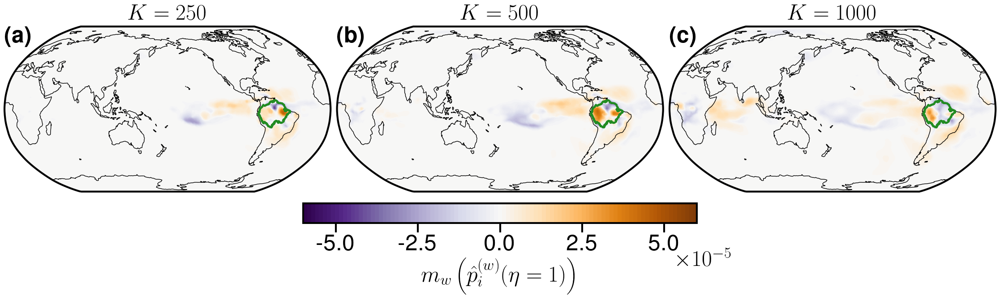

In [ ]:
ks = [250, 500, 1000]
i_max_changes = []
for k in ks:
  i_max_changes.append(np.argmax(np.percentile(walk_probability_trend_dict[k],0.75,axis=0)-np.percentile(walk_probability_trend_dict[k],0.25,axis=0)))

max_value = max([abs(np.min([walk_probability_trend_dict[ks[i]][:,i_max_changes[i]] for i in range(len(ks))])), np.max([walk_probability_trend_dict[ks[i]][:,i_max_changes[i]] for i in range(len(ks))])])
min_value = -abs(max_value)
print(min_value, max_value)

fontsize = 36

plt.rc('text', usetex=True)
plt.rc('xtick',labelsize=fontsize)
plt.rc('ytick',labelsize=fontsize)


# fig, axs = plt.subplots(1,1,sharex=True,figsize=(20,10))
fig = plt.figure(figsize=(10*len(ks),5))

for j in range(len(ks)):
  k = ks[j]

  #   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  ilat, ilon, idat = interpolate_scatter_data(latlon_icos, list(walk_probability_trend_dict[k][:,i_max_changes[j]]),
  #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

  ax = plt.subplot2grid(shape=(1, len(ks)), loc=(0, j), projection=ccrs.Robinson(central_longitude=180))

  ax.coastlines(zorder=5)

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  cmap = mpl.cm.PuOr_r


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)

  im = ax.contourf(ilon, ilat, idat, levels=levels,
                  cmap=cmap, alpha=1,
                  vmin=min_value, vmax=max_value,
                  transform=ccrs.PlateCarree(), zorder=4)
  for c in im.collections:
      c.set_edgecolor("face")
  im.set_clim(min_value, max_value)


  ax.annotate(r'\textbf{('+chr(97+j)+')}', xy=(0, 1), xycoords="axes fraction",
              fontsize=fontsize,usetex=True, va='top', ha='left')

  # ax.set_title(title, fontsize=fontsize)

  plt.setp(ax.spines.values(), linewidth=3, zorder=100)
  ax.tick_params(length=15,width=3)


  ax.set_title(r'$K = {:}$'.format(k), fontsize=fontsize, pad=10)

plt.tight_layout()
plt.subplots_adjust(hspace = 0.2, wspace = -0.5)

cbar = fig.colorbar(im, ax = fig.get_axes(), anchor=(0.5, 0),
                    orientation='horizontal',fraction=0.1, pad=0.06)
# ticks = [-0.015, 0, 0.015]
ticks = [min_value, 0, max_value]
cbar.set_ticks(ticks)
cbar.set_ticklabels(['{:.3f}'.format(ticks[i]) for i in range(len(ticks))],usetex=True)


cbar.set_label(r'$m_w\left(\hat{p}_i^{(w)}('+r'\eta={:}'.format(i_max_changes[0])+r')\right)$',fontsize=fontsize)
cbar.ax.tick_params(length=15,width=3)
cbar.outline.set_linewidth(3)
tick_locator = mpl.ticker.MaxNLocator(nbins=5)
cbar.locator = tick_locator
cbar.update_ticks()
# cbar.ax.plot([threshold_neg]*2, [0,1], 'k', lw=1)
# cbar.ax.plot([threshold_pos]*2, [0,1], 'k', lw=1)
# ticks = cbar.get_ticks()
# cbar.set_ticks(ticks)
# cbar.set_ticklabels(['{:.1f}'.format(tick) for tick in ticks], fontsize=fontsize)
# # yticks = cbar.ax.get_yticks()
# # cbar.ax.set_yticks(yticks)
# # cbar.ax.set_yticklabels(yticks, fontsize=fontsize)

ticks = cbar.get_ticks()[1:-1]
multiplier = int('{:e}'.format(ticks[-1]).split('e')[1])
fmt = MagnitudeFormatter(multiplier)
cbar.ax.xaxis.set_major_formatter(fmt)
# plt.ticklabel_format(style='sci', axis='y')
# print(ax.yaxis.get_major_formatter().__dict__)
cbar.ax.xaxis.offsetText.set_visible(False)

# print(yticks)
cbar.set_ticks(ticks)
cbar.set_ticklabels(['{:.1f}'.format(tick/10**multiplier) for tick in ticks])

if multiplier != 0:
    cbar.ax.annotate(r'$\times 10^{'+str(multiplier)+r'}$', xy=(0.95,-1.3), xycoords='axes fraction', ha='left', va='top', fontsize=fontsize)


cbar.outline.set_linewidth(3)
cbar.ax.tick_params(length=15,width=3)

title = 'Random Walk Trends (Vary k)'
plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)
plt.show()
plt.close(fig)

-0.00010998496161218237 0.00010998496161218237


Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

Replacing Dateline:   0%|          | 0/1200 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/6800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

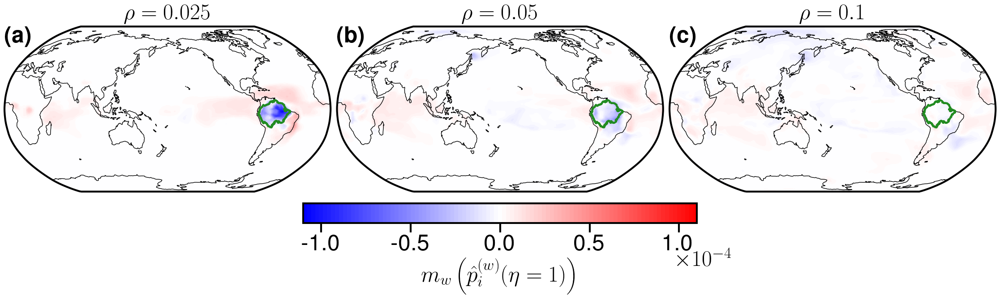

In [ ]:
densities = [0.025, 0.05, 0.1]
i_max_changes = []
for density in densities:
  i_max_changes.append(np.argmax(np.percentile(walk_probability_trend_dict[density],0.75,axis=0)-np.percentile(walk_probability_trend_dict[density],0.25,axis=0)))

max_value = max([abs(np.min([walk_probability_trend_dict[densities[i]][:,i_max_changes[i]] for i in range(len(ks))])), np.max([walk_probability_trend_dict[densities[i]][:,i_max_changes[i]] for i in range(len(densities))])])
min_value = -abs(max_value)
print(min_value, max_value)

fontsize = 36

plt.rc('text', usetex=True)
plt.rc('xtick',labelsize=fontsize)
plt.rc('ytick',labelsize=fontsize)


# fig, axs = plt.subplots(1,1,sharex=True,figsize=(20,10))
fig = plt.figure(figsize=(10*len(densities),5))

for j in range(len(densities)):
  density = densities[j]

  #   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  ilat, ilon, idat = interpolate_scatter_data(latlon_icos, list(walk_probability_trend_dict[density][:,i_max_changes[j]]),
  #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

  ax = plt.subplot2grid(shape=(1, len(densities)), loc=(0, j), projection=ccrs.Robinson(central_longitude=180))

  ax.coastlines(zorder=5)

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  cmap = mpl.cm.bwr


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)

  im = ax.contourf(ilon, ilat, idat, levels=levels,
                  cmap=cmap, alpha=1,
                  vmin=min_value, vmax=max_value,
                  transform=ccrs.PlateCarree(), zorder=4)
  for c in im.collections:
      c.set_edgecolor("face")
  im.set_clim(min_value, max_value)


  ax.annotate(r'\textbf{('+chr(97+j)+')}', xy=(0, 1), xycoords="axes fraction",
              fontsize=fontsize,usetex=True, va='top', ha='left')

  # ax.set_title(title, fontsize=fontsize)

  plt.setp(ax.spines.values(), linewidth=3, zorder=100)
  ax.tick_params(length=15,width=3)


  ax.set_title(r'$\rho = {:}$'.format(density), fontsize=fontsize, pad=10)

plt.tight_layout()
plt.subplots_adjust(hspace = 0.2, wspace = -0.5)

cbar = fig.colorbar(im, ax = fig.get_axes(), anchor=(0.5, 0),
                    orientation='horizontal',fraction=0.1, pad=0.06)
# ticks = [-0.015, 0, 0.015]
ticks = [min_value, 0, max_value]
cbar.set_ticks(ticks)
cbar.set_ticklabels(['{:.3f}'.format(ticks[i]) for i in range(len(ticks))],usetex=True)


cbar.set_label(r'$m_w\left(\hat{p}_i^{(w)}('+r'\eta={:}'.format(i_max_changes[0])+r')\right)$',fontsize=fontsize)
cbar.ax.tick_params(length=15,width=3)
cbar.outline.set_linewidth(3)
tick_locator = mpl.ticker.MaxNLocator(nbins=5)
cbar.locator = tick_locator
cbar.update_ticks()
# cbar.ax.plot([threshold_neg]*2, [0,1], 'k', lw=1)
# cbar.ax.plot([threshold_pos]*2, [0,1], 'k', lw=1)
# ticks = cbar.get_ticks()
# cbar.set_ticks(ticks)
# cbar.set_ticklabels(['{:.1f}'.format(tick) for tick in ticks], fontsize=fontsize)
# # yticks = cbar.ax.get_yticks()
# # cbar.ax.set_yticks(yticks)
# # cbar.ax.set_yticklabels(yticks, fontsize=fontsize)

ticks = cbar.get_ticks()[1:-1]
multiplier = int('{:e}'.format(ticks[-1]).split('e')[1])
fmt = MagnitudeFormatter(multiplier)
cbar.ax.xaxis.set_major_formatter(fmt)
# plt.ticklabel_format(style='sci', axis='y')
# print(ax.yaxis.get_major_formatter().__dict__)
cbar.ax.xaxis.offsetText.set_visible(False)

# print(yticks)
cbar.set_ticks(ticks)
cbar.set_ticklabels(['{:.1f}'.format(tick/10**multiplier) for tick in ticks])

if multiplier != 0:
    cbar.ax.annotate(r'$\times 10^{'+str(multiplier)+r'}$', xy=(0.95,-1.3), xycoords='axes fraction', ha='left', va='top', fontsize=fontsize)


cbar.outline.set_linewidth(3)
cbar.ax.tick_params(length=15,width=3)

title = 'Random Walk Trends (Vary density)'
plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)
plt.show()
plt.close(fig)

In [ ]:
densities = [0.005, 0.01, 0.025, 0.05, 0.1]
max_walk_length = len(average_walk_probability_dict[50][dates[0]])

xlim_max = 50

class MagnitudeFormatter(mpl.ticker.ScalarFormatter):
    def __init__(self, exponent=None):
        super().__init__()
        self._fixed_exponent = exponent

    def _set_order_of_magnitude(self):
        if self._fixed_exponent:
            self.orderOfMagnitude = self._fixed_exponent
        else:
            super()._set_order_of_magnitude()

for density in densities:
  threshold = 0.975
  crossing = 0
  for date in dates:
    crossing = max(crossing, np.argmax(num_nodes*average_walk_probability_dict[density][date]>threshold), np.argmax(num_nodes_affected_dict[density][date]>threshold))
  xlim_max = crossing


  dir_end = dir_end = '-months={:},offset={:},density={:}/'.format(months,offset,density)

  i_max_change = np.argmax(np.quantile(walk_probability_trend_dict[density],0.75,axis=0)-np.quantile(walk_probability_trend_dict[density],0.25,axis=0)) # max interquartile range

  i_ind = i_max_change

  xlim_max = max(xlim_max,1.1*i_ind)


  ilat, ilon, idat = interpolate_scatter_data(latlon_icos, list(walk_probability_trend_dict[density][:,i_ind]),
#                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
                    method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)


  fontsize = 36

  plt.rc('text', usetex=True)
  plt.rc('xtick',labelsize=fontsize)
  plt.rc('ytick',labelsize=fontsize)

  lw = 3

  fig, axs = plt.subplots(2,3,sharex=True,figsize=(40,10),gridspec_kw={'width_ratios':[1,0.05,1]})
  ax1 = plt.subplot2grid(shape=(2, 3), loc=(0, 0))
  ax2 = plt.subplot2grid(shape=(2, 3), loc=(1, 0), sharex=ax1)
  cax1 = plt.subplot2grid(shape=(2,3), loc=(0, 1), rowspan=2)
  ax3 = plt.subplot2grid(shape=(2, 3), loc=(0, 2), rowspan=1, projection=ccrs.Robinson(central_longitude=180))
  cax2 = plt.subplot2grid(shape=(2,3), loc=(1, 2))

  n = len(dates)
  c = np.arange(1,n+1)
  norm = mpl.colors.Normalize(vmin=c.min(), vmax=c.max())
  cmap = mpl.cm.ScalarMappable(norm=norm, cmap='cividis')
  cmap.set_array([])
  for i in range(len(dates)):
      date = dates[i]
      ax1.plot(np.arange(max_walk_length),num_nodes*average_walk_probability_dict[density][date],c=cmap.to_rgba(i+1),alpha=1,lw=lw,zorder=5)

  plt.setp(ax1.get_xticklabels(), visible=False)

  # ax12.set_xlabel('$\eta$',fontsize=fontsize)
  ax1.set_ylabel(r'$\langle \hat{p}_{i\notin U}(\eta) \rangle$',fontsize=fontsize, labelpad=12)

  ax1.set_xlim([0, xlim_max])
  ax1.set_ylim([0, 1])
  # ax1.set_yticks([0.015, 0.016, 0.017, 0.018])

  xticks = ax1.get_xticks()
  ax1.set_xticks(xticks)
  ax1.set_xticklabels(xticks, fontsize=fontsize)
  yticks = ax1.get_yticks()
  ax1.set_yticks(yticks)
  ax1.set_yticklabels(yticks, fontsize=fontsize)

  ax1.plot([i_max_change, i_max_change], ax1.get_ylim(), '--', c='gray', lw=lw, zorder=4)

  spacing = 0.025
  ax1.annotate(r'\textbf{(a)}', xy=(spacing/4, 1-spacing), xycoords="axes fraction",
              fontsize=fontsize,usetex=True, va='top', ha='left', zorder=100)

  ax1.tick_params(length=15,width=3)
  plt.setp(ax1.spines.values(), linewidth=3, zorder=10)

  ### AXIS 2, NUMBER OF AFFECTED NODES
  ax2.tick_params(bottom=True, top=True, left=True, right=False)
  for i in range(len(dates)):
      date = dates[i]
      ax2.plot(np.arange(max_walk_length),num_nodes_affected_dict[density][date],c=cmap.to_rgba(i+1),alpha=1,lw=lw,zorder=5)


  ax2.set_xlabel('$\eta$',fontsize=fontsize)
  # ax2.set_ylabel(r'$N_{NA}^{(\walk_probability \geq \langle \walk_probability \rangle_{NA})}/N_{NA}$',fontsize=fontsize,
  #                labelpad=10)
  # ax2.set_ylabel(r'$\sfrac{N_{NA}^{(\walk_probability \geq \langle \walk_probability \rangle_{NA})}}{N_{NA}}$',fontsize=fontsize+10,
  #                labelpad=10)
  ax2.set_ylabel(r'$\sfrac{|\hat{p}_{i\notin U}(\eta) \geq \sfrac{|U|}{N}|}{|U^{\mathsf{c}}|}$',fontsize=fontsize+10,
                labelpad=10)

  ax2.set_xlim([0, xlim_max])
  ax2.set_ylim([0,1])
  # ax2.set_yticks([0.2,0.4,0.6])
  ax2.xaxis.set_major_locator(mpl.ticker.MaxNLocator(5,integer=True))

  xticks = ax2.get_xticks()
  ax2.set_xticks(xticks)
  ax2.set_xticklabels(['{:.0f}'.format(xtick) for xtick in xticks], fontsize=fontsize)
  yticks = ax2.get_yticks()
  ax2.set_yticks(yticks)
  ax2.set_yticklabels(yticks, fontsize=fontsize)


  ax2.plot([i_max_change, i_max_change], ax2.get_ylim(), '--', c='gray', lw=lw, zorder=4)
  if abs(xlim_max - 1.1*i_ind) < 1e-2:
    ax1.annotate(r'$\eta = {:}$'.format(i_max_change), color='k', xy=(i_max_change-0.01*xlim_max, .05), xycoords='data',
    #              bbox=dict(facecolor='r',boxstyle='round',alpha=0.25),
                fontsize=fontsize,usetex=True, va='bottom', ha='right',zorder=6)
  else:
    ax1.annotate(r'$\eta = {:}$'.format(i_max_change), color='k', xy=(i_max_change+0.01*xlim_max, .05), xycoords='data',
    #              bbox=dict(facecolor='r',boxstyle='round',alpha=0.25),
                fontsize=fontsize,usetex=True, va='bottom', ha='left',zorder=6)

  # pos_ax1 = ax1.get_position()
  # pos_ax2 = ax2.get_position()
  # points_ax1 = pos_ax1.get_points()
  # points_ax2 = pos_ax2.get_points()

  # spacing = 0.005
  # # width = points_ax1[1][0] - points_ax1[0][0]
  # width = 0.4
  # points_ax1[0][0] = 0
  # points_ax1[1][0] = width
  # points_ax2[0][0] = 0
  # points_ax2[1][0] = width

  # pos_ax1.set_points(points_ax1)
  # pos_ax2.set_points(points_ax2)
  # ax1.set_position(pos_ax1)
  # ax2.set_position(pos_ax2)


  # pos_ax1 = ax1.get_position()
  # pos_cax1 = cax1.get_position()

  # points_ax1 = pos_ax1.get_points()
  # points_cax1 = pos_cax1.get_points()

  # spacing = 0.005
  # # width = points_cax1[1][0] - points_cax1[0][0]
  # width = 0.025
  # points_cax1[0][0] = points_ax1[1][0] + spacing
  # points_cax1[1][0] = points_cax1[0][0] + width

  # pos_cax1.set_points(points_cax1)

  # cax1.set_position(pos_cax1)

  spacing = 0.025
  ax2.annotate(r'\textbf{(b)}', xy=(spacing/4, 1-spacing), xycoords="axes fraction",
              fontsize=fontsize,usetex=True, va='top', ha='left', zorder=100)

  ax2.tick_params(length=15,width=3)
  plt.setp(ax2.spines.values(), linewidth=3, zorder=10)



  num_ticks = 5
  ticks = np.linspace(0,len(dates)-1,num_ticks).astype(int)

  # cax1 = fig.add_ax1es([0.68, 0.21, 0.01, 0.755])
  cbar1 = fig.colorbar(cmap, ticks=ticks,
                      cax=cax1, orientation='vertical', pad=-1, aspect=15, boundaries=np.arange(-.5,len(c),1))
  # cbar1.set_label(r'',fontsize=fontsize,rotation='vertical',labelpad=20)
  cbar1.ax.set_yticklabels([dates[tick] for tick in ticks])
  cbar1.ax.tick_params(length=15,width=3)
  cbar1.outline.set_linewidth(3)

  pos_ax1 = ax1.get_position()
  pos_ax2 = ax2.get_position()
  points_ax1 = pos_ax1.get_points()
  points_ax2 = pos_ax2.get_points()

  spacing = 0.005
  # width = points_ax1[1][0] - points_ax1[0][0]
  width = 0.4
  points_ax1[0][0] = 0
  points_ax1[1][0] = width
  points_ax2[0][0] = 0
  points_ax2[1][0] = width

  pos_ax1.set_points(points_ax1)
  pos_ax2.set_points(points_ax2)
  ax1.set_position(pos_ax1)
  ax2.set_position(pos_ax2)


  pos_ax1 = ax1.get_position()
  pos_cax1 = cax1.get_position()

  points_ax1 = pos_ax1.get_points()
  points_cax1 = pos_cax1.get_points()

  spacing = 0.005
  # width = points_cax1[1][0] - points_cax1[0][0]
  width = 0.025
  points_cax1[0][0] = points_ax1[1][0] + spacing
  points_cax1[1][0] = points_cax1[0][0] + width

  pos_cax1.set_points(points_cax1)

  cax1.set_position(pos_cax1)








  ax3.coastlines(zorder=5)


  # min_value = np.nanmin(idat)
  # max_value = np.nanmax(idat)
  # min_value = min(np.delete(dist_trend,amazon_nodes_corrected))
  # max_value = max(np.delete(dist_trend,amazon_nodes_corrected))
  # min_value = -.02#min(R_i_trend)
  # max_value = .02#max(R_i_trend)

  # idat1 = idat
  # idat1[np.where(idat < min_value)] = min_value

  # max_value = max(abs(np.min(walk_probability_trend_dict[density][:,i_ind])),np.max(walk_probability_trend_dict[density][:,i_ind]))
  # min_value = -max_value

  # min_value = np.min(walk_probability_trend_dict[density][:,i_ind])
  # max_value = np.max(walk_probability_trend_dict[density][:,i_ind])
  min_value = np.quantile(walk_probability_trend_dict[density][:,i_ind], 0.005)
  max_value = np.quantile(walk_probability_trend_dict[density][:,i_ind], 0.995)

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  # midpoint = -min_value/(max_value-min_value)
  cmap = mpl.cm.bwr
  cmap = shiftedColorMap(cmap, start=0, midpoint=-min_value/(max_value-min_value), stop=1.0, name='shiftedcmap')
  # shifted_cmap = shiftedColorMap(cmap, midpoint=midpoint)


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax3.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)

  plt.setp(ax3.spines.values(), linewidth=3, zorder=10)


  # im = ax3.scatter(latlon_icos[:,1], latlon_icos[:,0],
  #                   c=walk_probability_trend_dict[density][:,i_ind],
  #                   cmap='bwr', transform=ccrs.PlateCarree(), marker='o', s=20,
  #                   edgecolors=None)
  im = ax3.contourf(ilon, ilat, idat, levels=levels,
                  cmap=cmap, alpha=1, extend='both',
                  vmin=min_value, vmax=max_value,
                  transform=ccrs.PlateCarree(), zorder=4)
  for c in im.collections:
    c.set_edgecolor("face")
  im.set_clim(min_value, max_value)
  cbar2=plt.colorbar(im, cax=cax2, orientation='horizontal',fraction=0.08, pad=0.02)
  # ticks = np.array([-5,-4,-3,-2,-1,0,1,2])
  # cbar2.set_ticks(ticks*1e-5)
  # cbar2.set_ticklabels(ticks)

  # cbar2=plt.colorbar(im, ax=ax3, ticks=ticks[1::3], fraction=0.048, orientation='horizontal',
  #                   pad=0.02, boundaries=levels)
  # cbar2.set_ticklabels(['{:.4f}'.format(tick) for tick in ticks[1::3]])

  # cbar2.set_label('Slope of Trendline of Average Diffusion Distance to Amazon\n$t = $ '+
  #                '{:.4f}'.format(round(i_max_change, 4)),fontsize=fontsize)
  cbar2.set_label(r'$m_w\left(\hat{p}_i^{(w)}('+r'\eta={:}'.format(i_max_change)+r')\right)$',fontsize=fontsize)
  cbar2.ax.tick_params(length=15,width=3)
  cbar2.outline.set_linewidth(3)
  tick_locator = mpl.ticker.MaxNLocator(nbins=5)
  cbar2.locator = tick_locator
  cbar2.update_ticks()
  # cbar2.ax.plot([threshold_neg]*2, [0,1], 'k', lw=1)
  # cbar2.ax.plot([threshold_pos]*2, [0,1], 'k', lw=1)
  # ticks = cbar2.get_ticks()
  # cbar2.set_ticks(ticks)
  # cbar2.set_ticklabels(['{:.1f}'.format(tick) for tick in ticks], fontsize=fontsize)
  # # yticks = cbar2.ax.get_yticks()
  # # cbar2.ax.set_yticks(yticks)
  # # cbar2.ax.set_yticklabels(yticks, fontsize=fontsize)

  ticks = cbar2.get_ticks()[1:-1]
  if ticks[0] == 0:
    ticks = np.hstack((ticks[1]*-1,ticks))

    levels = np.linspace(ticks[0], max_value, 100)

    cmap = mpl.cm.bwr
    cmap = shiftedColorMap(cmap, start=0, midpoint=-levels[0]/(levels[-1]-levels[0]), stop=1.0, name='shiftedcmap')

    im = ax3.contourf(ilon, ilat, idat, levels=levels,
                      cmap=cmap, alpha=1, extend='both',
                      vmin=ticks[0], vmax=max_value,
                      transform=ccrs.PlateCarree(), zorder=4)
    for c in im.collections:
      c.set_edgecolor("face")
    im.set_clim(ticks[0], max_value)

    cbar2=plt.colorbar(im, cax=cax2, orientation='horizontal',fraction=0.08, pad=0.02)
    cbar2.set_label(r'$m_w\left(\hat{p}_i^{(w)}('+r'\eta={:}'.format(i_max_change)+r')\right)$',fontsize=fontsize)
    cbar2.ax.tick_params(length=15,width=3)
    cbar2.outline.set_linewidth(3)
    tick_locator = mpl.ticker.MaxNLocator(nbins=5)
    cbar2.locator = tick_locator
    cbar2.update_ticks()


  elif ticks[-1] == 0:
    ticks = np.hstack((ticks,ticks[-2]*-1))

    levels = np.linspace(min_value, ticks[-1], 100)

    cmap = mpl.cm.bwr
    cmap = shiftedColorMap(cmap, start=0, midpoint=-levels[0]/(levels[-1]-levels[0]), stop=1.0, name='shiftedcmap')

    im = ax3.contourf(ilon, ilat, idat, levels=levels,
                      cmap=cmap, alpha=1, extend='both',
                      vmin=min_value, vmax=ticks[-1],
                      transform=ccrs.PlateCarree(), zorder=4)
    for c in im.collections:
      c.set_edgecolor("face")
    im.set_clim(min_value, ticks[-1])

    cbar2=plt.colorbar(im, cax=cax2, orientation='horizontal',fraction=0.08, pad=0.02)
    cbar2.set_label(r'$m_w\left(\hat{p}_i^{(w)}('+r'\eta={:}'.format(i_max_change)+r')\right)$',fontsize=fontsize)
    cbar2.ax.tick_params(length=15,width=3)
    cbar2.outline.set_linewidth(3)
    tick_locator = mpl.ticker.MaxNLocator(nbins=5)
    cbar2.locator = tick_locator
    cbar2.update_ticks()



  cbar2.set_ticks(ticks)
  multiplier = int('{:e}'.format(ticks[-1]).split('e')[1])
  fmt = MagnitudeFormatter(multiplier)
  cbar2.ax.xaxis.set_major_formatter(fmt)
  # plt.ticklabel_format(style='sci', axis='y')
  # print(ax.yaxis.get_major_formatter().__dict__)
  cbar2.ax.xaxis.offsetText.set_visible(False)

  # print(yticks)
  cbar2.set_ticks(ticks)
  cbar2.set_ticklabels(['{:.1f}'.format(tick/10**multiplier) for tick in ticks])

  if multiplier != 0:
      cax2.annotate(r'$\times 10^{'+str(multiplier)+r'}$', xy=(0.95,-1), xycoords='axes fraction', ha='left', va='top', fontsize=fontsize)



  plt.setp(ax3.spines.values(), linewidth=2)

  pos_ax3 = ax3.get_position()
  pos_cax1 = cax1.get_position()

  points_ax3 = pos_ax3.get_points()
  points_cax1 = pos_cax1.get_points()

  spacing = 0.075
  width = points_ax3[1][0] - points_ax3[0][0] + 0.15
  # width = 0.025
  points_ax3[0][0] = points_cax1[1][0] + spacing
  points_ax3[1][0] = points_ax3[0][0] + width
  points_ax3[0][1] = 0.2
  points_ax3[1][1] = .9

  pos_ax3.set_points(points_ax3)

  ax3.set_position(pos_ax3)


  pos_cax2 = cax2.get_position()

  points_cax2 = pos_cax2.get_points()

  spacing = 0.075
  scale = 0.05
  # width = points_ax3[1][0] - points_ax3[0][0] + 0.075
  # width = 0.025
  points_cax2[0][0] = points_cax1[1][0] + spacing + scale*width
  points_cax2[1][0] = points_ax3[0][0] + (1-scale)*width
  points_cax2[0][1] = 0.145
  points_cax2[1][1] = 0.21

  pos_cax2.set_points(points_cax2)

  cax2.set_position(pos_cax2)

  ax3.annotate(r'\textbf{(c)}', xy=(.0,.995), xycoords="axes fraction",
              fontsize=fontsize,usetex=True, va='top', ha='left', zorder=100)


  # plt.tight_layout()
  # plt.subplots_adjust(hspace=0.2)
  # fig.align_labels([ax1,ax2])




  # # plt.tight_layout()
  # plt.subplots_adjust(hspace=0)
  # # fig.align_labels([ax1,ax2])

  title = 'eta={:}'.format(i_max_change) + dir_end[:-1]
  plt.savefig(fig_walk_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
  plt.savefig(fig_walk_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)

  plt.show()

Output hidden; open in https://colab.research.google.com to view.

In [18]:
densities = [0.005, 0.01, 0.025, 0.05, 0.1]
max_walk_length = len(average_walk_probability_dict[50][dates[0]])

xlim_max = 50

class MagnitudeFormatter(mpl.ticker.ScalarFormatter):
    def __init__(self, exponent=None):
        super().__init__()
        self._fixed_exponent = exponent

    def _set_order_of_magnitude(self):
        if self._fixed_exponent:
            self.orderOfMagnitude = self._fixed_exponent
        else:
            super()._set_order_of_magnitude()

for density in densities:
  threshold = 0.975
  crossing = 0
  for date in dates:
    crossing = max(crossing, np.argmax(num_nodes*average_walk_probability_dict[density][date]>threshold), np.argmax(num_nodes_affected_dict[density][date]>threshold))
  xlim_max = crossing


  dir_end = dir_end = '-months={:},offset={:},density={:}/'.format(months,offset,density)

  i_max_change = np.argmax(np.quantile(walk_probability_trend_dict[density],0.75,axis=0)-np.quantile(walk_probability_trend_dict[density],0.25,axis=0)) # max interquartile range

  i_ind = i_max_change

  xlim_max = max(xlim_max,1.1*i_ind)


  ilat, ilon, idat = interpolate_scatter_data(latlon_icos, list(walk_probability_trend_dict[density][:,i_ind]),
#                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
                    method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)


  fontsize = 36

  plt.rc('text', usetex=True)
  plt.rc('xtick',labelsize=fontsize)
  plt.rc('ytick',labelsize=fontsize)

  lw = 3

  fig, axs = plt.subplots(2,3,sharex=True,figsize=(40,10),gridspec_kw={'width_ratios':[1,0.05,1]})
  ax1 = plt.subplot2grid(shape=(2, 3), loc=(0, 0))
  ax2 = plt.subplot2grid(shape=(2, 3), loc=(1, 0), sharex=ax1)
  cax1 = plt.subplot2grid(shape=(2,3), loc=(0, 1), rowspan=2)
  ax3 = plt.subplot2grid(shape=(2, 3), loc=(0, 2), rowspan=1, projection=ccrs.Robinson(central_longitude=180))
  cax2 = plt.subplot2grid(shape=(2,3), loc=(1, 2))

  n = len(dates)
  c = np.arange(1,n+1)
  norm = mpl.colors.Normalize(vmin=c.min(), vmax=c.max())
  cmap = mpl.cm.ScalarMappable(norm=norm, cmap='cividis')
  cmap.set_array([])
  for i in range(len(dates)):
      date = dates[i]
      ax1.plot(np.arange(max_walk_length),num_nodes*average_walk_probability_dict[density][date],c=cmap.to_rgba(i+1),alpha=1,lw=lw,zorder=-20)
  ax1.set_rasterization_zorder(-10)

  plt.setp(ax1.get_xticklabels(), visible=False)

  # ax12.set_xlabel('$\eta$',fontsize=fontsize)
  ax1.set_ylabel(r'$\langle \hat{p}_{i\notin U}(\eta) \rangle$',fontsize=fontsize, labelpad=12)

  ax1.set_xlim([0, xlim_max])
  ax1.set_ylim([0, 1])
  # ax1.set_yticks([0.015, 0.016, 0.017, 0.018])

  xticks = ax1.get_xticks()
  ax1.set_xticks(xticks)
  ax1.set_xticklabels(xticks, fontsize=fontsize)
  yticks = ax1.get_yticks()
  ax1.set_yticks(yticks)
  ax1.set_yticklabels(yticks, fontsize=fontsize)

  ax1.plot([i_max_change, i_max_change], ax1.get_ylim(), '--', c='gray', lw=lw, zorder=4)

  spacing = 0.025
  ax1.annotate(r'\textbf{(a)}', xy=(spacing/4, 1-spacing), xycoords="axes fraction",
              fontsize=fontsize,usetex=True, va='top', ha='left', zorder=100)

  ax1.tick_params(length=15,width=3)
  plt.setp(ax1.spines.values(), linewidth=3, zorder=10)

  ### AXIS 2, NUMBER OF AFFECTED NODES
  ax2.tick_params(bottom=True, top=True, left=True, right=False)
  for i in range(len(dates)):
      date = dates[i]
      ax2.plot(np.arange(max_walk_length),num_nodes_affected_dict[density][date],c=cmap.to_rgba(i+1),alpha=1,lw=lw,zorder=-20)
  ax2.set_rasterization_zorder(-10)

  ax2.set_xlabel('$\eta$',fontsize=fontsize)
  # ax2.set_ylabel(r'$N_{NA}^{(\walk_probability \geq \langle \walk_probability \rangle_{NA})}/N_{NA}$',fontsize=fontsize,
  #                labelpad=10)
  # ax2.set_ylabel(r'$\sfrac{N_{NA}^{(\walk_probability \geq \langle \walk_probability \rangle_{NA})}}{N_{NA}}$',fontsize=fontsize+10,
  #                labelpad=10)
  ax2.set_ylabel(r'$\sfrac{|\hat{p}_{i\notin U}(\eta) \geq \sfrac{|U|}{N}|}{|U^{\mathsf{c}}|}$',fontsize=fontsize+10,
                labelpad=10)

  ax2.set_xlim([0, xlim_max])
  ax2.set_ylim([0,1])
  # ax2.set_yticks([0.2,0.4,0.6])
  ax2.xaxis.set_major_locator(mpl.ticker.MaxNLocator(5,integer=True))

  # xticks = ax2.get_xticks()
  # ax2.set_xticks(xticks)
  # ax2.set_xticklabels(['{:.0f}'.format(xtick) for xtick in xticks], fontsize=fontsize)
  # yticks = ax2.get_yticks()
  # ax2.set_yticks(yticks)
  # ax2.set_yticklabels(yticks, fontsize=fontsize)


  ax2.plot([i_max_change, i_max_change], ax2.get_ylim(), '--', c='gray', lw=lw, zorder=4)
  if abs(xlim_max - 1.1*i_ind) < 1e-2:
    ax1.annotate(r'$\eta = {:}$'.format(i_max_change), color='k', xy=(i_max_change-0.01*xlim_max, .05), xycoords='data',
    #              bbox=dict(facecolor='r',boxstyle='round',alpha=0.25),
                fontsize=fontsize,usetex=True, va='bottom', ha='right',zorder=6)
  else:
    ax1.annotate(r'$\eta = {:}$'.format(i_max_change), color='k', xy=(i_max_change+0.01*xlim_max, .05), xycoords='data',
    #              bbox=dict(facecolor='r',boxstyle='round',alpha=0.25),
                fontsize=fontsize,usetex=True, va='bottom', ha='left',zorder=6)

  ax2.set_xlim([0, xlim_max])
  ax1.set_xlim([0, xlim_max])
  xticks = ax2.get_xticks()
  ax2.set_xticks(xticks)
  ax2.set_xticklabels(['{:.0f}'.format(xtick) for xtick in xticks], fontsize=fontsize)
  xticks = ax1.get_xticks()
  ax1.set_xticks(xticks)
  ax1.set_xticklabels(['{:.0f}'.format(xtick) for xtick in xticks], fontsize=fontsize)
  yticks = ax2.get_yticks()
  ax2.set_yticks(yticks)
  ax2.set_yticklabels(yticks, fontsize=fontsize)

  # pos_ax1 = ax1.get_position()
  # pos_ax2 = ax2.get_position()
  # points_ax1 = pos_ax1.get_points()
  # points_ax2 = pos_ax2.get_points()

  # spacing = 0.005
  # # width = points_ax1[1][0] - points_ax1[0][0]
  # width = 0.4
  # points_ax1[0][0] = 0
  # points_ax1[1][0] = width
  # points_ax2[0][0] = 0
  # points_ax2[1][0] = width

  # pos_ax1.set_points(points_ax1)
  # pos_ax2.set_points(points_ax2)
  # ax1.set_position(pos_ax1)
  # ax2.set_position(pos_ax2)


  # pos_ax1 = ax1.get_position()
  # pos_cax1 = cax1.get_position()

  # points_ax1 = pos_ax1.get_points()
  # points_cax1 = pos_cax1.get_points()

  # spacing = 0.005
  # # width = points_cax1[1][0] - points_cax1[0][0]
  # width = 0.025
  # points_cax1[0][0] = points_ax1[1][0] + spacing
  # points_cax1[1][0] = points_cax1[0][0] + width

  # pos_cax1.set_points(points_cax1)

  # cax1.set_position(pos_cax1)

  spacing = 0.025
  ax2.annotate(r'\textbf{(b)}', xy=(spacing/4, 1-spacing), xycoords="axes fraction",
              fontsize=fontsize,usetex=True, va='top', ha='left', zorder=100)

  ax2.tick_params(length=15,width=3)
  plt.setp(ax2.spines.values(), linewidth=3, zorder=10)



  num_ticks = 5
  ticks = np.linspace(0,len(dates)-1,num_ticks).astype(int)

  # cax1 = fig.add_ax1es([0.68, 0.21, 0.01, 0.755])
  cbar1 = fig.colorbar(cmap, ticks=ticks,
                      cax=cax1, orientation='vertical', pad=-1, aspect=15, boundaries=np.arange(-.5,len(c),1))
  # cbar1.set_label(r'',fontsize=fontsize,rotation='vertical',labelpad=20)
  cbar1.ax.set_yticklabels([dates[tick] for tick in ticks])
  cbar1.ax.tick_params(length=15,width=3)
  cbar1.outline.set_linewidth(3)

  pos_ax1 = ax1.get_position()
  pos_ax2 = ax2.get_position()
  points_ax1 = pos_ax1.get_points()
  points_ax2 = pos_ax2.get_points()

  spacing = 0.005
  # width = points_ax1[1][0] - points_ax1[0][0]
  width = 0.4
  points_ax1[0][0] = 0
  points_ax1[1][0] = width
  points_ax2[0][0] = 0
  points_ax2[1][0] = width

  pos_ax1.set_points(points_ax1)
  pos_ax2.set_points(points_ax2)
  ax1.set_position(pos_ax1)
  ax2.set_position(pos_ax2)


  pos_ax1 = ax1.get_position()
  pos_cax1 = cax1.get_position()

  points_ax1 = pos_ax1.get_points()
  points_cax1 = pos_cax1.get_points()

  spacing = 0.005
  # width = points_cax1[1][0] - points_cax1[0][0]
  width = 0.025
  points_cax1[0][0] = points_ax1[1][0] + spacing
  points_cax1[1][0] = points_cax1[0][0] + width

  pos_cax1.set_points(points_cax1)

  cax1.set_position(pos_cax1)








  ax3.coastlines(zorder=5)


  # min_value = np.nanmin(idat)
  # max_value = np.nanmax(idat)
  # min_value = min(np.delete(dist_trend,amazon_nodes_corrected))
  # max_value = max(np.delete(dist_trend,amazon_nodes_corrected))
  # min_value = -.02#min(R_i_trend)
  # max_value = .02#max(R_i_trend)

  # idat1 = idat
  # idat1[np.where(idat < min_value)] = min_value

  # max_value = max(abs(np.min(walk_probability_trend_dict[density][:,i_ind])),np.max(walk_probability_trend_dict[density][:,i_ind]))
  # min_value = -max_value

  # min_value = np.min(walk_probability_trend_dict[density][:,i_ind])
  # max_value = np.max(walk_probability_trend_dict[density][:,i_ind])
  min_value = np.quantile(walk_probability_trend_dict[density][:,i_ind], 0.005)
  max_value = np.quantile(walk_probability_trend_dict[density][:,i_ind], 0.995)

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  # midpoint = -min_value/(max_value-min_value)
  cmap = mpl.cm.bwr
  cmap = shiftedColorMap(cmap, start=0, midpoint=-min_value/(max_value-min_value), stop=1.0, name='shiftedcmap')
  # shifted_cmap = shiftedColorMap(cmap, midpoint=midpoint)


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax3.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)

  plt.setp(ax3.spines.values(), linewidth=3, zorder=10)


  # im = ax3.scatter(latlon_icos[:,1], latlon_icos[:,0],
  #                   c=walk_probability_trend_dict[density][:,i_ind],
  #                   cmap='bwr', transform=ccrs.PlateCarree(), marker='o', s=20,
  #                   edgecolors=None)
  im = ax3.contourf(ilon, ilat, idat, levels=levels,
                  cmap=cmap, alpha=1, extend='both',
                  vmin=min_value, vmax=max_value,
                  transform=ccrs.PlateCarree(), zorder=-20)
  for c in im.collections:
    c.set_edgecolor("face")
  im.set_clim(min_value, max_value)
  ax3.set_rasterization_zorder(-10)

  cbar2=plt.colorbar(im, cax=cax2, orientation='horizontal',fraction=0.08, pad=0.02)
  # ticks = np.array([-5,-4,-3,-2,-1,0,1,2])
  # cbar2.set_ticks(ticks*1e-5)
  # cbar2.set_ticklabels(ticks)

  # cbar2=plt.colorbar(im, ax=ax3, ticks=ticks[1::3], fraction=0.048, orientation='horizontal',
  #                   pad=0.02, boundaries=levels)
  # cbar2.set_ticklabels(['{:.4f}'.format(tick) for tick in ticks[1::3]])

  # cbar2.set_label('Slope of Trendline of Average Diffusion Distance to Amazon\n$t = $ '+
  #                '{:.4f}'.format(round(i_max_change, 4)),fontsize=fontsize)
  cbar2.set_label(r'$m_w\left(\hat{p}_i^{(w)}('+r'\eta={:}'.format(i_max_change)+r')\right)$',fontsize=fontsize)
  cbar2.ax.tick_params(length=15,width=3)
  cbar2.outline.set_linewidth(3)
  tick_locator = mpl.ticker.MaxNLocator(nbins=5)
  cbar2.locator = tick_locator
  cbar2.update_ticks()
  # cbar2.ax.plot([threshold_neg]*2, [0,1], 'k', lw=1)
  # cbar2.ax.plot([threshold_pos]*2, [0,1], 'k', lw=1)
  # ticks = cbar2.get_ticks()
  # cbar2.set_ticks(ticks)
  # cbar2.set_ticklabels(['{:.1f}'.format(tick) for tick in ticks], fontsize=fontsize)
  # # yticks = cbar2.ax.get_yticks()
  # # cbar2.ax.set_yticks(yticks)
  # # cbar2.ax.set_yticklabels(yticks, fontsize=fontsize)

  # ticks = cbar2.get_ticks()[1:-1]
  ticks = cbar2.get_ticks()
  if ticks[0] == 0:
    cbar2.remove()
    for c in im.collections:
      c.remove()
    ax3 = plt.subplot2grid(shape=(2, 3), loc=(0, 2), rowspan=1, projection=ccrs.Robinson(central_longitude=180))
    cax2 = plt.subplot2grid(shape=(2,3), loc=(1, 2))

    ticks = np.hstack((ticks[1]*-1,ticks))

    levels = np.linspace(ticks[0], max_value, 100)

    cmap = mpl.cm.bwr
    cmap = shiftedColorMap(cmap, start=0, midpoint=-levels[0]/(levels[-1]-levels[0]), stop=1.0, name='shiftedcmap')

    ax3.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)
    ax3.coastlines(zorder=5)
    plt.setp(ax3.spines.values(), linewidth=3, zorder=10)

    im = ax3.contourf(ilon, ilat, idat, levels=levels,
                      cmap=cmap, alpha=1, extend='both',
                      vmin=ticks[0], vmax=max_value,
                      transform=ccrs.PlateCarree(), zorder=-20)
    for c in im.collections:
      c.set_edgecolor("face")
    im.set_clim(ticks[0], max_value)
    ax3.set_rasterization_zorder(-10)

    cbar2=plt.colorbar(im, cax=cax2, orientation='horizontal',fraction=0.08, pad=0.02)
    cbar2.set_label(r'$m_w\left(\hat{p}_i^{(w)}('+r'\eta={:}'.format(i_max_change)+r')\right)$',fontsize=fontsize)
    cbar2.ax.tick_params(length=15,width=3)
    cbar2.outline.set_linewidth(3)
    tick_locator = mpl.ticker.MaxNLocator(nbins=5)
    cbar2.locator = tick_locator
    cbar2.update_ticks()


  elif ticks[-1] == 0:
    cbar2.remove()
    for c in im.collections:
      c.remove()
    ax3 = plt.subplot2grid(shape=(2, 3), loc=(0, 2), rowspan=1, projection=ccrs.Robinson(central_longitude=180))
    cax2 = plt.subplot2grid(shape=(2,3), loc=(1, 2))


    ticks = np.hstack((ticks,ticks[-2]*-1))

    levels = np.linspace(min_value, ticks[-1], 100)

    cmap = mpl.cm.bwr
    cmap = shiftedColorMap(cmap, start=0, midpoint=-levels[0]/(levels[-1]-levels[0]), stop=1.0, name='shiftedcmap')

    ax3.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)
    ax3.coastlines(zorder=5)
    plt.setp(ax3.spines.values(), linewidth=3, zorder=10)

    im = ax3.contourf(ilon, ilat, idat, levels=levels,
                      cmap=cmap, alpha=1, extend='both',
                      vmin=min_value, vmax=ticks[-1],
                      transform=ccrs.PlateCarree(), zorder=-20)
    for c in im.collections:
      c.set_edgecolor("face")
    im.set_clim(min_value, ticks[-1])
    ax3.set_rasterization_zorder(-10)

    cbar2=plt.colorbar(im, cax=cax2, orientation='horizontal',fraction=0.08, pad=0.02)
    cbar2.set_label(r'$m_w\left(\hat{p}_i^{(w)}('+r'\eta={:}'.format(i_max_change)+r')\right)$',fontsize=fontsize)
    cbar2.ax.tick_params(length=15,width=3)
    cbar2.outline.set_linewidth(3)
    tick_locator = mpl.ticker.MaxNLocator(nbins=5)
    cbar2.locator = tick_locator
    cbar2.update_ticks()


  # cbar2.set_label(r'$m_w\left(\hat{p}_i^{(w)}('+r'\eta={:}'.format(i_max_change)+r')\right)$',fontsize=fontsize)


  cbar2.set_ticks(ticks)
  multiplier = int('{:e}'.format(ticks[-1]).split('e')[1])
  fmt = MagnitudeFormatter(multiplier)
  cbar2.ax.xaxis.set_major_formatter(fmt)
  # plt.ticklabel_format(style='sci', axis='y')
  # print(ax.yaxis.get_major_formatter().__dict__)
  cbar2.ax.xaxis.offsetText.set_visible(False)

  # print(yticks)
  cbar2.set_ticks(ticks)
  cbar2.set_ticklabels(['{:.1f}'.format(tick/10**multiplier) for tick in ticks])

  if multiplier != 0:
      cax2.annotate(r'$\times 10^{'+str(multiplier)+r'}$', xy=(0.95,-1), xycoords='axes fraction', ha='left', va='top', fontsize=fontsize)



  plt.setp(ax3.spines.values(), linewidth=2)

  pos_ax3 = ax3.get_position()
  pos_cax1 = cax1.get_position()

  points_ax3 = pos_ax3.get_points()
  points_cax1 = pos_cax1.get_points()

  spacing = 0.075
  width = points_ax3[1][0] - points_ax3[0][0] + 0.15
  # width = 0.025
  points_ax3[0][0] = points_cax1[1][0] + spacing
  points_ax3[1][0] = points_ax3[0][0] + width
  points_ax3[0][1] = 0.2
  points_ax3[1][1] = .9

  pos_ax3.set_points(points_ax3)

  ax3.set_position(pos_ax3)


  pos_cax2 = cax2.get_position()

  points_cax2 = pos_cax2.get_points()

  spacing = 0.075
  scale = 0.05
  # width = points_ax3[1][0] - points_ax3[0][0] + 0.075
  # width = 0.025
  points_cax2[0][0] = points_cax1[1][0] + spacing + scale*width
  points_cax2[1][0] = points_ax3[0][0] + (1-scale)*width
  points_cax2[0][1] = 0.145
  points_cax2[1][1] = 0.21

  pos_cax2.set_points(points_cax2)

  cax2.set_position(pos_cax2)

  ax3.annotate(r'\textbf{(c)}', xy=(.0,.995), xycoords="axes fraction",
              fontsize=fontsize,usetex=True, va='top', ha='left', zorder=100)


  # plt.tight_layout()
  # plt.subplots_adjust(hspace=0.2)
  # fig.align_labels([ax1,ax2])




  # # plt.tight_layout()
  # plt.subplots_adjust(hspace=0)
  # # fig.align_labels([ax1,ax2])

  title = 'eta={:}'.format(i_max_change) + dir_end[:-1] + ' (Rasterized)'
  # plt.savefig(fig_walk_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
  plt.savefig(fig_walk_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2)
  plt.savefig(fig_walk_dir+title+'.eps',  format='eps')
  plt.show()
  plt.close(fig)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
!pip uninstall cartopy

!pip install cartopy==0.21
!pip uninstall -y shapely
!pip install shapely --no-binary shapely

Found existing installation: Cartopy 0.22.0
Uninstalling Cartopy-0.22.0:
  Would remove:
    /usr/local/bin/feature_download
    /usr/local/lib/python3.10/dist-packages/Cartopy-0.22.0.dist-info/*
    /usr/local/lib/python3.10/dist-packages/cartopy/*
Proceed (Y/n)? Y
  Successfully uninstalled Cartopy-0.22.0
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.9/10.9 MB 3.3 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 39.5 MB/s eta 0:00:00
  Created wheel for cartopy: filename=Cartopy-0.21.0-cp310-cp310-linux_x86_64.whl size=11080864 sha256=17247789b933135c6099499ebf28c0820b5a9f4ab7f72212a2992bf8666e63a3
  Stored in directory: /root/.cache/pip/wheels/7f/23/9e/487147fae9611dd47b310c62ad19d466013f45f7cbb69f6fd8
Successfully built cartopy
  Attempting uninstall: shapely
    Found existing installation: shapely 2.0.1
    Uninstalling

Found existing installation: Shapely 1.8.5.post1
Uninstalling Shapely-1.8.5.post1:
  Successfully uninstalled Shapely-1.8.5.post1
  Using cached shapely-2.0.1-cp310-cp310-linux_x86_64.whl
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
cartopy 0.21.0 requires shapely<2,>=1.6.4, but you have shapely 2.0.1 which is incompatible.


In [ ]:
import cartopy

cartopy.__version__

'0.22.0'

In [ ]:
!pip uninstall matplotlib
!pip install matplotlib

Found existing installation: matplotlib 3.3.4
Uninstalling matplotlib-3.3.4:
  Would remove:
    /usr/local/lib/python3.10/dist-packages/matplotlib-3.3.4-py3.10-nspkg.pth
    /usr/local/lib/python3.10/dist-packages/matplotlib-3.3.4.dist-info/*
    /usr/local/lib/python3.10/dist-packages/matplotlib/*
    /usr/local/lib/python3.10/dist-packages/mpl_toolkits/axes_grid/*
    /usr/local/lib/python3.10/dist-packages/mpl_toolkits/axes_grid1/*
    /usr/local/lib/python3.10/dist-packages/mpl_toolkits/axisartist/*
    /usr/local/lib/python3.10/dist-packages/mpl_toolkits/mplot3d/*
    /usr/local/lib/python3.10/dist-packages/mpl_toolkits/tests/*
    /usr/local/lib/python3.10/dist-packages/pylab.py
  Would not remove (might be manually added):
    /usr/local/lib/python3.10/dist-packages/matplotlib/mpl-data/fonts/ttf/Helvetica.ttf
Proceed (Y/n)? Y
  Successfully uninstalled matplotlib-3.3.4
  Using cached matplotlib-3.7.2-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (11.6 MB)


In [ ]:
ticks = np.hstack((ticks,0))
ticks

array([-3.e-05, -2.e-05, -1.e-05,  0.e+00,  0.e+00,  0.e+00])

In [ ]:
k = 500
max_walk_length = len(average_walk_probability_dict[50][dates[0]])

xlim_max = 50

for i_ind in range(xlim_max):
  dir_end = dir_end = '-months={:},offset={:},k={:}/'.format(months,offset,k)

  i_max_change = np.argmax(np.percentile(walk_probability_trend_dict[k],0.75,axis=0)-np.percentile(walk_probability_trend_dict[k],0.25,axis=0)) # max interquartile range


  ilat, ilon, idat = interpolate_scatter_data(latlon_icos, list(walk_probability_trend_dict[k][:,i_ind]),
#                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
                    method='linear', num_interp_pts=100, threshold_dateline=5, threshold_poles=15)


  fontsize = 36

  plt.rc('text', usetex=True)
  plt.rc('xtick',labelsize=fontsize)
  plt.rc('ytick',labelsize=fontsize)

  lw = 3

  fig, axs = plt.subplots(2,3,sharex=True,figsize=(40,10),gridspec_kw={'width_ratios':[1,0.05,1]})
  ax1 = plt.subplot2grid(shape=(2, 3), loc=(0, 0))
  ax2 = plt.subplot2grid(shape=(2, 3), loc=(1, 0), sharex=ax1)
  cax1 = plt.subplot2grid(shape=(2,3), loc=(0, 1), rowspan=2)
  ax3 = plt.subplot2grid(shape=(2, 3), loc=(0, 2), rowspan=1, projection=ccrs.Robinson(central_longitude=180))
  cax2 = plt.subplot2grid(shape=(2,3), loc=(1, 2))

  n = len(dates)
  c = np.arange(1,n+1)
  norm = mpl.colors.Normalize(vmin=c.min(), vmax=c.max())
  cmap = mpl.cm.ScalarMappable(norm=norm, cmap='cividis')
  cmap.set_array([])
  for i in range(len(dates)):
      date = dates[i]
      ax1.plot(np.arange(max_walk_length),num_nodes*average_walk_probability_dict[k][date],c=cmap.to_rgba(i+1),alpha=1,lw=lw,zorder=5)

  plt.setp(ax1.get_xticklabels(), visible=False)

  # ax12.set_xlabel('$\eta$',fontsize=fontsize)
  ax1.set_ylabel(r'$\langle \hat{p}(\eta) \rangle_{NA}$',fontsize=fontsize, labelpad=12)

  ax1.set_xlim([0, xlim_max])
  ax1.set_ylim([0, 1])
  # ax1.set_yticks([0.015, 0.016, 0.017, 0.018])

  ax1.plot([i_ind, i_ind], ax1.get_ylim(), '--', c='gray', lw=lw, zorder=4)

  spacing = 0.025
  ax1.annotate(r'\textbf{(a)}', xy=(spacing/4, 1-spacing), xycoords="axes fraction",
              fontsize=fontsize,usetex=True, va='top', ha='left', zorder=100)

  ax1.tick_params(length=15,width=3)
  plt.setp(ax1.spines.values(), linewidth=3, zorder=10)

  ### AXIS 2, NUMBER OF AFFECTED NODES
  ax2.tick_params(bottom=True, top=True, left=True, right=False)
  for i in range(len(dates)):
      date = dates[i]
      ax2.plot(np.arange(max_walk_length),num_nodes_affected_dict[k][date],c=cmap.to_rgba(i+1),alpha=1,lw=lw,zorder=5)


  ax2.set_xlabel('$\eta$',fontsize=fontsize)
  # ax2.set_ylabel(r'$N_{NA}^{(\walk_probability \geq \langle \walk_probability \rangle_{NA})}/N_{NA}$',fontsize=fontsize,
  #                labelpad=10)
  # ax2.set_ylabel(r'$\sfrac{N_{NA}^{(\walk_probability \geq \langle \walk_probability \rangle_{NA})}}{N_{NA}}$',fontsize=fontsize+10,
  #                labelpad=10)
  ax2.set_ylabel(r'$\sfrac{N_{NA}^{(\hat{p}(\eta) \geq \sfrac{N_A}{N})}}{N_{NA}}$',fontsize=fontsize+10,
                labelpad=10)

  ax2.set_xlim([0, xlim_max])
  ax2.set_ylim([0,1])
  # ax2.set_yticks([0.2,0.4,0.6])

  ax2.plot([i_ind, i_ind], ax2.get_ylim(), '--', c='gray', lw=lw, zorder=4)
  ax1.annotate(r'$\eta = {:}$'.format(i_ind), color='k', xy=(i_ind+0.5, .05), xycoords='data',
  #              bbox=dict(facecolor='r',boxstyle='round',alpha=0.25),
              fontsize=fontsize,usetex=True, va='bottom', ha='left',zorder=6)

  # pos_ax1 = ax1.get_position()
  # pos_ax2 = ax2.get_position()
  # points_ax1 = pos_ax1.get_points()
  # points_ax2 = pos_ax2.get_points()

  # spacing = 0.005
  # # width = points_ax1[1][0] - points_ax1[0][0]
  # width = 0.4
  # points_ax1[0][0] = 0
  # points_ax1[1][0] = width
  # points_ax2[0][0] = 0
  # points_ax2[1][0] = width

  # pos_ax1.set_points(points_ax1)
  # pos_ax2.set_points(points_ax2)
  # ax1.set_position(pos_ax1)
  # ax2.set_position(pos_ax2)


  # pos_ax1 = ax1.get_position()
  # pos_cax1 = cax1.get_position()

  # points_ax1 = pos_ax1.get_points()
  # points_cax1 = pos_cax1.get_points()

  # spacing = 0.005
  # # width = points_cax1[1][0] - points_cax1[0][0]
  # width = 0.025
  # points_cax1[0][0] = points_ax1[1][0] + spacing
  # points_cax1[1][0] = points_cax1[0][0] + width

  # pos_cax1.set_points(points_cax1)

  # cax1.set_position(pos_cax1)

  spacing = 0.025
  ax2.annotate(r'\textbf{(b)}', xy=(spacing/4, 1-spacing), xycoords="axes fraction",
              fontsize=fontsize,usetex=True, va='top', ha='left', zorder=100)

  ax2.tick_params(length=15,width=3)
  plt.setp(ax2.spines.values(), linewidth=3, zorder=10)



  num_ticks = 5
  ticks = np.linspace(0,len(dates)-1,num_ticks).astype(int)

  # cax1 = fig.add_ax1es([0.68, 0.21, 0.01, 0.755])
  cbar1 = fig.colorbar(cmap, ticks=ticks,
                      cax=cax1, orientation='vertical', pad=-1, aspect=15, boundaries=np.arange(-.5,len(c),1))
  # cbar1.set_label(r'',fontsize=fontsize,rotation='vertical',labelpad=20)
  cbar1.ax.set_yticklabels([dates[tick] for tick in ticks])
  cbar1.ax.tick_params(length=15,width=3)
  cbar1.outline.set_linewidth(3)

  pos_ax1 = ax1.get_position()
  pos_ax2 = ax2.get_position()
  points_ax1 = pos_ax1.get_points()
  points_ax2 = pos_ax2.get_points()

  spacing = 0.005
  # width = points_ax1[1][0] - points_ax1[0][0]
  width = 0.4
  points_ax1[0][0] = 0
  points_ax1[1][0] = width
  points_ax2[0][0] = 0
  points_ax2[1][0] = width

  pos_ax1.set_points(points_ax1)
  pos_ax2.set_points(points_ax2)
  ax1.set_position(pos_ax1)
  ax2.set_position(pos_ax2)


  pos_ax1 = ax1.get_position()
  pos_cax1 = cax1.get_position()

  points_ax1 = pos_ax1.get_points()
  points_cax1 = pos_cax1.get_points()

  spacing = 0.005
  # width = points_cax1[1][0] - points_cax1[0][0]
  width = 0.025
  points_cax1[0][0] = points_ax1[1][0] + spacing
  points_cax1[1][0] = points_cax1[0][0] + width

  pos_cax1.set_points(points_cax1)

  cax1.set_position(pos_cax1)








  ax3.coastlines(zorder=5)


  # min_value = np.nanmin(idat)
  # max_value = np.nanmax(idat)
  # min_value = min(np.delete(dist_trend,amazon_nodes_corrected))
  # max_value = max(np.delete(dist_trend,amazon_nodes_corrected))
  # min_value = -.02#min(R_i_trend)
  # max_value = .02#max(R_i_trend)

  # idat1 = idat
  # idat1[np.where(idat < min_value)] = min_value

  max_value = max(abs(np.min(walk_probability_trend_dict[k][:,i_ind])),np.max(walk_probability_trend_dict[k][:,i_ind]))
  min_value = -max_value

  # min_value = np.min(walk_probability_trend_dict[k][:,i_ind])
  # max_value = np.max(walk_probability_trend_dict[k][:,i_ind])

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  # midpoint = -min_value/(max_value-min_value)
  cmap = mpl.cm.bwr
  # shifted_cmap = shiftedColorMap(cmap, midpoint=midpoint)


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax3.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)

  plt.setp(ax3.spines.values(), linewidth=3, zorder=10)


  # im = ax3.scatter(latlon_icos[:,1], latlon_icos[:,0],
  #                   c=walk_probability_trend_dict[k][:,i_ind],
  #                   cmap='bwr', transform=ccrs.PlateCarree(), marker='o', s=20,
  #                   edgecolors=None)
  im = ax3.contourf(ilon, ilat, idat, levels=levels,
                  cmap=cmap, alpha=1,
                  vmin=min_value, vmax=max_value,
                  transform=ccrs.PlateCarree(), zorder=4)
  for c in im.collections:
    c.set_edgecolor("face")
  im.set_clim(min_value, max_value)
  cbar2=plt.colorbar(im, cax=cax2, orientation='horizontal',fraction=0.08, pad=0.02)
  # ticks = np.array([-5,-4,-3,-2,-1,0,1,2])
  # cbar2.set_ticks(ticks*1e-5)
  # cbar2.set_ticklabels(ticks)

  # cbar2=plt.colorbar(im, ax=ax3, ticks=ticks[1::3], fraction=0.048, orientation='horizontal',
  #                   pad=0.02, boundaries=levels)
  # cbar2.set_ticklabels(['{:.4f}'.format(tick) for tick in ticks[1::3]])

  # cbar2.set_label('Slope of Trendline of Average Diffusion Distance to Amazon\n$t = $ '+
  #                '{:.4f}'.format(round(i_max_change, 4)),fontsize=fontsize)
  cbar2.set_label(r'$m_w\left(\hat{p}_i^{(w)}('+r'\eta={:}'.format(i_max_change)+r')\right)$',fontsize=fontsize)
  cbar2.ax.tick_params(length=15,width=3)
  cbar2.outline.set_linewidth(3)
  tick_locator = mpl.ticker.MaxNLocator(nbins=5)
  cbar2.locator = tick_locator
  cbar2.update_ticks()
  # cbar2.ax.plot([threshold_neg]*2, [0,1], 'k', lw=1)
  # cbar2.ax.plot([threshold_pos]*2, [0,1], 'k', lw=1)

  plt.setp(ax3.spines.values(), linewidth=2)

  pos_ax3 = ax3.get_position()
  pos_cax1 = cax1.get_position()

  points_ax3 = pos_ax3.get_points()
  points_cax1 = pos_cax1.get_points()

  spacing = 0.075
  width = points_ax3[1][0] - points_ax3[0][0] + 0.15
  # width = 0.025
  points_ax3[0][0] = points_cax1[1][0] + spacing
  points_ax3[1][0] = points_ax3[0][0] + width
  points_ax3[0][1] = 0.2
  points_ax3[1][1] = .9

  pos_ax3.set_points(points_ax3)

  ax3.set_position(pos_ax3)


  pos_cax2 = cax2.get_position()

  points_cax2 = pos_cax2.get_points()

  spacing = 0.075
  scale = 0.05
  # width = points_ax3[1][0] - points_ax3[0][0] + 0.075
  # width = 0.025
  points_cax2[0][0] = points_cax1[1][0] + spacing + scale*width
  points_cax2[1][0] = points_ax3[0][0] + (1-scale)*width
  points_cax2[0][1] = 0.145
  points_cax2[1][1] = 0.21

  pos_cax2.set_points(points_cax2)

  cax2.set_position(pos_cax2)

  ax3.annotate(r'\textbf{(c)}', xy=(.0,.995), xycoords="axes fraction",
              fontsize=fontsize,usetex=True, va='top', ha='left', zorder=100)


  # plt.tight_layout()
  # plt.subplots_adjust(hspace=0.2)
  # fig.align_labels([ax1,ax2])




  # # plt.tight_layout()
  # plt.subplots_adjust(hspace=0)
  # # fig.align_labels([ax1,ax2])

  title = 'eta={:.5f}'.format(i_ind) + dir_end[:-1]
  # plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
  # plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)

  plt.show()

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
average_walk_probability_dict[50][dates[2]][-1]

9.715839106307421e-05

In [ ]:
1/num_nodes

9.763718023823472e-05

In [ ]:
from numba import njit

In [ ]:
def save_walk(parallel_walk_dir, walks, desc):
  with gzip.open(parallel_walk_dir + str(desc) + '.data', 'wb') as file:
    pkl.dump(walks, file)

@njit
def random_walk(amazon_nodes, A, max_length=5000, desc='', parallel_walk_dir='', parallel=False):
  walk_probability = np.zeros((num_nodes,max_length+1))
  walk_probability[amazon_nodes,0] = 1/len(amazon_nodes)
  if parallel:
    lst = range(max_length)
  else:
    lst = trange(max_length, desc=desc)
  for i in lst:
    walk_probability[:,i+1] = np.matmul(A,walk_probability[:,i])
    walk_probability[:,i+1] /= np.sum(walk_probability[:,i+1])

  if parallel:
    save_walk(parallel_walk_dir, walk_probability, desc)
    return desc
  else:
    return walk_probability

def random_walks(amazon_nodes, max_length=5000, desc='', G=None, graph_dir='', parallel_walk_dir='', parallel=False):
  if G is None:
    with gzip.open(graph_dir + desc + '.data', 'rb') as file:
      G = pkl.load(file)

  A = nx.adjacency_matrix(G)
  A = A.todense().T
  A = np.array(A, dtype = np.float64)
  for i in range(num_nodes):
    A[i,:] /= np.sum(A[i,:])

  return random_walk(amazon_nodes, A, max_length, desc, parallel_walk_dir, parallel)

In [ ]:
import numba as nb

In [ ]:
def dot_py(A,B):
    m, n = A.shape
    p = B.shape[1]

    C = np.zeros((m,p))

    for i in range(0,m):
        for j in range(0,p):
            for k in range(0,n):
                C[i,j] += A[i,k]*B[k,j]
    return C

dot_nb = nb.jit(nb.float64[:,:](nb.float64[:,:], nb.float64[:,:]), nopython = True)(dot_py)

In [ ]:
def save_walk(parallel_walk_dir, walks, desc):
  with gzip.open(parallel_walk_dir + str(desc) + '.data', 'wb') as file:
    pkl.dump(walks, file)

# @njit
def random_walk(walk_probability, A, max_length=5000, desc='', parallel_walk_dir=''):
  for i in range(max_length):
    walk_probability[i+1,:] = np.matmul(A,walk_probability[i,:])
    # walk_probability[i+1,:] = A @ walk_probability[i,:]
    walk_probability[i+1,:] /= np.sum(walk_probability[i+1,:])

  return walk_probability

def random_walks(amazon_nodes, max_length=5000, desc='', G=None, graph_dir='', parallel_walk_dir=''):
  if G is None:
    with gzip.open(graph_dir + desc + '.data', 'rb') as file:
      G = pkl.load(file)

  A = nx.adjacency_matrix(G)
  A = A.todense().T
  A = np.array(A, dtype = np.float64)
  for i in range(num_nodes):
    A[i,:] /= np.sum(A[i,:])

  walk_probability = np.zeros((num_nodes,max_length+1))
  walk_probability[amazon_nodes,0] = 1/len(amazon_nodes)

  walk = random_walk(walk_probability.T, A, max_length, desc, parallel_walk_dir).T
  save_walk(parallel_walk_dir, walk, desc)
  return desc

In [ ]:
import multiprocessing as mp

ks = [50, 100, 250, 500, 1000]

max_length = 500

random_walk_base_dir = data_dir + 'Random Walks/'
if not os.path.isdir(random_walk_base_dir):
  os.mkdir(random_walk_base_dir)

for k in ks:
    dir_end = '-months={:},offset={:},k={:}/'.format(months,offset,k)

    graph_dir = data_dir + 'G' + dir_end

    random_walk_dir = random_walk_base_dir + 'Random Walks' + dir_end
    if not os.path.isdir(random_walk_dir):
      os.mkdir(random_walk_dir)

    existing_iters = []
    if not os.path.isdir(random_walk_dir):
      os.mkdir(random_walk_dir)
    else:
      for filename in os.listdir(random_walk_dir):
        if os.path.getsize(random_walk_dir + filename) > 1e6:
          existing_iters += [dates.index(filename.replace('.data',''))]

    parallel = True


    if parallel:
        def handle_error(error):
            print(error)

        if k < 500:
          n_tasks = 8
        else:
          n_tasks = 4
        pool = mp.Pool(n_tasks)

        jobs = [pool.apply_async(random_walks,
                                args=[amazon_nodes, max_length, dates[j], None, graph_dir, random_walk_dir],
                                error_callback=handle_error) for j in range(len(dates)) if j not in existing_iters]
        pool.close()

        result_lst = []
        lst = tqdm(jobs)
        for job in lst:
            j = job.get()
            result_lst.append(j)
            try:
                lst.set_description(str(j))
            except:
                pass

        pool.join()
    else:
        for j in trange(total_networks):
            random_walk(amazon_nodes, max_length, dates[j], None, graph_dir, random_walk_dir)

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

In [ ]:
import multiprocessing as mp

densities = [0.005, 0.01, 0.025, 0.05, 0.1]

max_length = 500

random_walk_base_dir = data_dir + 'Random Walks/'
if not os.path.isdir(random_walk_base_dir):
  os.mkdir(random_walk_base_dir)

for density in densities:
    dir_end = '-months={:},offset={:},density={:}/'.format(months,offset,density)

    graph_dir = data_dir + 'G' + dir_end

    random_walk_dir = random_walk_base_dir + 'Random Walks' + dir_end
    if not os.path.isdir(random_walk_dir):
      os.mkdir(random_walk_dir)

    existing_iters = []
    if not os.path.isdir(random_walk_dir):
      os.mkdir(random_walk_dir)
    else:
      for filename in os.listdir(random_walk_dir):
        if os.path.getsize(random_walk_dir + filename) > 1e6:
          existing_iters += [dates.index(filename.replace('.data',''))]

    parallel = True


    if parallel:
        def handle_error(error):
            print(error)

        if density < 0.05:
          n_tasks = 8
        else:
          n_tasks = 4
        pool = mp.Pool(n_tasks)

        jobs = [pool.apply_async(random_walks,
                                args=[amazon_nodes, max_length, dates[j], None, graph_dir, random_walk_dir],
                                error_callback=handle_error) for j in range(len(dates)) if j not in existing_iters]
        pool.close()

        result_lst = []
        lst = tqdm(jobs)
        for job in lst:
            j = job.get()
            result_lst.append(j)
            try:
                lst.set_description(str(j))
            except:
                pass

        pool.join()
    else:
        for j in trange(total_networks):
            random_walk(amazon_nodes, max_length, dates[j], None, graph_dir, random_walk_dir)

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

In [ ]:
!pip uninstall numpy numba
!pip install numpy numba --force-reinstall

Found existing installation: numpy 1.24.3
Uninstalling numpy-1.24.3:
  Would remove:
    /usr/local/bin/f2py
    /usr/local/bin/f2py3
    /usr/local/bin/f2py3.10
    /usr/local/lib/python3.10/dist-packages/numpy-1.24.3.dist-info/*
    /usr/local/lib/python3.10/dist-packages/numpy.libs/libgfortran-040039e1.so.5.0.0
    /usr/local/lib/python3.10/dist-packages/numpy.libs/libopenblas64_p-r0-15028c96.3.21.so
    /usr/local/lib/python3.10/dist-packages/numpy.libs/libquadmath-96973f99.so.0.0.0
    /usr/local/lib/python3.10/dist-packages/numpy/*
Proceed (Y/n)? Y
  Successfully uninstalled numpy-1.24.3
Found existing installation: numba 0.57.0
Uninstalling numba-0.57.0:
  Would remove:
    /usr/local/bin/numba
    /usr/local/lib/python3.10/dist-packages/numba-0.57.0.dist-info/*
    /usr/local/lib/python3.10/dist-packages/numba/*
Proceed (Y/n)? Y
  Successfully uninstalled numba-0.57.0
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cach

In [ ]:
ks = [50, 100, 250, 500, 1000]

max_length = 5000

random_walk_base_dir = data_dir + 'Random Walks/'
if not os.path.isdir(random_walk_base_dir):
  os.mkdir(random_walk_base_dir)

k = 50
dir_end = '-months={:},offset={:},k={:}/'.format(months,offset,k)

graph_dir = data_dir + 'G' + dir_end

random_walk_dir = random_walk_base_dir + 'Random Walks' + dir_end
if not os.path.isdir(random_walk_dir):
  os.mkdir(random_walk_dir)

In [ ]:
with gzip.open(random_walk_dir + dates[0]+'.data', 'rb') as file:
  walk_probability = pkl.load(file)

In [ ]:
walk_probability

array([[0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ..., 9.76374711e-05, 9.76374705e-05, 9.76374699e-05],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ..., 9.76374657e-05, 9.76374651e-05, 9.76374645e-05],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ..., 9.76374622e-05, 9.76374617e-05, 9.76374611e-05],
       ...,
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ..., 9.76369511e-05, 9.76369516e-05, 9.76369521e-05],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ..., 9.76373326e-05, 9.76373323e-05, 9.76373320e-05],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ..., 9.76369573e-05, 9.76369577e-05, 9.76369582e-05]])

In [ ]:
%%time
walks = random_walks(amazon_nodes, max_length=5000, desc=dates[0], G=None, graph_dir=graph_dir, parallel_walk_dir=random_walk_dir)

<ipython-input-9-1a654745f6d5>:9: NumbaPerformanceWarning: '@' is faster on contiguous arrays, called on (Array(float64, 2, 'F', False, aligned=True), Array(float64, 1, 'A', False, aligned=True))
  walk_probability[:,i+1] = A @ walk_probability[:,i]


CPU times: user 11min 33s, sys: 2min 26s, total: 14min
Wall time: 5min 40s


In [ ]:
%%time
walks = random_walks(amazon_nodes, max_length=5000, desc=dates[0], G=None, graph_dir=graph_dir, parallel_walk_dir=random_walk_dir)

CPU times: user 11min 56s, sys: 2min 1s, total: 13min 57s
Wall time: 5min 16s


In [ ]:
%%time
walks = random_walks(amazon_nodes, max_length=5000, desc=dates[0], G=None, graph_dir=graph_dir, parallel_walk_dir=random_walk_dir)

<ipython-input-30-c7fe9493bec9>:9: NumbaPerformanceWarning: np.dot() is faster on contiguous arrays, called on (Array(float64, 2, 'F', False, aligned=True), Array(float64, 1, 'A', False, aligned=True))
  walk_probability[i+1,:] = np.dot(A, walk_probability[i,:]) #A @ walk_probability[i,:]


CPU times: user 11min 18s, sys: 2min 46s, total: 14min 4s
Wall time: 5min 53s


In [ ]:
a = np.diag(np.arange(10))
b = np.ones((10,1))

print(np.matmul(a,b))
print(np.dot(a,b))

[[0.]
 [1.]
 [2.]
 [3.]
 [4.]
 [5.]
 [6.]
 [7.]
 [8.]
 [9.]]
[[0.]
 [1.]
 [2.]
 [3.]
 [4.]
 [5.]
 [6.]
 [7.]
 [8.]
 [9.]]


In [ ]:
a

array([[2., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 2., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 2., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 2., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 2., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 2., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 2., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 2., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 2., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 2.]])

In [ ]:
!pip install multiprocessing

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 108.0/108.0 kB 6.8 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.


In [ ]:
import multiprocessing as mp

ks = [50, 100, 250, 500, 1000]

max_length = 5000

random_walk_base_dir = data_dir + 'Random Walks/'
if not os.path.isdir(random_walk_base_dir):
  os.mkdir(random_walk_base_dir)

for k in ks:
    dir_end = '-months={:},offset={:},k={:}/'.format(months,offset,k)

    graph_dir = data_dir + 'G' + dir_end

    random_walk_dir = random_walk_base_dir + 'Random Walks' + dir_end
    if not os.path.isdir(random_walk_dir):
      os.mkdir(random_walk_dir)

    parallel = True


    if parallel:
        def handle_error(error):
            print(error)

        if k < 500:
          n_tasks = 12
        else:
          n_tasks = 3
        pool = mp.Pool(n_tasks)

        jobs = [pool.apply_async(random_walk,
                                args=[amazon_nodes, max_length, dates[j], None, graph_dir, random_walk_dir, True],
                                error_callback=handle_error) for j in range(len(dates))]
        pool.close()

        result_lst = []
        lst = tqdm(jobs)
        for job in lst:
            j = job.get()
            result_lst.append(j)
            try:
                lst.set_description(str(j))
            except:
                pass

        pool.join()
    else:
        for j in trange(total_networks):
            random_walk(amazon_nodes, max_length, dates[j], None, graph_dir, random_walk_dir, True)

  0%|          | 0/51 [00:00<?, ?it/s]

Process ForkPoolWorker-12:
Process ForkPoolWorker-9:
Traceback (most recent call last):
  File "/usr/lib/python3.10/multiprocessing/process.py", line 314, in _bootstrap
    self.run()
Traceback (most recent call last):
  File "/usr/lib/python3.10/multiprocessing/process.py", line 108, in run
    self._target(*self._args, **self._kwargs)
  File "/usr/lib/python3.10/multiprocessing/pool.py", line 125, in worker
    result = (True, func(*args, **kwds))
  File "<ipython-input-25-6b589c1d7e3d>", line 23, in random_walk
    walk_probability[:,i+1] = np.matmul(A,walk_probability[:,i])
  File "/usr/lib/python3.10/multiprocessing/process.py", line 314, in _bootstrap
    self.run()
KeyboardInterrupt
Process ForkPoolWorker-4:
  File "/usr/lib/python3.10/multiprocessing/process.py", line 108, in run
    self._target(*self._args, **self._kwargs)
Traceback (most recent call last):
  File "/usr/lib/python3.10/multiprocessing/pool.py", line 125, in worker
    result = (True, func(*args, **kwds))
  Fil

KeyboardInterrupt: ignored

  File "/usr/lib/python3.10/multiprocessing/process.py", line 314, in _bootstrap
    self.run()
Process ForkPoolWorker-3:
  File "/usr/lib/python3.10/multiprocessing/pool.py", line 125, in worker
    result = (True, func(*args, **kwds))
  File "/usr/lib/python3.10/multiprocessing/process.py", line 314, in _bootstrap
    self.run()
  File "/usr/lib/python3.10/multiprocessing/process.py", line 108, in run
    self._target(*self._args, **self._kwargs)
Traceback (most recent call last):
Process ForkPoolWorker-6:
  File "<ipython-input-25-6b589c1d7e3d>", line 23, in random_walk
    walk_probability[:,i+1] = np.matmul(A,walk_probability[:,i])
Process ForkPoolWorker-8:
  File "/usr/lib/python3.10/multiprocessing/process.py", line 108, in run
    self._target(*self._args, **self._kwargs)
Traceback (most recent call last):
  File "/usr/lib/python3.10/multiprocessing/process.py", line 108, in run
    self._target(*self._args, **self._kwargs)
Process ForkPoolWorker-2:
  File "/usr/lib/python3.10/

In [ ]:
ks = [50, 100, 250, 500, 1000]

random_walk_base_dir = data_dir + 'Random Walks/'
if not os.path.isdir(random_walk_base_dir):
  os.mkdir(random_walk_base_dir)

for k in ks:
  dir_end = '-months={:},offset={:},k={:}/'.format(months,offset,k)

  graph_dir = data_dir + 'G' + dir_end

  random_walk_dir = random_walk_base_dir + 'Random Walks' + dir_end
  if not os.path.isdir(random_walk_dir):
    os.mkdir(random_walk_dir)



In [ ]:
date = dates[0]

with gzip.open(graph_dir + dates[0] + '.data', 'rb') as file:
  G = pkl.load(file)

A = nx.adjacency_matrix(G)
A = A.todense().T
A = np.array(A, dtype = np.float64)
for i in range(num_nodes):
  A[i,:] /= np.sum(A[i,:])

walk_length = 5000
walk_probability = np.zeros((num_nodes,walk_length+1))
walk_probability[amazon_nodes,0] = 1/len(amazon_nodes)
for i in trange(walk_length):
  walk_probability[:,i+1] = np.matmul(A,walk_probability[:,i])
  walk_probability[:,i+1] /= np.sum(walk_probability[:,i+1])
# walk_probability[:,1] = np.matmul(A,walk_probability[:,0])
# print(walk_probability[np.where(walk_probability[:,1] > 0)[0],1])

  0%|          | 0/5000 [00:00<?, ?it/s]

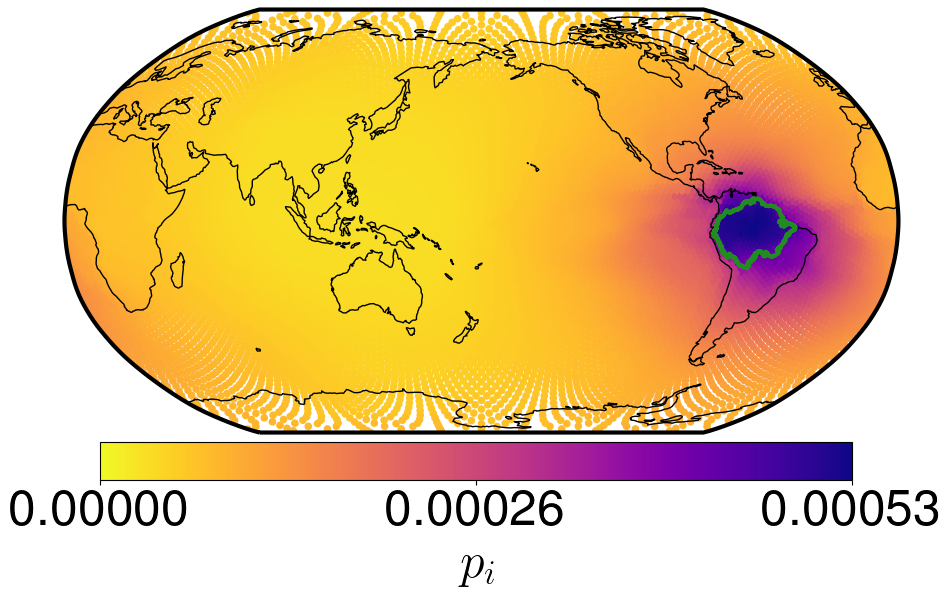

In [ ]:
i = 500

fontsize = 36

plt.rc('text', usetex=True)
plt.rc('xtick',labelsize=fontsize)
plt.rc('ytick',labelsize=fontsize)


# fig, axs = plt.subplots(1,1,sharex=True,figsize=(20,10))
fig = plt.figure(figsize=(10,5))

ax = plt.subplot2grid(shape=(1, 1), loc=(0, 0), projection=ccrs.Robinson(central_longitude=180))

title = str(i)

#   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
#   ilat, ilon, idat = interpolate_scatter_data(latlon_icos, R_i_dict[date],
# #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
#                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

ax.coastlines(zorder=5)

# null_rate = max(1,int(density*(num_nodes-1)/4*len(amazon_nodes)/num_nodes))
# min_value = null_rate/len(amazon_nodes)
min_value = 0
# data = np.mean(walk_probability[:,:2000],axis=1)
data = np.mean(walk_probability[:,:i], axis=1)
max_value = np.max(data)

levels = np.linspace(min_value,max_value,100)
ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

cmap = mpl.cm.plasma_r


reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)



# ind = np.where(R_i_dict[date] > 0)[0]

# # idat[idat < min_value] = np.NAN

# # im = ax.contourf(ilon, ilat, idat, levels=levels,
# #                   cmap=cmap, alpha=1,
# #                   vmin=min_value, vmax=max_value,
# #                   transform=ccrs.PlateCarree(), zorder=4)
im = ax.scatter(latlon_icos[:,1], latlon_icos[:,0],
                  c=data,
                  cmap='plasma_r', transform=ccrs.PlateCarree(), marker='o', s=20,
                  edgecolors=None)
# ax.set_extent([-180,180,-90,90], crs=ccrs.PlateCarree())
# for c in im.collections:
#     c.set_edgecolor("face")
im.set_clim(min_value, max_value)

# im.cmap.set_under('w')

# ax.annotate(r'\textbf{('+chr(97+i)+')}', xy=(0, 1), xycoords="axes fraction",
#              fontsize=fontsize,usetex=True, va='top', ha='left')

# ax.set_title(title, fontsize=fontsize)

plt.setp(ax.spines.values(), linewidth=3, zorder=100)
ax.tick_params(length=15,width=3)


plt.tight_layout()
plt.subplots_adjust(wspace=-0.25)

cbar = fig.colorbar(im, ax = fig.get_axes(), anchor=(0.475, 0),
                    orientation='horizontal',fraction=0.08, pad=0.02)
ticks = np.linspace(min_value,max_value,3)
cbar.set_ticks(ticks)
cbar.set_ticklabels(['{:.5f}'.format(ticks[i]) for i in range(len(ticks))],usetex=True)
cbar.set_label(r'$p_i$',fontsize=fontsize)




title = 'Random Walk'
# plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
# plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)

plt.show()

In [ ]:
non_amazon_nodes = np.setdiff1d(range(num_nodes),amazon_nodes)

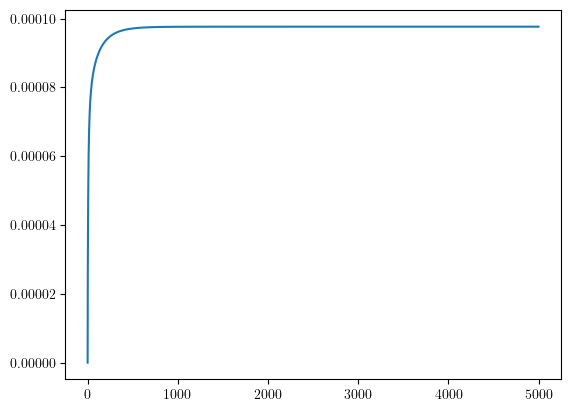

In [ ]:
plt.plot(np.mean(walk_probability[non_amazon_nodes,:], axis=0))

In [ ]:
densities = [0.1, 0.05, 0.025, 0.01, 0.005]

for density in densities:

  with gzip.open(data_dir + 'icosahedral_grid.data', 'rb') as file:
    latlon_icos = np.array(pkl.load(file))

  months = 300
  offset = 365.25


  edge_dir = data_dir + 'edge_list-months='+str(months)+',offset='+str(offset)+',density={:}'.format(density)+'/'

  total_networks = len(os.listdir(edge_dir))

  num_nodes = 10242

  with gzip.open(data_dir + 'year_intervals-months='+str(months)+',offset='+str(offset) + '.data', 'rb') as file:
    year_intervals = pkl.load(file)

  with gzip.open(data_dir + 'date_intervals-months='+str(months)+',offset='+str(offset) + '.data', 'rb') as file:
    date_intervals = pkl.load(file)

  dates = [year_intervals[i][0] + '-' + year_intervals[i][1] for i in range(len(year_intervals))]
  print(dates)

  reader = shpreader.Reader(base_dir+'Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())

  recompute = False

  if recompute:
    amazon_nodes = []

    for i in range(num_nodes):
      if amazon._geoms[0].contains(Point(latlon_icos[i,1]-360,latlon_icos[i,0])):
        amazon_nodes.append(i)

    with gzip.open(data_dir + 'amazon_nodes_new_networks.data', 'wb') as file:
      pkl.dump(amazon_nodes, file)
  else:
    with gzip.open(data_dir + 'amazon_nodes_new_networks.data', 'rb') as file:
      amazon_nodes = pkl.load(file)

  recompute = False

  graph_dir = data_dir + 'G-months='+str(months)+',offset='+str(offset)+',density={:}'.format(density)+'/'
  if recompute:
    if not os.path.isdir(graph_dir):
      os.mkdir(graph_dir)

    for i in trange(len(dates)):
      date = dates[i]

      with gzip.open(edge_dir + str(i) + '.data', 'rb') as file:
        edge_list = pkl.load(file)

      # print(i, len(edge_list), len(np.where(edge_list[:,1] > 0)[0])/(num_nodes*(num_nodes-1)/2))

      G = nx.from_edgelist(edge_list) # initiall unsorted

      H = nx.Graph() # make sorted copy
      H.add_nodes_from(sorted(G.nodes(data=True)))
      H.add_edges_from(G.edges(data=True))
      G = H # write over original with sorted copy
      del H # delete sorted copy

      print(i, nx.density(G), len(edge_list)/(num_nodes*(num_nodes-1)/2))

      with gzip.open(graph_dir + date + '.data', 'wb') as file:
        pkl.dump(G, file)

['1948-1973', '1949-1974', '1950-1975', '1951-1976', '1952-1977', '1953-1978', '1954-1979', '1955-1980', '1956-1981', '1957-1982', '1958-1983', '1959-1984', '1960-1985', '1961-1986', '1962-1987', '1963-1988', '1964-1989', '1965-1990', '1966-1991', '1967-1992', '1968-1993', '1969-1994', '1970-1995', '1971-1996', '1972-1997', '1973-1998', '1974-1999', '1975-2000', '1976-2001', '1977-2002', '1978-2003', '1979-2004', '1980-2005', '1981-2006', '1982-2007', '1983-2008', '1984-2009', '1985-2010', '1986-2011', '1987-2012', '1988-2013', '1989-2014', '1990-2015', '1991-2016', '1992-2017', '1993-2018', '1994-2019', '1995-2020', '1996-2021', '1997-2022', '1998-2023']
['1948-1973', '1949-1974', '1950-1975', '1951-1976', '1952-1977', '1953-1978', '1954-1979', '1955-1980', '1956-1981', '1957-1982', '1958-1983', '1959-1984', '1960-1985', '1961-1986', '1962-1987', '1963-1988', '1964-1989', '1965-1990', '1966-1991', '1967-1992', '1968-1993', '1969-1994', '1970-1995', '1971-1996', '1972-1997', '1973-1998

In [ ]:
def get_num_in_box(center_lat,center_lon,width,height,latlon_icos):
    num = 0
    for i in range(len(latlon_icos)):
        lat, lon = latlon_icos[i]
        # num += 1 if (center_lat-height/2 <= lat <= center_lat+height/2) and (center_lon-width/2 % 360 <= lon <= center_lon+width/2 % 360) else 0
        num += ((center_lat-height/2 <= lat <= center_lat+height/2) and (center_lon-width/2 % 360 <= lon <= center_lon+width/2 % 360))
    return num

def get_random_box(n,latlon_icos,increment=0.5,lat_low=-80,lat_high=80):
    # NOTE: Allows for box to cross 0 deg longitude line (REMEMBER TO USE MODULAR ARITHMETIC)
#     center_lat = np.random.uniform(low=-90,high=90)
    center_lat = np.random.uniform(low=lat_low,high=lat_high)
    center_lon = np.random.uniform(low=0,high=360)
#     height, width = increment, increment
#     height, width = 20, 20
    start_ratio = 0.75
    aspect_ratio = 30/22
    height, width = start_ratio*22, start_ratio*30
    while get_num_in_box(center_lat,center_lon,width,height,latlon_icos) < n:
        height += increment/aspect_ratio
#         width += increment
        width += increment
        if center_lat-height/2 < -90 or center_lat+height/2 > 90:
            # Reset (box stetches past -90 or +90 latitude)
#             center_lat = np.random.uniform(low=-90,high=90)
            center_lat = np.random.uniform(low=lat_low,high=lat_high)
            center_lon = np.random.uniform(low=0,high=360)
#             height, width = 20, 20
            height, width = start_ratio*22, start_ratio*30
#     print(height,width)
    return center_lat, center_lon, height, width

def get_nodes_in_box(center_lat,center_lon,height,width,latlon_icos):
    nodes = []
    for i in range(len(latlon_icos)):
#         lat, lon = finallats[i], finallons[i]
        lat, lon = latlon_icos[i]
        if (center_lat-height/2 <= lat <= center_lat+height/2) and (center_lon-width/2 % 360 <= lon <= center_lon+width/2 % 360):
            nodes += [i]
#     print(len(nodes))
    return nodes  # RETURNS THE NODE **NAME**, NOT INDEX OF NODE IN G.nodes()

def get_random_box_samples(n,latlon_icos,random_box_dir,num_samples=1000,increment=0.5,disp_progress=False,excluded_nodes=amazon_nodes):
    target_nodes_lst_overall = []
    target_nodes_lst_tropical = []

    # excluded_nodes = set(excluded_nodes)

    if disp_progress:
        lst = trange(num_samples, leave=False, desc='Building samples')
    else:
        lst = range(num_samples)

    for k in lst:
        # Overall Random Boxes
        center_lat, center_lon, height, width = get_random_box(n,latlon_icos,increment)
        target_nodes = np.setdiff1d(get_nodes_in_box(center_lat,center_lon,height,width,
                                        latlon_icos),excluded_nodes) # NODE **NAMES**
        # target_nodes = sorted(list(set(target_nodes) - excluded_nodes))
        # target_nodes = [t for t in target_nodes if t not in [excluded_nodes]]
        target_nodes_lst_overall.append(target_nodes)


#         for date in dates:
#             target_nodes = get_nodes_in_box(center_lat,center_lon,height,width,
#                                             finallats_dict[date],finallons_dict[date],
#                                             node_index_dict[date]) # NODE **NAMES**
#             target_nodes = [t for t in target_nodes if t not in [excluded_nodes]]
#             if not date in target_nodes_dict_overall:
#                 target_nodes_dict_overall[date] = [target_nodes]
#             else:
#                 target_nodes_dict_overall[date].append(target_nodes)

        # Tropical Random Boxes
        center_lat, center_lon, height, width = get_random_box(n,latlon_icos,increment,-10,10)
        target_nodes = np.setdiff1d(get_nodes_in_box(center_lat,center_lon,height,width,
                                        latlon_icos),excluded_nodes) # NODE **NAMES**
        # target_nodes = sorted(list(set(target_nodes) - excluded_nodes))
        # target_nodes = [t for t in target_nodes if t not in [excluded_nodes]]
        target_nodes_lst_tropical.append(target_nodes)


#         for date in dates:
#             target_nodes = get_nodes_in_box(center_lat,center_lon,height,width,
#                                             finallats_dict[date],finallons_dict[date],
#                                             node_index_dict[date]) # NODE **NAMES**
#             target_nodes = [t for t in target_nodes if t not in [excluded_nodes]]
#             if not date in target_nodes_dict_tropical:
#                 target_nodes_dict_tropic al[date] = [target_nodes]
#             else:
#                 target_nodes_dict_tropical[date].append(target_nodes)

#     for date in tqdm(dates, leave=False, desc='Saving data', position=0):
#         with gzip.open(random_box_dir + 'Overall/'+date+'.data','wb') as file:
#             pkl.dump(target_nodes_dict_overall[date], file)

#         with gzip.open(random_box_dir + 'Tropical/'+date+'.data','wb') as file:
#             pkl.dump(target_nodes_dict_tropical[date], file)

    with gzip.open(random_box_dir + 'overall.data', 'wb') as file:
        pkl.dump(target_nodes_lst_overall, file)

    with gzip.open(random_box_dir + 'tropical.data', 'wb') as file:
        pkl.dump(target_nodes_lst_tropical, file)

    return target_nodes_lst_overall, target_nodes_lst_tropical

In [ ]:
density = 0.05
graph_dir = data_dir + 'G-months='+str(months)+',offset='+str(offset)+',density={:}'.format(density)+'/'

In [ ]:
random_box_dir = data_dir + 'Random Boxes/'
if not os.path.isdir(random_box_dir):
  os.mkdir(random_box_dir)

recompute = False

if recompute:
  target_nodes_lst_overall, target_nodes_lst_tropical = get_random_box_samples(len(amazon_nodes),latlon_icos,random_box_dir,num_samples=5000,increment=0.5,disp_progress=True,excluded_nodes=amazon_nodes)
else:
  with gzip.open(random_box_dir + 'overall.data', 'rb') as file:
      target_nodes_lst_overall = pkl.load(file)

  with gzip.open(random_box_dir + 'tropical.data', 'rb') as file:
      target_nodes_lst_tropical = pkl.load(file)

In [ ]:
with gzip.open(graph_dir + dates[0] + '.data', 'rb') as file:
  G = pkl.load(file)

In [ ]:
target_nodes = target_nodes_lst_overall[0]
edges = np.array(list(G.edges(target_nodes)))
print(geodesic_distances[edges[:,0],edges[:,1]])
print([e for e in edges if e[1] not in target_nodes])
print(G.edges(target_nodes))
print(target_nodes)

NameError: ignored

In [ ]:
dir_end = '-months={:},offset={:},density={:}/'.format(months,offset,density)
with gzip.open(data_dir+'edge_betweenness'+dir_end+dates[0]+'.data', 'rb') as file:
  edge_betweenness = pkl.load(file)

In [ ]:
edges_in = np.array([sorted(e) for e in edges if e[0] in target_nodes and e[1] in target_nodes])
edges_out = np.array([sorted(e) for e in edges if e[1] not in target_nodes or e[1] not in target_nodes])
print(np.mean([edge_betweenness[tuple(e)] for e in edges_in])/np.mean(geodesic_distances[edges[:,0],edges[:,1]]))
print(np.mean([edge_betweenness[tuple(e)] for e in edges_out])/np.mean(geodesic_distances[edges[:,0],edges[:,1]]))

4.175340122996859e-12
3.735358894375062e-12


In [ ]:
print(geodesic_distances[edges_out[:,0],edges_out[:,1]])

[12458.00666227 12230.02379256 10862.99686839 ...  2797.7319096   2905.52934075  3028.92994609]


In [ ]:
print(type(target_nodes[0]))

<class 'numpy.int64'>


In [ ]:
%%timeit
with gzip.open(graph_dir + dates[0] + '.data', 'rb') as file:
  G = pkl.load(file)

3.12 s ± 413 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [ ]:
%%timeit
G1 = G.copy()

13.1 s ± 250 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [ ]:
%%timeit
G1 = nx.Graph()
G1.add_edges_from(G.edges)

5.16 s ± 191 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [ ]:
print(G.number_of_edges())
for _ in trange(1):
  non_target_nodes = sorted(list(set(range(num_nodes)) - set(target_nodes)))
  # G1 = nx.Graph()
  # G1.add_edges_from(G.edges)
  G1 = G

  for node in target_nodes[1:]:
    nx.contracted_nodes(G1, target_nodes[0], node, copy=False)

  paths = nx.single_source_shortest_path(G1, target_nodes[0])
  shortest_paths_from_box = [paths[node] for node in non_target_nodes]
print(G.number_of_edges())

2622208


  0%|          | 0/1 [00:00<?, ?it/s]

2564400


In [ ]:
print(len(edges_out)/(len(edges)))

0.8494096125062365


In [ ]:
print(geodesic_distances[edges_out].shape)

[[[ 9297.16032572  9401.94514082  9512.80653334 ... 11821.41850087 10926.69243163 11826.86846155]
  [ 7245.4213654   6833.87035814  6409.82152264 ...  6476.14617845  1781.47471348  6178.19205021]]

 [[ 9297.16032572  9401.94514082  9512.80653334 ... 11821.41850087 10926.69243163 11826.86846155]
  [ 7141.34149371  6726.34578585  6298.50449298 ...  6537.04264064  1572.49593492  6236.0268747 ]]

 [[ 9297.16032572  9401.94514082  9512.80653334 ... 11821.41850087 10926.69243163 11826.86846155]
  [10254.64635862 10648.92390397 11055.70446193 ... 15503.13662336 15525.69338162 15752.08012078]]

 ...

 [[ 8076.44918794  8376.10616231  8689.41354515 ... 15289.76988635 12420.37304409 15325.5115249 ]
  [ 7061.03336183  7460.12833261  7873.69678288 ... 18077.78876142 12714.71491698 18122.53557326]]

 [[ 8076.44918794  8376.10616231  8689.41354515 ... 15289.76988635 12420.37304409 15325.5115249 ]
  [ 6817.83682143  7217.85080813  7632.46001124 ... 18193.40662746 12490.83189107 18200.47047254]]

 [[ 

In [ ]:
for i in range(len(target_nodes_lst_overall)):

  fontsize = 54

  plt.rc('text', usetex=True)
  plt.rc('xtick',labelsize=fontsize)
  plt.rc('ytick',labelsize=fontsize)


  # fig, axs = plt.subplots(1,1,sharex=True,figsize=(20,10))
  fig = plt.figure(figsize=(20,10))

  ax1 = plt.subplot2grid(shape=(1, 1), loc=(0, 0), projection=ccrs.Robinson(central_longitude=180))



  # plt.subplots_adjust(hspace=0, wspace=0.15)



  ### AXIS 1, RANDOM WALK MAP
  ax1.coastlines(zorder=5)


  # min_value = np.nanmin(idat)
  # max_value = np.nanmax(idat)
  # min_value = min(np.delete(dist_trend,amazon_nodes_corrected))
  # max_value = max(np.delete(dist_trend,amazon_nodes_corrected))
  # min_value = -.02#min(R_i_trend)
  # max_value = .02#max(R_i_trend)

  # idat1 = idat
  # idat1[np.where(idat < min_value)] = min_value

  min_value = 0
  max_value = 1

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  # midpoint = -min_value/(max_value-min_value)
  cmap = mpl.cm.bwr
  # shifted_cmap = shiftedColorMap(cmap, midpoint=midpoint)


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax1.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)

  im = ax1.scatter(latlon_icos[:,1], latlon_icos[:,0],
                    c=[1 if j in target_nodes_lst_overall[i] else 0 for j in range(num_nodes)],
                    cmap='bwr', transform=ccrs.PlateCarree(), marker='o', s=20,
                    edgecolors=None)
  im.set_clim(min_value, max_value)
  cbar=plt.colorbar(im, ax=ax1, orientation='horizontal',fraction=0.08, pad=0.02)
  # ticks = np.array([-5,-4,-3,-2,-1,0,1,2])
  # cbar.set_ticks(ticks*1e-5)
  # cbar.set_ticklabels(ticks)

  # cbar=plt.colorbar(im, ax=ax1, ticks=ticks[1::3], fraction=0.048, orientation='horizontal',
  #                   pad=0.02, boundaries=levels)
  # cbar.set_ticklabels(['{:.4f}'.format(tick) for tick in ticks[1::3]])

  # cbar.set_label('Slope of Trendline of Average Diffusion Distance to Amazon\n$t = $ '+
  #                '{:.4f}'.format(round(t_target, 4)),fontsize=fontsize)
  cbar.set_label(r'$m_k\left(R_{i,out}^{(k)}/N_A\right)$',fontsize=fontsize, usetex=True)

  # cbar.ax.plot([threshold_neg]*2, [0,1], 'k', lw=1)
  # cbar.ax.plot([threshold_pos]*2, [0,1], 'k', lw=1)

  plt.setp(ax1.spines.values(), linewidth=2)

  # plt.title(date, fontsize=fontsize)



  plt.tight_layout()



  title = 'Random Walk'
  # plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
  # plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)

  plt.show()

In [ ]:
for i in range(len(target_nodes_lst_tropical)):
  fontsize = 54

  plt.rc('text', usetex=True)
  plt.rc('xtick',labelsize=fontsize)
  plt.rc('ytick',labelsize=fontsize)


  # fig, axs = plt.subplots(1,1,sharex=True,figsize=(20,10))
  fig = plt.figure(figsize=(20,10))

  ax1 = plt.subplot2grid(shape=(1, 1), loc=(0, 0), projection=ccrs.Robinson(central_longitude=180))



  # plt.subplots_adjust(hspace=0, wspace=0.15)



  ### AXIS 1, RANDOM WALK MAP
  ax1.coastlines(zorder=5)


  # min_value = np.nanmin(idat)
  # max_value = np.nanmax(idat)
  # min_value = min(np.delete(dist_trend,amazon_nodes_corrected))
  # max_value = max(np.delete(dist_trend,amazon_nodes_corrected))
  # min_value = -.02#min(R_i_trend)
  # max_value = .02#max(R_i_trend)

  # idat1 = idat
  # idat1[np.where(idat < min_value)] = min_value

  min_value = 0
  max_value = 1

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  # midpoint = -min_value/(max_value-min_value)
  cmap = mpl.cm.bwr
  # shifted_cmap = shiftedColorMap(cmap, midpoint=midpoint)


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax1.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)

  im = ax1.scatter(latlon_icos[:,1], latlon_icos[:,0],
                    c=[1 if j in target_nodes_lst_tropical[i] else 0 for j in range(num_nodes)],
                    cmap='bwr', transform=ccrs.PlateCarree(), marker='o', s=20,
                    edgecolors=None)
  im.set_clim(min_value, max_value)
  cbar=plt.colorbar(im, ax=ax1, orientation='horizontal',fraction=0.08, pad=0.02)
  # ticks = np.array([-5,-4,-3,-2,-1,0,1,2])
  # cbar.set_ticks(ticks*1e-5)
  # cbar.set_ticklabels(ticks)

  # cbar=plt.colorbar(im, ax=ax1, ticks=ticks[1::3], fraction=0.048, orientation='horizontal',
  #                   pad=0.02, boundaries=levels)
  # cbar.set_ticklabels(['{:.4f}'.format(tick) for tick in ticks[1::3]])

  # cbar.set_label('Slope of Trendline of Average Diffusion Distance to Amazon\n$t = $ '+
  #                '{:.4f}'.format(round(t_target, 4)),fontsize=fontsize)
  cbar.set_label(r'$m_k\left(R_{i,out}^{(k)}/N_A\right)$',fontsize=fontsize, usetex=True)

  # cbar.ax.plot([threshold_neg]*2, [0,1], 'k', lw=1)
  # cbar.ax.plot([threshold_pos]*2, [0,1], 'k', lw=1)

  plt.setp(ax1.spines.values(), linewidth=2)

  # plt.title(date, fontsize=fontsize)



  plt.tight_layout()



  title = 'Random Walk'
  # plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
  # plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)

  plt.show()

In [ ]:
shortest_path_lengths_from_amazon = np.zeros((len(dates),num_nodes-len(amazon_nodes)))
non_amazon_nodes = sorted(list(set(range(num_nodes)) - set(amazon_nodes)))

for i in trange(len(dates)):
  date = dates[i]
  with gzip.open(graph_dir + date + '.data', 'rb') as file:
    G = pkl.load(file)

  for node in amazon_nodes[1:]:
    nx.contracted_nodes(G, amazon_nodes[0], node, copy=False)

  lengths = nx.single_source_shortest_path_length(G, amazon_nodes[0])
  shortest_path_lengths_from_amazon[i,:] = [lengths[node] for node in non_amazon_nodes]

  0%|          | 0/51 [00:00<?, ?it/s]

In [ ]:
shortest_paths_from_amazon = {}
non_amazon_nodes = sorted(list(set(range(num_nodes)) - set(amazon_nodes)))

for i in trange(len(dates)):
  date = dates[i]
  with gzip.open(graph_dir + date + '.data', 'rb') as file:
    G = pkl.load(file)

  for node in amazon_nodes[1:]:
    nx.contracted_nodes(G, amazon_nodes[0], node, copy=False)

  paths = nx.single_source_shortest_path(G, amazon_nodes[0])
  shortest_paths_from_amazon[date] = [paths[node] for node in non_amazon_nodes]

  0%|          | 0/51 [00:00<?, ?it/s]

In [ ]:
geodesic_distances = np.zeros((num_nodes,num_nodes))
for i in trange(num_nodes):
  lats = np.zeros((num_nodes-i-1,)) + latlon_icos[i,0]
  lons = np.zeros((num_nodes-i-1,)) + latlon_icos[i,1]
  geodesic_distances[i,i+1:] = haversine_np(lons,lats,latlon_icos[i+1:,1],latlon_icos[i+1:,0])
  geodesic_distances[i+1:,i] = geodesic_distances[i,i+1:]

  0%|          | 0/10242 [00:00<?, ?it/s]

In [ ]:
dist_by_length = []
for date in tqdm(dates):
  dist_by_length.append(np.mean([geodesic_distances[p[0],p[-1]]/(len(p)-1) for p in shortest_paths_from_amazon[date]]))

  0%|          | 0/51 [00:00<?, ?it/s]

In [ ]:
with gzip.open(graph_dir + dates[0] + '.data', 'rb') as file:
  G = pkl.load(file)

# num_samples

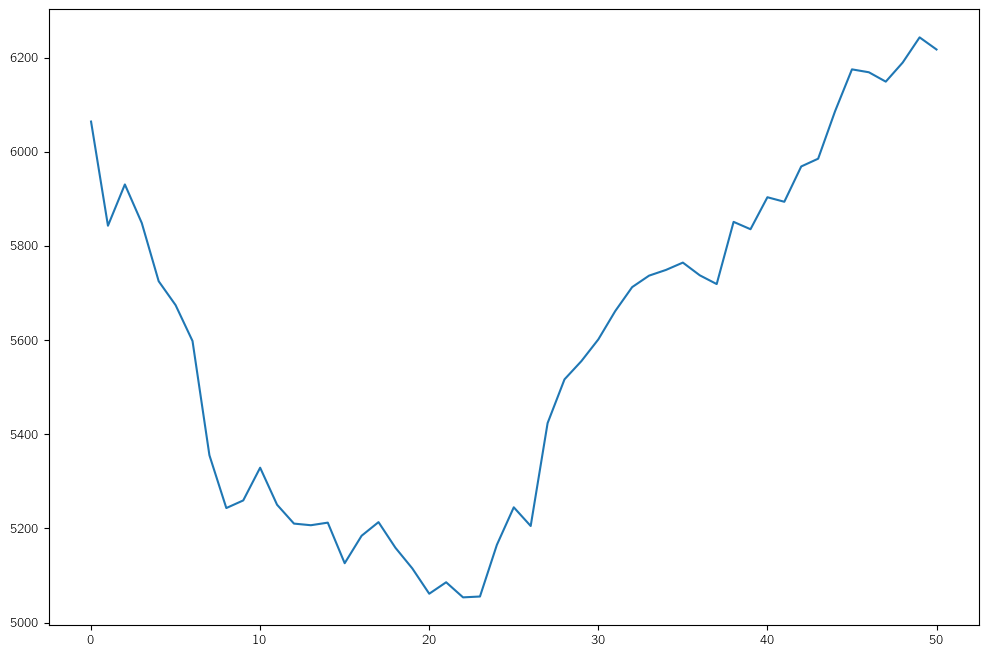

In [ ]:
fig = plt.figure(figsize=(12,8))

# plt.fill_between(np.arange(len(dates)), np.percentile(shortest_path_lengths_from_amazon,0.25,axis=1), np.percentile(shortest_path_lengths_from_amazon,0.75,axis=1), color='k', alpha=0.25)
plt.plot(np.arange(len(dates)), dist_by_length)

plt.show()

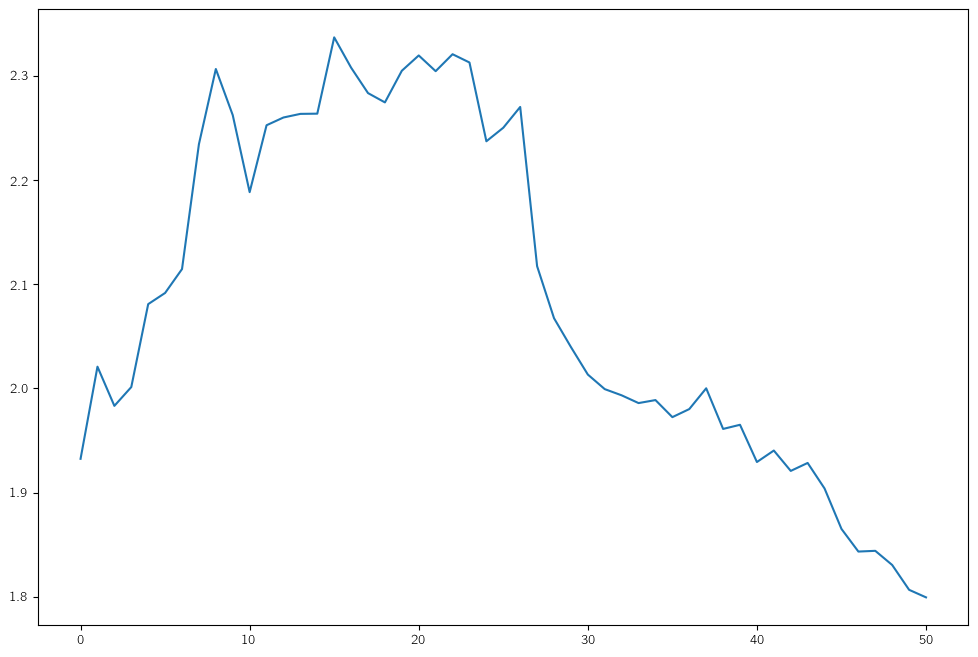

In [ ]:
fig = plt.figure(figsize=(12,8))

# plt.fill_between(np.arange(len(dates)), np.percentile(shortest_path_lengths_from_amazon,0.25,axis=1), np.percentile(shortest_path_lengths_from_amazon,0.75,axis=1), color='k', alpha=0.25)
plt.plot(np.arange(len(dates)), np.mean(shortest_path_lengths_from_amazon,axis=1))

plt.show()

In [ ]:
with gzip.open(graph_dir + dates[0] + '.data', 'rb') as file:
  G = pkl.load(file)

In [ ]:
for node in amazon_nodes[1:]:
  nx.contracted_nodes(G, amazon_nodes[0], node, copy=False)

In [ ]:
%time paths = nx.single_source_shortest_path(G, amazon_nodes[0])

CPU times: user 453 ms, sys: 0 ns, total: 453 ms
Wall time: 454 ms


In [ ]:
print(paths)

{8040: [8040], 5774: [8040, 5774], 5784: [8040, 5784], 5897: [8040, 5897], 5898: [8040, 5898], 5944: [8040, 5944], 5953: [8040, 5953], 6000: [8040, 6000], 6001: [8040, 6001], 6091: [8040, 6091], 7186: [8040, 7186], 7219: [8040, 7219], 7259: [8040, 7259], 7269: [8040, 7269], 7284: [8040, 7284], 7324: [8040, 7324], 7332: [8040, 7332], 7357: [8040, 7357], 7373: [8040, 7373], 7404: [8040, 7404], 7410: [8040, 7410], 7442: [8040, 7442], 7448: [8040, 7448], 7473: [8040, 7473], 7505: [8040, 7505], 7544: [8040, 7544], 7780: [8040, 7780], 7814: [8040, 7814], 7818: [8040, 7818], 7847: [8040, 7847], 7853: [8040, 7853], 7881: [8040, 7881], 7885: [8040, 7885], 7920: [8040, 7920], 7952: [8040, 7952], 7958: [8040, 7958], 7983: [8040, 7983], 7995: [8040, 7995], 8021: [8040, 8021], 8032: [8040, 8032], 8060: [8040, 8060], 8101: [8040, 8101], 8141: [8040, 8141], 8178: [8040, 8178], 9742: [8040, 9742], 9743: [8040, 9743], 9748: [8040, 9748], 9804: [8040, 9804], 5453: [8040, 5453], 5454: [8040, 5454], 5485:

In [ ]:
%time lengths = nx.single_source_shortest_path_length(G, 0)

CPU times: user 342 ms, sys: 0 ns, total: 342 ms
Wall time: 347 ms


In [ ]:
print(np.mean([lengths[n] for n in G.nodes()]))

3.3658827031854717


In [ ]:
date = dates[0]

# with gzip.open(graph_dir + date + '.data', 'rb') as file:
#   G = pkl.load(file)

A = nx.adjacency_matrix(G)
A = A.todense()
A = np.array(A, dtype = np.float64)
for i in range(num_nodes-len(amazon_nodes)+1):
  A[i,:] /= np.sum(A[i,:])

walk_length = 5000
walk_probability = np.zeros((num_nodes-len(amazon_nodes)+1,walk_length+1))
walk_probability[amazon_nodes[0],0] = 1
for i in trange(walk_length):
  walk_probability[:,i+1] = np.matmul(A,walk_probability[:,i])
  walk_probability[:,i+1] /= np.sum(walk_probability[:,i+1])
# walk_probability[:,1] = np.matmul(A,walk_probability[:,0])
# print(walk_probability[np.where(walk_probability[:,1] > 0)[0],1])

  0%|          | 0/5000 [00:00<?, ?it/s]

In [ ]:
print(list(walk_probability[:,0]))

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,

In [ ]:
ind = sorted(list(set(range(num_nodes)) - set(amazon_nodes[1:])))

for i in range(0,walk_length+1,100):
  fontsize = 36

  plt.rc('text', usetex=True)
  plt.rc('xtick',labelsize=fontsize)
  plt.rc('ytick',labelsize=fontsize)


  # fig, axs = plt.subplots(1,1,sharex=True,figsize=(20,10))
  fig = plt.figure(figsize=(10,5))

  ax = plt.subplot2grid(shape=(1, 1), loc=(0, 0), projection=ccrs.Robinson(central_longitude=180))

  title = str(i)

#   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
#   ilat, ilon, idat = interpolate_scatter_data(latlon_icos, R_i_dict[date],
# #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
#                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

  ax.coastlines(zorder=5)

  # null_rate = max(1,int(density*(num_nodes-1)/4*len(amazon_nodes)/num_nodes))
  # min_value = null_rate/len(amazon_nodes)
  min_value = 0
  max_value = np.max(walk_probability[:,i])

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  cmap = mpl.cm.plasma_r


  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)



  # ind = np.where(R_i_dict[date] > 0)[0]

  # # idat[idat < min_value] = np.NAN

  # # im = ax.contourf(ilon, ilat, idat, levels=levels,
  # #                   cmap=cmap, alpha=1,
  # #                   vmin=min_value, vmax=max_value,
  # #                   transform=ccrs.PlateCarree(), zorder=4)
  im = ax.scatter(latlon_icos[ind,1], latlon_icos[ind,0],
                   c=walk_probability[:,i],
                   cmap='plasma_r', transform=ccrs.PlateCarree(), marker='o', s=20,
                   edgecolors=None)
  # ax.set_extent([-180,180,-90,90], crs=ccrs.PlateCarree())
  # for c in im.collections:
  #     c.set_edgecolor("face")
  im.set_clim(min_value, max_value)

  # im.cmap.set_under('w')

  # ax.annotate(r'\textbf{('+chr(97+i)+')}', xy=(0, 1), xycoords="axes fraction",
  #              fontsize=fontsize,usetex=True, va='top', ha='left')

  ax.set_title(title, fontsize=fontsize)

  plt.setp(ax.spines.values(), linewidth=3, zorder=100)
  ax.tick_params(length=15,width=3)


  plt.tight_layout()
  plt.subplots_adjust(wspace=-0.25)

  cbar = fig.colorbar(im, ax = fig.get_axes(), anchor=(0.475, 0),
                      orientation='horizontal',fraction=0.08, pad=0.02)
  ticks = np.linspace(min_value,max_value,3)
  cbar.set_ticks(ticks)
  cbar.set_ticklabels(['{:.5f}'.format(ticks[i]) for i in range(len(ticks))],usetex=True)
  cbar.set_label(r'$p_i$',fontsize=fontsize)




  title = 'Random Walk'
  # plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
  # plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)

  plt.show()

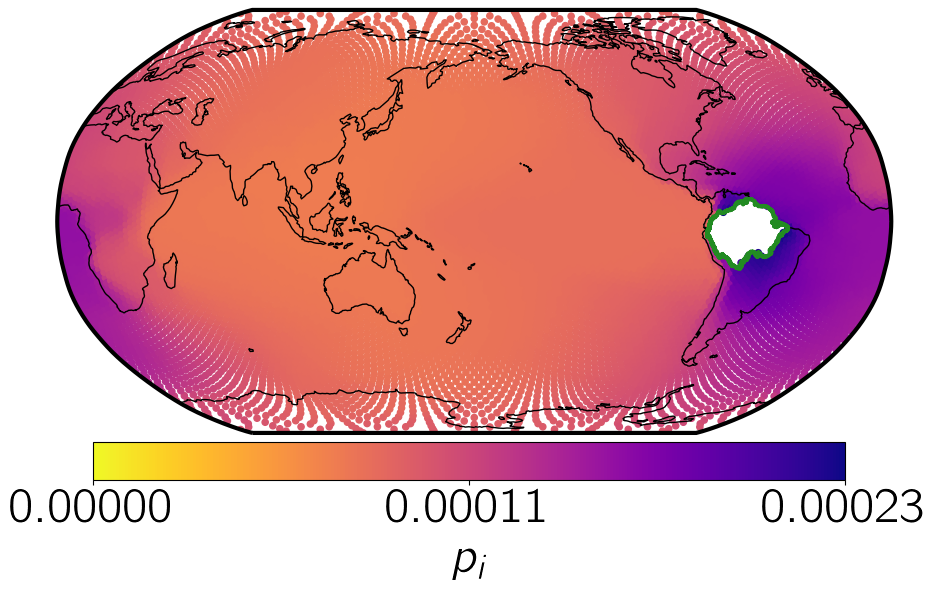

In [ ]:
ind = sorted(list(set(range(num_nodes)) - set(amazon_nodes)))
ind1 = sorted(list(set(range(num_nodes-len(amazon_nodes)+1)) - set(amazon_nodes[:1])))

fontsize = 36

plt.rc('text', usetex=True)
plt.rc('xtick',labelsize=fontsize)
plt.rc('ytick',labelsize=fontsize)


# fig, axs = plt.subplots(1,1,sharex=True,figsize=(20,10))
fig = plt.figure(figsize=(10,5))

ax = plt.subplot2grid(shape=(1, 1), loc=(0, 0), projection=ccrs.Robinson(central_longitude=180))

title = str(i)

#   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
#   ilat, ilon, idat = interpolate_scatter_data(latlon_icos, R_i_dict[date],
# #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
#                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

ax.coastlines(zorder=5)

# null_rate = max(1,int(density*(num_nodes-1)/4*len(amazon_nodes)/num_nodes))
# min_value = null_rate/len(amazon_nodes)
min_value = 0
data = np.mean(walk_probability[ind1,:2000],axis=1)
max_value = np.max(data)

levels = np.linspace(min_value,max_value,100)
ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

cmap = mpl.cm.plasma_r


reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)



# ind = np.where(R_i_dict[date] > 0)[0]

# # idat[idat < min_value] = np.NAN

# # im = ax.contourf(ilon, ilat, idat, levels=levels,
# #                   cmap=cmap, alpha=1,
# #                   vmin=min_value, vmax=max_value,
# #                   transform=ccrs.PlateCarree(), zorder=4)
im = ax.scatter(latlon_icos[ind,1], latlon_icos[ind,0],
                  c=data,
                  cmap='plasma_r', transform=ccrs.PlateCarree(), marker='o', s=20,
                  edgecolors=None)
# ax.set_extent([-180,180,-90,90], crs=ccrs.PlateCarree())
# for c in im.collections:
#     c.set_edgecolor("face")
im.set_clim(min_value, max_value)

# im.cmap.set_under('w')

# ax.annotate(r'\textbf{('+chr(97+i)+')}', xy=(0, 1), xycoords="axes fraction",
#              fontsize=fontsize,usetex=True, va='top', ha='left')

# ax.set_title(title, fontsize=fontsize)

plt.setp(ax.spines.values(), linewidth=3, zorder=100)
ax.tick_params(length=15,width=3)


plt.tight_layout()
plt.subplots_adjust(wspace=-0.25)

cbar = fig.colorbar(im, ax = fig.get_axes(), anchor=(0.475, 0),
                    orientation='horizontal',fraction=0.08, pad=0.02)
ticks = np.linspace(min_value,max_value,3)
cbar.set_ticks(ticks)
cbar.set_ticklabels(['{:.5f}'.format(ticks[i]) for i in range(len(ticks))],usetex=True)
cbar.set_label(r'$p_i$',fontsize=fontsize)




title = 'Random Walk'
# plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
# plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)

plt.show()

In [ ]:
print(np.sum(walk_probability, axis=0))

[1. 1. 1. ... 1. 1. 1.]


In [ ]:
print(np.where(A[0] == 1)[0])
print(list(G.neighbors(0)))

[   1  402  529  890  892  963  965 1446 1751 2076 2560 2561 2562 2563 7682 8552 8857 9338 9340 9413 9774 9901]
[1, 402, 529, 890, 892, 963, 965, 1446, 1751, 2076, 2560, 2561, 2562, 2563, 7682, 8552, 8857, 9338, 9340, 9413, 9774, 9901]


In [ ]:
def save_walk(parallel_walk_dir, walks, desc):
  with gzip.open(parallel_walk_dir + str(desc) + '.data', 'wb') as file:
    pkl.dump(walks, file)

def random_walk(G, amazon_nodes, length=3):
  prev_node = amazon_nodes[np.random.randint(0,len(amazon_nodes))]
  walk = [prev_node]
  while len(walk) < length+1:
    neighbors = list(set(n for n in G.neighbors(prev_node)) - set(walk))
    if len(neighbors) == 0:
      return None
    next_node = neighbors[np.random.randint(0,len(neighbors))]
    walk.append(next_node)
    prev_node = next_node
  return np.array(walk)

def random_walks(amazon_nodes, num_samples=1000, length=3, max_tries=10, desc='', G=None, graph_dir='', parallel_walk_dir='', parallel=False):
  if G is None:
    with gzip.open(graph_dir + desc + '.data', 'rb') as file:
      G = pkl.load(file)
  walks = np.zeros((num_samples,length+1))
  for i in trange(num_samples, desc=desc, leave=False):
    walk = random_walk(G, amazon_nodes, length)
    tries = 0
    while walk is None and tries < max_tries:
      walk = random_walk(G, amazon_nodes, length)
    if tries == max_tries:
      return None
    walks[i,:] = walk
  if parallel:
    save_walk(parallel_walk_dir, walks, desc)
    return desc
  else:
    return walks

def random_walks_all_networks(amazon_nodes, graph_dir, num_samples=1000, length=3, max_tries=10):
  random_walks_dict = {}
  for date in tqdm(dates):
    with gzip.open(graph_dir + date + '.data', 'rb') as file:
      G = pkl.load(file)

    walks = random_walks(amazon_nodes, num_samples, length, max_tries, date, G=G)
    tries = 0
    while walks is None and tries < max_tries:
      walks = random_walks(amazon_nodes, num_samples, length, max_tries, date, G=G)
    if tries == max_tries:
      return None
    random_walks_dict[date] = walks
  return random_walks_dict

In [ ]:
density = 0.05
dir_end = '-months={:},offset={:},density={:}/'.format(months,offset,density)
walk_dir = data_dir + 'Random_Walk' + dir_end
if not os.path.isdir(walk_dir):
  os.mkdir(walk_dir)
parallel_walk_dir = walk_dir + 'Parallel Walks/'
if not os.path.isdir(parallel_walk_dir):
  os.mkdir(parallel_walk_dir)

max_length = 50
num_samples = 100000

recompute = True
parallel = True


if recompute:
  if not parallel:
    walks_dict = random_walks_all_networks(amazon_nodes, graph_dir, num_samples=num_samples, length=max_length, max_tries=100)

    with gzip.open(walk_dir + 'walks_dict-max_length={:},num_samples={:},'.format(max_length,num_samples) + dir_end[1:-1] + '.data', 'wb') as file:
      pkl.dump(walks_dict, file)
  else:
    import multiprocessing as mp

    def handle_error(error):
        print(error)

    existing_iters = []
    for filename in sorted(os.listdir(parallel_walk_dir), key = lambda k: k.replace('.data', '')):
      if os.path.getsize(parallel_walk_dir + filename) > 2e7:
        existing_iters += [filename.replace('.data','')]

    print(sorted(list(set(dates) - set(existing_iters)), key = lambda k:int(k.split('-')[0])))

    n_tasks = 4
    pool = mp.Pool(n_tasks)

    jobs = [pool.apply_async(random_walks,
                            args=[amazon_nodes, num_samples, max_length, 10, date, None, graph_dir, parallel_walk_dir, parallel],
                            error_callback=handle_error) for date in dates if date not in existing_iters]
    pool.close()

    result_lst = []
    lst = tqdm(jobs)
    for job in lst:
        j = job.get()
        print(j)
        result_lst.append(j)
        try:
          lst.set_description(str(j))
        except:
          pass

    pool.join()

    walks_dict = {}
    for date in tqdm(dates):
      # print(date)
      try:
        with gzip.open(parallel_walk_dir + date + '.data', 'rb') as file:
          walks = pkl.load(file)
      except:
        print(date)

      walks_dict[date] = walks

      del walks

    with gzip.open(walk_dir + 'walks_dict-max_length={:},num_samples={:},'.format(max_length,num_samples) + dir_end[1:-1] + '.data', 'wb') as file:
      pkl.dump(walks_dict, file)
else:
  with gzip.open(walk_dir + 'walks_dict-max_length={:},num_samples={:},'.format(max_length,num_samples) + dir_end[1:-1] + '.data', 'rb') as file:
    walks_dict = pkl.load(file)

In [ ]:
walks_dict = {}
for date in tqdm(dates):
  # print(date)
  try:
    with gzip.open(parallel_walk_dir + date + '.data', 'rb') as file:
      walks = pkl.load(file)
  except:
    print(date)

  walks_dict[date] = walks

  del walks

  0%|          | 0/51 [00:00<?, ?it/s]

In [ ]:
with gzip.open(walk_dir + 'walks_dict-max_length={:},num_samples={:},'.format(max_length,num_samples) + dir_end[1:-1] + '.data', 'wb') as file:
      pkl.dump(walks_dict, file)

In [ ]:
for date in dates:
  # print(len(walks_dict[date]), len(walks_dict[date]) != num_samples)
  if len(walks_dict[date]) != num_samples:
    walks_dict[date] = np.unique(walks_dict[date], axis=0)[:num_samples,:]

In [ ]:
for date in dates:
  print(date, walks_dict[date].shape)

1948-1973 (100000, 51)
1949-1974 (100000, 51)
1950-1975 (100000, 51)
1951-1976 (100000, 51)
1952-1977 (100000, 51)
1953-1978 (100000, 51)
1954-1979 (100000, 51)
1955-1980 (100000, 51)
1956-1981 (100000, 51)
1957-1982 (100000, 51)
1958-1983 (100000, 51)
1959-1984 (100000, 51)
1960-1985 (100000, 51)
1961-1986 (100000, 51)
1962-1987 (100000, 51)
1963-1988 (100000, 51)
1964-1989 (100000, 51)
1965-1990 (100000, 51)
1966-1991 (100000, 51)
1967-1992 (100000, 51)
1968-1993 (100000, 51)
1969-1994 (100000, 51)
1970-1995 (100000, 51)
1971-1996 (100000, 51)
1972-1997 (100000, 51)
1973-1998 (100000, 51)
1974-1999 (100000, 51)
1975-2000 (100000, 51)
1976-2001 (100000, 51)
1977-2002 (100000, 51)
1978-2003 (100000, 51)
1979-2004 (100000, 51)
1980-2005 (100000, 51)
1981-2006 (100000, 51)
1982-2007 (100000, 51)
1983-2008 (100000, 51)
1984-2009 (100000, 51)
1985-2010 (100000, 51)
1986-2011 (100000, 51)
1987-2012 (100000, 51)
1988-2013 (100000, 51)
1989-2014 (100000, 51)
1990-2015 (100000, 51)
1991-2016 (

In [ ]:
a = walks_dict['1956-1981']
unq = np.unique(a, axis=0)
print(count)

[1 1 1 ... 1 1 1]


In [ ]:
# walk_in_amazon_dict = {}
# for date in tqdm(dates):
#   walk_in_amazon_dict[date] = np.zeros((max_length,1))
#   for length in range(1,max_length+1):
#     walk_in_amazon_dict[date][length-1] = sum([1 if walks_dict[date][i,length] in amazon_nodes else 0 for i in range(num_samples)])/num_samples

In [ ]:
walk_in_amazon_dict = {}
for date in tqdm(dates):
  walk_in_amazon_dict[date] = np.zeros((max_length,1))
  for length in range(1,max_length+1):
    walk_in_amazon_dict[date][length-1] = sum([len(np.where(walks_dict[date][:,length] == node)[0]) for node in amazon_nodes])/len(walks_dict[date])

  0%|          | 0/51 [00:00<?, ?it/s]

KeyboardInterrupt: ignored

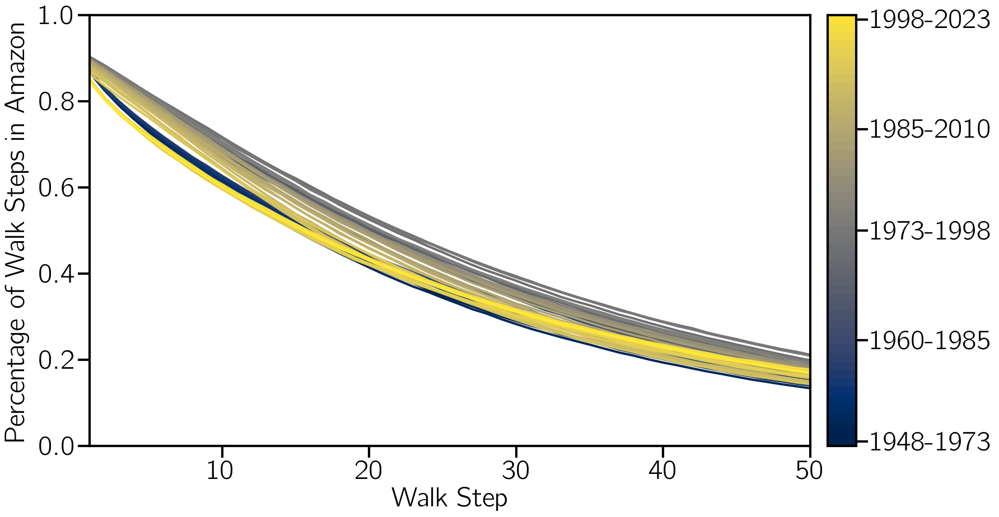

In [ ]:
fontsize = 36

plt.rc('text', usetex=True)
plt.rc('xtick',labelsize=fontsize)
plt.rc('ytick',labelsize=fontsize)

lw = 3

fig, ax1 = plt.subplots(1,1,figsize=(20,10),sharex=True)

n = len(dates)
c = np.arange(1,n+1)
norm = mpl.colors.Normalize(vmin=c.min(), vmax=c.max())
cmap = mpl.cm.ScalarMappable(norm=norm, cmap='cividis')
cmap.set_array([])
for i in range(len(dates)):
    date = dates[i]
    ax1.plot(np.arange(1,max_length+1),walk_in_amazon_dict[date],c=cmap.to_rgba(i+1),alpha=1,lw=lw,zorder=5)

ax1.set_xlabel(r'Walk Step',fontsize=fontsize)
ax1.set_ylabel(r'Percentage of Walk Steps in Amazon',fontsize=fontsize, labelpad=12)

ax1.set_xlim([1, max_length])
ax1.set_ylim([0, 1])
# ax1.set_yticks([0.015, 0.016, 0.017, 0.018])

# ax1.plot([t_target, t_target], ax1.get_ylim(), '--', c='gray', lw=lw, zorder=4)

spacing = 0.025
# ax1.annotate(r'\textbf{(a)}', xy=(spacing/4, 1-spacing), xycoords="axes fraction",
#              fontsize=fontsize,usetex=True, va='top', ha='left', zorder=100)

ax1.tick_params(length=15,width=3)
plt.setp(ax1.spines.values(), linewidth=3, zorder=10)


num_ticks = 5
ticks = np.linspace(0,len(dates)-1,num_ticks).astype(int)

# plt.tight_layout()
plt.subplots_adjust(hspace=0.2)
# fig.align_labels([ax1,ax2])

# cax1 = fig.add_ax1es([0.68, 0.21, 0.01, 0.755])
cbar = fig.colorbar(cmap, ticks=ticks,
                    ax=[ax1], orientation='vertical', pad=.02, aspect=15, boundaries=np.arange(-.5,len(c),1))
# cbar.set_label(r'',fontsize=fontsize,rotation='vertical',labelpad=20)
cbar.ax.set_yticklabels([dates[tick] for tick in ticks])
cbar.ax.tick_params(length=15,width=3)
cbar.outline.set_linewidth(3)



# # plt.tight_layout()
# plt.subplots_adjust(hspace=0)
# # fig.align_labels([ax1,ax2])

title = 'Avg Phi and Num Nodes Affected'
# plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
# plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)

plt.show()

In [ ]:
with gzip.open(graph_dir + dates[0] + '.data', 'rb') as file:
      G = pkl.load(file)

print(nx.diameter(G))

30


In [ ]:
for date in tqdm(dates):
  with gzip.open(graph_dir + date + '.data', 'rb') as file:
      G = pkl.load(file)

  print(date, nx.approximation.diameter(G))

  0%|          | 0/51 [00:00<?, ?it/s]

1948-1973 28
1949-1974 27
1950-1975 30
1951-1976 29
1952-1977 29
1953-1978 31
1954-1979 30
1955-1980 29
1956-1981 30
1957-1982 28
1958-1983 31
1959-1984 29
1960-1985 31
1961-1986 31
1962-1987 31
1963-1988 31
1964-1989 32
1965-1990 31
1966-1991 31
1967-1992 32
1968-1993 25
1969-1994 32
1970-1995 31
1971-1996 31
1972-1997 30
1973-1998 31
1974-1999 29
1975-2000 30
1976-2001 30
1977-2002 29
1978-2003 28
1979-2004 24
1980-2005 29
1981-2006 28
1982-2007 26
1983-2008 24
1984-2009 28
1985-2010 28
1986-2011 26
1987-2012 28
1988-2013 27
1989-2014 27
1990-2015 27
1991-2016 27
1992-2017 28
1993-2018 25
1994-2019 27
1995-2020 27
1996-2021 26
1997-2022 24
1998-2023 26


In [ ]:
fig_walk_dir = fig_dir + 'Random Walks/'
if not os.path.isdir(fig_walk_dir):
  os.mkdir(fig_walk_dir)

fig_vary_walk_dir = fig_walk_dir + 'Vary Walk Length/'
if not os.path.isdir(fig_vary_walk_dir):
  os.mkdir(fig_vary_walk_dir)

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/10242 [00:00<?, ?it/s]

Replacing Dateline:   0%|          | 0/400 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/1800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

/usr/local/lib/python3.9/dist-packages/cartopy/io/__init__.py:241: DownloadWarning: Downloading: https://naturalearth.s3.amazonaws.com/110m_physical/ne_110m_coastline.zip
  warnings.warn(f'Downloading: {url}', DownloadWarning)


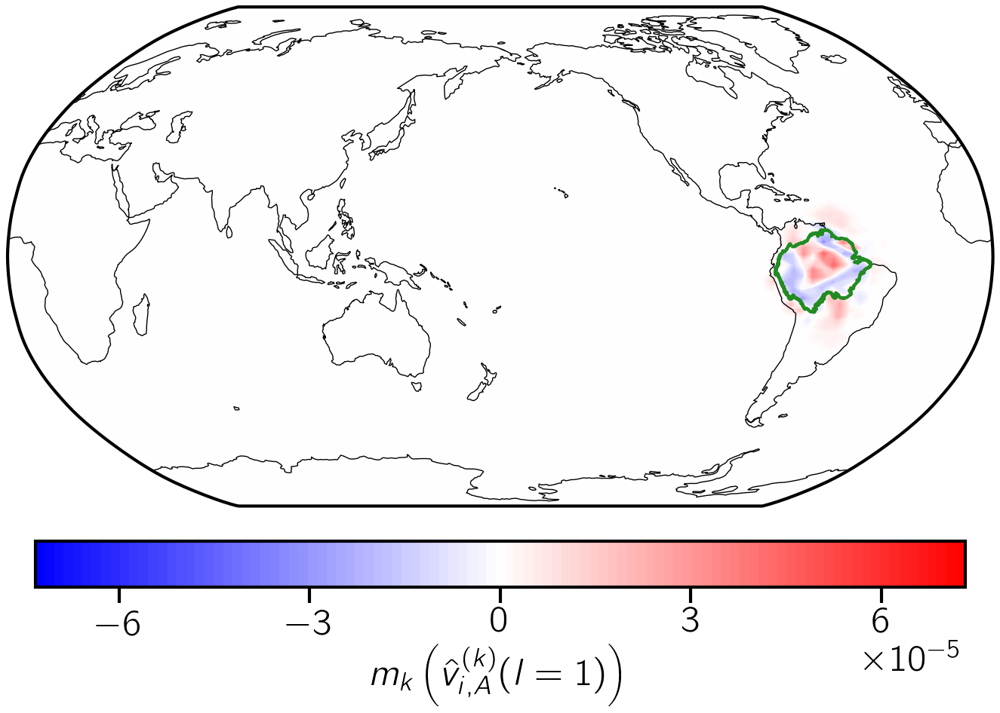

In [ ]:
for walk_length in range(1,51):
  visits = np.zeros((len(dates),num_nodes))
  for i in trange(len(dates), leave=False):
    date = dates[i]
    for node in walks_dict[date][:,1:walk_length+1].flatten().astype(int):
      visits[i,node] += 1

  visits_trend = np.zeros((num_nodes,1))
  for node in trange(num_nodes, leave=False):
    slope, _ = np.polyfit(list(range(len(dates))), visits[:,node]/(num_samples*walk_length), 1)
    visits_trend[node] = slope

  fontsize = 36

  plt.rc('text', usetex=True)
  plt.rc('xtick',labelsize=fontsize)
  plt.rc('ytick',labelsize=fontsize)


  # fig, axs = plt.subplots(1,1,sharex=True,figsize=(20,10))
  fig = plt.figure(figsize=(16,8))



  # latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  ilat, ilon, idat = interpolate_scatter_data(latlon_icos, list(visits_trend[:,0]),
  #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
                      method='linear', num_interp_pts=100, threshold_dateline=5, threshold_poles=15)

  #   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  #   ilat, ilon, idat = interpolate_scatter_data(latlon_icos, R_i_dict_vary_density[density][date],
  # #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
  #                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

  ax = plt.subplot2grid(shape=(1, 1), loc=(0, 0), projection=ccrs.Robinson(central_longitude=180))

  ax.coastlines(zorder=5)

  max_value = max([abs(np.min(visits_trend)), np.max(visits_trend)])
  min_value = -abs(max_value)

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  cmap = mpl.cm.bwr




  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)

  im = ax.contourf(ilon, ilat, idat, levels=levels,
                  cmap=cmap, alpha=1,
                  vmin=min_value, vmax=max_value,
                  transform=ccrs.PlateCarree(), zorder=4)
  for c in im.collections:
      c.set_edgecolor("face")
  im.set_clim(min_value, max_value)


  # ax.set_title(walk_length, fontsize=fontsize)

  plt.setp(ax.spines.values(), linewidth=3, zorder=100)
  ax.tick_params(length=15,width=3)

  # if i == len(dates_to_plot) - 1:
  #   ax.set_title(r'$\rho = {:}$'.format(density), fontsize=fontsize, pad=10)

  plt.tight_layout()
  plt.subplots_adjust(hspace = 0.2, wspace = -0.5)

  cbar = fig.colorbar(im, ax = fig.get_axes(), anchor=(0.5, 0),
                      orientation='horizontal',fraction=0.08, pad=0.06)
  # ticks = [-0.015, 0, 0.015]
  # cbar.set_ticks(ticks)
  # cbar.set_ticklabels(['{:.3f}'.format(ticks[i]) for i in range(len(ticks))],usetex=True)
  tick_locator = mpl.ticker.MaxNLocator(nbins=5)
  cbar.locator = tick_locator
  cbar.update_ticks()


  cbar.set_label(r'$m_k\left(\hat{v}_{i,A}^{(k)}(l='+str(walk_length)+r')\right)$',fontsize=fontsize, usetex=True)


  cbar.outline.set_linewidth(3)
  cbar.ax.tick_params(length=15,width=3)

  title = 'Random Walk Trend, l={:}'.format(walk_length)
  plt.savefig(fig_vary_walk_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
  plt.savefig(fig_vary_walk_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)
  plt.show()
  plt.close(fig)

In [ ]:
for walk_length in range(1,51):
  visits = np.zeros((len(dates),num_nodes))
  for i in trange(len(dates), leave=False):
    date = dates[i]
    for node in walks_dict[date][:,walk_length].flatten().astype(int):
      visits[i,node] += 1

  visits_trend = np.zeros((num_nodes,1))
  for node in trange(num_nodes, leave=False):
    slope, _ = np.polyfit(list(range(len(dates))), visits[:,node]/(num_samples*walk_length), 1)
    visits_trend[node] = slope

  fontsize = 36

  plt.rc('text', usetex=True)
  plt.rc('xtick',labelsize=fontsize)
  plt.rc('ytick',labelsize=fontsize)


  # fig, axs = plt.subplots(1,1,sharex=True,figsize=(20,10))
  fig = plt.figure(figsize=(16,8))



  # latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  ilat, ilon, idat = interpolate_scatter_data(latlon_icos, list(visits_trend[:,0]),
  #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
                      method='linear', num_interp_pts=50, threshold_dateline=5, threshold_poles=15)

  #   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  #   ilat, ilon, idat = interpolate_scatter_data(latlon_icos, R_i_dict_vary_density[density][date],
  # #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
  #                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

  ax = plt.subplot2grid(shape=(1, 1), loc=(0, 0), projection=ccrs.Robinson(central_longitude=180))

  ax.coastlines(zorder=5)

  max_value = max([abs(np.min(idat)), np.max(idat)])
  min_value = -abs(max_value)

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  cmap = mpl.cm.bwr




  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)

  im = ax.contourf(ilon, ilat, idat, levels=levels,
                  cmap=cmap, alpha=1,
                  vmin=min_value, vmax=max_value,
                  transform=ccrs.PlateCarree(), zorder=4)
  for c in im.collections:
      c.set_edgecolor("face")
  im.set_clim(min_value, max_value)


  # ax.set_title(walk_length, fontsize=fontsize)

  plt.setp(ax.spines.values(), linewidth=3, zorder=100)
  ax.tick_params(length=15,width=3)

  # if i == len(dates_to_plot) - 1:
  #   ax.set_title(r'$\rho = {:}$'.format(density), fontsize=fontsize, pad=10)

  plt.tight_layout()
  plt.subplots_adjust(hspace = 0.2, wspace = -0.5)

  cbar = fig.colorbar(im, ax = fig.get_axes(), anchor=(0.5, 0),
                      orientation='horizontal',fraction=0.08, pad=0.06)
  # ticks = [-0.015, 0, 0.015]
  # cbar.set_ticks(ticks)
  # cbar.set_ticklabels(['{:.3f}'.format(ticks[i]) for i in range(len(ticks))],usetex=True)
  tick_locator = mpl.ticker.MaxNLocator(nbins=5)
  cbar.locator = tick_locator
  cbar.update_ticks()


  cbar.set_label(r'$m_k\left(\hat{v}_{i,A}^{(k)}(l='+str(walk_length)+r')\right)$',fontsize=fontsize, usetex=True)


  cbar.outline.set_linewidth(3)
  cbar.ax.tick_params(length=15,width=3)

  title = 'Random Walk Trend, l={:}'.format(walk_length)
  # plt.savefig(fig_vary_walk_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
  # plt.savefig(fig_vary_walk_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)
  plt.show()
  plt.close(fig)

In [ ]:
walk_length = 50

visits = np.zeros((len(dates),num_nodes))
for i in trange(len(dates), leave=False):
  date = dates[i]
  for node in walks_dict[date][:,walk_length].flatten().astype(int):
    visits[i,node] += 1

visits_trend = np.zeros((num_nodes,1))
for node in trange(num_nodes, leave=False):
  slope, _ = np.polyfit(list(range(len(dates))), visits[:,node]/(num_samples*walk_length), 1)
  visits_trend[node] = slope

min_value = 0
max_value = np.max(visits)

for i in range(len(dates)):
  date = dates[i]
  fontsize = 36

  plt.rc('text', usetex=True)
  plt.rc('xtick',labelsize=fontsize)
  plt.rc('ytick',labelsize=fontsize)


  # fig, axs = plt.subplots(1,1,sharex=True,figsize=(20,10))
  fig = plt.figure(figsize=(16,8))



  # # latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  # ilat, ilon, idat = interpolate_scatter_data(latlon_icos, list(visits_trend[:,0]),
  # #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
  #                     method='linear', num_interp_pts=100, threshold_dateline=5, threshold_poles=15)

  ax = plt.subplot2grid(shape=(1, 1), loc=(0, 0), projection=ccrs.Robinson(central_longitude=180))

  ax.coastlines(zorder=5)



  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  cmap = mpl.cm.viridis_r




  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)



  ind = np.where(visits[i,:] > 0)[0]

  im = ax.scatter(latlon_icos[ind,1], latlon_icos[ind,0],
                  c=visits[i,:][ind],
                  cmap='plasma_r', transform=ccrs.PlateCarree(), marker='o', s=20,
                  edgecolors=None)
  ax.scatter(latlon_icos[:,1], latlon_icos[:,0],
                  c=visits[i,:][:],
                  cmap='plasma_r', transform=ccrs.PlateCarree(), marker='o', s=0,
                  edgecolors=None, zorder=100, alpha=0)

  # im = ax.scatter(latlon_icos[:,1], latlon_icos[:,0],
  #                 c=visits[i,:],
  #                 cmap='viridis_r', transform=ccrs.PlateCarree(), marker='o', s=20,
  #                 edgecolors=None)

  # im = ax.contourf(ilon, ilat, idat, levels=levels,
  #                 cmap=cmap, alpha=1,
  #                 vmin=min_value, vmax=max_value,
  #                 transform=ccrs.PlateCarree(), zorder=4)
  # for c in im.collections:
  #     c.set_edgecolor("face")

  im.set_clim(min_value, max_value)


  ax.set_title(date, fontsize=fontsize)

  plt.setp(ax.spines.values(), linewidth=3, zorder=100)
  ax.tick_params(length=15,width=3)

  # if i == len(dates_to_plot) - 1:
  #   ax.set_title(r'$\rho = {:}$'.format(density), fontsize=fontsize, pad=10)

  plt.tight_layout()
  plt.subplots_adjust(hspace = 0.2, wspace = -0.5)

  cbar = fig.colorbar(im, ax = fig.get_axes(), anchor=(0.5, 0),
                      orientation='horizontal',fraction=0.08, pad=0.06)
  # ticks = [-0.015, 0, 0.015]
  # cbar.set_ticks(ticks)
  # cbar.set_ticklabels(['{:.3f}'.format(ticks[i]) for i in range(len(ticks))],usetex=True)
  tick_locator = mpl.ticker.MaxNLocator(nbins=5)
  cbar.locator = tick_locator
  cbar.update_ticks()


  cbar.set_label(r'$m_k\left(\hat{v}_{i,A}^{(k)}(l='+str(walk_length)+r')\right)$',fontsize=fontsize, usetex=True)


  cbar.outline.set_linewidth(3)
  cbar.ax.tick_params(length=15,width=3)

  title = 'Random Walk Trend, l={:}'.format(walk_length)
  # plt.savefig(fig_vary_walk_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
  # plt.savefig(fig_vary_walk_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)
  plt.show()
  plt.close(fig)

In [ ]:
walk_length = 50

# visits = np.zeros((len(dates),num_nodes))
# for i in trange(len(dates), leave=False):
#   date = dates[i]
#   for node in walks_dict[date][:,1:walk_length+1].flatten().astype(int):
#     visits[i,node] += 1

# visits_trend = np.zeros((num_nodes,1))
# for node in trange(num_nodes, leave=False):
#   slope, _ = np.polyfit(list(range(len(dates))), visits[:,node]/(num_samples*walk_length), 1)
#   visits_trend[node] = slope

min_value = 0
max_value = np.max(visits)

for i in range(len(dates)):
  date = dates[i]
  fontsize = 36

  plt.rc('text', usetex=True)
  plt.rc('xtick',labelsize=fontsize)
  plt.rc('ytick',labelsize=fontsize)


  # fig, axs = plt.subplots(1,1,sharex=True,figsize=(20,10))
  fig = plt.figure(figsize=(16,8))



  # # latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  # ilat, ilon, idat = interpolate_scatter_data(latlon_icos, list(visits_trend[:,0]),
  # #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
  #                     method='linear', num_interp_pts=100, threshold_dateline=5, threshold_poles=15)

  ax = plt.subplot2grid(shape=(1, 1), loc=(0, 0), projection=ccrs.Robinson(central_longitude=180))

  ax.coastlines(zorder=5)



  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  cmap = mpl.cm.viridis_r




  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)



  ind = np.where(visits[i,:] > 0)[0]

  im = ax.scatter(latlon_icos[ind,1], latlon_icos[ind,0],
                  c=visits[i,:][ind],
                  cmap='plasma_r', transform=ccrs.PlateCarree(), marker='o', s=20,
                  edgecolors=None)
  ax.scatter(latlon_icos[:,1], latlon_icos[:,0],
                  c=visits[i,:][:],
                  cmap='plasma_r', transform=ccrs.PlateCarree(), marker='o', s=0,
                  edgecolors=None, zorder=100, alpha=0)

  # im = ax.scatter(latlon_icos[:,1], latlon_icos[:,0],
  #                 c=visits[i,:],
  #                 cmap='viridis_r', transform=ccrs.PlateCarree(), marker='o', s=20,
  #                 edgecolors=None)

  # im = ax.contourf(ilon, ilat, idat, levels=levels,
  #                 cmap=cmap, alpha=1,
  #                 vmin=min_value, vmax=max_value,
  #                 transform=ccrs.PlateCarree(), zorder=4)
  # for c in im.collections:
  #     c.set_edgecolor("face")

  im.set_clim(min_value, max_value)


  ax.set_title(date, fontsize=fontsize)

  plt.setp(ax.spines.values(), linewidth=3, zorder=100)
  ax.tick_params(length=15,width=3)

  # if i == len(dates_to_plot) - 1:
  #   ax.set_title(r'$\rho = {:}$'.format(density), fontsize=fontsize, pad=10)

  plt.tight_layout()
  plt.subplots_adjust(hspace = 0.2, wspace = -0.5)

  cbar = fig.colorbar(im, ax = fig.get_axes(), anchor=(0.5, 0),
                      orientation='horizontal',fraction=0.08, pad=0.06)
  # ticks = [-0.015, 0, 0.015]
  # cbar.set_ticks(ticks)
  # cbar.set_ticklabels(['{:.3f}'.format(ticks[i]) for i in range(len(ticks))],usetex=True)
  tick_locator = mpl.ticker.MaxNLocator(nbins=5)
  cbar.locator = tick_locator
  cbar.update_ticks()


  cbar.set_label(r'$m_k\left(\hat{v}_{i,A}^{(k)}(l='+str(walk_length)+r')\right)$',fontsize=fontsize, usetex=True)


  cbar.outline.set_linewidth(3)
  cbar.ax.tick_params(length=15,width=3)

  title = 'Random Walk Trend, l={:}'.format(walk_length)
  # plt.savefig(fig_vary_walk_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
  # plt.savefig(fig_vary_walk_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)
  plt.show()
  plt.close(fig)

In [ ]:
walk_length = 30
visits = np.zeros((len(dates),num_nodes))
for i in trange(len(dates)):
  date = dates[i]
  for node in walks_dict[date][:,1:walk_length+1].flatten().astype(int):
    visits[i,node] += 1

  0%|          | 0/51 [00:00<?, ?it/s]

In [ ]:
visits_trend = np.zeros((num_nodes,1))
p_vals = np.zeros((num_nodes,1))
for node in trange(num_nodes):
  slope, intercept, r_value, p_value, std_err = sp.stats.linregress(np.arange(len(dates)), visits[:,node]/(num_samples*walk_length))
  visits_trend[node] = slope
  p_vals[node] = p_value

  0%|          | 0/10242 [00:00<?, ?it/s]

In [ ]:
print(list(visits_trend[:,0]))

[0.0, 0.0, 0.0, 3.3182503770739063e-09, 6.636500754147813e-09, 2.8054298642533938e-08, 7.722473604826546e-08, 1.273001508295626e-07, 5.942684766214177e-08, 1.4630467571644042e-07, -1.809954751131225e-09, 1.1282051282051285e-07, 5.97285067873303e-08, 9.049773755656262e-10, -2.0814479638009053e-08, -6.847662141779784e-08, -1.396681749622926e-07, -1.595776772247361e-07, -1.571644042232278e-07, -2.0904977375565623e-07, -3.499245852187029e-07, -2.9502262443438914e-07, -4.096530920060331e-07, -1.9547511312217196e-07, -2.0482654600301655e-07, -9.864253393665158e-08, -1.79788838612368e-07, -9.472096530920055e-08, -2.7752639517345408e-08, 9.803921568627448e-08, 1.1523378582202115e-07, 1.1523378582202118e-07, 1.0407239819004527e-07, 8.989441930618397e-08, 1.3152337858220214e-07, 6.365007541478129e-08, 2.7450980392156868e-08, 2.3529411764705888e-08, 2.0512820512820512e-08, 2.4736048265460026e-08, 1.8702865761689284e-08, 4.2835595776772246e-08, -6.033182503770728e-10, -3.92156862745098e-09, 2.9260

In [ ]:
fig_walk_dir = fig_dir + 'Random Walks/'
if not os.path.isdir(fig_walk_dir):
  os.mkdir(fig_walk_dir)

fig_vary_walk_dir = fig_walk_dir + 'Vary Walk Lenght/'
if not os.path.isdir(fig_vary_walk_dir):
  os.mkdir(fig_vary_walk_dir)

In [ ]:
for walk_length in range(1,50):
  visits = np.zeros((len(dates),num_nodes))
  for i in trange(len(dates), leave=False):
    date = dates[i]
    for node in walks_dict[date][:,1:walk_length+1].flatten().astype(int):
      visits[i,node] += 1

  visits_trend = np.zeros((num_nodes,1))
  p_vals = np.zeros((num_nodes,1))
  for node in trange(num_nodes, leave=False):
    slope, intercept, r_value, p_value, std_err = sp.stats.linregress(np.arange(len(dates)), visits[:,node]/(num_samples*walk_length))
    visits_trend[node] = slope
    p_vals[node] = p_value

  fontsize = 36

  plt.rc('text', usetex=True)
  plt.rc('xtick',labelsize=fontsize)
  plt.rc('ytick',labelsize=fontsize)


  # fig, axs = plt.subplots(1,1,sharex=True,figsize=(20,10))
  fig = plt.figure(figsize=(16,8))



  # latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  ilat, ilon, idat = interpolate_scatter_data(latlon_icos, list(visits_trend[:,0]),
  #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
                      method='linear', num_interp_pts=100, threshold_dateline=5, threshold_poles=15)

  #   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
  #   ilat, ilon, idat = interpolate_scatter_data(latlon_icos, R_i_dict_vary_density[density][date],
  # #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
  #                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

  ax = plt.subplot2grid(shape=(1, 1), loc=(0, 0), projection=ccrs.Robinson(central_longitude=180))

  ax.coastlines(zorder=5)

  max_value = max([abs(np.min(visits_trend)), np.max(visits_trend)])
  min_value = -abs(max_value)

  levels = np.linspace(min_value,max_value,100)
  ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

  cmap = mpl.cm.bwr




  reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
  amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
  ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)

  im = ax.contourf(ilon, ilat, idat, levels=levels,
                  cmap=cmap, alpha=1,
                  vmin=min_value, vmax=max_value,
                  transform=ccrs.PlateCarree(), zorder=4)
  for c in im.collections:
      c.set_edgecolor("face")
  im.set_clim(min_value, max_value)


  # ax.set_title(walk_length, fontsize=fontsize)

  plt.setp(ax.spines.values(), linewidth=3, zorder=100)
  ax.tick_params(length=15,width=3)

  # if i == len(dates_to_plot) - 1:
  #   ax.set_title(r'$\rho = {:}$'.format(density), fontsize=fontsize, pad=10)

  plt.tight_layout()
  plt.subplots_adjust(hspace = 0.2, wspace = -0.5)

  cbar = fig.colorbar(im, ax = fig.get_axes(), anchor=(0.5, 0),
                      orientation='horizontal',fraction=0.08, pad=0.06)
  # ticks = [-0.015, 0, 0.015]
  # cbar.set_ticks(ticks)
  # cbar.set_ticklabels(['{:.3f}'.format(ticks[i]) for i in range(len(ticks))],usetex=True)
  tick_locator = mpl.ticker.MaxNLocator(nbins=5)
  cbar.locator = tick_locator
  cbar.update_ticks()


  cbar.set_label(r'$m_k\left(\hat{v}_{i,A}^{(k)}(l='+str(walk_length)+r')\right)$',fontsize=fontsize, usetex=True)


  cbar.outline.set_linewidth(3)
  cbar.ax.tick_params(length=15,width=3)

  title = 'Random Walk Trend, l={:}'.format(walk_length)
  plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
  plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)
  plt.show()
  plt.close(fig)

Replacing Dateline:   0%|          | 0/400 [00:00<?, ?it/s]

Replacing Poles:   0%|          | 0/1800 [00:00<?, ?it/s]

Replacing NaNs: 0it [00:00, ?it/s]

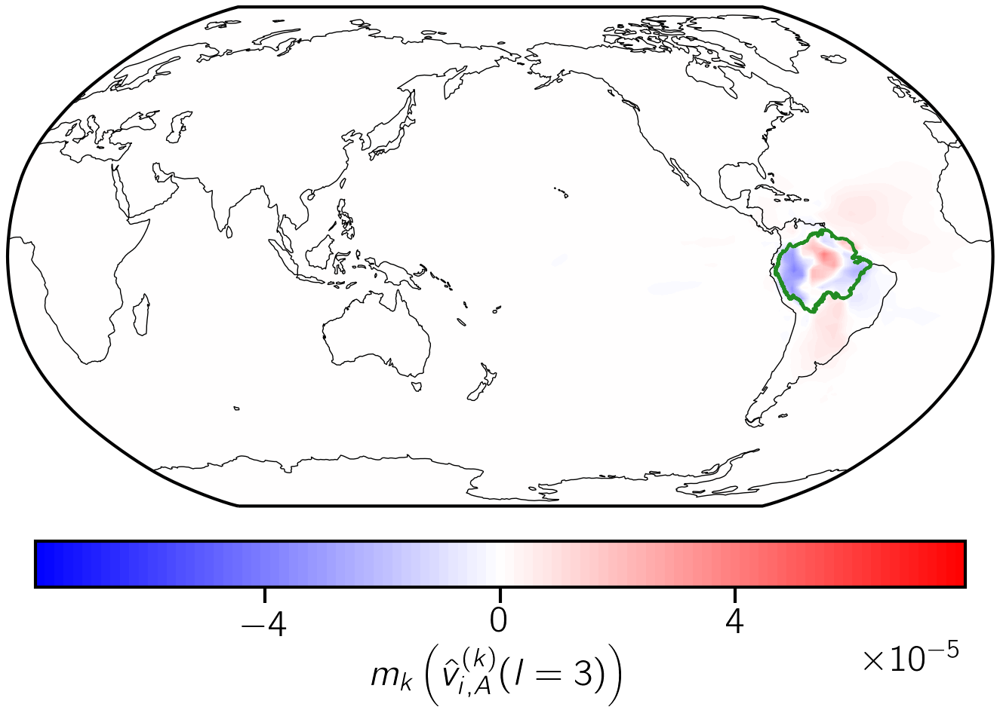

In [ ]:
fontsize = 36

plt.rc('text', usetex=True)
plt.rc('xtick',labelsize=fontsize)
plt.rc('ytick',labelsize=fontsize)


# fig, axs = plt.subplots(1,1,sharex=True,figsize=(20,10))
fig = plt.figure(figsize=(16,8))



# latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
ilat, ilon, idat = interpolate_scatter_data(latlon_icos, list(visits_trend[:,0]),
#                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
                    method='linear', num_interp_pts=100, threshold_dateline=5, threshold_poles=15)

#   latlon_icos = np.hstack((finallats_dict[date],finallons_dict[date]))
#   ilat, ilon, idat = interpolate_scatter_data(latlon_icos, R_i_dict_vary_density[density][date],
# #                      shape_filename=base_dir+'/Amazon Biome/amazonia.shp',
#                      method='linear', num_interp_pts=200, threshold_dateline=5, threshold_poles=15)

ax = plt.subplot2grid(shape=(1, 1), loc=(0, 0), projection=ccrs.Robinson(central_longitude=180))

ax.coastlines(zorder=5)

max_value = max([abs(np.min(visits_trend)), np.max(visits_trend)])
min_value = -abs(max_value)

levels = np.linspace(min_value,max_value,100)
ticks = [(levels[i]+levels[i+1])/2 for i in range(len(levels)-1)]

cmap = mpl.cm.bwr




reader = shpreader.Reader(base_dir+'/Amazon Biome/amazonia.shp')
amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())
ax.add_feature(amazon, facecolor='none', edgecolor='forestgreen', alpha=1, linewidth=3, zorder=6)

im = ax.contourf(ilon, ilat, idat, levels=levels,
                cmap=cmap, alpha=1,
                vmin=min_value, vmax=max_value,
                transform=ccrs.PlateCarree(), zorder=4)
for c in im.collections:
    c.set_edgecolor("face")
im.set_clim(min_value, max_value)


# ax.set_title(title, fontsize=fontsize)

plt.setp(ax.spines.values(), linewidth=3, zorder=100)
ax.tick_params(length=15,width=3)

# if i == len(dates_to_plot) - 1:
#   ax.set_title(r'$\rho = {:}$'.format(density), fontsize=fontsize, pad=10)

plt.tight_layout()
plt.subplots_adjust(hspace = 0.2, wspace = -0.5)

cbar = fig.colorbar(im, ax = fig.get_axes(), anchor=(0.5, 0),
                    orientation='horizontal',fraction=0.08, pad=0.06)
# ticks = [-0.015, 0, 0.015]
# cbar.set_ticks(ticks)
# cbar.set_ticklabels(['{:.3f}'.format(ticks[i]) for i in range(len(ticks))],usetex=True)
tick_locator = mpl.ticker.MaxNLocator(nbins=5)
cbar.locator = tick_locator
cbar.update_ticks()


cbar.set_label(r'$m_k\left(\hat{v}_{i,A}^{(k)}(l=3)\right)$',fontsize=fontsize, usetex=True)


cbar.outline.set_linewidth(3)
cbar.ax.tick_params(length=15,width=3)

title = 'Amazon Connectivity Trend, rho={:}'.format(density)
# plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
# plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)
plt.show()
plt.close(fig)

In [ ]:
a = [len(np.where(walks_dict[dates[0]][:,1:31] == i)[0]) for i in range(num_nodes)]

In [ ]:
print(a, sum(a))

[0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 6, 4, 3, 4, 3, 8, 7, 2, 2, 1, 3, 1, 11, 7, 9, 7, 3, 10, 12, 18, 17, 11, 6, 10, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 0, 4, 0, 2, 1, 2, 0, 8, 0, 3, 0, 5, 0, 5, 0, 2, 0, 11, 1, 3, 1, 14, 11, 6, 0, 5, 0, 5, 0, 2, 0, 4, 0, 15, 20, 6, 1, 7, 0, 11, 0, 2, 0, 2, 0, 0, 0, 3, 0, 0, 0, 6, 0, 0, 0, 5, 0, 7, 1, 8, 0, 1, 0, 0, 0, 2, 0, 5, 0, 5, 0, 9, 0, 5, 1, 2, 0, 6, 4, 4, 0, 11, 0, 8, 0, 6, 0, 7, 11, 3, 0, 5, 0, 4, 0, 12, 12, 0, 4, 1, 0, 0, 2, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 2, 0, 0, 0, 0, 0, 1, 0, 2, 0, 1, 1, 1, 0, 3, 0, 3, 0, 11, 9, 5, 0, 12, 11, 5, 0, 5, 1, 4, 0, 10, 0, 9, 1, 4, 0, 2, 1, 5, 0, 4, 0, 1, 0, 3, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 2, 1, 1, 0, 0, 0, 0, 0, 0, 0, 4, 0, 3, 0, 0, 0, 12, 1, 2, 0, 11, 0, 1, 0, 3, 1, 0, 0, 15, 1, 3, 0, 3, 8, 1, 6, 0, 4, 0, 4, 0, 2, 0, 3, 0, 1, 0, 0, 0, 0, 0, 1, 1, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 2, 0, 1, 0, 1, 0, 2, 0, 2, 0, 3, 0, 3, 1, 0, 0, 9, 0, 3, 0, 4, 1, 1, 0, 

In [ ]:
# Count percentage that remains in amazon (figure out correct length to use)
for date in dates:
  a = walks_dict[date][:,1:].flatten()
  print(date, sum([1 if a[i] in amazon_nodes else 0 for i in range(len(a))])/len(a))

In [ ]:
# Count percentage that remains in amazon (figure out correct length to use)
for date in dates:
  a = walks_dict[date][:,1:].flatten()
  print(date, sum([1 if a[i] in amazon_nodes else 0 for i in range(len(a))])/len(a))

In [ ]:
lengths = np.arange(1,15)

percentage_within_amazon_dict = {}
for length in tqdm(lengths):
  walks_dict = random_walks_all_networks(amazon_nodes, graph_dir, num_samples=10000, length=length, max_tries=10)

  percentage_within_amazon_dict[length] = []
  for date in dates:
    a = walks_dict[date][:,1:].flatten()
    percentage_within_amazon_dict[length].append(sum([1 if a[i] in amazon_nodes else 0 for i in range(len(a))])/len(a))

  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

1948-1973:   0%|          | 0/10000 [00:00<?, ?it/s]

1949-1974:   0%|          | 0/10000 [00:00<?, ?it/s]

1950-1975:   0%|          | 0/10000 [00:00<?, ?it/s]

1951-1976:   0%|          | 0/10000 [00:00<?, ?it/s]

1952-1977:   0%|          | 0/10000 [00:00<?, ?it/s]

1953-1978:   0%|          | 0/10000 [00:00<?, ?it/s]

1954-1979:   0%|          | 0/10000 [00:00<?, ?it/s]

1955-1980:   0%|          | 0/10000 [00:00<?, ?it/s]

1956-1981:   0%|          | 0/10000 [00:00<?, ?it/s]

1957-1982:   0%|          | 0/10000 [00:00<?, ?it/s]

1958-1983:   0%|          | 0/10000 [00:00<?, ?it/s]

1959-1984:   0%|          | 0/10000 [00:00<?, ?it/s]

1960-1985:   0%|          | 0/10000 [00:00<?, ?it/s]

1961-1986:   0%|          | 0/10000 [00:00<?, ?it/s]

1962-1987:   0%|          | 0/10000 [00:00<?, ?it/s]

1963-1988:   0%|          | 0/10000 [00:00<?, ?it/s]

1964-1989:   0%|          | 0/10000 [00:00<?, ?it/s]

1965-1990:   0%|          | 0/10000 [00:00<?, ?it/s]

1966-1991:   0%|          | 0/10000 [00:00<?, ?it/s]

1967-1992:   0%|          | 0/10000 [00:00<?, ?it/s]

1968-1993:   0%|          | 0/10000 [00:00<?, ?it/s]

1969-1994:   0%|          | 0/10000 [00:00<?, ?it/s]

1970-1995:   0%|          | 0/10000 [00:00<?, ?it/s]

1971-1996:   0%|          | 0/10000 [00:00<?, ?it/s]

1972-1997:   0%|          | 0/10000 [00:00<?, ?it/s]

1973-1998:   0%|          | 0/10000 [00:00<?, ?it/s]

1974-1999:   0%|          | 0/10000 [00:00<?, ?it/s]

1975-2000:   0%|          | 0/10000 [00:00<?, ?it/s]

1976-2001:   0%|          | 0/10000 [00:00<?, ?it/s]

1977-2002:   0%|          | 0/10000 [00:00<?, ?it/s]

1978-2003:   0%|          | 0/10000 [00:00<?, ?it/s]

1979-2004:   0%|          | 0/10000 [00:00<?, ?it/s]

1980-2005:   0%|          | 0/10000 [00:00<?, ?it/s]

1981-2006:   0%|          | 0/10000 [00:00<?, ?it/s]

1982-2007:   0%|          | 0/10000 [00:00<?, ?it/s]

1983-2008:   0%|          | 0/10000 [00:00<?, ?it/s]

1984-2009:   0%|          | 0/10000 [00:00<?, ?it/s]

1985-2010:   0%|          | 0/10000 [00:00<?, ?it/s]

1986-2011:   0%|          | 0/10000 [00:00<?, ?it/s]

1987-2012:   0%|          | 0/10000 [00:00<?, ?it/s]

1988-2013:   0%|          | 0/10000 [00:00<?, ?it/s]

1989-2014:   0%|          | 0/10000 [00:00<?, ?it/s]

1990-2015:   0%|          | 0/10000 [00:00<?, ?it/s]

1991-2016:   0%|          | 0/10000 [00:00<?, ?it/s]

1992-2017:   0%|          | 0/10000 [00:00<?, ?it/s]

1993-2018:   0%|          | 0/10000 [00:00<?, ?it/s]

1994-2019:   0%|          | 0/10000 [00:00<?, ?it/s]

1995-2020:   0%|          | 0/10000 [00:00<?, ?it/s]

1996-2021:   0%|          | 0/10000 [00:00<?, ?it/s]

1997-2022:   0%|          | 0/10000 [00:00<?, ?it/s]

1998-2023:   0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

1948-1973:   0%|          | 0/10000 [00:00<?, ?it/s]

1949-1974:   0%|          | 0/10000 [00:00<?, ?it/s]

1950-1975:   0%|          | 0/10000 [00:00<?, ?it/s]

1951-1976:   0%|          | 0/10000 [00:00<?, ?it/s]

1952-1977:   0%|          | 0/10000 [00:00<?, ?it/s]

1953-1978:   0%|          | 0/10000 [00:00<?, ?it/s]

1954-1979:   0%|          | 0/10000 [00:00<?, ?it/s]

1955-1980:   0%|          | 0/10000 [00:00<?, ?it/s]

1956-1981:   0%|          | 0/10000 [00:00<?, ?it/s]

1957-1982:   0%|          | 0/10000 [00:00<?, ?it/s]

1958-1983:   0%|          | 0/10000 [00:00<?, ?it/s]

1959-1984:   0%|          | 0/10000 [00:00<?, ?it/s]

1960-1985:   0%|          | 0/10000 [00:00<?, ?it/s]

1961-1986:   0%|          | 0/10000 [00:00<?, ?it/s]

1962-1987:   0%|          | 0/10000 [00:00<?, ?it/s]

1963-1988:   0%|          | 0/10000 [00:00<?, ?it/s]

1964-1989:   0%|          | 0/10000 [00:00<?, ?it/s]

1965-1990:   0%|          | 0/10000 [00:00<?, ?it/s]

1966-1991:   0%|          | 0/10000 [00:00<?, ?it/s]

1967-1992:   0%|          | 0/10000 [00:00<?, ?it/s]

1968-1993:   0%|          | 0/10000 [00:00<?, ?it/s]

1969-1994:   0%|          | 0/10000 [00:00<?, ?it/s]

1970-1995:   0%|          | 0/10000 [00:00<?, ?it/s]

1971-1996:   0%|          | 0/10000 [00:00<?, ?it/s]

1972-1997:   0%|          | 0/10000 [00:00<?, ?it/s]

1973-1998:   0%|          | 0/10000 [00:00<?, ?it/s]

1974-1999:   0%|          | 0/10000 [00:00<?, ?it/s]

1975-2000:   0%|          | 0/10000 [00:00<?, ?it/s]

1976-2001:   0%|          | 0/10000 [00:00<?, ?it/s]

1977-2002:   0%|          | 0/10000 [00:00<?, ?it/s]

1978-2003:   0%|          | 0/10000 [00:00<?, ?it/s]

1979-2004:   0%|          | 0/10000 [00:00<?, ?it/s]

1980-2005:   0%|          | 0/10000 [00:00<?, ?it/s]

1981-2006:   0%|          | 0/10000 [00:00<?, ?it/s]

1982-2007:   0%|          | 0/10000 [00:00<?, ?it/s]

1983-2008:   0%|          | 0/10000 [00:00<?, ?it/s]

1984-2009:   0%|          | 0/10000 [00:00<?, ?it/s]

1985-2010:   0%|          | 0/10000 [00:00<?, ?it/s]

1986-2011:   0%|          | 0/10000 [00:00<?, ?it/s]

1987-2012:   0%|          | 0/10000 [00:00<?, ?it/s]

1988-2013:   0%|          | 0/10000 [00:00<?, ?it/s]

1989-2014:   0%|          | 0/10000 [00:00<?, ?it/s]

1990-2015:   0%|          | 0/10000 [00:00<?, ?it/s]

1991-2016:   0%|          | 0/10000 [00:00<?, ?it/s]

1992-2017:   0%|          | 0/10000 [00:00<?, ?it/s]

1993-2018:   0%|          | 0/10000 [00:00<?, ?it/s]

1994-2019:   0%|          | 0/10000 [00:00<?, ?it/s]

1995-2020:   0%|          | 0/10000 [00:00<?, ?it/s]

1996-2021:   0%|          | 0/10000 [00:00<?, ?it/s]

1997-2022:   0%|          | 0/10000 [00:00<?, ?it/s]

1998-2023:   0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

1948-1973:   0%|          | 0/10000 [00:00<?, ?it/s]

1949-1974:   0%|          | 0/10000 [00:00<?, ?it/s]

1950-1975:   0%|          | 0/10000 [00:00<?, ?it/s]

1951-1976:   0%|          | 0/10000 [00:00<?, ?it/s]

1952-1977:   0%|          | 0/10000 [00:00<?, ?it/s]

1953-1978:   0%|          | 0/10000 [00:00<?, ?it/s]

1954-1979:   0%|          | 0/10000 [00:00<?, ?it/s]

1955-1980:   0%|          | 0/10000 [00:00<?, ?it/s]

1956-1981:   0%|          | 0/10000 [00:00<?, ?it/s]

1957-1982:   0%|          | 0/10000 [00:00<?, ?it/s]

1958-1983:   0%|          | 0/10000 [00:00<?, ?it/s]

1959-1984:   0%|          | 0/10000 [00:00<?, ?it/s]

1960-1985:   0%|          | 0/10000 [00:00<?, ?it/s]

1961-1986:   0%|          | 0/10000 [00:00<?, ?it/s]

1962-1987:   0%|          | 0/10000 [00:00<?, ?it/s]

1963-1988:   0%|          | 0/10000 [00:00<?, ?it/s]

1964-1989:   0%|          | 0/10000 [00:00<?, ?it/s]

1965-1990:   0%|          | 0/10000 [00:00<?, ?it/s]

1966-1991:   0%|          | 0/10000 [00:00<?, ?it/s]

1967-1992:   0%|          | 0/10000 [00:00<?, ?it/s]

1968-1993:   0%|          | 0/10000 [00:00<?, ?it/s]

1969-1994:   0%|          | 0/10000 [00:00<?, ?it/s]

1970-1995:   0%|          | 0/10000 [00:00<?, ?it/s]

1971-1996:   0%|          | 0/10000 [00:00<?, ?it/s]

1972-1997:   0%|          | 0/10000 [00:00<?, ?it/s]

1973-1998:   0%|          | 0/10000 [00:00<?, ?it/s]

1974-1999:   0%|          | 0/10000 [00:00<?, ?it/s]

1975-2000:   0%|          | 0/10000 [00:00<?, ?it/s]

1976-2001:   0%|          | 0/10000 [00:00<?, ?it/s]

1977-2002:   0%|          | 0/10000 [00:00<?, ?it/s]

1978-2003:   0%|          | 0/10000 [00:00<?, ?it/s]

1979-2004:   0%|          | 0/10000 [00:00<?, ?it/s]

1980-2005:   0%|          | 0/10000 [00:00<?, ?it/s]

1981-2006:   0%|          | 0/10000 [00:00<?, ?it/s]

1982-2007:   0%|          | 0/10000 [00:00<?, ?it/s]

1983-2008:   0%|          | 0/10000 [00:00<?, ?it/s]

1984-2009:   0%|          | 0/10000 [00:00<?, ?it/s]

1985-2010:   0%|          | 0/10000 [00:00<?, ?it/s]

1986-2011:   0%|          | 0/10000 [00:00<?, ?it/s]

1987-2012:   0%|          | 0/10000 [00:00<?, ?it/s]

1988-2013:   0%|          | 0/10000 [00:00<?, ?it/s]

1989-2014:   0%|          | 0/10000 [00:00<?, ?it/s]

1990-2015:   0%|          | 0/10000 [00:00<?, ?it/s]

1991-2016:   0%|          | 0/10000 [00:00<?, ?it/s]

1992-2017:   0%|          | 0/10000 [00:00<?, ?it/s]

1993-2018:   0%|          | 0/10000 [00:00<?, ?it/s]

1994-2019:   0%|          | 0/10000 [00:00<?, ?it/s]

1995-2020:   0%|          | 0/10000 [00:00<?, ?it/s]

1996-2021:   0%|          | 0/10000 [00:00<?, ?it/s]

1997-2022:   0%|          | 0/10000 [00:00<?, ?it/s]

1998-2023:   0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

1948-1973:   0%|          | 0/10000 [00:00<?, ?it/s]

1949-1974:   0%|          | 0/10000 [00:00<?, ?it/s]

1950-1975:   0%|          | 0/10000 [00:00<?, ?it/s]

1951-1976:   0%|          | 0/10000 [00:00<?, ?it/s]

1952-1977:   0%|          | 0/10000 [00:00<?, ?it/s]

1953-1978:   0%|          | 0/10000 [00:00<?, ?it/s]

1954-1979:   0%|          | 0/10000 [00:00<?, ?it/s]

1955-1980:   0%|          | 0/10000 [00:00<?, ?it/s]

1956-1981:   0%|          | 0/10000 [00:00<?, ?it/s]

1957-1982:   0%|          | 0/10000 [00:00<?, ?it/s]

1958-1983:   0%|          | 0/10000 [00:00<?, ?it/s]

1959-1984:   0%|          | 0/10000 [00:00<?, ?it/s]

1960-1985:   0%|          | 0/10000 [00:00<?, ?it/s]

1961-1986:   0%|          | 0/10000 [00:00<?, ?it/s]

1962-1987:   0%|          | 0/10000 [00:00<?, ?it/s]

1963-1988:   0%|          | 0/10000 [00:00<?, ?it/s]

1964-1989:   0%|          | 0/10000 [00:00<?, ?it/s]

1965-1990:   0%|          | 0/10000 [00:00<?, ?it/s]

1966-1991:   0%|          | 0/10000 [00:00<?, ?it/s]

1967-1992:   0%|          | 0/10000 [00:00<?, ?it/s]

1968-1993:   0%|          | 0/10000 [00:00<?, ?it/s]

1969-1994:   0%|          | 0/10000 [00:00<?, ?it/s]

1970-1995:   0%|          | 0/10000 [00:00<?, ?it/s]

1971-1996:   0%|          | 0/10000 [00:00<?, ?it/s]

1972-1997:   0%|          | 0/10000 [00:00<?, ?it/s]

1973-1998:   0%|          | 0/10000 [00:00<?, ?it/s]

1974-1999:   0%|          | 0/10000 [00:00<?, ?it/s]

1975-2000:   0%|          | 0/10000 [00:00<?, ?it/s]

1976-2001:   0%|          | 0/10000 [00:00<?, ?it/s]

1977-2002:   0%|          | 0/10000 [00:00<?, ?it/s]

1978-2003:   0%|          | 0/10000 [00:00<?, ?it/s]

1979-2004:   0%|          | 0/10000 [00:00<?, ?it/s]

1980-2005:   0%|          | 0/10000 [00:00<?, ?it/s]

1981-2006:   0%|          | 0/10000 [00:00<?, ?it/s]

1982-2007:   0%|          | 0/10000 [00:00<?, ?it/s]

1983-2008:   0%|          | 0/10000 [00:00<?, ?it/s]

1984-2009:   0%|          | 0/10000 [00:00<?, ?it/s]

1985-2010:   0%|          | 0/10000 [00:00<?, ?it/s]

1986-2011:   0%|          | 0/10000 [00:00<?, ?it/s]

1987-2012:   0%|          | 0/10000 [00:00<?, ?it/s]

1988-2013:   0%|          | 0/10000 [00:00<?, ?it/s]

1989-2014:   0%|          | 0/10000 [00:00<?, ?it/s]

1990-2015:   0%|          | 0/10000 [00:00<?, ?it/s]

1991-2016:   0%|          | 0/10000 [00:00<?, ?it/s]

1992-2017:   0%|          | 0/10000 [00:00<?, ?it/s]

1993-2018:   0%|          | 0/10000 [00:00<?, ?it/s]

1994-2019:   0%|          | 0/10000 [00:00<?, ?it/s]

1995-2020:   0%|          | 0/10000 [00:00<?, ?it/s]

1996-2021:   0%|          | 0/10000 [00:00<?, ?it/s]

1997-2022:   0%|          | 0/10000 [00:00<?, ?it/s]

1998-2023:   0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

1948-1973:   0%|          | 0/10000 [00:00<?, ?it/s]

1949-1974:   0%|          | 0/10000 [00:00<?, ?it/s]

1950-1975:   0%|          | 0/10000 [00:00<?, ?it/s]

1951-1976:   0%|          | 0/10000 [00:00<?, ?it/s]

1952-1977:   0%|          | 0/10000 [00:00<?, ?it/s]

1953-1978:   0%|          | 0/10000 [00:00<?, ?it/s]

1954-1979:   0%|          | 0/10000 [00:00<?, ?it/s]

1955-1980:   0%|          | 0/10000 [00:00<?, ?it/s]

1956-1981:   0%|          | 0/10000 [00:00<?, ?it/s]

1957-1982:   0%|          | 0/10000 [00:00<?, ?it/s]

1958-1983:   0%|          | 0/10000 [00:00<?, ?it/s]

1959-1984:   0%|          | 0/10000 [00:00<?, ?it/s]

1960-1985:   0%|          | 0/10000 [00:00<?, ?it/s]

1961-1986:   0%|          | 0/10000 [00:00<?, ?it/s]

1962-1987:   0%|          | 0/10000 [00:00<?, ?it/s]

1963-1988:   0%|          | 0/10000 [00:00<?, ?it/s]

1964-1989:   0%|          | 0/10000 [00:00<?, ?it/s]

1965-1990:   0%|          | 0/10000 [00:00<?, ?it/s]

1966-1991:   0%|          | 0/10000 [00:00<?, ?it/s]

1967-1992:   0%|          | 0/10000 [00:00<?, ?it/s]

1968-1993:   0%|          | 0/10000 [00:00<?, ?it/s]

1969-1994:   0%|          | 0/10000 [00:00<?, ?it/s]

1970-1995:   0%|          | 0/10000 [00:00<?, ?it/s]

1971-1996:   0%|          | 0/10000 [00:00<?, ?it/s]

1972-1997:   0%|          | 0/10000 [00:00<?, ?it/s]

1973-1998:   0%|          | 0/10000 [00:00<?, ?it/s]

1974-1999:   0%|          | 0/10000 [00:00<?, ?it/s]

1975-2000:   0%|          | 0/10000 [00:00<?, ?it/s]

1976-2001:   0%|          | 0/10000 [00:00<?, ?it/s]

1977-2002:   0%|          | 0/10000 [00:00<?, ?it/s]

1978-2003:   0%|          | 0/10000 [00:00<?, ?it/s]

1979-2004:   0%|          | 0/10000 [00:00<?, ?it/s]

1980-2005:   0%|          | 0/10000 [00:00<?, ?it/s]

1981-2006:   0%|          | 0/10000 [00:00<?, ?it/s]

1982-2007:   0%|          | 0/10000 [00:00<?, ?it/s]

1983-2008:   0%|          | 0/10000 [00:00<?, ?it/s]

1984-2009:   0%|          | 0/10000 [00:00<?, ?it/s]

1985-2010:   0%|          | 0/10000 [00:00<?, ?it/s]

1986-2011:   0%|          | 0/10000 [00:00<?, ?it/s]

1987-2012:   0%|          | 0/10000 [00:00<?, ?it/s]

1988-2013:   0%|          | 0/10000 [00:00<?, ?it/s]

1989-2014:   0%|          | 0/10000 [00:00<?, ?it/s]

1990-2015:   0%|          | 0/10000 [00:00<?, ?it/s]

1991-2016:   0%|          | 0/10000 [00:00<?, ?it/s]

1992-2017:   0%|          | 0/10000 [00:00<?, ?it/s]

1993-2018:   0%|          | 0/10000 [00:00<?, ?it/s]

1994-2019:   0%|          | 0/10000 [00:00<?, ?it/s]

1995-2020:   0%|          | 0/10000 [00:00<?, ?it/s]

1996-2021:   0%|          | 0/10000 [00:00<?, ?it/s]

1997-2022:   0%|          | 0/10000 [00:00<?, ?it/s]

1998-2023:   0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

1948-1973:   0%|          | 0/10000 [00:00<?, ?it/s]

1949-1974:   0%|          | 0/10000 [00:00<?, ?it/s]

1950-1975:   0%|          | 0/10000 [00:00<?, ?it/s]

1951-1976:   0%|          | 0/10000 [00:00<?, ?it/s]

1952-1977:   0%|          | 0/10000 [00:00<?, ?it/s]

1953-1978:   0%|          | 0/10000 [00:00<?, ?it/s]

1954-1979:   0%|          | 0/10000 [00:00<?, ?it/s]

1955-1980:   0%|          | 0/10000 [00:00<?, ?it/s]

1956-1981:   0%|          | 0/10000 [00:00<?, ?it/s]

1957-1982:   0%|          | 0/10000 [00:00<?, ?it/s]

1958-1983:   0%|          | 0/10000 [00:00<?, ?it/s]

1959-1984:   0%|          | 0/10000 [00:00<?, ?it/s]

1960-1985:   0%|          | 0/10000 [00:00<?, ?it/s]

1961-1986:   0%|          | 0/10000 [00:00<?, ?it/s]

1962-1987:   0%|          | 0/10000 [00:00<?, ?it/s]

1963-1988:   0%|          | 0/10000 [00:00<?, ?it/s]

1964-1989:   0%|          | 0/10000 [00:00<?, ?it/s]

1965-1990:   0%|          | 0/10000 [00:00<?, ?it/s]

1966-1991:   0%|          | 0/10000 [00:00<?, ?it/s]

1967-1992:   0%|          | 0/10000 [00:00<?, ?it/s]

1968-1993:   0%|          | 0/10000 [00:00<?, ?it/s]

1969-1994:   0%|          | 0/10000 [00:00<?, ?it/s]

1970-1995:   0%|          | 0/10000 [00:00<?, ?it/s]

1971-1996:   0%|          | 0/10000 [00:00<?, ?it/s]

1972-1997:   0%|          | 0/10000 [00:00<?, ?it/s]

1973-1998:   0%|          | 0/10000 [00:00<?, ?it/s]

1974-1999:   0%|          | 0/10000 [00:00<?, ?it/s]

1975-2000:   0%|          | 0/10000 [00:00<?, ?it/s]

1976-2001:   0%|          | 0/10000 [00:00<?, ?it/s]

1977-2002:   0%|          | 0/10000 [00:00<?, ?it/s]

1978-2003:   0%|          | 0/10000 [00:00<?, ?it/s]

1979-2004:   0%|          | 0/10000 [00:00<?, ?it/s]

1980-2005:   0%|          | 0/10000 [00:00<?, ?it/s]

1981-2006:   0%|          | 0/10000 [00:00<?, ?it/s]

1982-2007:   0%|          | 0/10000 [00:00<?, ?it/s]

1983-2008:   0%|          | 0/10000 [00:00<?, ?it/s]

1984-2009:   0%|          | 0/10000 [00:00<?, ?it/s]

1985-2010:   0%|          | 0/10000 [00:00<?, ?it/s]

1986-2011:   0%|          | 0/10000 [00:00<?, ?it/s]

1987-2012:   0%|          | 0/10000 [00:00<?, ?it/s]

1988-2013:   0%|          | 0/10000 [00:00<?, ?it/s]

1989-2014:   0%|          | 0/10000 [00:00<?, ?it/s]

1990-2015:   0%|          | 0/10000 [00:00<?, ?it/s]

1991-2016:   0%|          | 0/10000 [00:00<?, ?it/s]

1992-2017:   0%|          | 0/10000 [00:00<?, ?it/s]

1993-2018:   0%|          | 0/10000 [00:00<?, ?it/s]

1994-2019:   0%|          | 0/10000 [00:00<?, ?it/s]

1995-2020:   0%|          | 0/10000 [00:00<?, ?it/s]

1996-2021:   0%|          | 0/10000 [00:00<?, ?it/s]

1997-2022:   0%|          | 0/10000 [00:00<?, ?it/s]

1998-2023:   0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

1948-1973:   0%|          | 0/10000 [00:00<?, ?it/s]

1949-1974:   0%|          | 0/10000 [00:00<?, ?it/s]

1950-1975:   0%|          | 0/10000 [00:00<?, ?it/s]

1951-1976:   0%|          | 0/10000 [00:00<?, ?it/s]

1952-1977:   0%|          | 0/10000 [00:00<?, ?it/s]

1953-1978:   0%|          | 0/10000 [00:00<?, ?it/s]

1954-1979:   0%|          | 0/10000 [00:00<?, ?it/s]

1955-1980:   0%|          | 0/10000 [00:00<?, ?it/s]

1956-1981:   0%|          | 0/10000 [00:00<?, ?it/s]

1957-1982:   0%|          | 0/10000 [00:00<?, ?it/s]

1958-1983:   0%|          | 0/10000 [00:00<?, ?it/s]

1959-1984:   0%|          | 0/10000 [00:00<?, ?it/s]

1960-1985:   0%|          | 0/10000 [00:00<?, ?it/s]

1961-1986:   0%|          | 0/10000 [00:00<?, ?it/s]

1962-1987:   0%|          | 0/10000 [00:00<?, ?it/s]

1963-1988:   0%|          | 0/10000 [00:00<?, ?it/s]

1964-1989:   0%|          | 0/10000 [00:00<?, ?it/s]

1965-1990:   0%|          | 0/10000 [00:00<?, ?it/s]

1966-1991:   0%|          | 0/10000 [00:00<?, ?it/s]

1967-1992:   0%|          | 0/10000 [00:00<?, ?it/s]

1968-1993:   0%|          | 0/10000 [00:00<?, ?it/s]

1969-1994:   0%|          | 0/10000 [00:00<?, ?it/s]

1970-1995:   0%|          | 0/10000 [00:00<?, ?it/s]

1971-1996:   0%|          | 0/10000 [00:00<?, ?it/s]

1972-1997:   0%|          | 0/10000 [00:00<?, ?it/s]

1973-1998:   0%|          | 0/10000 [00:00<?, ?it/s]

1974-1999:   0%|          | 0/10000 [00:00<?, ?it/s]

1975-2000:   0%|          | 0/10000 [00:00<?, ?it/s]

1976-2001:   0%|          | 0/10000 [00:00<?, ?it/s]

1977-2002:   0%|          | 0/10000 [00:00<?, ?it/s]

1978-2003:   0%|          | 0/10000 [00:00<?, ?it/s]

1979-2004:   0%|          | 0/10000 [00:00<?, ?it/s]

1980-2005:   0%|          | 0/10000 [00:00<?, ?it/s]

1981-2006:   0%|          | 0/10000 [00:00<?, ?it/s]

1982-2007:   0%|          | 0/10000 [00:00<?, ?it/s]

1983-2008:   0%|          | 0/10000 [00:00<?, ?it/s]

1984-2009:   0%|          | 0/10000 [00:00<?, ?it/s]

1985-2010:   0%|          | 0/10000 [00:00<?, ?it/s]

1986-2011:   0%|          | 0/10000 [00:00<?, ?it/s]

1987-2012:   0%|          | 0/10000 [00:00<?, ?it/s]

1988-2013:   0%|          | 0/10000 [00:00<?, ?it/s]

1989-2014:   0%|          | 0/10000 [00:00<?, ?it/s]

1990-2015:   0%|          | 0/10000 [00:00<?, ?it/s]

1991-2016:   0%|          | 0/10000 [00:00<?, ?it/s]

1992-2017:   0%|          | 0/10000 [00:00<?, ?it/s]

1993-2018:   0%|          | 0/10000 [00:00<?, ?it/s]

1994-2019:   0%|          | 0/10000 [00:00<?, ?it/s]

1995-2020:   0%|          | 0/10000 [00:00<?, ?it/s]

1996-2021:   0%|          | 0/10000 [00:00<?, ?it/s]

1997-2022:   0%|          | 0/10000 [00:00<?, ?it/s]

1998-2023:   0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

1948-1973:   0%|          | 0/10000 [00:00<?, ?it/s]

1949-1974:   0%|          | 0/10000 [00:00<?, ?it/s]

1950-1975:   0%|          | 0/10000 [00:00<?, ?it/s]

1951-1976:   0%|          | 0/10000 [00:00<?, ?it/s]

1952-1977:   0%|          | 0/10000 [00:00<?, ?it/s]

1953-1978:   0%|          | 0/10000 [00:00<?, ?it/s]

1954-1979:   0%|          | 0/10000 [00:00<?, ?it/s]

1955-1980:   0%|          | 0/10000 [00:00<?, ?it/s]

1956-1981:   0%|          | 0/10000 [00:00<?, ?it/s]

1957-1982:   0%|          | 0/10000 [00:00<?, ?it/s]

1958-1983:   0%|          | 0/10000 [00:00<?, ?it/s]

1959-1984:   0%|          | 0/10000 [00:00<?, ?it/s]

1960-1985:   0%|          | 0/10000 [00:00<?, ?it/s]

1961-1986:   0%|          | 0/10000 [00:00<?, ?it/s]

1962-1987:   0%|          | 0/10000 [00:00<?, ?it/s]

1963-1988:   0%|          | 0/10000 [00:00<?, ?it/s]

1964-1989:   0%|          | 0/10000 [00:00<?, ?it/s]

1965-1990:   0%|          | 0/10000 [00:00<?, ?it/s]

1966-1991:   0%|          | 0/10000 [00:00<?, ?it/s]

1967-1992:   0%|          | 0/10000 [00:00<?, ?it/s]

1968-1993:   0%|          | 0/10000 [00:00<?, ?it/s]

1969-1994:   0%|          | 0/10000 [00:00<?, ?it/s]

1970-1995:   0%|          | 0/10000 [00:00<?, ?it/s]

1971-1996:   0%|          | 0/10000 [00:00<?, ?it/s]

1972-1997:   0%|          | 0/10000 [00:00<?, ?it/s]

1973-1998:   0%|          | 0/10000 [00:00<?, ?it/s]

1974-1999:   0%|          | 0/10000 [00:00<?, ?it/s]

1975-2000:   0%|          | 0/10000 [00:00<?, ?it/s]

1976-2001:   0%|          | 0/10000 [00:00<?, ?it/s]

1977-2002:   0%|          | 0/10000 [00:00<?, ?it/s]

1978-2003:   0%|          | 0/10000 [00:00<?, ?it/s]

1979-2004:   0%|          | 0/10000 [00:00<?, ?it/s]

1980-2005:   0%|          | 0/10000 [00:00<?, ?it/s]

1981-2006:   0%|          | 0/10000 [00:00<?, ?it/s]

1982-2007:   0%|          | 0/10000 [00:00<?, ?it/s]

1983-2008:   0%|          | 0/10000 [00:00<?, ?it/s]

1984-2009:   0%|          | 0/10000 [00:00<?, ?it/s]

1985-2010:   0%|          | 0/10000 [00:00<?, ?it/s]

1986-2011:   0%|          | 0/10000 [00:00<?, ?it/s]

1987-2012:   0%|          | 0/10000 [00:00<?, ?it/s]

1988-2013:   0%|          | 0/10000 [00:00<?, ?it/s]

1989-2014:   0%|          | 0/10000 [00:00<?, ?it/s]

1990-2015:   0%|          | 0/10000 [00:00<?, ?it/s]

1991-2016:   0%|          | 0/10000 [00:00<?, ?it/s]

1992-2017:   0%|          | 0/10000 [00:00<?, ?it/s]

1993-2018:   0%|          | 0/10000 [00:00<?, ?it/s]

1994-2019:   0%|          | 0/10000 [00:00<?, ?it/s]

1995-2020:   0%|          | 0/10000 [00:00<?, ?it/s]

1996-2021:   0%|          | 0/10000 [00:00<?, ?it/s]

1997-2022:   0%|          | 0/10000 [00:00<?, ?it/s]

1998-2023:   0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

1948-1973:   0%|          | 0/10000 [00:00<?, ?it/s]

1949-1974:   0%|          | 0/10000 [00:00<?, ?it/s]

1950-1975:   0%|          | 0/10000 [00:00<?, ?it/s]

1951-1976:   0%|          | 0/10000 [00:00<?, ?it/s]

1952-1977:   0%|          | 0/10000 [00:00<?, ?it/s]

1953-1978:   0%|          | 0/10000 [00:00<?, ?it/s]

1954-1979:   0%|          | 0/10000 [00:00<?, ?it/s]

1955-1980:   0%|          | 0/10000 [00:00<?, ?it/s]

1956-1981:   0%|          | 0/10000 [00:00<?, ?it/s]

1957-1982:   0%|          | 0/10000 [00:00<?, ?it/s]

1958-1983:   0%|          | 0/10000 [00:00<?, ?it/s]

1959-1984:   0%|          | 0/10000 [00:00<?, ?it/s]

1960-1985:   0%|          | 0/10000 [00:00<?, ?it/s]

1961-1986:   0%|          | 0/10000 [00:00<?, ?it/s]

1962-1987:   0%|          | 0/10000 [00:00<?, ?it/s]

1963-1988:   0%|          | 0/10000 [00:00<?, ?it/s]

1964-1989:   0%|          | 0/10000 [00:00<?, ?it/s]

1965-1990:   0%|          | 0/10000 [00:00<?, ?it/s]

1966-1991:   0%|          | 0/10000 [00:00<?, ?it/s]

1967-1992:   0%|          | 0/10000 [00:00<?, ?it/s]

1968-1993:   0%|          | 0/10000 [00:00<?, ?it/s]

1969-1994:   0%|          | 0/10000 [00:00<?, ?it/s]

1970-1995:   0%|          | 0/10000 [00:00<?, ?it/s]

1971-1996:   0%|          | 0/10000 [00:00<?, ?it/s]

1972-1997:   0%|          | 0/10000 [00:00<?, ?it/s]

1973-1998:   0%|          | 0/10000 [00:00<?, ?it/s]

1974-1999:   0%|          | 0/10000 [00:00<?, ?it/s]

1975-2000:   0%|          | 0/10000 [00:00<?, ?it/s]

1976-2001:   0%|          | 0/10000 [00:00<?, ?it/s]

1977-2002:   0%|          | 0/10000 [00:00<?, ?it/s]

1978-2003:   0%|          | 0/10000 [00:00<?, ?it/s]

1979-2004:   0%|          | 0/10000 [00:00<?, ?it/s]

1980-2005:   0%|          | 0/10000 [00:00<?, ?it/s]

1981-2006:   0%|          | 0/10000 [00:00<?, ?it/s]

1982-2007:   0%|          | 0/10000 [00:00<?, ?it/s]

1983-2008:   0%|          | 0/10000 [00:00<?, ?it/s]

1984-2009:   0%|          | 0/10000 [00:00<?, ?it/s]

1985-2010:   0%|          | 0/10000 [00:00<?, ?it/s]

1986-2011:   0%|          | 0/10000 [00:00<?, ?it/s]

1987-2012:   0%|          | 0/10000 [00:00<?, ?it/s]

1988-2013:   0%|          | 0/10000 [00:00<?, ?it/s]

1989-2014:   0%|          | 0/10000 [00:00<?, ?it/s]

1990-2015:   0%|          | 0/10000 [00:00<?, ?it/s]

1991-2016:   0%|          | 0/10000 [00:00<?, ?it/s]

1992-2017:   0%|          | 0/10000 [00:00<?, ?it/s]

1993-2018:   0%|          | 0/10000 [00:00<?, ?it/s]

1994-2019:   0%|          | 0/10000 [00:00<?, ?it/s]

1995-2020:   0%|          | 0/10000 [00:00<?, ?it/s]

1996-2021:   0%|          | 0/10000 [00:00<?, ?it/s]

1997-2022:   0%|          | 0/10000 [00:00<?, ?it/s]

1998-2023:   0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

1948-1973:   0%|          | 0/10000 [00:00<?, ?it/s]

1949-1974:   0%|          | 0/10000 [00:00<?, ?it/s]

1950-1975:   0%|          | 0/10000 [00:00<?, ?it/s]

1951-1976:   0%|          | 0/10000 [00:00<?, ?it/s]

1952-1977:   0%|          | 0/10000 [00:00<?, ?it/s]

1953-1978:   0%|          | 0/10000 [00:00<?, ?it/s]

1954-1979:   0%|          | 0/10000 [00:00<?, ?it/s]

1955-1980:   0%|          | 0/10000 [00:00<?, ?it/s]

1956-1981:   0%|          | 0/10000 [00:00<?, ?it/s]

1957-1982:   0%|          | 0/10000 [00:00<?, ?it/s]

1958-1983:   0%|          | 0/10000 [00:00<?, ?it/s]

1959-1984:   0%|          | 0/10000 [00:00<?, ?it/s]

1960-1985:   0%|          | 0/10000 [00:00<?, ?it/s]

1961-1986:   0%|          | 0/10000 [00:00<?, ?it/s]

1962-1987:   0%|          | 0/10000 [00:00<?, ?it/s]

1963-1988:   0%|          | 0/10000 [00:00<?, ?it/s]

1964-1989:   0%|          | 0/10000 [00:00<?, ?it/s]

1965-1990:   0%|          | 0/10000 [00:00<?, ?it/s]

1966-1991:   0%|          | 0/10000 [00:00<?, ?it/s]

1967-1992:   0%|          | 0/10000 [00:00<?, ?it/s]

1968-1993:   0%|          | 0/10000 [00:00<?, ?it/s]

1969-1994:   0%|          | 0/10000 [00:00<?, ?it/s]

1970-1995:   0%|          | 0/10000 [00:00<?, ?it/s]

1971-1996:   0%|          | 0/10000 [00:00<?, ?it/s]

1972-1997:   0%|          | 0/10000 [00:00<?, ?it/s]

1973-1998:   0%|          | 0/10000 [00:00<?, ?it/s]

1974-1999:   0%|          | 0/10000 [00:00<?, ?it/s]

1975-2000:   0%|          | 0/10000 [00:00<?, ?it/s]

1976-2001:   0%|          | 0/10000 [00:00<?, ?it/s]

1977-2002:   0%|          | 0/10000 [00:00<?, ?it/s]

1978-2003:   0%|          | 0/10000 [00:00<?, ?it/s]

1979-2004:   0%|          | 0/10000 [00:00<?, ?it/s]

1980-2005:   0%|          | 0/10000 [00:00<?, ?it/s]

1981-2006:   0%|          | 0/10000 [00:00<?, ?it/s]

1982-2007:   0%|          | 0/10000 [00:00<?, ?it/s]

1983-2008:   0%|          | 0/10000 [00:00<?, ?it/s]

1984-2009:   0%|          | 0/10000 [00:00<?, ?it/s]

1985-2010:   0%|          | 0/10000 [00:00<?, ?it/s]

1986-2011:   0%|          | 0/10000 [00:00<?, ?it/s]

1987-2012:   0%|          | 0/10000 [00:00<?, ?it/s]

1988-2013:   0%|          | 0/10000 [00:00<?, ?it/s]

1989-2014:   0%|          | 0/10000 [00:00<?, ?it/s]

1990-2015:   0%|          | 0/10000 [00:00<?, ?it/s]

1991-2016:   0%|          | 0/10000 [00:00<?, ?it/s]

1992-2017:   0%|          | 0/10000 [00:00<?, ?it/s]

1993-2018:   0%|          | 0/10000 [00:00<?, ?it/s]

1994-2019:   0%|          | 0/10000 [00:00<?, ?it/s]

1995-2020:   0%|          | 0/10000 [00:00<?, ?it/s]

1996-2021:   0%|          | 0/10000 [00:00<?, ?it/s]

1997-2022:   0%|          | 0/10000 [00:00<?, ?it/s]

1998-2023:   0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

1948-1973:   0%|          | 0/10000 [00:00<?, ?it/s]

1949-1974:   0%|          | 0/10000 [00:00<?, ?it/s]

1950-1975:   0%|          | 0/10000 [00:00<?, ?it/s]

1951-1976:   0%|          | 0/10000 [00:00<?, ?it/s]

1952-1977:   0%|          | 0/10000 [00:00<?, ?it/s]

1953-1978:   0%|          | 0/10000 [00:00<?, ?it/s]

1954-1979:   0%|          | 0/10000 [00:00<?, ?it/s]

1955-1980:   0%|          | 0/10000 [00:00<?, ?it/s]

1956-1981:   0%|          | 0/10000 [00:00<?, ?it/s]

1957-1982:   0%|          | 0/10000 [00:00<?, ?it/s]

1958-1983:   0%|          | 0/10000 [00:00<?, ?it/s]

1959-1984:   0%|          | 0/10000 [00:00<?, ?it/s]

1960-1985:   0%|          | 0/10000 [00:00<?, ?it/s]

1961-1986:   0%|          | 0/10000 [00:00<?, ?it/s]

1962-1987:   0%|          | 0/10000 [00:00<?, ?it/s]

1963-1988:   0%|          | 0/10000 [00:00<?, ?it/s]

1964-1989:   0%|          | 0/10000 [00:00<?, ?it/s]

1965-1990:   0%|          | 0/10000 [00:00<?, ?it/s]

1966-1991:   0%|          | 0/10000 [00:00<?, ?it/s]

1967-1992:   0%|          | 0/10000 [00:00<?, ?it/s]

1968-1993:   0%|          | 0/10000 [00:00<?, ?it/s]

1969-1994:   0%|          | 0/10000 [00:00<?, ?it/s]

1970-1995:   0%|          | 0/10000 [00:00<?, ?it/s]

1971-1996:   0%|          | 0/10000 [00:00<?, ?it/s]

1972-1997:   0%|          | 0/10000 [00:00<?, ?it/s]

1973-1998:   0%|          | 0/10000 [00:00<?, ?it/s]

1974-1999:   0%|          | 0/10000 [00:00<?, ?it/s]

1975-2000:   0%|          | 0/10000 [00:00<?, ?it/s]

1976-2001:   0%|          | 0/10000 [00:00<?, ?it/s]

1977-2002:   0%|          | 0/10000 [00:00<?, ?it/s]

1978-2003:   0%|          | 0/10000 [00:00<?, ?it/s]

1979-2004:   0%|          | 0/10000 [00:00<?, ?it/s]

1980-2005:   0%|          | 0/10000 [00:00<?, ?it/s]

1981-2006:   0%|          | 0/10000 [00:00<?, ?it/s]

1982-2007:   0%|          | 0/10000 [00:00<?, ?it/s]

1983-2008:   0%|          | 0/10000 [00:00<?, ?it/s]

1984-2009:   0%|          | 0/10000 [00:00<?, ?it/s]

1985-2010:   0%|          | 0/10000 [00:00<?, ?it/s]

1986-2011:   0%|          | 0/10000 [00:00<?, ?it/s]

1987-2012:   0%|          | 0/10000 [00:00<?, ?it/s]

1988-2013:   0%|          | 0/10000 [00:00<?, ?it/s]

1989-2014:   0%|          | 0/10000 [00:00<?, ?it/s]

1990-2015:   0%|          | 0/10000 [00:00<?, ?it/s]

1991-2016:   0%|          | 0/10000 [00:00<?, ?it/s]

1992-2017:   0%|          | 0/10000 [00:00<?, ?it/s]

1993-2018:   0%|          | 0/10000 [00:00<?, ?it/s]

1994-2019:   0%|          | 0/10000 [00:00<?, ?it/s]

1995-2020:   0%|          | 0/10000 [00:00<?, ?it/s]

1996-2021:   0%|          | 0/10000 [00:00<?, ?it/s]

1997-2022:   0%|          | 0/10000 [00:00<?, ?it/s]

1998-2023:   0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

1948-1973:   0%|          | 0/10000 [00:00<?, ?it/s]

1949-1974:   0%|          | 0/10000 [00:00<?, ?it/s]

1950-1975:   0%|          | 0/10000 [00:00<?, ?it/s]

1951-1976:   0%|          | 0/10000 [00:00<?, ?it/s]

1952-1977:   0%|          | 0/10000 [00:00<?, ?it/s]

1953-1978:   0%|          | 0/10000 [00:00<?, ?it/s]

1954-1979:   0%|          | 0/10000 [00:00<?, ?it/s]

1955-1980:   0%|          | 0/10000 [00:00<?, ?it/s]

1956-1981:   0%|          | 0/10000 [00:00<?, ?it/s]

1957-1982:   0%|          | 0/10000 [00:00<?, ?it/s]

1958-1983:   0%|          | 0/10000 [00:00<?, ?it/s]

1959-1984:   0%|          | 0/10000 [00:00<?, ?it/s]

1960-1985:   0%|          | 0/10000 [00:00<?, ?it/s]

1961-1986:   0%|          | 0/10000 [00:00<?, ?it/s]

1962-1987:   0%|          | 0/10000 [00:00<?, ?it/s]

1963-1988:   0%|          | 0/10000 [00:00<?, ?it/s]

1964-1989:   0%|          | 0/10000 [00:00<?, ?it/s]

1965-1990:   0%|          | 0/10000 [00:00<?, ?it/s]

1966-1991:   0%|          | 0/10000 [00:00<?, ?it/s]

1967-1992:   0%|          | 0/10000 [00:00<?, ?it/s]

1968-1993:   0%|          | 0/10000 [00:00<?, ?it/s]

1969-1994:   0%|          | 0/10000 [00:00<?, ?it/s]

1970-1995:   0%|          | 0/10000 [00:00<?, ?it/s]

1971-1996:   0%|          | 0/10000 [00:00<?, ?it/s]

1972-1997:   0%|          | 0/10000 [00:00<?, ?it/s]

1973-1998:   0%|          | 0/10000 [00:00<?, ?it/s]

1974-1999:   0%|          | 0/10000 [00:00<?, ?it/s]

1975-2000:   0%|          | 0/10000 [00:00<?, ?it/s]

1976-2001:   0%|          | 0/10000 [00:00<?, ?it/s]

1977-2002:   0%|          | 0/10000 [00:00<?, ?it/s]

1978-2003:   0%|          | 0/10000 [00:00<?, ?it/s]

1979-2004:   0%|          | 0/10000 [00:00<?, ?it/s]

1980-2005:   0%|          | 0/10000 [00:00<?, ?it/s]

1981-2006:   0%|          | 0/10000 [00:00<?, ?it/s]

1982-2007:   0%|          | 0/10000 [00:00<?, ?it/s]

1983-2008:   0%|          | 0/10000 [00:00<?, ?it/s]

1984-2009:   0%|          | 0/10000 [00:00<?, ?it/s]

1985-2010:   0%|          | 0/10000 [00:00<?, ?it/s]

1986-2011:   0%|          | 0/10000 [00:00<?, ?it/s]

1987-2012:   0%|          | 0/10000 [00:00<?, ?it/s]

1988-2013:   0%|          | 0/10000 [00:00<?, ?it/s]

1989-2014:   0%|          | 0/10000 [00:00<?, ?it/s]

1990-2015:   0%|          | 0/10000 [00:00<?, ?it/s]

1991-2016:   0%|          | 0/10000 [00:00<?, ?it/s]

1992-2017:   0%|          | 0/10000 [00:00<?, ?it/s]

1993-2018:   0%|          | 0/10000 [00:00<?, ?it/s]

1994-2019:   0%|          | 0/10000 [00:00<?, ?it/s]

1995-2020:   0%|          | 0/10000 [00:00<?, ?it/s]

1996-2021:   0%|          | 0/10000 [00:00<?, ?it/s]

1997-2022:   0%|          | 0/10000 [00:00<?, ?it/s]

1998-2023:   0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

1948-1973:   0%|          | 0/10000 [00:00<?, ?it/s]

1949-1974:   0%|          | 0/10000 [00:00<?, ?it/s]

1950-1975:   0%|          | 0/10000 [00:00<?, ?it/s]

1951-1976:   0%|          | 0/10000 [00:00<?, ?it/s]

1952-1977:   0%|          | 0/10000 [00:00<?, ?it/s]

1953-1978:   0%|          | 0/10000 [00:00<?, ?it/s]

1954-1979:   0%|          | 0/10000 [00:00<?, ?it/s]

1955-1980:   0%|          | 0/10000 [00:00<?, ?it/s]

1956-1981:   0%|          | 0/10000 [00:00<?, ?it/s]

1957-1982:   0%|          | 0/10000 [00:00<?, ?it/s]

1958-1983:   0%|          | 0/10000 [00:00<?, ?it/s]

1959-1984:   0%|          | 0/10000 [00:00<?, ?it/s]

1960-1985:   0%|          | 0/10000 [00:00<?, ?it/s]

1961-1986:   0%|          | 0/10000 [00:00<?, ?it/s]

1962-1987:   0%|          | 0/10000 [00:00<?, ?it/s]

1963-1988:   0%|          | 0/10000 [00:00<?, ?it/s]

1964-1989:   0%|          | 0/10000 [00:00<?, ?it/s]

1965-1990:   0%|          | 0/10000 [00:00<?, ?it/s]

1966-1991:   0%|          | 0/10000 [00:00<?, ?it/s]

1967-1992:   0%|          | 0/10000 [00:00<?, ?it/s]

1968-1993:   0%|          | 0/10000 [00:00<?, ?it/s]

1969-1994:   0%|          | 0/10000 [00:00<?, ?it/s]

1970-1995:   0%|          | 0/10000 [00:00<?, ?it/s]

1971-1996:   0%|          | 0/10000 [00:00<?, ?it/s]

1972-1997:   0%|          | 0/10000 [00:00<?, ?it/s]

1973-1998:   0%|          | 0/10000 [00:00<?, ?it/s]

1974-1999:   0%|          | 0/10000 [00:00<?, ?it/s]

1975-2000:   0%|          | 0/10000 [00:00<?, ?it/s]

1976-2001:   0%|          | 0/10000 [00:00<?, ?it/s]

1977-2002:   0%|          | 0/10000 [00:00<?, ?it/s]

1978-2003:   0%|          | 0/10000 [00:00<?, ?it/s]

1979-2004:   0%|          | 0/10000 [00:00<?, ?it/s]

1980-2005:   0%|          | 0/10000 [00:00<?, ?it/s]

1981-2006:   0%|          | 0/10000 [00:00<?, ?it/s]

1982-2007:   0%|          | 0/10000 [00:00<?, ?it/s]

1983-2008:   0%|          | 0/10000 [00:00<?, ?it/s]

1984-2009:   0%|          | 0/10000 [00:00<?, ?it/s]

1985-2010:   0%|          | 0/10000 [00:00<?, ?it/s]

1986-2011:   0%|          | 0/10000 [00:00<?, ?it/s]

1987-2012:   0%|          | 0/10000 [00:00<?, ?it/s]

1988-2013:   0%|          | 0/10000 [00:00<?, ?it/s]

1989-2014:   0%|          | 0/10000 [00:00<?, ?it/s]

1990-2015:   0%|          | 0/10000 [00:00<?, ?it/s]

1991-2016:   0%|          | 0/10000 [00:00<?, ?it/s]

1992-2017:   0%|          | 0/10000 [00:00<?, ?it/s]

1993-2018:   0%|          | 0/10000 [00:00<?, ?it/s]

1994-2019:   0%|          | 0/10000 [00:00<?, ?it/s]

1995-2020:   0%|          | 0/10000 [00:00<?, ?it/s]

1996-2021:   0%|          | 0/10000 [00:00<?, ?it/s]

1997-2022:   0%|          | 0/10000 [00:00<?, ?it/s]

1998-2023:   0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

1948-1973:   0%|          | 0/10000 [00:00<?, ?it/s]

1949-1974:   0%|          | 0/10000 [00:00<?, ?it/s]

1950-1975:   0%|          | 0/10000 [00:00<?, ?it/s]

1951-1976:   0%|          | 0/10000 [00:00<?, ?it/s]

1952-1977:   0%|          | 0/10000 [00:00<?, ?it/s]

1953-1978:   0%|          | 0/10000 [00:00<?, ?it/s]

1954-1979:   0%|          | 0/10000 [00:00<?, ?it/s]

1955-1980:   0%|          | 0/10000 [00:00<?, ?it/s]

1956-1981:   0%|          | 0/10000 [00:00<?, ?it/s]

1957-1982:   0%|          | 0/10000 [00:00<?, ?it/s]

1958-1983:   0%|          | 0/10000 [00:00<?, ?it/s]

1959-1984:   0%|          | 0/10000 [00:00<?, ?it/s]

1960-1985:   0%|          | 0/10000 [00:00<?, ?it/s]

1961-1986:   0%|          | 0/10000 [00:00<?, ?it/s]

1962-1987:   0%|          | 0/10000 [00:00<?, ?it/s]

1963-1988:   0%|          | 0/10000 [00:00<?, ?it/s]

1964-1989:   0%|          | 0/10000 [00:00<?, ?it/s]

1965-1990:   0%|          | 0/10000 [00:00<?, ?it/s]

1966-1991:   0%|          | 0/10000 [00:00<?, ?it/s]

1967-1992:   0%|          | 0/10000 [00:00<?, ?it/s]

1968-1993:   0%|          | 0/10000 [00:00<?, ?it/s]

1969-1994:   0%|          | 0/10000 [00:00<?, ?it/s]

1970-1995:   0%|          | 0/10000 [00:00<?, ?it/s]

1971-1996:   0%|          | 0/10000 [00:00<?, ?it/s]

1972-1997:   0%|          | 0/10000 [00:00<?, ?it/s]

1973-1998:   0%|          | 0/10000 [00:00<?, ?it/s]

1974-1999:   0%|          | 0/10000 [00:00<?, ?it/s]

1975-2000:   0%|          | 0/10000 [00:00<?, ?it/s]

1976-2001:   0%|          | 0/10000 [00:00<?, ?it/s]

1977-2002:   0%|          | 0/10000 [00:00<?, ?it/s]

1978-2003:   0%|          | 0/10000 [00:00<?, ?it/s]

1979-2004:   0%|          | 0/10000 [00:00<?, ?it/s]

1980-2005:   0%|          | 0/10000 [00:00<?, ?it/s]

1981-2006:   0%|          | 0/10000 [00:00<?, ?it/s]

1982-2007:   0%|          | 0/10000 [00:00<?, ?it/s]

1983-2008:   0%|          | 0/10000 [00:00<?, ?it/s]

1984-2009:   0%|          | 0/10000 [00:00<?, ?it/s]

1985-2010:   0%|          | 0/10000 [00:00<?, ?it/s]

1986-2011:   0%|          | 0/10000 [00:00<?, ?it/s]

1987-2012:   0%|          | 0/10000 [00:00<?, ?it/s]

1988-2013:   0%|          | 0/10000 [00:00<?, ?it/s]

1989-2014:   0%|          | 0/10000 [00:00<?, ?it/s]

1990-2015:   0%|          | 0/10000 [00:00<?, ?it/s]

1991-2016:   0%|          | 0/10000 [00:00<?, ?it/s]

1992-2017:   0%|          | 0/10000 [00:00<?, ?it/s]

1993-2018:   0%|          | 0/10000 [00:00<?, ?it/s]

1994-2019:   0%|          | 0/10000 [00:00<?, ?it/s]

1995-2020:   0%|          | 0/10000 [00:00<?, ?it/s]

1996-2021:   0%|          | 0/10000 [00:00<?, ?it/s]

1997-2022:   0%|          | 0/10000 [00:00<?, ?it/s]

1998-2023:   0%|          | 0/10000 [00:00<?, ?it/s]

In [ ]:
from scipy.stats import linregress

for length in lengths:
  slope, intercept, r_value, p_value, std_err = linregress(np.arange(len(dates)), percentage_within_amazon_dict[length])
  print(length, slope, p_value)

1 -0.0004455475113122167 2.9219799824566398e-09
2 -0.0005930995475113125 5.655235194996576e-12
3 -0.0006092036199095024 6.331367241929702e-12
4 -0.0006379457013574661 2.5090538256456333e-10
5 -0.0006987312217194571 3.803764384296805e-11
6 -0.0007070573152337859 3.388486430720877e-10
7 -0.0007524589528118941 8.662956244169163e-11
8 -0.0007861040723981898 6.864524513477693e-10
9 -0.0007755444947209652 6.507448569447973e-09
10 -0.0008337484162895927 5.853520349104078e-09
11 -0.0008542854792266555 3.236470681035397e-09
12 -0.0008250535444947217 4.2468945484395405e-08
13 -0.0008639470936303512 3.8231461706169646e-08
14 -0.0008413645765998705 1.162850514991565e-07


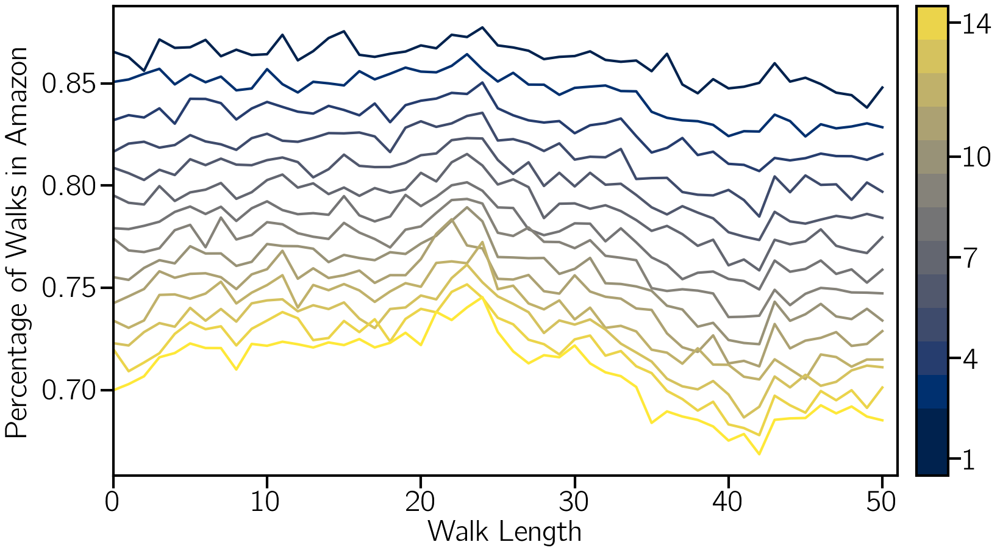

In [ ]:
fontsize = 36

plt.rc('text', usetex=True)
plt.rc('xtick',labelsize=fontsize)
plt.rc('ytick',labelsize=fontsize)

lw = 3

fig, ax1 = plt.subplots(1,1,figsize=(20,10),sharex=True)

n = len(lengths)
c = np.arange(1,n+1)
norm = mpl.colors.Normalize(vmin=c.min(), vmax=c.max())
cmap = mpl.cm.ScalarMappable(norm=norm, cmap='cividis')
cmap.set_array([])
for i in range(len(lengths)):
    length = lengths[i]
    ax1.plot(percentage_within_amazon_dict[length],c=cmap.to_rgba(i+1),alpha=1,lw=lw,zorder=5)

ax1.set_xlabel(r'Walk Length',fontsize=fontsize)
ax1.set_ylabel(r'Percentage of Walks in Amazon',fontsize=fontsize, labelpad=12)

ax1.set_xlim([0, len(dates)])
# ax1.set_ylim([0, 1])
# ax1.set_yticks([0.015, 0.016, 0.017, 0.018])

# ax1.plot([t_target, t_target], ax1.get_ylim(), '--', c='gray', lw=lw, zorder=4)

spacing = 0.025
# ax1.annotate(r'\textbf{(a)}', xy=(spacing/4, 1-spacing), xycoords="axes fraction",
#              fontsize=fontsize,usetex=True, va='top', ha='left', zorder=100)

ax1.tick_params(length=15,width=3)
plt.setp(ax1.spines.values(), linewidth=3, zorder=10)


num_ticks = 5
ticks = np.linspace(0,len(lengths)-1,num_ticks).astype(int)

# plt.tight_layout()
plt.subplots_adjust(hspace=0.2)
# fig.align_labels([ax1,ax2])

# cax1 = fig.add_ax1es([0.68, 0.21, 0.01, 0.755])
cbar = fig.colorbar(cmap, ticks=ticks,
                    ax=[ax1], orientation='vertical', pad=.02, aspect=15, boundaries=np.arange(-.5,len(c),1))
# cbar.set_label(r'',fontsize=fontsize,rotation='vertical',labelpad=20)
cbar.ax.set_yticklabels([lengths[tick] for tick in ticks])
cbar.ax.tick_params(length=15,width=3)
cbar.outline.set_linewidth(3)



# # plt.tight_layout()
# plt.subplots_adjust(hspace=0)
# # fig.align_labels([ax1,ax2])

title = 'Avg Phi and Num Nodes Affected'
# plt.savefig(fig_dir+title+'.jpg',bbox_inches='tight',pad_inches=0.2, dpi=300)
# plt.savefig(fig_dir+title+'.pdf',bbox_inches='tight',pad_inches=0.2, dpi=300)

plt.show()

In [ ]:
date = dates[0]

f = gzip.open(graph_dir + date+'.data','rb')
G = pkl.load(f)
f.close()

walks = random_walks(G, amazon_nodes, num_samples=10000, length=3, max_tries=10, desc='')

  0%|          | 0/10000 [00:00<?, ?it/s]

In [ ]:
densities = [0.1, 0.05, 0.025, 0.01, 0.005]

R_i_dict_vary_density = {density:{date:[None]*num_nodes for date in dates} for density in densities}



recompute = False

if recompute:
  for density in densities:
    graph_dir = data_dir + 'G-months='+str(months)+',offset='+str(offset)+',density={:}'.format(density)+'/'

    for i in trange(len(dates)):
      date = dates[i]

      f = gzip.open(graph_dir + date+'.data','rb')
      G = pkl.load(f)
      f.close()

      H = nx.Graph() # make sorted copy
      H.add_nodes_from(sorted(G.nodes(data=True)))
      H.add_edges_from(G.edges(amazon_nodes, data=True))

      for j in trange(G.number_of_nodes(), leave=False, desc=date):
        R_i_dict_vary_density[density][date][j] = sum([1 if neighbor in amazon_nodes else 0 for neighbor in H.neighbors(j)])

  with gzip.open(data_dir + 'R_i_dict_vary_density.data', 'wb') as file:
    pkl.dump(R_i_dict_vary_density, file)
else:
  with gzip.open(data_dir + 'R_i_dict_vary_density.data', 'rb') as file:
    R_i_dict_vary_density = pkl.load(file)

#Compute Metrics

In [ ]:
with gzip.open(data_dir + 'icosahedral_grid.data', 'rb') as file:
  latlon_icos = np.array(pkl.load(file))

months = 300
offset = 365.25
density = 0.05

edge_dir = data_dir + 'edge_list-months='+str(months)+',offset='+str(offset)+',density={:}'.format(density)+'/'

dir_end = '-months={:},offset={:},density={:}/'.format(months,offset,density)

total_networks = len(os.listdir(edge_dir))

num_nodes = 10242

with gzip.open(data_dir + 'year_intervals-months='+str(months)+',offset='+str(offset) + '.data', 'rb') as file:
  year_intervals = pkl.load(file)

with gzip.open(data_dir + 'date_intervals-months='+str(months)+',offset='+str(offset) + '.data', 'rb') as file:
  date_intervals = pkl.load(file)

dates = [year_intervals[i][0] + '-' + year_intervals[i][1] for i in range(len(year_intervals))]
print(dates)

reader = shpreader.Reader(base_dir+'Amazon Biome/amazonia.shp')
amazon = cartopy.feature.ShapelyFeature(list(reader.geometries()), ccrs.PlateCarree())

recompute = False

if recompute:
  amazon_nodes = []

  for i in range(num_nodes):
    if amazon._geoms[0].contains(Point(latlon_icos[i,1]-360,latlon_icos[i,0])):
      amazon_nodes.append(i)

  with gzip.open(data_dir + 'amazon_nodes_new_networks.data', 'wb') as file:
    pkl.dump(amazon_nodes, file)
else:
  with gzip.open(data_dir + 'amazon_nodes_new_networks.data', 'rb') as file:
    amazon_nodes = pkl.load(file)

recompute = False

dir_end = '-months={:},offset={:},density={:}/'.format(months,offset,density)

graph_dir = data_dir + 'G-months='+str(months)+',offset='+str(offset)+',density={:}'.format(density)+'/'
if recompute:
  if not os.path.isdir(graph_dir):
    os.mkdir(graph_dir)

  for i in trange(len(dates)):
    date = dates[i]

    with gzip.open(edge_dir + str(i) + '.data', 'rb') as file:
      edge_list = pkl.load(file)

    G = nx.from_edgelist(edge_list) # initiall unsorted

    H = nx.Graph() # make sorted copy
    H.add_nodes_from(sorted(G.nodes(data=True)))
    H.add_edges_from(G.edges(data=True))
    G = H # write over original with sorted copy
    del H # delete sorted copy

    print(i, nx.density(G))

    with gzip.open(graph_dir + date + '.data', 'wb') as file:
      pkl.dump(G, file)

['1948-1973', '1949-1974', '1950-1975', '1951-1976', '1952-1977', '1953-1978', '1954-1979', '1955-1980', '1956-1981', '1957-1982', '1958-1983', '1959-1984', '1960-1985', '1961-1986', '1962-1987', '1963-1988', '1964-1989', '1965-1990', '1966-1991', '1967-1992', '1968-1993', '1969-1994', '1970-1995', '1971-1996', '1972-1997', '1973-1998', '1974-1999', '1975-2000', '1976-2001', '1977-2002', '1978-2003', '1979-2004', '1980-2005', '1981-2006', '1982-2007', '1983-2008', '1984-2009', '1985-2010', '1986-2011', '1987-2012', '1988-2013', '1989-2014', '1990-2015', '1991-2016', '1992-2017', '1993-2018', '1994-2019', '1995-2020', '1996-2021', '1997-2022', '1998-2023']


In [ ]:
def save_data(data, fname, dir):
  with gzip.open(dir + str(fname) + '.data', 'wb') as file:
    pkl.dump(data, file)

def get_communicability(j, date, data_dir, dir_end):
  with gzip.open(data_dir + 'eigvals_A'+dir_end+str(j)+'.data','rb') as file:
    eigvals = np.real(pkl.load(file))

  with gzip.open(data_dir + 'eigvecs_A'+dir_end+str(j)+'.data','rb') as file:
    eigvecs = np.real(pkl.load(file))

  comm_exp = np.matmul(np.matmul(eigvecs,np.diag(np.exp(eigvals-np.max(eigvals)+10))), np.linalg.inv(eigvecs))

  save_data(comm_exp, date, data_dir+'comm_exp'+dir_end)

  return j

def get_communicability_angle(j, date, data_dir, dir_end):
  with gzip.open(data_dir + 'comm_exp'+dir_end+date+'.data', 'rb') as file:
    comm_exp = pkl.load(file)

  N = len(comm_exp)

  comm_ang = np.zeros((N,N))
  diag = np.diag(comm_exp)
  for i in trange(N,desc=dates[0]):
      comm_ang[i,:] = np.arccos(comm_exp[i]/np.sqrt(comm_exp[i,i]*diag))*180/np.pi

  save_data(comm_ang, date, data_dir+'comm_ang'+dir_end)

  return j

def get_edge_betweenness(j, date, data_dir, graph_dir, dir_end):
  with gzip.open(graph_dir + date + '.data', 'rb') as file:
    G = pkl.load(file)

  save_data(nx.edge_betweenness_centrality(G,k=100), date, data_dir+'edge_betweenness'+dir_end)

  return j

def get_shortest_paths(j, date, data_dir, graph_dir, dir_end):
  with gzip.open(graph_dir + date + '.data', 'rb') as file:
    G = pkl.load(file)

  shortest_lengths = np.zeros((num_nodes,num_nodes))

  for node in range(num_nodes):
    lengths = nx.single_source_shortest_path_length(G, node)
    for other_node in range(node+1,num_nodes):
      shortest_lengths[node,other_node] = lengths[other_node]
      shortest_lengths[other_node,node] = lengths[other_node]

  save_data(shortest_lengths, date, data_dir+'all_pairs_shortest_path_length'+dir_end)

  return j

In [ ]:
!pip install multiprocessing

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 108.0/108.0 kB 3.0 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.


In [ ]:
import multiprocessing as mp

dir_end = '-months={:},offset={:},density={:}/'.format(months,offset,density)
if not os.path.isdir(data_dir + 'all_pairs_shortest_path_length'+dir_end):
  os.mkdir(data_dir + 'all_pairs_shortest_path_length'+dir_end)

parallel = True


if parallel:
  def handle_error(error):
      print(error)


  n_tasks = 4
  pool = mp.Pool(n_tasks)

  jobs = [pool.apply_async(get_shortest_paths,
                          args=[j, dates[j], data_dir, graph_dir, dir_end],
                          error_callback=handle_error) for j in range(8,total_networks)]
  pool.close()

  result_lst = []
  lst = tqdm(jobs)
  for job in lst:
      j = job.get()
      result_lst.append(j)
      try:
        lst.set_description(str(j))
      except:
        pass

  pool.join()
else:
  for j in trange(total_networks):
   get_shortest_paths(j, dates[j], data_dir, graph_dir, dir_end)

  0%|          | 0/43 [00:00<?, ?it/s]

In [ ]:
with gzip.open(graph_dir + dates[0] + '.data', 'rb') as file:
  G = pkl.load(file)

a = nx.all_pairs_shortest_path_length(G)

In [ ]:
shortest_lengths = np.zeros((num_nodes,num_nodes))

for node in trange(num_nodes):
  lengths = nx.single_source_shortest_path_length(G, node)
  for other_node in range(node+1,num_nodes):
    shortest_lengths[node,other_node] = lengths[other_node]
    shortest_lengths[other_node,node] = lengths[other_node]

  0%|          | 0/10242 [00:00<?, ?it/s]

KeyboardInterrupt: ignored

In [ ]:
a_lst = [e[1] for e in a]

KeyboardInterrupt: ignored

In [ ]:
print(a)

<generator object all_pairs_shortest_path_length at 0x7fe584c8a880>


In [ ]:
print(G.number_of_nodes())

10242
